In [1]:
import rasterio as rio
import numpy as np
import utm
import matplotlib.pyplot as plt
from common import *
import os
import gpxpy
import scipy.io as sio
import pickle
import torch
from torchvision import transforms, datasets
import torch.nn as nn
from torch import optim as optim

def find_dist(l,cellsize):
    a = np.linalg.norm((l[2]-l[0])*cellsize)**2 + np.linalg.norm((l[3]-l[1])*cellsize)**2
    return np.sqrt(a)

class Dataset(torch.utils.data.Dataset):
    '''
    Generating dataset out of numpy arrays
    '''
    def __init__(self, X, y):
        if len(y.shape) == 1:
            y = y.reshape(-1, 1)

        device = torch.device("cpu")
        self.x_data = torch.tensor(X, dtype=torch.float32).to(device)
        self.y_data = torch.tensor(y, dtype=torch.float32).to(device)

    def __len__(self):
        return len(self.x_data)

    def __getitem__(self, idx):
        preds = self.x_data[idx,:]  # or just [idx]
        out_y = self.y_data[idx,:]
        return (preds, out_y)       # tuple of two matrices


tx1_ebc_X = np.load("./files_generated_by_process_data_scripts/tx1_ebc_X.npy", allow_pickle=True)
print("1")
tx1_ebc_y = np.load("./files_generated_by_process_data_scripts/tx1_ebc_y.npy", allow_pickle=True)
print("2")
#tx2_ustar_X = np.load("./files_generated_by_process_data_scripts/tx2_ustar_X.npy", allow_pickle=True)
#print("3")
#tx2_ustar_y = np.load("./files_generated_by_process_data_scripts/tx2_ustar_y.npy", allow_pickle=True)
#print("4")
tx3_X = np.load("./files_generated_by_process_data_scripts/tx3_X.npy", allow_pickle=True)
print("5")
tx3_y = np.load("./files_generated_by_process_data_scripts/tx3_y.npy", allow_pickle=True)
print("6")
tx4_X = np.load("./files_generated_by_process_data_scripts/tx4_X.npy", allow_pickle=True)
print("7")
tx4_y = np.load("./files_generated_by_process_data_scripts/tx4_y.npy", allow_pickle=True)
print("8")
tx5_X = np.load("./files_generated_by_process_data_scripts/tx5_X.npy", allow_pickle=True)
print("9")
tx5_y = np.load("./files_generated_by_process_data_scripts/tx5_y.npy", allow_pickle=True)
print("10")
tx6_X = np.load("./files_generated_by_process_data_scripts/tx6_X.npy", allow_pickle=True)
print("11")
tx6_y = np.load("./files_generated_by_process_data_scripts/tx6_y.npy", allow_pickle=True)
print("12")

#print(tx1_ebc_y)
#print(tx1_ebc_X)
max_length = 0
max_elev = 0
min_elev = 100000
max_x_coord = 0
max_y_coord = 0
for i in range(len(tx1_ebc_X[0])):
    l = len(tx1_ebc_X[2][i])
    if l>max_length:
        max_length = l
    dummy_max = max(tx1_ebc_X[2][i])
    if dummy_max>max_elev:
        max_elev = dummy_max
    dummy_min = min(tx1_ebc_X[2][i])
    if dummy_min<min_elev:
        min_elev = dummy_min
    dummy_max_coord_x1 = tx1_ebc_X[0][i][0]
    dummy_max_coord_x2 = tx1_ebc_X[1][i][0]
    dummy_x = max([dummy_max_coord_x1, dummy_max_coord_x2])
    if dummy_x>max_x_coord:
        max_x_coord = dummy_x

    dummy_max_coord_y1 = tx1_ebc_X[0][i][1]
    dummy_max_coord_y2 = tx1_ebc_X[1][i][1]
    dummy_y = max([dummy_max_coord_y1, dummy_max_coord_y2])
    if dummy_y>max_y_coord:
        max_y_coord = dummy_y
    


'''
print(max_length)
print(max_elev)
print(max_x_coord)
print(max_y_coord)
for i in range(len(tx2_ustar_X[0])):
    l = len(tx2_ustar_X[2][i])
    if l>max_length:
        max_length = l
    dummy_max = max(tx2_ustar_X[2][i])
    if dummy_max>max_elev:
        max_elev = dummy_max
    dummy_min = min(tx2_ustar_X[2][i])
    if dummy_min<min_elev:
        min_elev = dummy_min
    dummy_max_coord_x1 = tx2_ustar_X[0][i][0]
    dummy_max_coord_x2 = tx2_ustar_X[1][i][0]
    dummy_x = max([dummy_max_coord_x1, dummy_max_coord_x2])
    if dummy_x>max_x_coord:
        max_x_coord = dummy_x

    dummy_max_coord_y1 = tx2_ustar_X[0][i][1]
    dummy_max_coord_y2 = tx2_ustar_X[1][i][1]
    dummy_y = max([dummy_max_coord_y1, dummy_max_coord_y2])
    if dummy_y>max_y_coord:
        max_y_coord = dummy_y

'''

print(max_length)
print(max_elev)
print(max_x_coord)
print(max_y_coord)
for i in range(len(tx3_X[0])):
    l = len(tx3_X[2][i])
    if l>max_length:
        max_length = l
    dummy_max = max(tx3_X[2][i])
    if dummy_max>max_elev:
        max_elev = dummy_max
    dummy_min = min(tx3_X[2][i])
    if dummy_min<min_elev:
        min_elev = dummy_min
    dummy_max_coord_x1 = tx3_X[0][i][0]
    dummy_max_coord_x2 = tx3_X[1][i][0]
    dummy_x = max([dummy_max_coord_x1, dummy_max_coord_x2])
    if dummy_x>max_x_coord:
        max_x_coord = dummy_x

    dummy_max_coord_y1 = tx3_X[0][i][1]
    dummy_max_coord_y2 = tx3_X[1][i][1]
    dummy_y = max([dummy_max_coord_y1, dummy_max_coord_y2])
    if dummy_y>max_y_coord:
        max_y_coord = dummy_y
        
print(max_length)
print(max_elev)
print(max_x_coord)
print(max_y_coord)
for i in range(len(tx4_X[0])):
    l = len(tx4_X[2][i])
    if l>max_length:
        max_length = l
    dummy_max = max(tx4_X[2][i])
    if dummy_max>max_elev:
        max_elev = dummy_max
    dummy_min = min(tx4_X[2][i])
    if dummy_min<min_elev:
        min_elev = dummy_min
    dummy_max_coord_x1 = tx4_X[0][i][0]
    dummy_max_coord_x2 = tx4_X[1][i][0]
    dummy_x = max([dummy_max_coord_x1, dummy_max_coord_x2])
    if dummy_x>max_x_coord:
        max_x_coord = dummy_x

    dummy_max_coord_y1 = tx4_X[0][i][1]
    dummy_max_coord_y2 = tx4_X[1][i][1]
    dummy_y = max([dummy_max_coord_y1, dummy_max_coord_y2])
    if dummy_y>max_y_coord:
        max_y_coord = dummy_y
        
print(max_length)
print(max_elev)
print(max_x_coord)
print(max_y_coord)
for i in range(len(tx5_X[0])):
    l = len(tx5_X[2][i])
    if l>max_length:
        max_length = l
    dummy_max = max(tx5_X[2][i])
    if dummy_max>max_elev:
        max_elev = dummy_max
    dummy_min = min(tx5_X[2][i])
    if dummy_min<min_elev:
        min_elev = dummy_min
    dummy_max_coord_x1 = tx5_X[0][i][0]
    dummy_max_coord_x2 = tx5_X[1][i][0]
    dummy_x = max([dummy_max_coord_x1, dummy_max_coord_x2])
    if dummy_x>max_x_coord:
        max_x_coord = dummy_x

    dummy_max_coord_y1 = tx5_X[0][i][1]
    dummy_max_coord_y2 = tx5_X[1][i][1]
    dummy_y = max([dummy_max_coord_y1, dummy_max_coord_y2])
    if dummy_y>max_y_coord:
        max_y_coord = dummy_y

print(max_length)
print(max_elev)
print(max_x_coord)
print(max_y_coord)
for i in range(len(tx6_X[0])):
    l = len(tx6_X[2][i])
    if l>max_length:
        max_length = l
    dummy_max = max(tx6_X[2][i])
    if dummy_max>max_elev:
        max_elev = dummy_max
    dummy_min = min(tx6_X[2][i])
    if dummy_min<min_elev:
        min_elev = dummy_min
    dummy_max_coord_x1 = tx6_X[0][i][0]
    dummy_max_coord_x2 = tx6_X[1][i][0]
    dummy_x = max([dummy_max_coord_x1, dummy_max_coord_x2])
    if dummy_x>max_x_coord:
        max_x_coord = dummy_x

    dummy_max_coord_y1 = tx6_X[0][i][1]
    dummy_max_coord_y2 = tx6_X[1][i][1]
    dummy_y = max([dummy_max_coord_y1, dummy_max_coord_y2])
    if dummy_y>max_y_coord:
        max_y_coord = dummy_y



print(max_length)
print(max_elev)
print(min_elev)
print(max_x_coord)
print(max_y_coord)



for i in range(len(tx1_ebc_X[0])):
    tx1_ebc_X[2][i] =(tx1_ebc_X[2][i]-min_elev)/(max_elev-min_elev)

    tx1_ebc_X[0][i][0] /=max_x_coord
    tx1_ebc_X[1][i][0] /=max_x_coord

    tx1_ebc_X[0][i][1] /= max_y_coord
    tx1_ebc_X[1][i][1] /= max_y_coord

'''
for i in range(len(tx2_ustar_X[0])):
    tx2_ustar_X[2][i] =(tx2_ustar_X[2][i]-min_elev)/(max_elev-min_elev)

    tx2_ustar_X[0][i][0] /=max_x_coord
    tx2_ustar_X[1][i][0] /=max_x_coord

    tx2_ustar_X[0][i][1] /= max_y_coord
    tx2_ustar_X[1][i][1] /= max_y_coord
''' 

for i in range(len(tx3_X[0])):
    tx3_X[2][i] =(tx3_X[2][i]-min_elev)/(max_elev-min_elev)
    

    tx3_X[0][i][0] /=max_x_coord
    tx3_X[1][i][0] /=max_x_coord

    tx3_X[0][i][1] /= max_y_coord
    tx3_X[1][i][1] /= max_y_coord
    
for i in range(len(tx4_X[0])):
    tx4_X[2][i] =(tx4_X[2][i]-min_elev)/(max_elev-min_elev)
    

    tx4_X[0][i][0] /=max_x_coord
    tx4_X[1][i][0] /=max_x_coord

    tx4_X[0][i][1] /= max_y_coord
    tx4_X[1][i][1] /= max_y_coord
    
for i in range(len(tx5_X[0])):
    tx5_X[2][i] =(tx5_X[2][i]-min_elev)/(max_elev-min_elev)


    tx5_X[0][i][0] /=max_x_coord
    tx5_X[1][i][0] /=max_x_coord

    tx5_X[0][i][1] /= max_y_coord
    tx5_X[1][i][1] /= max_y_coord
    
    
for i in range(len(tx6_X[0])):
    tx6_X[2][i] =(tx6_X[2][i]-min_elev)/(max_elev-min_elev)
    

    tx6_X[0][i][0] /=max_x_coord
    tx6_X[1][i][0] /=max_x_coord

    tx6_X[0][i][1] /= max_y_coord
    tx6_X[1][i][1] /= max_y_coord
        
        
for i in range(len(tx1_ebc_X[0])):
    original_array = tx1_ebc_X[2][i]
    desired_length = max_length
    padding_length = desired_length - len(original_array)
    padded_array = np.pad(original_array, (0, padding_length), mode='constant', constant_values=0)
    tx1_ebc_X[2][i] = padded_array

'''
for i in range(len(tx2_ustar_X[0])):
    original_array = tx2_ustar_X[2][i]
    desired_length = max_length
    padding_length = desired_length - len(original_array)
    padded_array = np.pad(original_array, (0, padding_length), mode='constant', constant_values=0)
    tx2_ustar_X[2][i] = padded_array
'''
    
for i in range(len(tx3_X[0])):
    original_array = tx3_X[2][i]
    desired_length = max_length
    padding_length = desired_length - len(original_array)
    padded_array = np.pad(original_array, (0, padding_length), mode='constant', constant_values=0)
    tx3_X[2][i] = padded_array

for i in range(len(tx4_X[0])):
    original_array = tx4_X[2][i]
    desired_length = max_length
    padding_length = desired_length - len(original_array)
    padded_array = np.pad(original_array, (0, padding_length), mode='constant', constant_values=0)
    tx4_X[2][i] = padded_array

for i in range(len(tx5_X[0])):
    original_array = tx5_X[2][i]
    desired_length = max_length
    padding_length = desired_length - len(original_array)
    padded_array = np.pad(original_array, (0, padding_length), mode='constant', constant_values=0)
    tx5_X[2][i] = padded_array

for i in range(len(tx6_X[0])):
    original_array = tx6_X[2][i]
    desired_length = max_length
    padding_length = desired_length - len(original_array)
    padded_array = np.pad(original_array, (0, padding_length), mode='constant', constant_values=0)
    tx6_X[2][i] = padded_array



C:\Users\serha\anaconda3\lib\site-packages\scipy\__init__.py:132: UserWarning: A NumPy version >=1.21.6 and <1.28.0 is required for this version of SciPy (detected version 1.21.5)
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


1
2
5
6
7
8
9
10
11
12
3000
1532.989990234375
9369
12485
3001
1555.8599853515625
10165
12545
3001
1555.8599853515625
10165
12545
3001
1555.8599853515625
10165
12545
3001
1555.8599853515625
1420.9200439453125
10165
12545


In [2]:
y_comb = np.append(tx1_ebc_y, tx3_y)
y_comb = np.append(y_comb, tx4_y)
y_comb = np.append(y_comb, tx5_y)
y_comb = np.array(np.append(y_comb, tx6_y))
print(y_comb)

[-47.66349203 -47.14166991 -45.54033234 ... -77.95405804 -74.83297452
 -72.32397533]


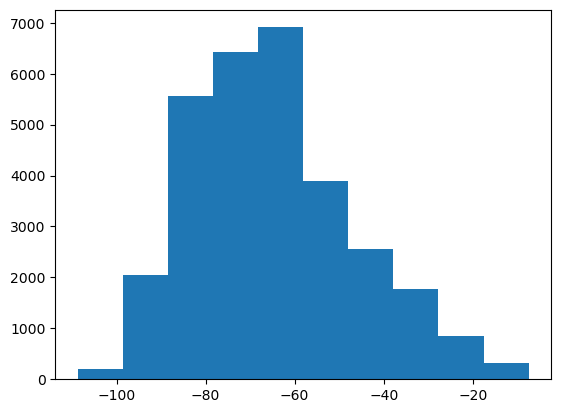

In [3]:
plt.figure()
plt.hist(y_comb)
plt.show()

In [6]:
print(len(tx1_ebc_X[2,0]))


4001


In [4]:
print(len(tx2_ustar_X[0]))
print(len(tx2_ustar_X))

13492
3


In [5]:
print(len(tx6_X[0]))
print(len(tx6_X))

15653
3


In [4]:
comb1 = np.append(tx1_ebc_X[0], tx3_X[0])
comb1 = np.append(comb1, tx4_X[0])
comb1 = np.append(comb1, tx5_X[0])
comb1 = np.append(comb1, tx6_X[0])
comb1 = np.array([np.array(sublist) for sublist in comb1])

comb2 = np.append(tx1_ebc_X[1], tx3_X[1])
comb2 = np.append(comb2, tx4_X[1])
comb2 = np.append(comb2, tx5_X[1])
comb2 = np.append(comb2, tx6_X[1])
comb2 = np.array([np.array(sublist) for sublist in comb2])

comb3 = np.append(tx1_ebc_X[2], tx3_X[2])
comb3 = np.append(comb3, tx4_X[2])
comb3 = np.append(comb3, tx5_X[2])
comb3 = np.append(comb3, tx6_X[2])
comb3 = np.array([np.array(sublist) for sublist in comb3])


#combined_conditional_info = np.array([comb1, comb2, comb3])
#print(combined_conditional_info)
#combined_array = np.concatenate((tx1_ebc_X, tx2_ustar_X, tx6_X), axis=0)
#print(tx1_ebc_X)


combined_array = np.concatenate((np.concatenate((comb1, comb2), axis=1), comb3), axis=1)


#data_loader = torch.utils.data.DataLoader(

#    datasets.MNIST('./', train=True, download=True,
#                   transform=transforms.Compose([
#                       transforms.ToTensor(),
#                       transforms.Normalize(
#                           (0.5,), (0.5,))
#                   ])),
#    batch_size=training_parameters["batch_size"], shuffle=True)

l = len(y_comb)
idx = np.random.permutation(l)
val_percent = 0
test_percent = 0.3
len1 = np.ceil(l * (1 - (test_percent+val_percent)))
len1 = int(len1)
len2 = np.ceil(l * (1 - (test_percent)))-len1
len2 = int(len2)
len3 = int(l-len1-len2)


#X[X.abs()> 1e308] = 0
#X[X.abs() == float("+inf")] = 0.0
#X[X.abs() == float("-inf")] = 0.0
#X[X.abs() == float("nan")] = 0.0

train_X = combined_array[idx[0:len1]]
test_X = combined_array[idx[len1+len2:]]

#train_X2 = comb2[idx[0:len1]]
#test_X2 = comb2[idx[len1+len2:]]

#train_X3 = comb3[idx[0:len1]]
#test_X3 = comb3[idx[len1+len2:]]

train_y = y_comb[idx[0:len1]]
test_y = y_comb[idx[len1+len2:]]


ds_train = Dataset(train_X, train_y)
ds_test = Dataset(test_X, test_y)


print(len(combined_array[0,:]))

3005


In [108]:
combined_array[0]

array([0.82557796, 0.88816261, 0.710182  , ..., 0.        , 0.        ,
       0.        ])

In [5]:
dist_gt = []
for i in range(len(combined_array)):
    dist_gt.append(find_dist([combined_array[i, 0]*max_x_coord,combined_array[i,1]*max_y_coord,combined_array[i,2]*max_x_coord,combined_array[i,3]*max_y_coord], 0.5))

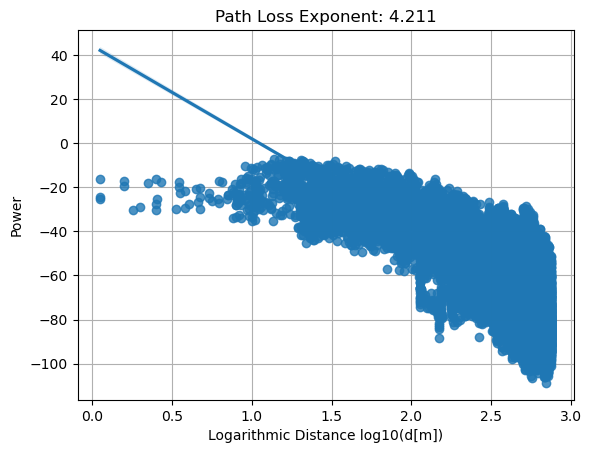

In [6]:
import seaborn as sns
sns.reset_orig()
a, b = np.polyfit(np.log10(dist_gt), y_comb, 1)
plt.figure()
ax = sns.regplot(x=np.log10(dist_gt), y=y_comb)
ax.set_axisbelow(True)

plt.title("Path Loss Exponent: %.3f" %abs(a/10))
plt.xlabel("Logarithmic Distance log10(d[m])")
plt.ylabel("Power")
plt.grid(True)
plt.show()

In [8]:
print(delete_idx)

[]


In [6]:
print(combined_array)

[0.74101545 0.87587454 0.63743929 ... 0.         0.         0.        ]


In [7]:
class Dataset2(torch.utils.data.Dataset):
    '''
    Generating dataset out of numpy arrays
    '''
    def __init__(self, X):

        device = torch.device("cpu")
        self.x_data = torch.tensor(X, dtype=torch.float32).to(device)

    def __len__(self):
        return len(self.x_data)

    def __getitem__(self, idx):
        preds = self.x_data[idx,:]  # or just [idx]
        return preds       # tuple of two matrices



In [8]:
idx = np.random.permutation(l)
val_percent = 0
test_percent = 0.3
len1 = np.ceil(l * (1 - (test_percent+val_percent)))
len1 = int(len1)
len2 = np.ceil(l * (1 - (test_percent)))-len1
len2 = int(len2)
len3 = int(l-len1-len2)

training_parameters = {
    "n_epochs": 20,
    "batch_size": 8,
}

#X[X.abs()> 1e308] = 0
#X[X.abs() == float("+inf")] = 0.0
#X[X.abs() == float("-inf")] = 0.0
#X[X.abs() == float("nan")] = 0.0

train_X = comb3[idx[0:len1]]
test_X = comb3[idx[len1+len2:]]

#train_X2 = comb2[idx[0:len1]]
#test_X2 = comb2[idx[len1+len2:]]

#train_X3 = comb3[idx[0:len1]]
#test_X3 = comb3[idx[len1+len2:]]

ds_train = Dataset2(train_X)
ds_test = Dataset2(test_X)

train_ldr = torch.utils.data.DataLoader(ds_train, batch_size=training_parameters["batch_size"], shuffle=False)
test_ldr = torch.utils.data.DataLoader(ds_test, batch_size=1)
#test_ldr = torch.utils.data.DataLoader(ds_test, batch_size=1)
num_batches = len(train_ldr)
print("Number of batches: ",num_batches)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)


Number of batches:  2672
cpu


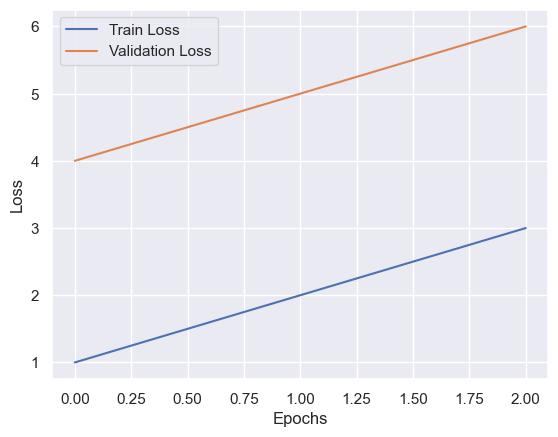

In [17]:

train_loss = [1,2,3]
val_loss = [4,5,6]
plt.figure()
sns.set_theme()
plt.plot(train_loss)
plt.plot(val_loss)
ax = plt.gca()
ax.set_axisbelow(True)
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(["Train Loss", "Validation Loss"])
plt.grid(True)
plt.show()


        

0.0
0.18712574850299402
0.37425149700598803
0.561377245508982
0.7485029940119761
0.9356287425149701
Train Loss: 0.004011419326602691
Val Loss: 0.0019577437720021745
0.0
0.18712574850299402
0.37425149700598803
0.561377245508982
0.7485029940119761
0.9356287425149701
Train Loss: 0.0017996200493329154
Val Loss: 0.0019530401219085246
0.0
0.18712574850299402
0.37425149700598803
0.561377245508982
0.7485029940119761
0.9356287425149701
Train Loss: 0.0014843864849675167
Val Loss: 0.0013038912334323231
0.0
0.18712574850299402
0.37425149700598803
0.561377245508982
0.7485029940119761
0.9356287425149701
Train Loss: 0.0012523706010649116
Val Loss: 0.0014241553355761815
0.0
0.18712574850299402
0.37425149700598803
0.561377245508982
0.7485029940119761
0.9356287425149701
Train Loss: 0.00114839723401727
Val Loss: 0.0009441915157969634
0.0
0.18712574850299402
0.37425149700598803
0.561377245508982
0.7485029940119761
0.9356287425149701
Train Loss: 0.0011223170055279683
Val Loss: 0.0012388187080772351
0.0
0.1

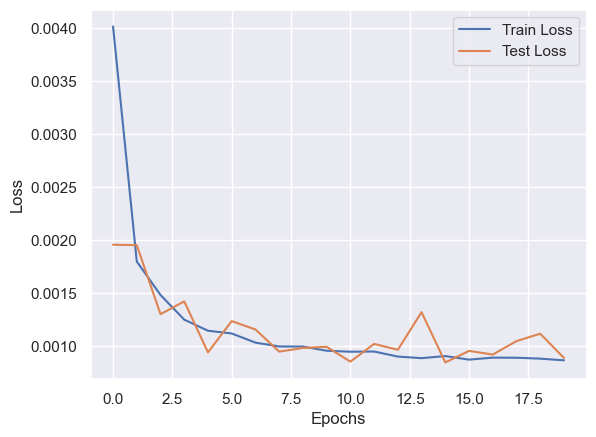

In [20]:
class AEModel(nn.Module):
    def __init__(self):
        super(AEModel, self).__init__()
        input_dim = 3001
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, 256),
            nn.ReLU(),
            nn.Linear(256, 64),
            nn.ReLU(),
            nn.Linear(64, 8),
            nn.ReLU()
        )
        self.decoder = nn.Sequential(
            nn.Linear(8, 64),
            nn.ReLU(),
            nn.Linear(64, 256),
            nn.ReLU(),
            nn.Linear(256, input_dim),
            nn.Sigmoid()
        )

    def forward(self,x):
        output = self.encoder(x)
        output = self.decoder(output)
        return output
    
ae = AEModel()
ae.to(device)
ae_optimizer = optim.Adam(ae.parameters(), lr=0.002)
loss = nn.MSELoss()
n_epochs = 20
batch_size = training_parameters["batch_size"]
train_loss_list = []
test_loss_list = []
for epoch_idx in range(n_epochs):
    dummy_loss_train=0
    dummy_loss_val=0
    for batch_idx, batch in enumerate(train_ldr):
        if batch_idx % 500 ==0:
            print(batch_idx/len(train_ldr))
        X_ = batch  # (predictors, targets)
        ae_optimizer.zero_grad()  # prepare gradients
        oupt = ae(X_)  # predicted output

        loss_val = loss(oupt, X_)  # avg per item in batch
        dummy_loss_train+=loss_val.item()
        loss_val.backward()  # compute gradients
        ae_optimizer.step()  # update wts

            #print(loss_val)

        #print(f"Testing - Epoch: %d", epoch)
    for (batch_idx, batch) in enumerate(test_ldr):
        ae.eval()
        X_ = batch  # (predictors, targets)
        oupt = ae(X_)  # predicted prices

        loss_val = loss(oupt, X_)  # avg per item in batch
        dummy_loss_val+=loss_val.item()
        #print(dummy_loss_test)
        #test_loss_list.append(loss_val)
        #if epoch == max_epochs - 1:
        #    print(f"Testing loss:", loss_val)


        #print(loss_val)
    train_loss = dummy_loss_train/len(train_ldr)
    train_loss_list.append(train_loss)
    print("Train Loss: " + str(train_loss))
    test_loss = dummy_loss_val/len(test_ldr)
    test_loss_list.append(test_loss)
    print("Val Loss: " + str(test_loss))
    #scheduler.step(val_loss)


plt.figure()
sns.set_theme()
plt.plot(train_loss_list)
plt.plot(test_loss_list)
ax = plt.gca()
ax.set_axisbelow(True)
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(["Train Loss", "Test Loss"])
plt.grid(True)
plt.show()


        

In [19]:
val_loss

0.0021202795620165384

In [16]:
ae.hidden_layer3(ae.hidden_layer2(ae.hidden_layer1(torch.randn(18333))))

tensor([2.8407, 6.4084, 2.9343, 0.0000, 0.0000, 3.0746, 0.0000, 4.1570],
       grad_fn=<ReluBackward0>)

In [17]:
ae.hidden_layer1

Sequential(
  (0): Linear(in_features=18333, out_features=256, bias=True)
  (1): ReLU()
)

In [74]:
'''
class AEModel(nn.Module):
    def __init__(self):
        super(AEModel, self).__init__()
        input_dim = 18333
        self.hidden_layer1 =  nn.Sequential(
            nn.Conv1d(input_dim, 128, 16, stride=2, padding=1),
            nn.ReLU()
        )
        self.hidden_layer2 =  nn.Sequential(
            nn.Conv1d(128, 32, 8, stride=2, padding=1),
            nn.ReLU()
        )
        self.hidden_layer3 =  nn.Sequential(
            nn.Conv1d(32, 8, 8),
            nn.ReLU()
        )
        self.hidden_layer4 =  nn.Sequential(
            nn.ConvTranspose1d(8, 32, 8),
            nn.ReLU()
        )
        self.hidden_layer5 =  nn.Sequential(
            nn.ConvTranspose1d(32, 128, 8, stride=2, padding=1, output_padding=1),
            nn.ReLU()
        )
        self.hidden_layer6 =  nn.Sequential(
            nn.ConvTranspose1d(128, input_dim, 16, stride=2, padding=2),
            nn.Sigmoid()
        )
    def forward(self,x):
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)
        output = self.hidden_layer3(output)
        output = self.hidden_layer4(output)
        output = self.hidden_layer5(output)
        output = self.hidden_layer6(output)
        return output
    
ae = AEModel()
ae.to(device)
ae_optimizer = optim.Adam(ae.parameters(), lr=0.002)
loss = nn.MSELoss()
n_epochs = training_parameters["n_epochs"]

for epoch_idx in range(n_epochs):
    dummy_loss_train=0
    dummy_loss_val=0
    for batch_idx, batch in enumerate(train_ldr):
        print(batch_idx/len(train_ldr))
        X_ = batch  # (predictors, targets)
        X_ = X_.unsqueeze(-1)
        X_ = X_.permute(2,1,0)
        ae_optimizer.zero_grad()  # prepare gradients
        oupt = ae(X_)  # predicted output

        loss_val = loss(oupt, X_)  # avg per item in batch
        dummy_loss_train+=loss_val.item()
        loss_val.backward()  # compute gradients
        ae_optimizer.step()  # update wts

            #print(loss_val)

        #print(f"Testing - Epoch: %d", epoch)
        #for (batch_idx, batch) in enumerate(test_ldr):
        #    ae.eval()
        #    X_ = batch  # (predictors, targets)
        #    X_ = X_.unsqueeze(-1)
        #    X_ = X_.permute(2,1,0)
        #    print(X_.shape)
        #    oupt = ae(X_)  # predicted prices

        #    loss_val = loss(oupt, X_)  # avg per item in batch
        #    dummy_loss_val+=loss_val.item()
            #print(dummy_loss_test)
            #test_loss_list.append(loss_val)
            #if epoch == max_epochs - 1:
            #    print(f"Testing loss:", loss_val)


            #print(loss_val)
    train_loss = dummy_loss_train/len(train_ldr)
    #train_loss_list.append(train_loss)
    print("Train Loss: " + str(train_loss))
    #val_loss = dummy_loss_val/len(test_ldr)
    #test_loss_list.append(test_loss)
    #print("Val Loss: " + str(val_loss))
    #scheduler.step(val_loss)

'''

        

0.0
0.0017889087656529517
0.0035778175313059034
0.005366726296958855
0.007155635062611807
0.008944543828264758
0.01073345259391771
0.012522361359570662
0.014311270125223614
0.016100178890876567
0.017889087656529516
0.01967799642218247
0.02146690518783542
0.023255813953488372
0.025044722719141325
0.026833631484794274
0.028622540250447227
0.03041144901610018
0.03220035778175313
0.03398926654740608
0.03577817531305903
0.03756708407871199
0.03935599284436494
0.04114490161001789
0.04293381037567084
0.044722719141323794
0.046511627906976744
0.04830053667262969
0.05008944543828265
0.0518783542039356
0.05366726296958855
0.055456171735241505
0.057245080500894455
0.059033989266547404
0.06082289803220036
0.0626118067978533
0.06440071556350627
0.06618962432915922
0.06797853309481217
0.06976744186046512
0.07155635062611806
0.07334525939177101
0.07513416815742398
0.07692307692307693
0.07871198568872988
0.08050089445438283
0.08228980322003578
0.08407871198568873
0.08586762075134168
0.0876565295169946

RuntimeError: [enforce fail at C:\b\abs_abjetg6_iu\croot\pytorch_1686932924616\work\c10\core\impl\alloc_cpu.cpp:72] data. DefaultCPUAllocator: not enough memory: you tried to allocate 631242112 bytes.

## Encoder Features Used in GAN

In [45]:
train_X = combined_array[idx]
#test_X = combined_ar

#train_X2 = comb2[idx[0:len1]]
#test_X2 = comb2[idx[len1+len2:]]

#train_X3 = comb3[idx[0:len1]]
#test_X3 = comb3[idx[len1+len2:]]

train_y = y_comb[idx]
#test_y = y_comb[idx[len1+len2:]]


ds_train = Dataset(train_X, train_y)
#ds_test = Dataset(test_X, test_y)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
training_parameters = {
    "n_epochs": 20,
    "batch_size": 48,
}
train_ldr = torch.utils.data.DataLoader(ds_train, batch_size=training_parameters["batch_size"], shuffle=False)
#test_ldr = torch.utils.data.DataLoader(ds_test, batch_size=1)
#test_ldr = torch.utils.data.DataLoader(ds_test, batch_size=1)
num_batches = len(train_ldr)
print("Number of batches: ",num_batches)


from matplotlib import pyplot as plt

for x,y in train_ldr:
    print(x)
    #print(x2)
    #print(x3)
    #print(y)
    break


cpu
Number of batches:  637
tensor([[0.7801, 0.9913, 0.7132,  ..., 0.0000, 0.0000, 0.0000],
        [0.7801, 0.9913, 0.7504,  ..., 0.0000, 0.0000, 0.0000],
        [0.7801, 0.9913, 0.8268,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.8159, 0.9390, 0.7427,  ..., 0.0000, 0.0000, 0.0000],
        [0.7801, 0.9913, 0.8057,  ..., 0.0000, 0.0000, 0.0000],
        [0.8589, 0.8962, 0.7295,  ..., 0.0000, 0.0000, 0.0000]])


In [37]:
def find_dist(l,cellsize):
    a = np.linalg.norm((l[2]-l[0])*cellsize)**2 + np.linalg.norm((l[3]-l[1])*cellsize)**2
    return np.sqrt(a)

In [38]:
from torch import autograd
def gradient_penalty(D, fi, xr, xf, batch_size):
    """

    :param D:
    :param xr: [b, 2]
    :param xf: [b, 2]
    :return:
    """
    # [b, 1]
    t = torch.rand(batch_size, 1).cpu()
    # [b, 1] => [b, 2]  broadcasting so t is the same for x1 and x2
    t = t.expand_as(xr)
    # interpolation
    mid = t * xr + (1 - t) * xf
    # set it to require grad info
    mid.requires_grad_()

    pred = D(fi, mid).view(batch_size)
    grads = autograd.grad(outputs=pred, inputs=mid,
                          grad_outputs=torch.ones_like(pred),
                          create_graph=True, retain_graph=True, only_inputs=True)[0]

    gp = torch.pow(grads.norm(2, dim=1) - 1, 2).mean()

    return gp

0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


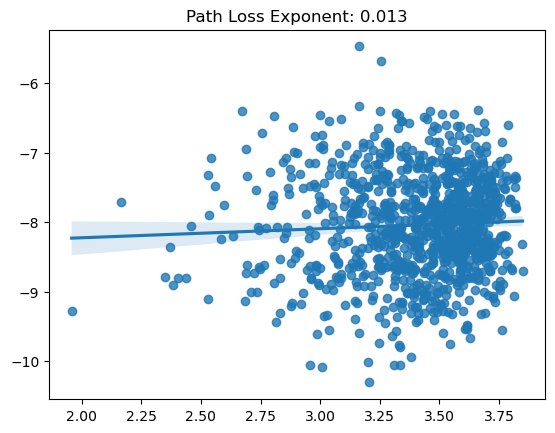

[0/20]: loss_d: 1.246, loss_g: 0.606, acc_real: 0.634, acc_fake: 0.116
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


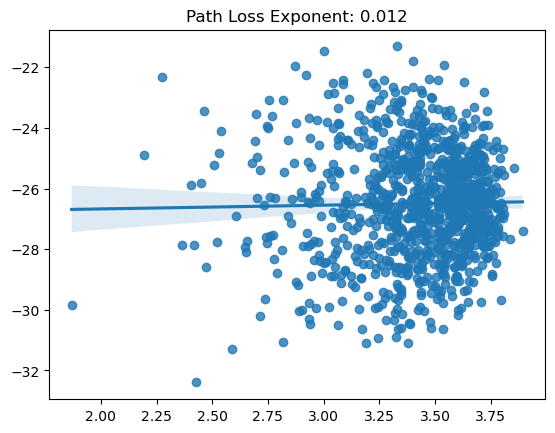

[1/20]: loss_d: 0.501, loss_g: 0.810, acc_real: 0.762, acc_fake: 0.332
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


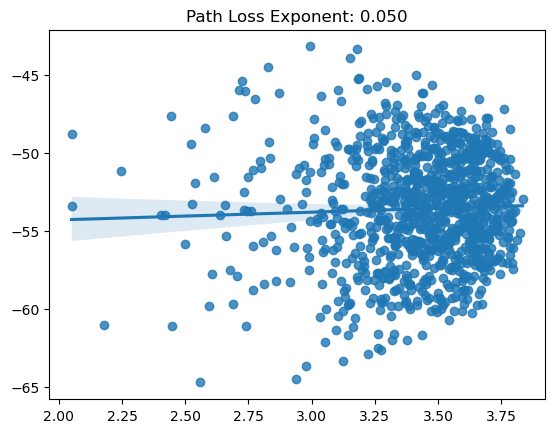

[2/20]: loss_d: 0.522, loss_g: 1.074, acc_real: 0.767, acc_fake: 0.449
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


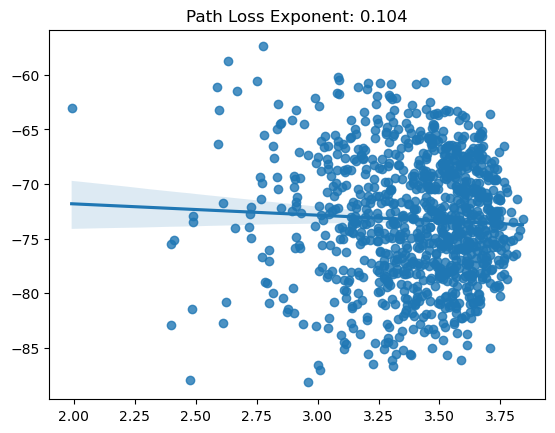

[3/20]: loss_d: 0.604, loss_g: 0.985, acc_real: 0.734, acc_fake: 0.513
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


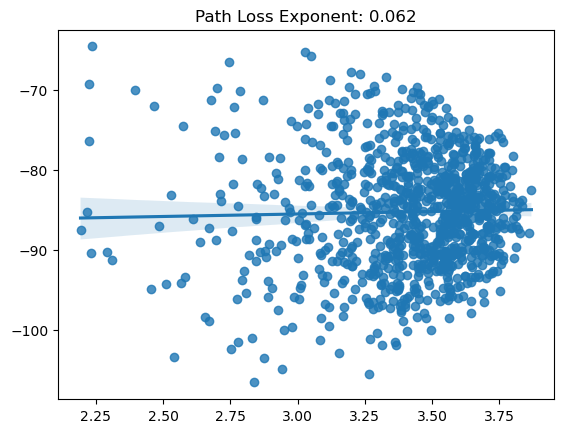

[4/20]: loss_d: 0.663, loss_g: 0.847, acc_real: 0.688, acc_fake: 0.557
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


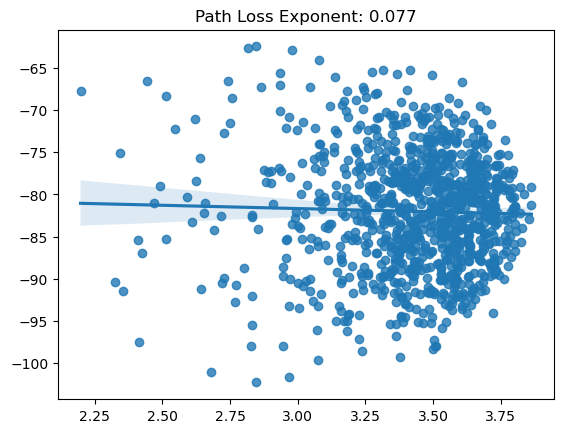

[5/20]: loss_d: 0.580, loss_g: 0.900, acc_real: 0.694, acc_fake: 0.598
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


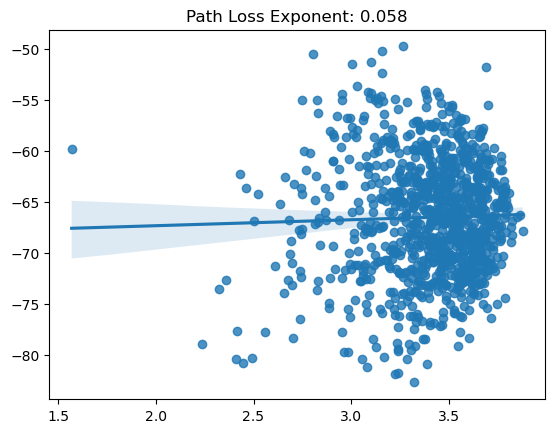

[6/20]: loss_d: 0.503, loss_g: 0.979, acc_real: 0.715, acc_fake: 0.628
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


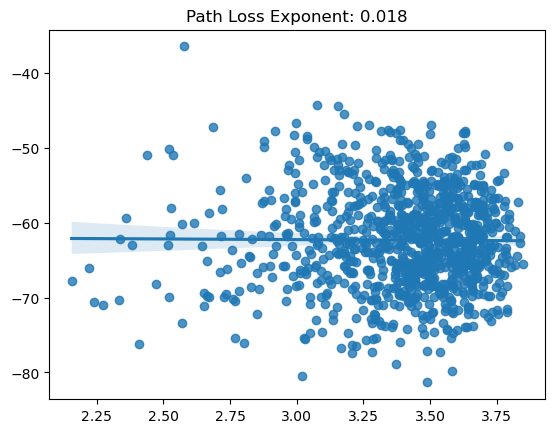

[7/20]: loss_d: 0.434, loss_g: 1.110, acc_real: 0.739, acc_fake: 0.651
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


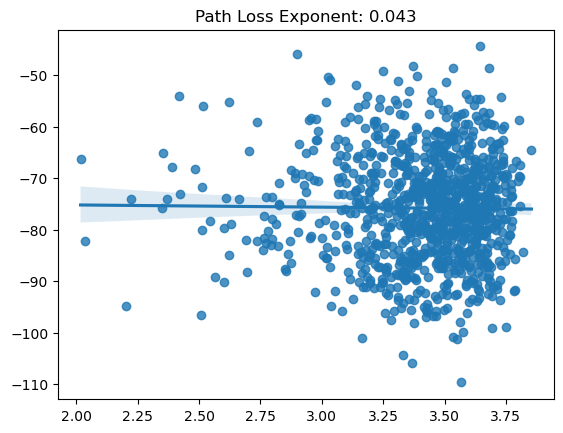

[8/20]: loss_d: 0.356, loss_g: 1.542, acc_real: 0.757, acc_fake: 0.675
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


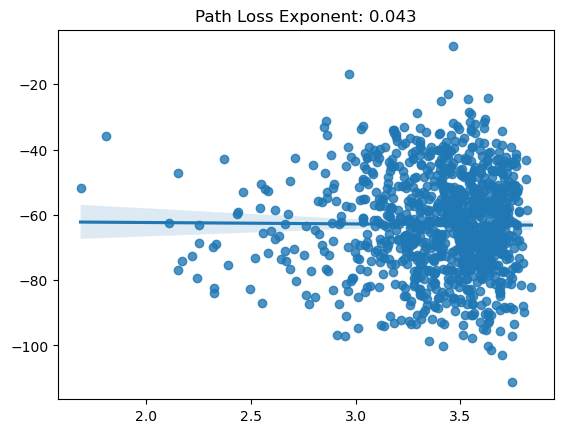

[9/20]: loss_d: 0.292, loss_g: 1.972, acc_real: 0.775, acc_fake: 0.696
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


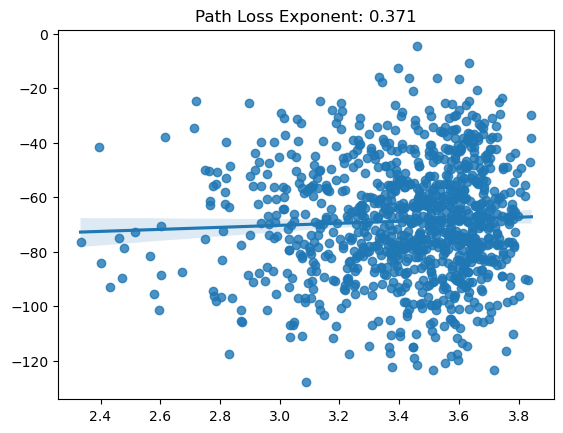

[10/20]: loss_d: 0.240, loss_g: 2.564, acc_real: 0.791, acc_fake: 0.715
0.0


ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "C:\Users\serha\anaconda3\lib\site-packages\IPython\core\interactiveshell.py", line 3457, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "C:\Users\serha\AppData\Local\Temp\ipykernel_10512\911291572.py", line 106, in <module>
    discriminator_output_for_true_data = discriminator(true_data, cond_info).view(batch_size)
  File "C:\Users\serha\anaconda3\lib\site-packages\torch\nn\modules\module.py", line 1501, in _call_impl
    return forward_call(*args, **kwargs)
  File "C:\Users\serha\AppData\Local\Temp\ipykernel_10512\911291572.py", line 57, in forward
    x_out = self.sigm(self.ae(x[:, 4:]))
  File "C:\Users\serha\anaconda3\lib\site-packages\torch\nn\modules\module.py", line 1501, in _call_impl
    return forward_call(*args, **kwargs)
  File "C:\Users\serha\anaconda3\lib\site-packages\torch\nn\modules\container.py", line 217, in forward
    input = module(input)
  File "C:\Users\serha\anaconda3\lib\site-packages\torch\

TypeError: object of type 'NoneType' has no len()

In [17]:
import seaborn as sns
def accuracy(output, target, threshold=0.5):
    with torch.no_grad():
        prediction = (output >= threshold).float()
        correct = (prediction == target).float().sum()
        accuracy = correct / len(target)
        return accuracy.item()


class GeneratorModel(nn.Module):
    def __init__(self):
        super(GeneratorModel, self).__init__()
        embed_dim = 8
        input_dim = 20 + 4 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 16),
            nn.ReLU()
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(16, output_dim)
        )

        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        info_out = self.sigm(self.ae(info[:, 4:]))
        x = torch.cat([x, info[:, :4], info_out], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


class DiscriminatorModel(nn.Module):
    def __init__(self):
        super(DiscriminatorModel, self).__init__()
        embed_dim = 8
        input_dim = 1 + 4 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim),
            nn.Sigmoid()
        )
        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        x_out = self.sigm(self.ae(x[:, 4:]))
        x = torch.cat([x[:, :4], x_out, info], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


discriminator = DiscriminatorModel()
generator = GeneratorModel()
discriminator.to(device)
generator.to(device)

discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
generator_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

loss = nn.BCELoss()
noise_dim = 20
n_epochs = 20
batch_size = training_parameters["batch_size"]
G_loss_mean = []
D_loss_mean = []
D_real_mean = []
D_fake_mean = []
accuracy_real = []
accuracy_real_mean = []
accuracy_fake = []
accuracy_fake_mean = []
for epoch_idx in range(n_epochs):
    G_loss = []
    D_loss = []
    D_real = []
    D_fake = []
    for batch_idx, data_input in enumerate(train_ldr):
        if data_input[1].shape[0]!=batch_size and batch_idx==len(train_ldr)-1:
            continue
        if batch_idx%100 == 0:
            print(batch_idx/len(train_ldr))
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,4005)).to(device)
        generated_data = generator(noise, fake_info)  # batch_size X 784

        # Discriminator
        true_data = data_input[0].view(batch_size, 4005).to(device)  # batch_size X 784
        cond_info = data_input[1].to(device)  # batch_size
        true_labels = torch.ones(batch_size).to(device)

        discriminator_optimizer.zero_grad()

        discriminator_output_for_true_data = discriminator(true_data, cond_info).view(batch_size)
        true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)
        acc_real = accuracy(discriminator_output_for_true_data, true_labels)
        discriminator_output_for_generated_data = discriminator(fake_info, generated_data.detach()).view(batch_size)
        generator_discriminator_loss = loss(
            discriminator_output_for_generated_data, torch.zeros(batch_size).to(device)
        )
        acc_fake = accuracy(discriminator_output_for_generated_data, torch.zeros(batch_size).to(device))
        discriminator_loss = (
                                     true_discriminator_loss + generator_discriminator_loss
                             ) / 2

        discriminator_loss.backward()
        discriminator_optimizer.step()

        D_loss.append(discriminator_loss.data.item())
        D_real.append(true_discriminator_loss)
        D_fake.append(generator_discriminator_loss)
        accuracy_real.append(acc_real)
        accuracy_fake.append(acc_fake)
        # Generator

        generator_optimizer.zero_grad()
        # It's a choice to generate the data again
        generated_data = generator(noise, fake_info)  # batch_size X 784
        discriminator_output_on_generated_data = discriminator(fake_info, generated_data).view(batch_size)
        generator_loss = loss(discriminator_output_on_generated_data, true_labels)
        generator_loss.backward()
        generator_optimizer.step()

        G_loss.append(generator_loss.data.item())


    dist_list =[]
    gan_rss_list = []
    with torch.no_grad():
        noise = torch.randn(1000, noise_dim).to(device)
        fake_info = torch.rand((1000,4005)).to(device)
        generated_data = generator(noise, fake_info).cpu().view(1000, 1)
        for i, x in enumerate(generated_data):
            fake_info_reconst = fake_info[i].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= (max_elev-min_elev)
            fake_info_reconst[4:] += min_elev 

            dist_list.append(find_dist(fake_info_reconst, 0.5))
            gan_rss_list.append(x.detach().numpy()[0])

    a, b = np.polyfit(np.log10(dist_list), gan_rss_list, 1)
    plt.figure()
    sns.regplot(x=np.log10(dist_list), y=gan_rss_list)
    plt.title("Path Loss Exponent: %.3f" %abs(a/10))
    plt.show()
    '''
    with torch.no_grad():
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,18337)).to(device)
        generated_data = generator(noise, fake_info).cpu().view(batch_size, 1)
        for x in generated_data:
            fake_info_reconst = fake_info[0].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= max_elev
            print(fake_info_reconst)
            print(x.detach().numpy())
            #plt.imshow(x.detach().numpy(), interpolation='nearest', cmap='gray')
            #plt.show()

            break
    '''
    print('[%d/%d]: loss_d: %.3f, loss_g: %.3f, acc_real: %.3f, acc_fake: %.3f' % (
        (epoch_idx), n_epochs, torch.mean(torch.FloatTensor(D_loss)), torch.mean(torch.FloatTensor(G_loss)), torch.mean(torch.FloatTensor(accuracy_real)), torch.mean(torch.FloatTensor(accuracy_fake))))
    G_loss_mean.append(torch.mean(torch.FloatTensor(G_loss)))
    D_loss_mean.append(torch.mean(torch.FloatTensor(D_loss)))
    D_real_mean.append(torch.mean(torch.FloatTensor(D_real)))
    D_fake_mean.append(torch.mean(torch.FloatTensor(D_fake)))
    accuracy_real_mean.append(torch.mean(torch.FloatTensor(accuracy_real)))
    accuracy_fake_mean.append(torch.mean(torch.FloatTensor(accuracy_fake)))


## Try the difference between coords rather than coords themselves

0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


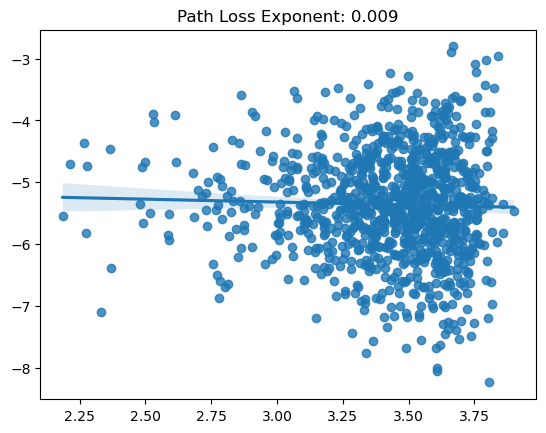

[0/20]: loss_d: 0.715, loss_g: 0.661, acc_real: 0.764, acc_fake: 0.334
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


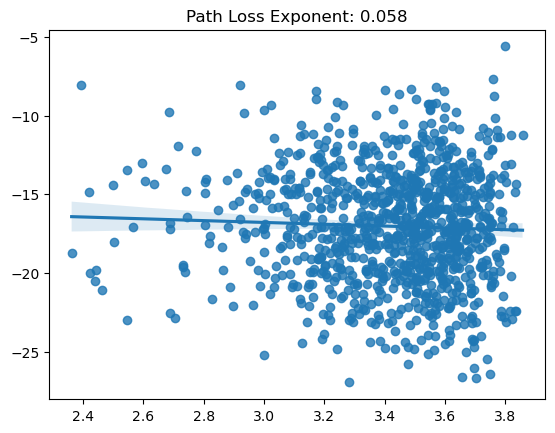

[1/20]: loss_d: 0.356, loss_g: 0.833, acc_real: 0.860, acc_fake: 0.531
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


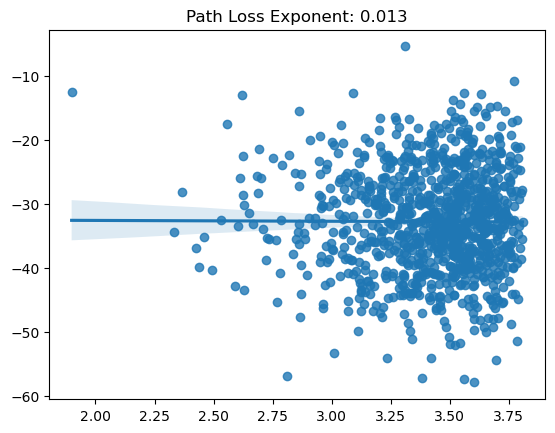

[2/20]: loss_d: 0.339, loss_g: 1.102, acc_real: 0.876, acc_fake: 0.630
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


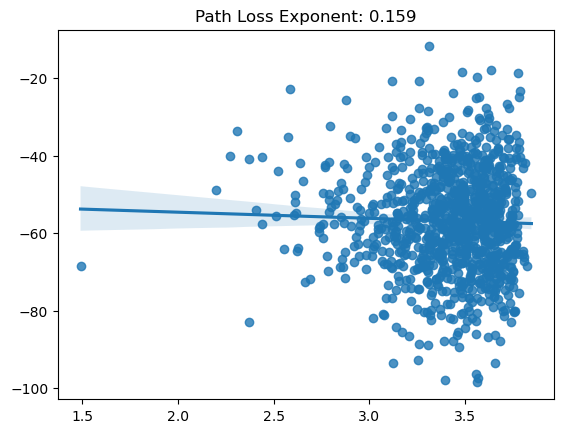

[3/20]: loss_d: 0.427, loss_g: 1.225, acc_real: 0.856, acc_fake: 0.682
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


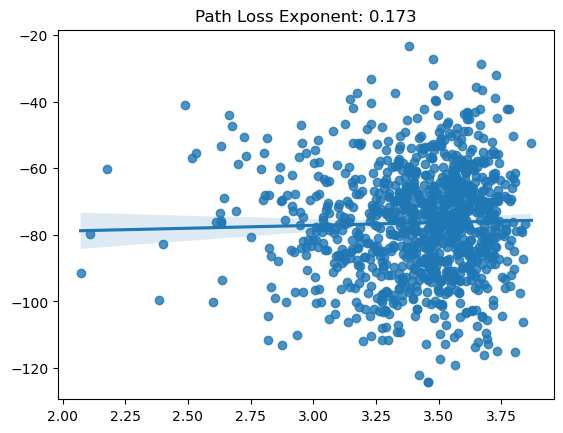

[4/20]: loss_d: 0.642, loss_g: 0.937, acc_real: 0.800, acc_fake: 0.691
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


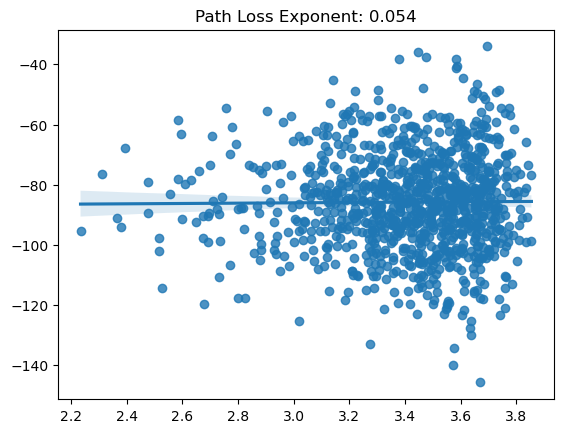

[5/20]: loss_d: 0.718, loss_g: 0.750, acc_real: 0.724, acc_fake: 0.683
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


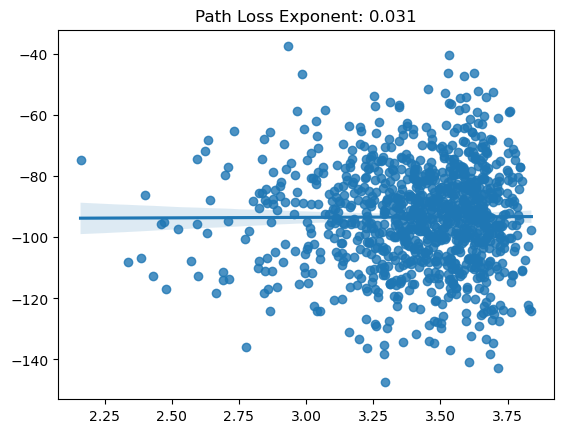

[6/20]: loss_d: 0.721, loss_g: 0.752, acc_real: 0.643, acc_fake: 0.689
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


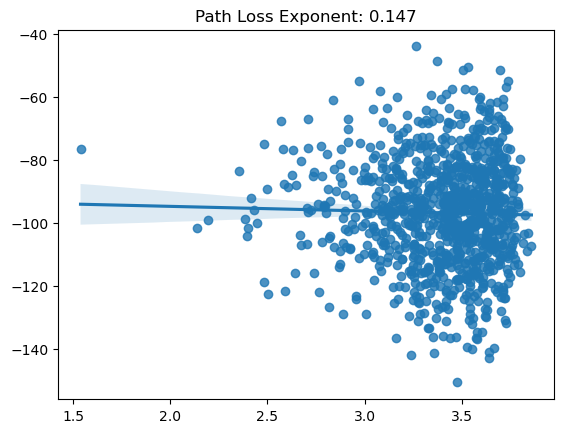

[7/20]: loss_d: 0.702, loss_g: 0.787, acc_real: 0.572, acc_fake: 0.712
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


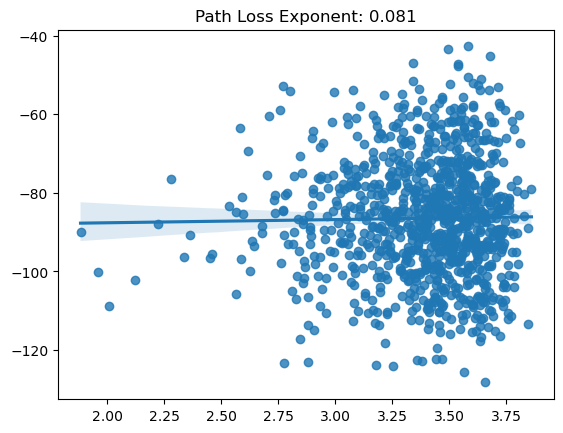

[8/20]: loss_d: 0.661, loss_g: 0.816, acc_real: 0.547, acc_fake: 0.717
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


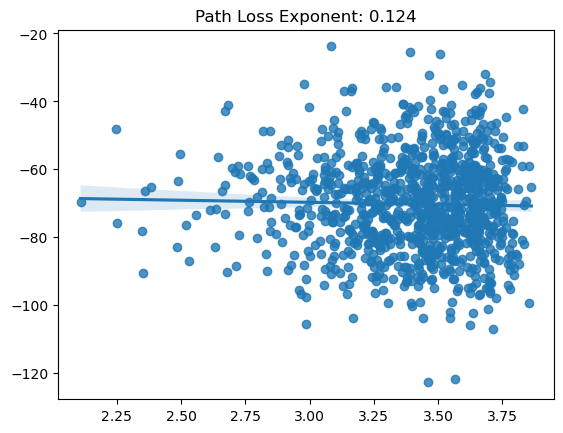

[9/20]: loss_d: 0.650, loss_g: 0.783, acc_real: 0.575, acc_fake: 0.691
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


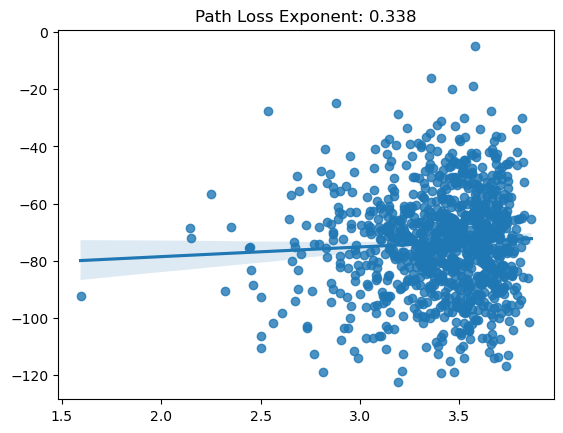

[10/20]: loss_d: 0.638, loss_g: 0.817, acc_real: 0.607, acc_fake: 0.666
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


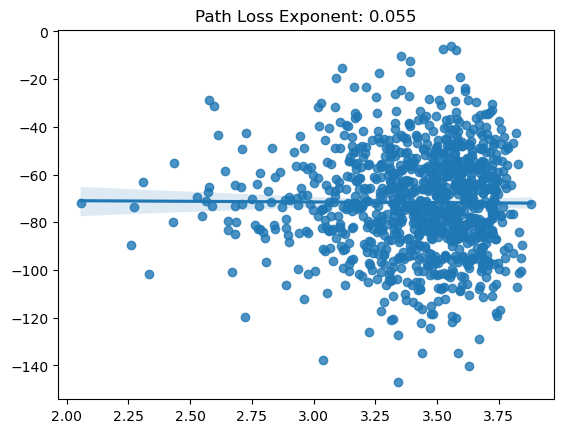

[11/20]: loss_d: 0.631, loss_g: 0.927, acc_real: 0.630, acc_fake: 0.648
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


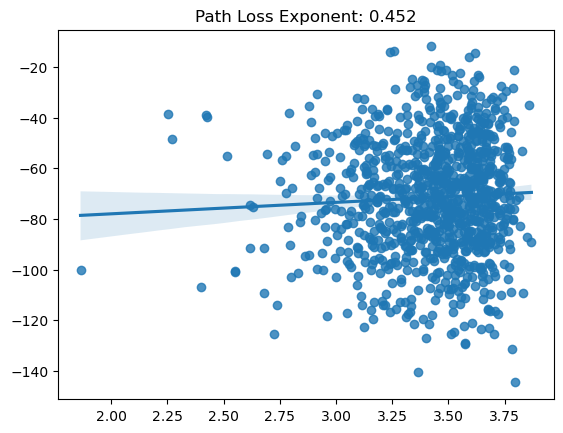

[12/20]: loss_d: 0.626, loss_g: 0.970, acc_real: 0.651, acc_fake: 0.632
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


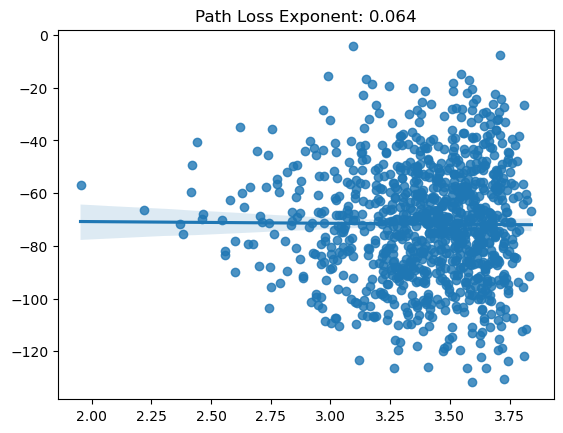

[13/20]: loss_d: 0.622, loss_g: 1.042, acc_real: 0.669, acc_fake: 0.619
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


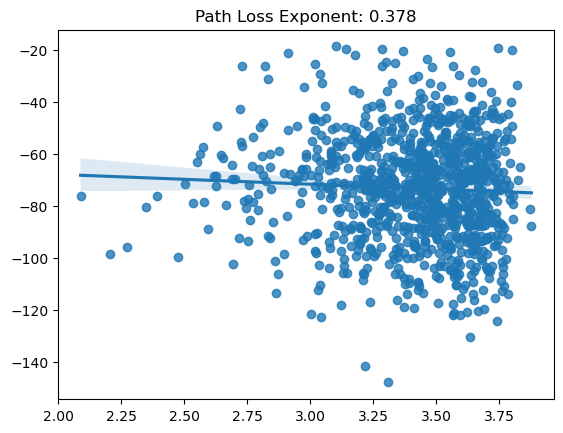

[14/20]: loss_d: 0.621, loss_g: 1.087, acc_real: 0.685, acc_fake: 0.608
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


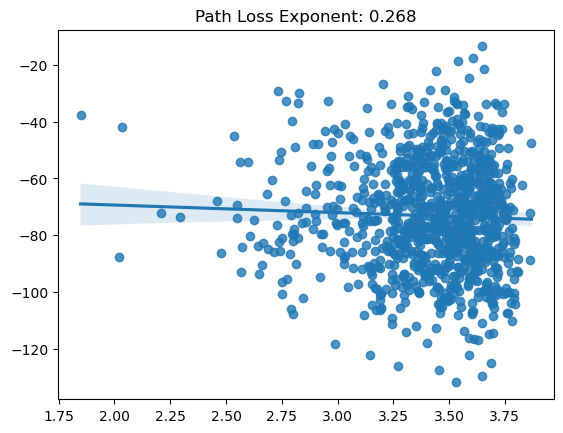

[15/20]: loss_d: 0.619, loss_g: 1.128, acc_real: 0.698, acc_fake: 0.598
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


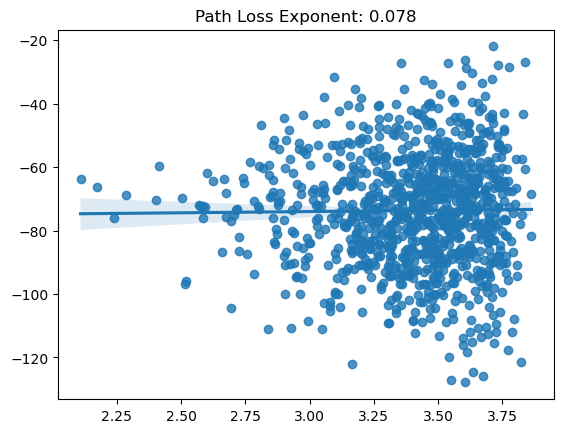

[16/20]: loss_d: 0.617, loss_g: 1.152, acc_real: 0.710, acc_fake: 0.589
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


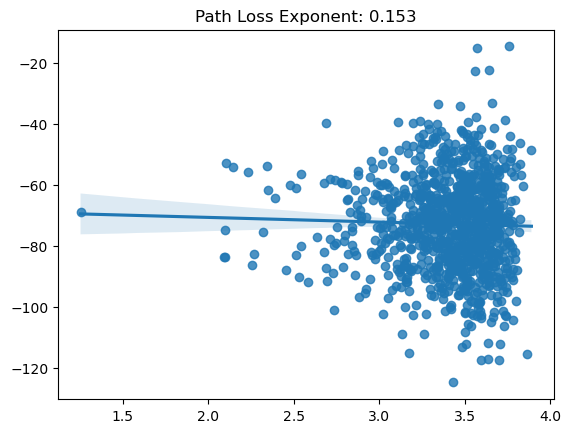

[17/20]: loss_d: 0.611, loss_g: 1.156, acc_real: 0.721, acc_fake: 0.581
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


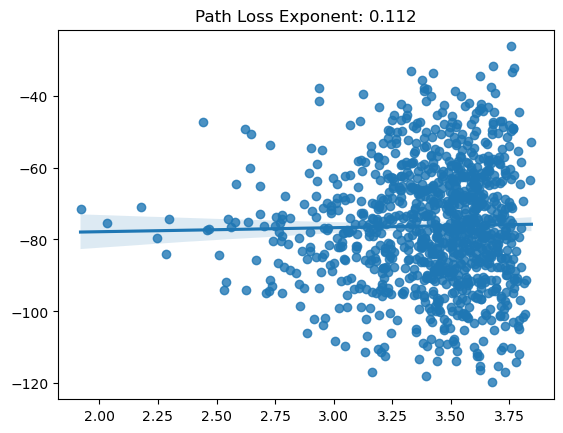

[18/20]: loss_d: 0.597, loss_g: 1.189, acc_real: 0.731, acc_fake: 0.575
0.0
0.12468827930174564
0.24937655860349128
0.3740648379052369
0.49875311720698257
0.6234413965087282
0.7481296758104738
0.8728179551122195
0.9975062344139651


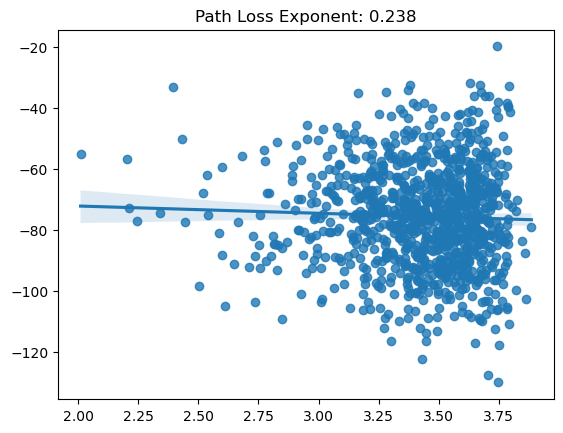

[19/20]: loss_d: 0.583, loss_g: 1.234, acc_real: 0.740, acc_fake: 0.571


In [25]:
import seaborn as sns
def accuracy(output, target, threshold=0.5):
    with torch.no_grad():
        prediction = (output >= threshold).float()
        correct = (prediction == target).float().sum()
        accuracy = correct / len(target)
        return accuracy.item()


class GeneratorModel(nn.Module):
    def __init__(self):
        super(GeneratorModel, self).__init__()
        embed_dim = 8
        input_dim = 20 + 2 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 16),
            nn.LeakyReLU(0.2)
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(16, output_dim)
        )

        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        info_out = self.sigm(self.ae(info[:, 4:]))
        x = torch.cat([x, torch.abs(info[:,2]-info[:, 0]).unsqueeze(1), torch.abs(info[:, 3]-info[:, 1]).unsqueeze(1), info_out], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


class DiscriminatorModel(nn.Module):
    def __init__(self):
        super(DiscriminatorModel, self).__init__()
        embed_dim = 8
        input_dim = 1 + 2 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim),
            nn.Sigmoid()
        )
        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        x_out = self.sigm(self.ae(x[:, 4:]))
        x = torch.cat([torch.abs(x[:,2]-x[:, 0]).unsqueeze(1), torch.abs(x[:, 3]-x[:, 1]).unsqueeze(1), x_out, info], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


discriminator = DiscriminatorModel()
generator = GeneratorModel()
discriminator.to(device)
generator.to(device)

discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
generator_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

loss = nn.BCELoss()
noise_dim = 20
n_epochs = 20
batch_size = training_parameters["batch_size"]
G_loss_mean = []
D_loss_mean = []
D_real_mean = []
D_fake_mean = []
accuracy_real = []
accuracy_real_mean = []
accuracy_fake = []
accuracy_fake_mean = []
for epoch_idx in range(n_epochs):
    G_loss = []
    D_loss = []
    D_real = []
    D_fake = []
    for batch_idx, data_input in enumerate(train_ldr):
        if data_input[1].shape[0]!=batch_size and batch_idx==len(train_ldr)-1:
            continue
        if batch_idx%100 == 0:
            print(batch_idx/len(train_ldr))
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,4005)).to(device)
        generated_data = generator(noise, fake_info)  # batch_size X 784

        # Discriminator
        true_data = data_input[0].view(batch_size, 4005).to(device)  # batch_size X 784
        cond_info = data_input[1].to(device)  # batch_size
        true_labels = torch.ones(batch_size).to(device)

        discriminator_optimizer.zero_grad()

        discriminator_output_for_true_data = discriminator(true_data, cond_info).view(batch_size)
        true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)
        acc_real = accuracy(discriminator_output_for_true_data, true_labels)
        discriminator_output_for_generated_data = discriminator(fake_info, generated_data.detach()).view(batch_size)
        generator_discriminator_loss = loss(
            discriminator_output_for_generated_data, torch.zeros(batch_size).to(device)
        )
        acc_fake = accuracy(discriminator_output_for_generated_data, torch.zeros(batch_size).to(device))
        discriminator_loss = (
                                     true_discriminator_loss + generator_discriminator_loss
                             ) / 2

        discriminator_loss.backward()
        discriminator_optimizer.step()

        D_loss.append(discriminator_loss.data.item())
        D_real.append(true_discriminator_loss)
        D_fake.append(generator_discriminator_loss)
        accuracy_real.append(acc_real)
        accuracy_fake.append(acc_fake)
        # Generator

        generator_optimizer.zero_grad()
        # It's a choice to generate the data again
        generated_data = generator(noise, fake_info)  # batch_size X 784
        discriminator_output_on_generated_data = discriminator(fake_info, generated_data).view(batch_size)
        generator_loss = loss(discriminator_output_on_generated_data, true_labels)
        generator_loss.backward()
        generator_optimizer.step()

        G_loss.append(generator_loss.data.item())


    dist_list =[]
    gan_rss_list = []
    with torch.no_grad():
        noise = torch.randn(1000, noise_dim).to(device)
        fake_info = torch.rand((1000,4005)).to(device)
        generated_data = generator(noise, fake_info).cpu().view(1000, 1)
        for i, x in enumerate(generated_data):
            fake_info_reconst = fake_info[i].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= (max_elev-min_elev)
            fake_info_reconst[4:] += min_elev 

            dist_list.append(find_dist(fake_info_reconst, 0.5))
            gan_rss_list.append(x.detach().numpy()[0])

    a, b = np.polyfit(np.log10(dist_list), gan_rss_list, 1)
    plt.figure()
    sns.regplot(x=np.log10(dist_list), y=gan_rss_list)
    plt.title("Path Loss Exponent: %.3f" %abs(a/10))
    plt.show()
    '''
    with torch.no_grad():
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,18337)).to(device)
        generated_data = generator(noise, fake_info).cpu().view(batch_size, 1)
        for x in generated_data:
            fake_info_reconst = fake_info[0].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= max_elev
            print(fake_info_reconst)
            print(x.detach().numpy())
            #plt.imshow(x.detach().numpy(), interpolation='nearest', cmap='gray')
            #plt.show()

            break
    '''
    print('[%d/%d]: loss_d: %.3f, loss_g: %.3f, acc_real: %.3f, acc_fake: %.3f' % (
        (epoch_idx), n_epochs, torch.mean(torch.FloatTensor(D_loss)), torch.mean(torch.FloatTensor(G_loss)), torch.mean(torch.FloatTensor(accuracy_real)), torch.mean(torch.FloatTensor(accuracy_fake))))
    G_loss_mean.append(torch.mean(torch.FloatTensor(G_loss)))
    D_loss_mean.append(torch.mean(torch.FloatTensor(D_loss)))
    D_real_mean.append(torch.mean(torch.FloatTensor(D_real)))
    D_fake_mean.append(torch.mean(torch.FloatTensor(D_fake)))
    accuracy_real_mean.append(torch.mean(torch.FloatTensor(accuracy_real)))
    accuracy_fake_mean.append(torch.mean(torch.FloatTensor(accuracy_fake)))


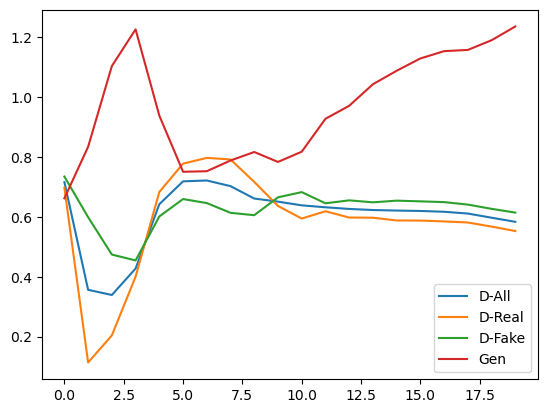

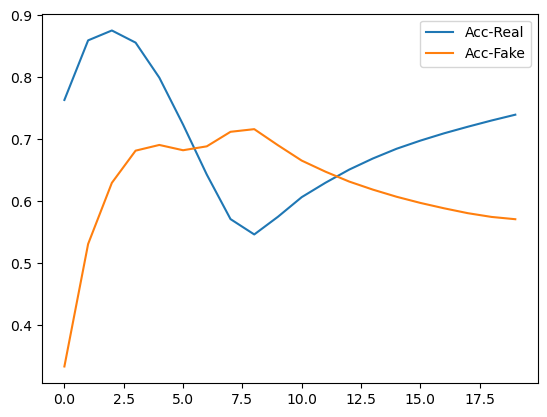

In [26]:
import matplotlib.pyplot as plt
plt.figure()
plt.plot(D_loss_mean)
plt.plot(D_real_mean)
plt.plot(D_fake_mean)
plt.plot(G_loss_mean)
plt.legend(["D-All", "D-Real", "D-Fake", "Gen"])
plt.show()

plt.figure()
plt.plot(accuracy_real_mean)
plt.plot(accuracy_fake_mean)
plt.legend(["Acc-Real", "Acc-Fake"])
plt.show()


In [39]:
def find_dist(l, cellsize):
    a = np.linalg.norm((l[2]-l[0])*cellsize)**2 + np.linalg.norm((l[3]-l[1])*cellsize)**2
    return np.sqrt(a)

In [ ]:
'''
import numpy as np

# Number of samples
num_samples = 1000

# Generate random numbers from a uniform distribution
uniform_samples = np.random.rand(num_samples)

# Apply the inverse of the desired distribution's CDF
# For a logarithmic distribution, you can use the inverse CDF: x = -log(1 - uniform_samples)
logarithmic_samples = -np.log(1 - uniform_samples)

# For an exponential distribution, you can use the inverse CDF: x = -log(uniform_samples)
exponential_samples = -np.log(uniform_samples)

# Normalize the samples to be between 0 and 1
logarithmic_samples /= np.max(logarithmic_samples)
exponential_samples /= np.max(exponential_samples)

# Print the generated samples
print("Logarithmic Samples:")
print(logarithmic_samples)

print("Exponential Samples:")
print(exponential_samples)
'''


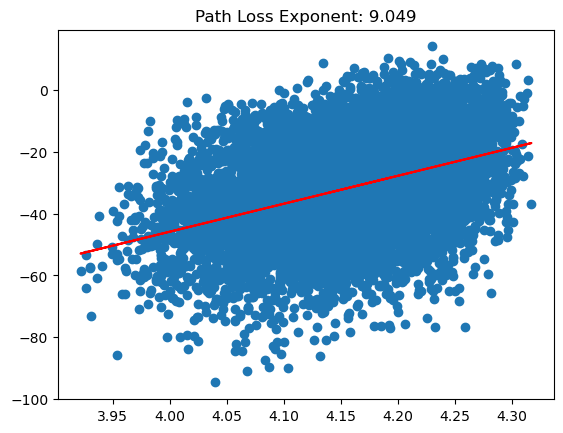

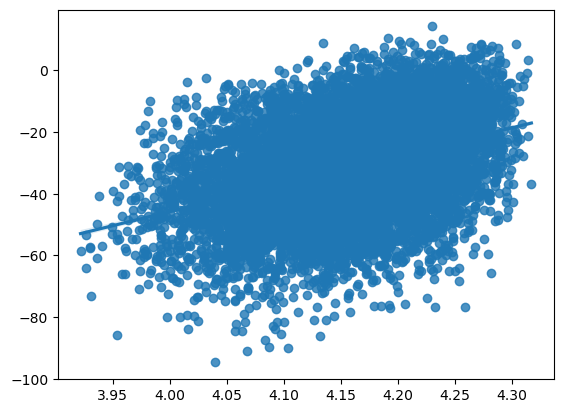

In [49]:
import seaborn as sns
#10 ** random.uniform(np.log10(min), np.log10(max))

dist_list =[]
gan_rss_list = []
with torch.no_grad():
    noise = torch.randn(10000, noise_dim).to(device)
    fake_info = torch.rand((10000,4005)).to(device)
    fake_info[:, [0,1]] = torch.zeros(10000, 2)
    fake_info[:, 2] += torch.logspace(0, 0.2, 10000)
    fake_info[:, 3] += torch.logspace(0, 0.2, 10000)
    generated_data = generator(noise, fake_info).cpu().view(10000, 1)
    for i, x in enumerate(generated_data):
        fake_info_reconst = fake_info[i].detach().numpy()
        fake_info_reconst[0] *=max_x_coord
        fake_info_reconst[1] *=max_y_coord
        fake_info_reconst[2] *=max_x_coord
        fake_info_reconst[3] *=max_y_coord
        fake_info_reconst[4:] *= (max_elev-min_elev)
        fake_info_reconst[4:] += min_elev 

        dist_list.append(find_dist(fake_info_reconst, 0.5))
        gan_rss_list.append(x.detach().numpy()[0])

plt.figure()
x=np.log10(dist_list)
y=gan_rss_list
a, b = np.polyfit(x, y, 1)
#add points to plot
plt.scatter(x, y)
#add line of best fit to plot
plt.plot(x, a*x+b, 'r')

plt.title("Path Loss Exponent: %.3f" % abs(a/10))
plt.show()

plt.figure()
sns.regplot(x=x, y=y)
#add line of best fit to plot
plt.show()

## Put Abs in Relative Coords

0.0


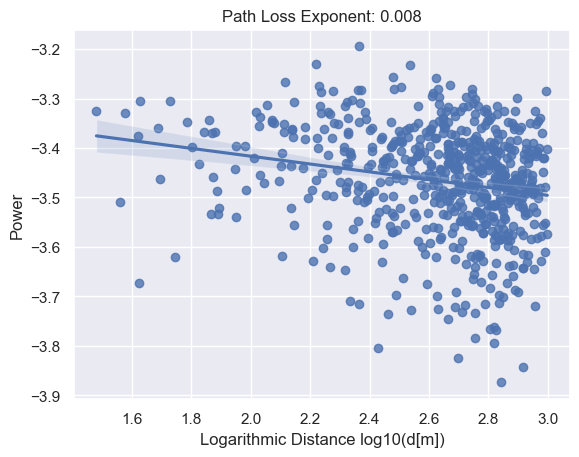

[0/100]: loss_d: 2.728, loss_g: 0.532, acc_real: 0.180, acc_fake: 0.000
0.0


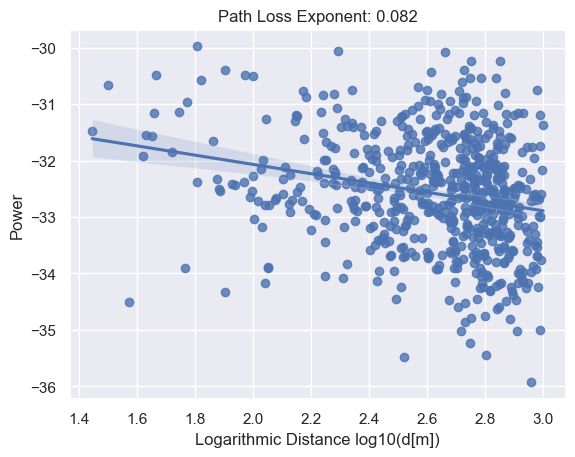

[1/100]: loss_d: 1.140, loss_g: 0.516, acc_real: 0.411, acc_fake: 0.104
0.0


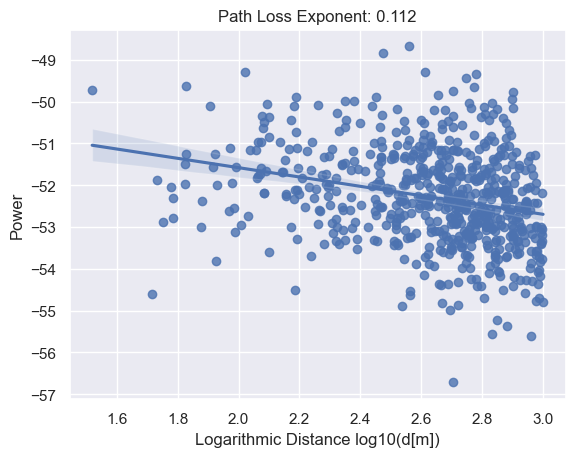

[2/100]: loss_d: 1.085, loss_g: 0.656, acc_real: 0.484, acc_fake: 0.195
0.0


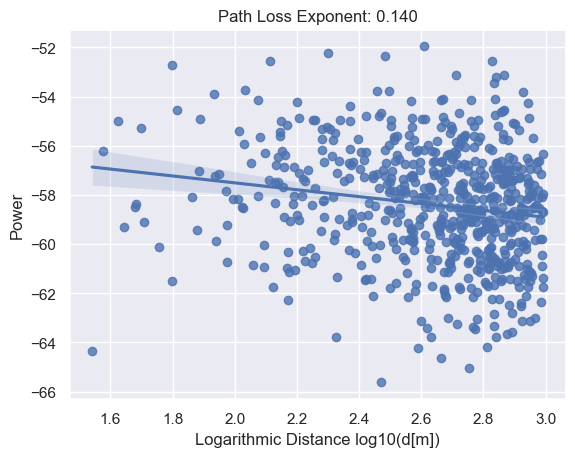

[3/100]: loss_d: 1.036, loss_g: 0.792, acc_real: 0.509, acc_fake: 0.284
0.0


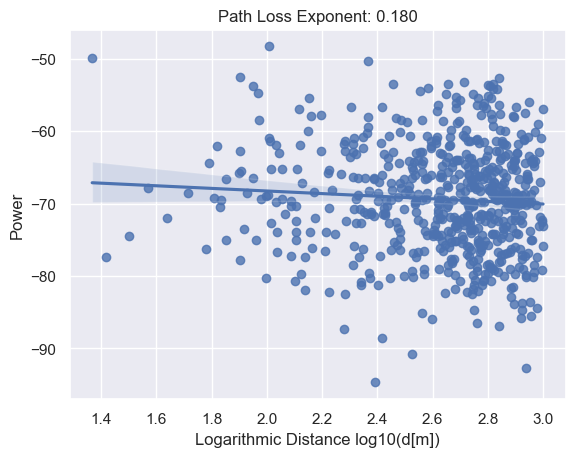

[4/100]: loss_d: 0.968, loss_g: 0.841, acc_real: 0.531, acc_fake: 0.357
0.0


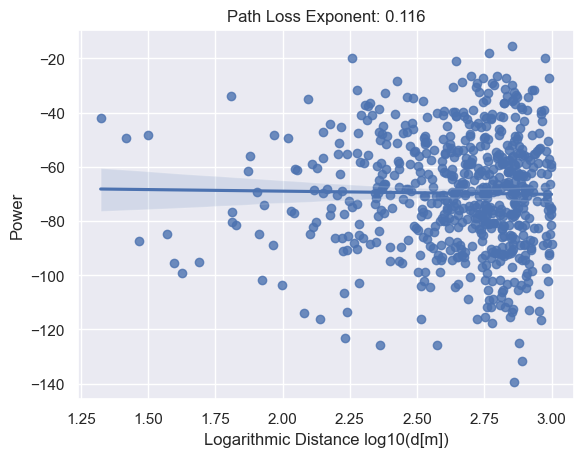

[5/100]: loss_d: 0.930, loss_g: 0.836, acc_real: 0.559, acc_fake: 0.411
0.0


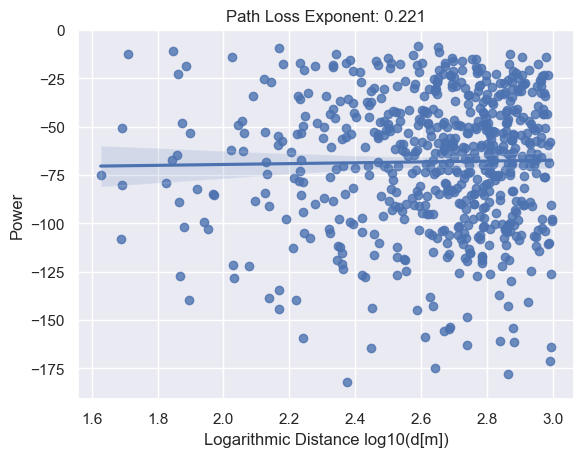

[6/100]: loss_d: 0.909, loss_g: 0.853, acc_real: 0.590, acc_fake: 0.452
0.0


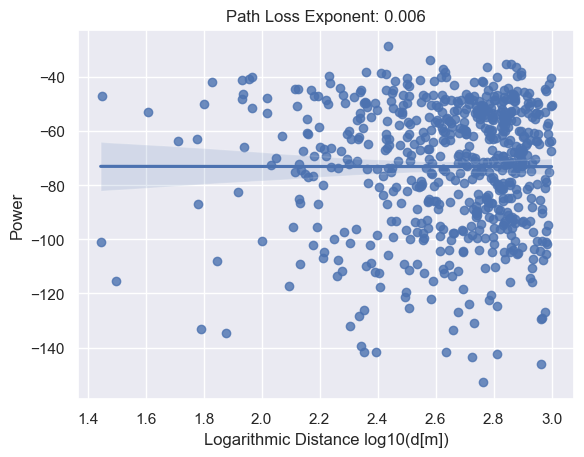

[7/100]: loss_d: 0.872, loss_g: 0.955, acc_real: 0.616, acc_fake: 0.491
0.0


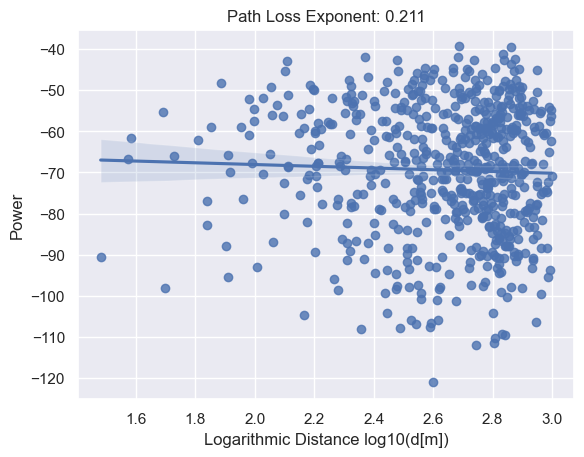

[8/100]: loss_d: 0.832, loss_g: 1.057, acc_real: 0.642, acc_fake: 0.523
0.0


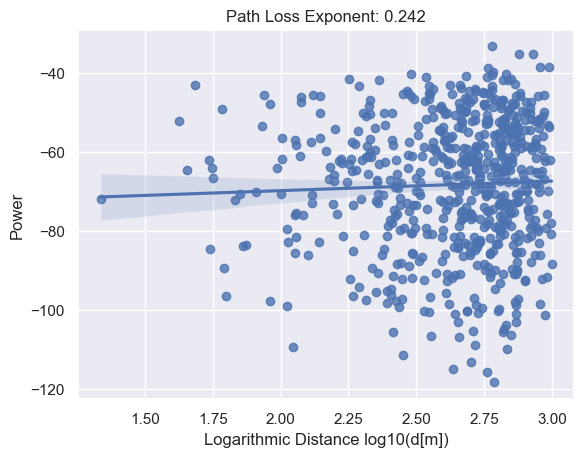

[9/100]: loss_d: 0.792, loss_g: 1.165, acc_real: 0.670, acc_fake: 0.549
0.0


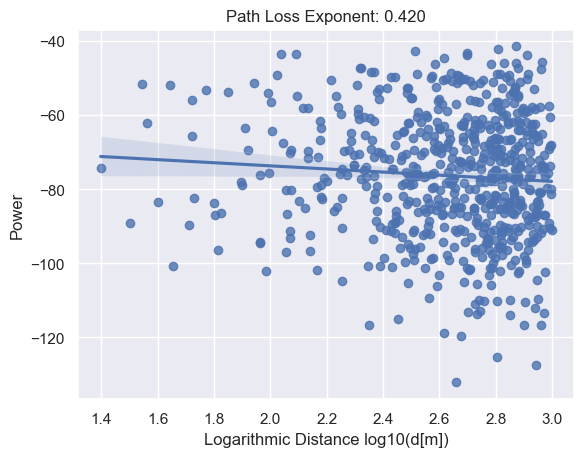

[10/100]: loss_d: 0.751, loss_g: 1.334, acc_real: 0.697, acc_fake: 0.570
0.0


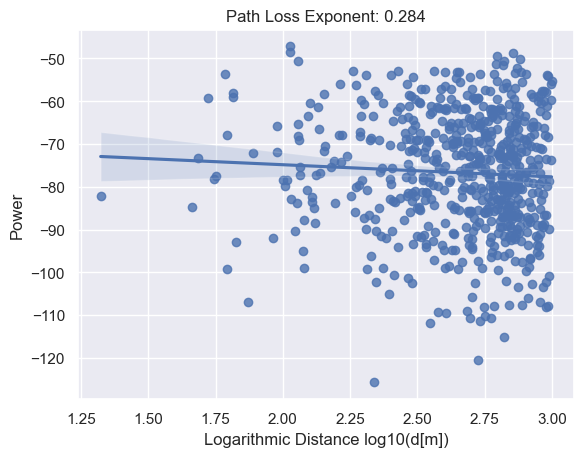

[11/100]: loss_d: 0.714, loss_g: 1.536, acc_real: 0.720, acc_fake: 0.589
0.0


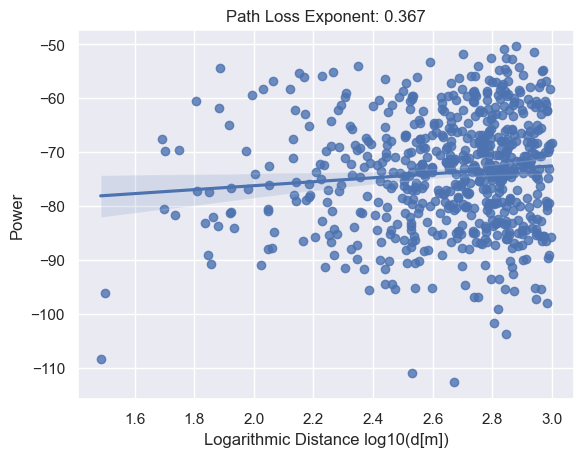

[12/100]: loss_d: 0.676, loss_g: 1.793, acc_real: 0.741, acc_fake: 0.605
0.0


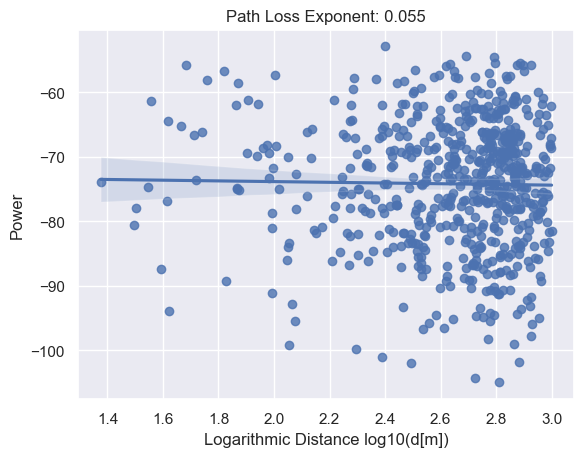

[13/100]: loss_d: 0.640, loss_g: 2.081, acc_real: 0.759, acc_fake: 0.621
0.0


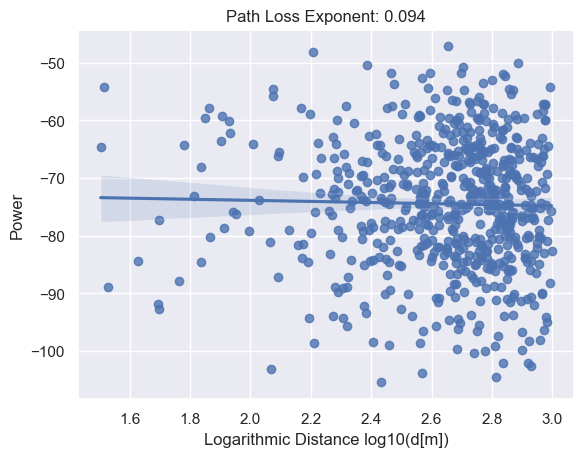

[14/100]: loss_d: 0.611, loss_g: 2.412, acc_real: 0.775, acc_fake: 0.635
0.0


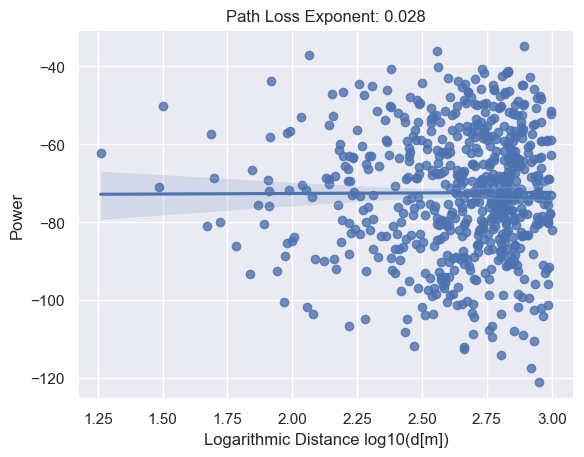

[15/100]: loss_d: 0.586, loss_g: 2.774, acc_real: 0.789, acc_fake: 0.648
0.0


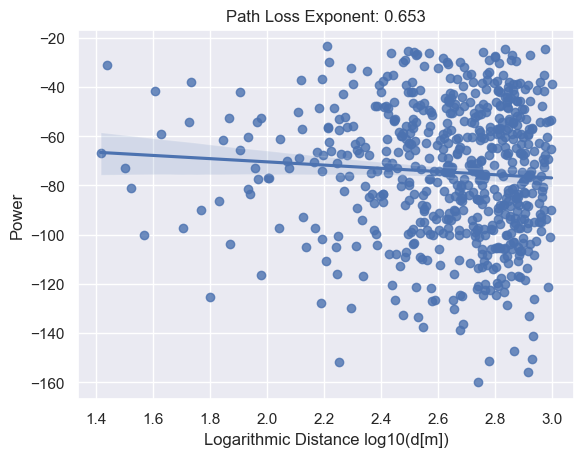

[16/100]: loss_d: 0.563, loss_g: 3.170, acc_real: 0.802, acc_fake: 0.660
0.0


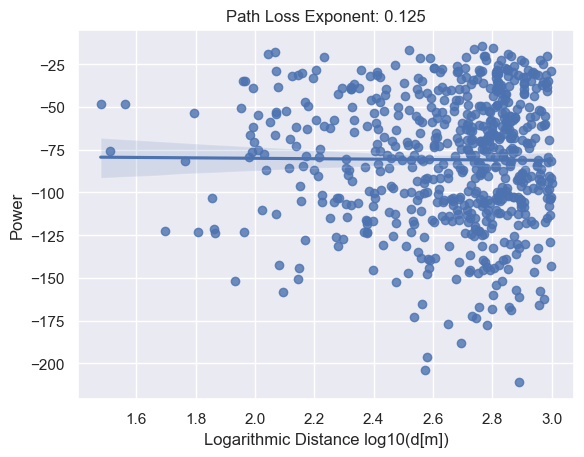

[17/100]: loss_d: 0.544, loss_g: 3.590, acc_real: 0.813, acc_fake: 0.671
0.0


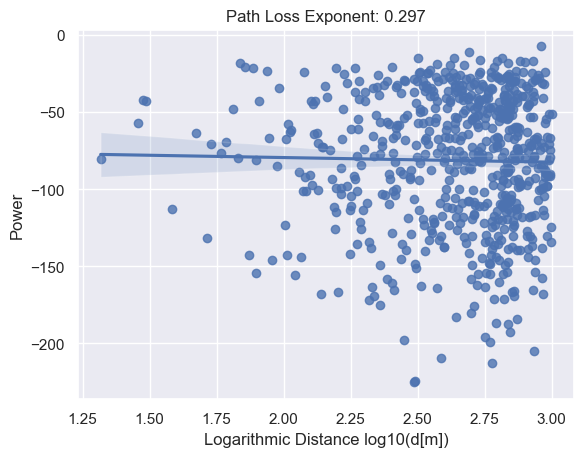

[18/100]: loss_d: 0.530, loss_g: 4.050, acc_real: 0.822, acc_fake: 0.681
0.0


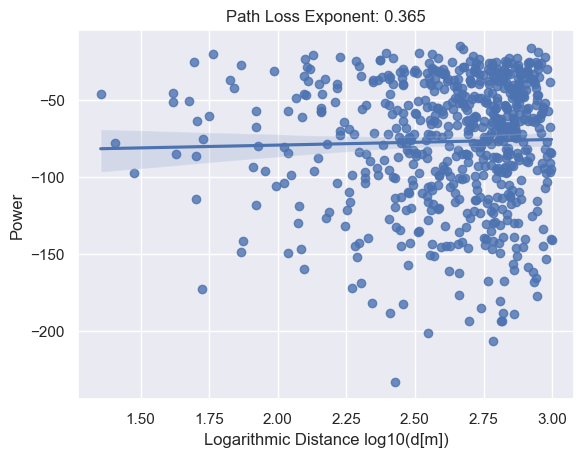

[19/100]: loss_d: 0.518, loss_g: 4.543, acc_real: 0.831, acc_fake: 0.691
0.0


KeyboardInterrupt: 

In [32]:
import seaborn as sns
def accuracy(output, target, threshold=0.5):
    with torch.no_grad():
        prediction = (output >= threshold).float()
        correct = (prediction == target).float().sum()
        accuracy = correct / len(target)
        return accuracy.item()


class GeneratorModel(nn.Module):
    def __init__(self):
        super(GeneratorModel, self).__init__()
        embed_dim = 8
        input_dim = 8 + 2 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 32),
            nn.ReLU()
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(32, 16)
        )
        self.hidden_layer3 = nn.Sequential(
            nn.Linear(16, output_dim)
        )

        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        info_out = self.sigm(self.ae(info[:, 4:]))
        x = torch.cat([x, torch.abs(info[:,2]-info[:, 0]).unsqueeze(1), torch.abs(info[:, 3]-info[:, 1]).unsqueeze(1), info_out], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)
        output = self.hidden_layer3(output)

        return output.to(device)


class DiscriminatorModel(nn.Module):
    def __init__(self):
        super(DiscriminatorModel, self).__init__()
        embed_dim = 8
        input_dim = 1 + 2 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim),
            nn.Sigmoid()
        )
        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        x_out = self.sigm(self.ae(x[:, 4:]))
        x = torch.cat([torch.abs(x[:,2]-x[:, 0]).unsqueeze(1), torch.abs(x[:, 3]-x[:, 1]).unsqueeze(1), x_out, info], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


discriminator = DiscriminatorModel()
generator = GeneratorModel()
discriminator.to(device)
generator.to(device)

discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.0001)
generator_optimizer = optim.Adam(generator.parameters(), lr=0.0003)

loss = nn.BCELoss()
noise_dim = 8
n_epochs = 100
batch_size = 32
G_loss_mean = []
D_loss_mean = []
D_real_mean = []
D_fake_mean = []
accuracy_real = []
accuracy_real_mean = []
accuracy_fake = []
accuracy_fake_mean = []
for epoch_idx in range(n_epochs):
    G_loss = []
    D_loss = []
    D_real = []
    D_fake = []
    for batch_idx, data_input in enumerate(train_ldr):
        if data_input[1].shape[0]!=batch_size and batch_idx==len(train_ldr)-1:
            continue
        if batch_idx%1000 == 0:
            print(batch_idx/len(train_ldr))
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,3005)).to(device)
        generated_data = generator(noise, fake_info)  # batch_size X 784

        # Discriminator
        true_data = data_input[0].view(batch_size, 3005).to(device)  # batch_size X 784
        cond_info = data_input[1].to(device)  # batch_size
        true_labels = torch.ones(batch_size).to(device)

        discriminator_optimizer.zero_grad()

        discriminator_output_for_true_data = discriminator(true_data, cond_info).view(batch_size)
        true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)
        acc_real = accuracy(discriminator_output_for_true_data, true_labels)
        discriminator_output_for_generated_data = discriminator(fake_info, generated_data.detach()).view(batch_size)
        generator_discriminator_loss = loss(
            discriminator_output_for_generated_data, torch.zeros(batch_size).to(device)
        )
        gp = gradient_penalty(discriminator, fake_info, cond_info, generated_data.detach(), batch_size)
        acc_fake = accuracy(discriminator_output_for_generated_data, torch.zeros(batch_size).to(device))
        discriminator_loss = (
                                     true_discriminator_loss + generator_discriminator_loss + 0.6*gp
                             ) / 2

        discriminator_loss.backward()
        discriminator_optimizer.step()

        D_loss.append(discriminator_loss.data.item())
        D_real.append(true_discriminator_loss)
        D_fake.append(generator_discriminator_loss)
        accuracy_real.append(acc_real)
        accuracy_fake.append(acc_fake)
        # Generator

        generator_optimizer.zero_grad()
        # It's a choice to generate the data again
        generated_data = generator(noise, fake_info)  # batch_size X 784
        discriminator_output_on_generated_data = discriminator(fake_info, generated_data).view(batch_size)
        generator_loss = loss(discriminator_output_on_generated_data, true_labels)
        generator_loss.backward()
        generator_optimizer.step()

        G_loss.append(generator_loss.data.item())


    dist_list =[]
    gan_rss_list = []
    with torch.no_grad():
        noise = torch.randn(1000, noise_dim).to(device)
        fake_info = torch.rand((1000,3005)).to(device)
        fake_info[:, [0,1,2,3]] = torch.zeros(1000, 4)
        fake_info[:, 2] = torch.rand((1000,))*0.14 + torch.logspace(-2.5, 0, 1000)
        #fake_info[:, 3] -= torch.logspace(0, 0.6, 1000)
        generated_data = generator(noise, fake_info).cpu().view(1000, 1)
        for i, x in enumerate(generated_data):
            fake_info_reconst = fake_info[i].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= (max_elev-min_elev)
            fake_info_reconst[4:] += min_elev 
            d = find_dist(fake_info_reconst[:4], 0.5)
            if d<1000:
                dist_list.append(d)
                gan_rss_list.append(x.detach().numpy()[0])

            #dist_list.append(find_dist(fake_info_reconst, 0.5))
            #gan_rss_list.append(x.detach().numpy()[0])

    a, b = np.polyfit(np.log10(dist_list), gan_rss_list, 1)
    plt.figure()
    ax = sns.regplot(x=np.log10(dist_list), y=gan_rss_list)
    ax.set_axisbelow(True)
    plt.xlabel("Logarithmic Distance log10(d[m])")
    plt.ylabel("Power")
    plt.title("Path Loss Exponent: %.3f" %abs(a/10))
    plt.grid(True)
    plt.show()
    '''
    with torch.no_grad():
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,18337)).to(device)
        generated_data = generator(noise, fake_info).cpu().view(batch_size, 1)
        for x in generated_data:
            fake_info_reconst = fake_info[0].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= max_elev
            print(fake_info_reconst)
            print(x.detach().numpy())
            #plt.imshow(x.detach().numpy(), interpolation='nearest', cmap='gray')
            #plt.show()

            break
    '''
    print('[%d/%d]: loss_d: %.3f, loss_g: %.3f, acc_real: %.3f, acc_fake: %.3f' % (
        (epoch_idx), n_epochs, torch.mean(torch.FloatTensor(D_loss)), torch.mean(torch.FloatTensor(G_loss)), torch.mean(torch.FloatTensor(accuracy_real)), torch.mean(torch.FloatTensor(accuracy_fake))))
    G_loss_mean.append(torch.mean(torch.FloatTensor(G_loss)))
    D_loss_mean.append(torch.mean(torch.FloatTensor(D_loss)))
    D_real_mean.append(torch.mean(torch.FloatTensor(D_real)))
    D_fake_mean.append(torch.mean(torch.FloatTensor(D_fake)))
    accuracy_real_mean.append(torch.mean(torch.FloatTensor(accuracy_real)))
    accuracy_fake_mean.append(torch.mean(torch.FloatTensor(accuracy_fake)))


## Remove the Elev Array from Conditions

0.0
0.7855459544383346


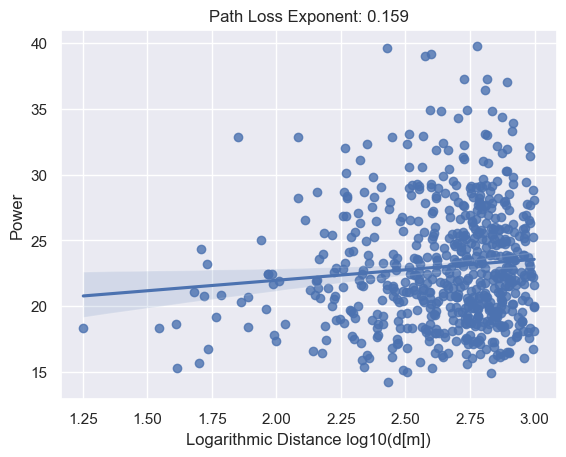

[0/100]: loss_d: 5.994, loss_g: 0.495, acc_real: 0.706, acc_fake: 0.209
0.0
0.7855459544383346


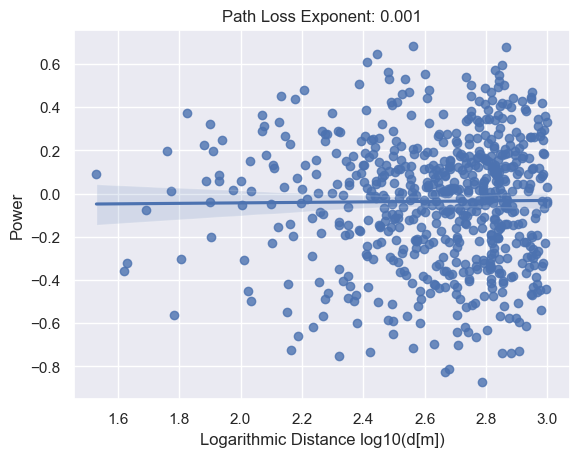

[1/100]: loss_d: 5.414, loss_g: 0.711, acc_real: 0.798, acc_fake: 0.307
0.0
0.7855459544383346


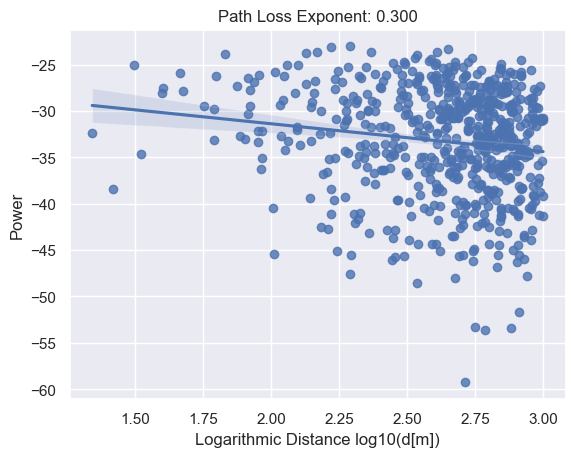

[2/100]: loss_d: 5.948, loss_g: 0.475, acc_real: 0.807, acc_fake: 0.275
0.0
0.7855459544383346


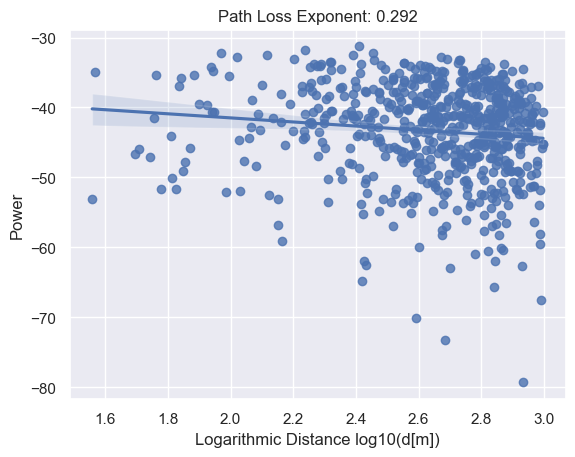

[3/100]: loss_d: 5.800, loss_g: 0.697, acc_real: 0.779, acc_fake: 0.292
0.0
0.7855459544383346


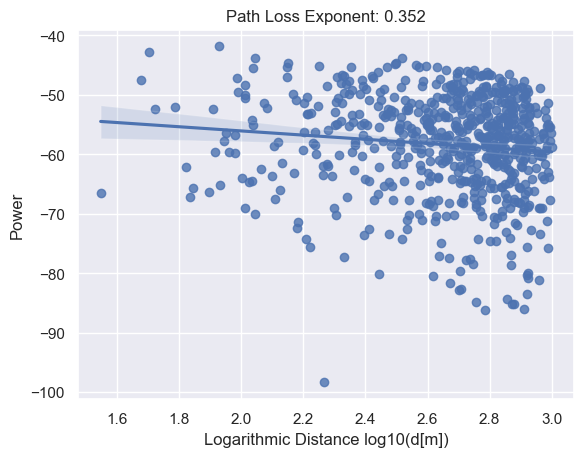

[4/100]: loss_d: 5.735, loss_g: 0.757, acc_real: 0.732, acc_fake: 0.327
0.0
0.7855459544383346


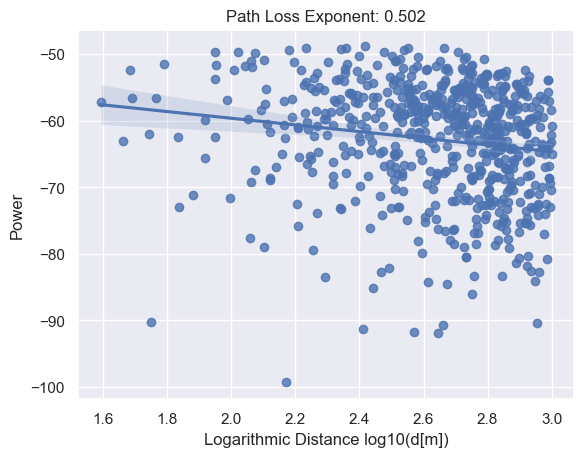

[5/100]: loss_d: 5.704, loss_g: 0.798, acc_real: 0.663, acc_fake: 0.383
0.0
0.7855459544383346


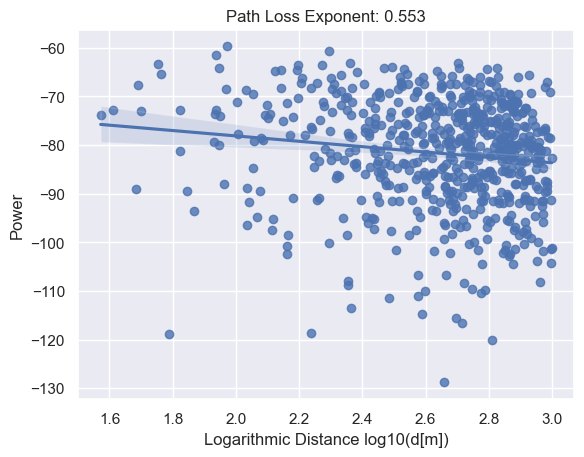

[6/100]: loss_d: 5.684, loss_g: 0.881, acc_real: 0.588, acc_fake: 0.451
0.0
0.7855459544383346


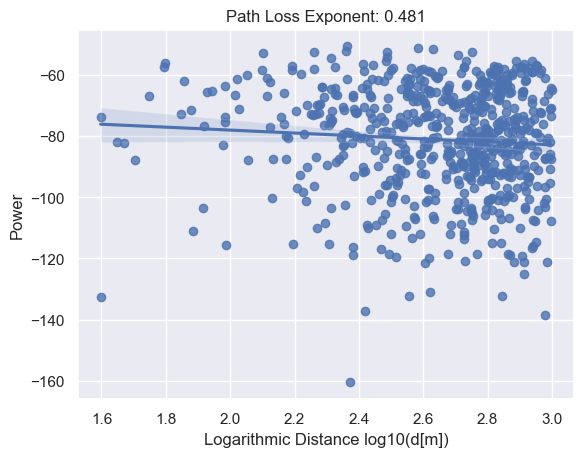

[7/100]: loss_d: 5.670, loss_g: 0.924, acc_real: 0.523, acc_fake: 0.512
0.0
0.7855459544383346


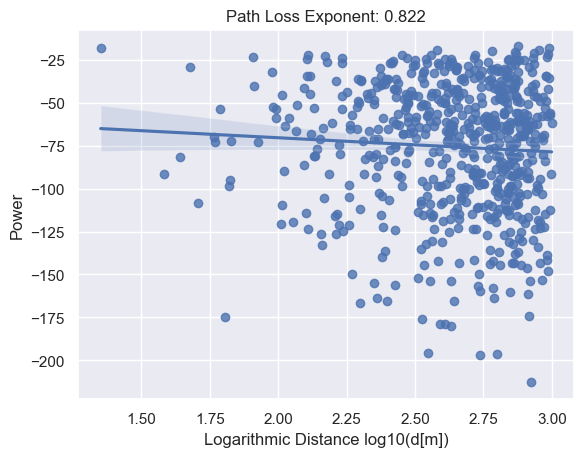

[8/100]: loss_d: 5.661, loss_g: 0.892, acc_real: 0.482, acc_fake: 0.556
0.0
0.7855459544383346


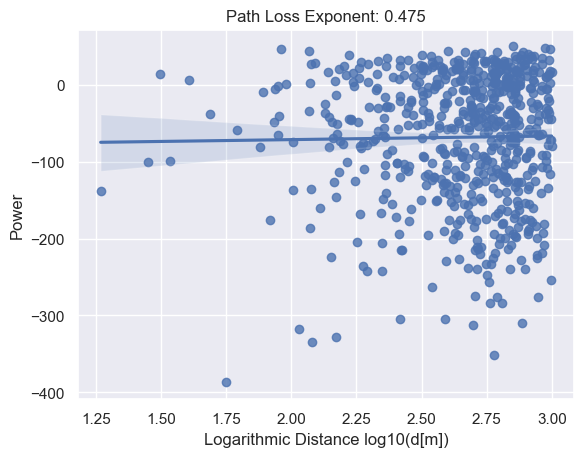

[9/100]: loss_d: 5.675, loss_g: 0.795, acc_real: 0.472, acc_fake: 0.574
0.0
0.7855459544383346


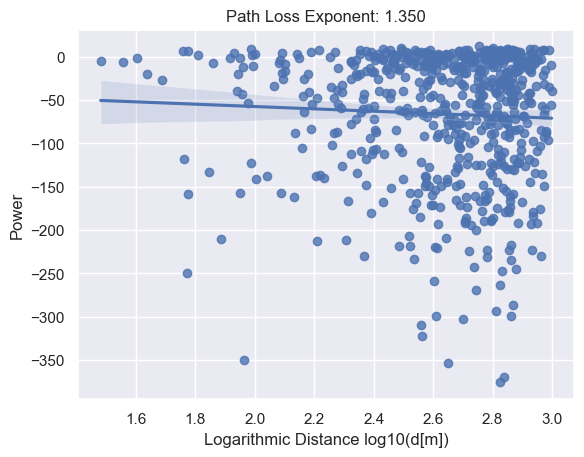

[10/100]: loss_d: 5.682, loss_g: 0.773, acc_real: 0.461, acc_fake: 0.588
0.0
0.7855459544383346


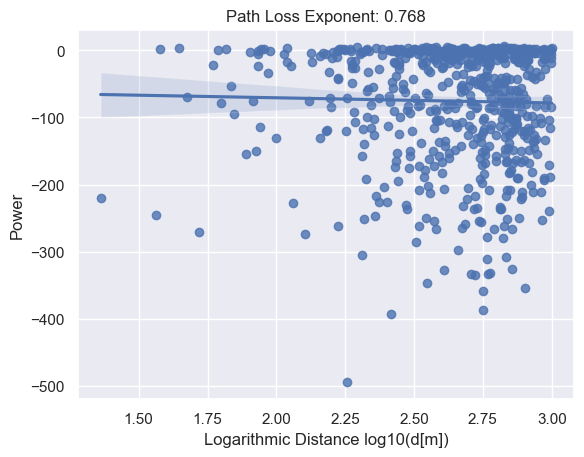

[11/100]: loss_d: 5.678, loss_g: 0.749, acc_real: 0.465, acc_fake: 0.596
0.0
0.7855459544383346


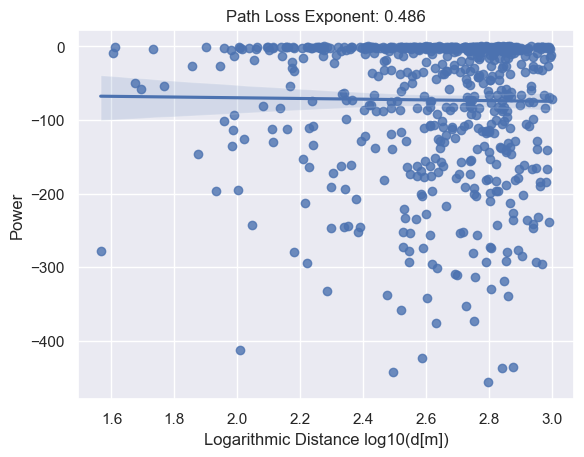

[12/100]: loss_d: 5.677, loss_g: 0.736, acc_real: 0.472, acc_fake: 0.602
0.0
0.7855459544383346


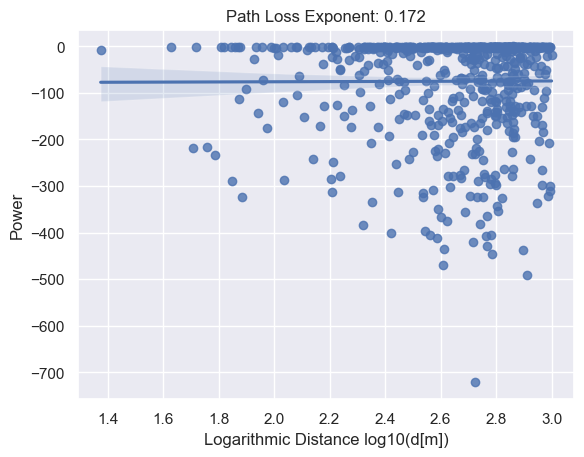

[13/100]: loss_d: 5.672, loss_g: 0.736, acc_real: 0.484, acc_fake: 0.606
0.0
0.7855459544383346


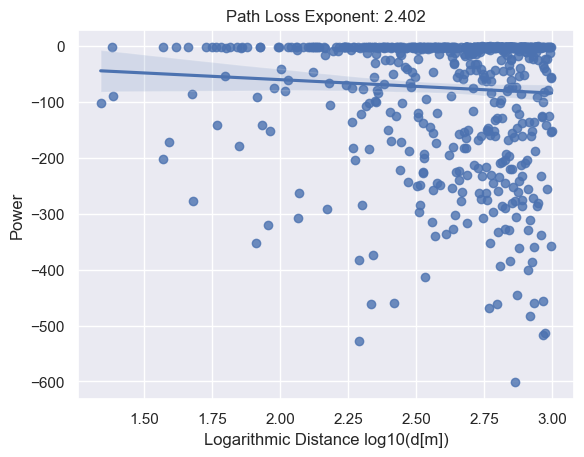

[14/100]: loss_d: 5.665, loss_g: 0.740, acc_real: 0.498, acc_fake: 0.612
0.0
0.7855459544383346


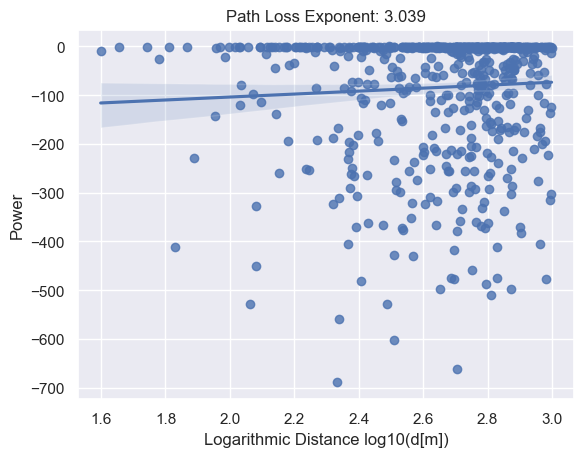

[15/100]: loss_d: 5.654, loss_g: 0.749, acc_real: 0.514, acc_fake: 0.619
0.0
0.7855459544383346


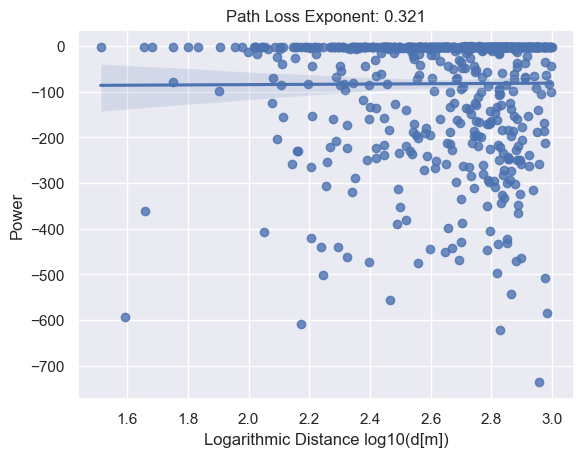

[16/100]: loss_d: 5.642, loss_g: 0.767, acc_real: 0.531, acc_fake: 0.626
0.0
0.7855459544383346


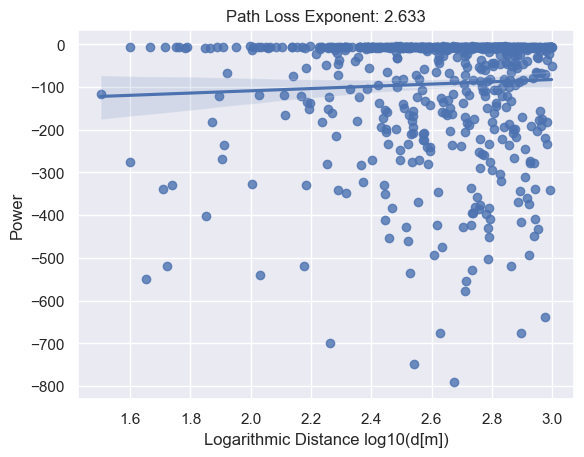

[17/100]: loss_d: 5.626, loss_g: 0.787, acc_real: 0.549, acc_fake: 0.634
0.0
0.7855459544383346


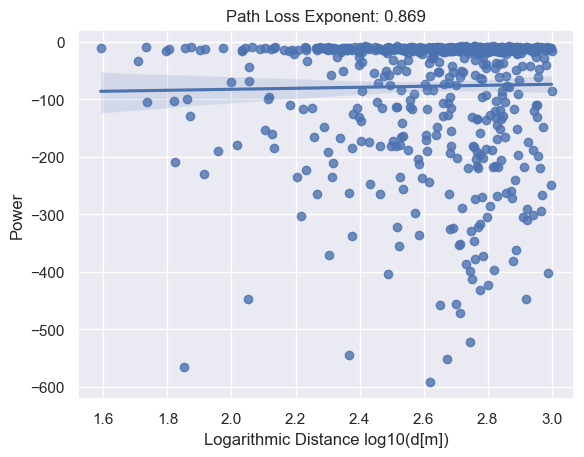

[18/100]: loss_d: 5.608, loss_g: 0.820, acc_real: 0.566, acc_fake: 0.642
0.0
0.7855459544383346


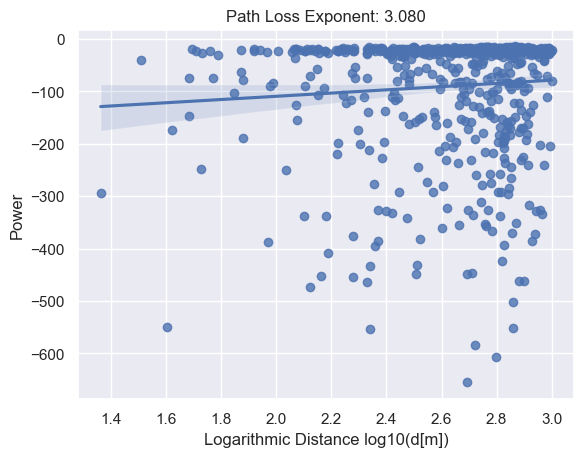

[19/100]: loss_d: 5.587, loss_g: 0.852, acc_real: 0.579, acc_fake: 0.649
0.0
0.7855459544383346


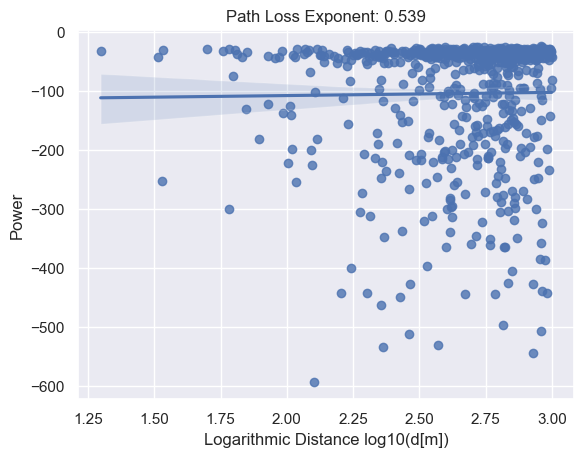

[20/100]: loss_d: 5.567, loss_g: 0.893, acc_real: 0.590, acc_fake: 0.656
0.0
0.7855459544383346


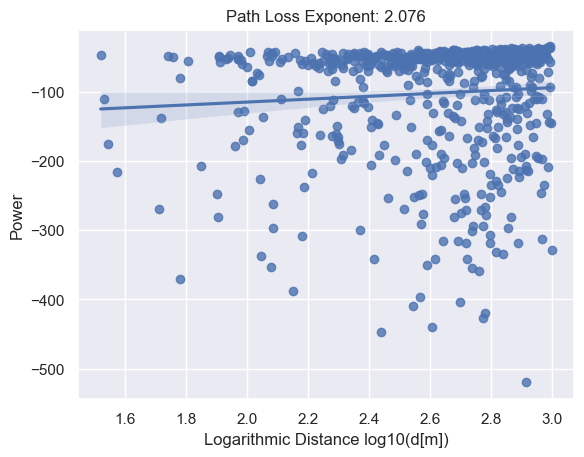

[21/100]: loss_d: 5.550, loss_g: 0.935, acc_real: 0.599, acc_fake: 0.662
0.0
0.7855459544383346


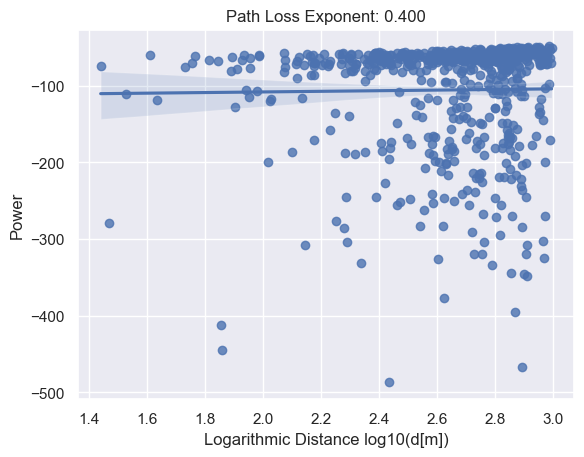

[22/100]: loss_d: 5.533, loss_g: 0.975, acc_real: 0.609, acc_fake: 0.667
0.0
0.7855459544383346


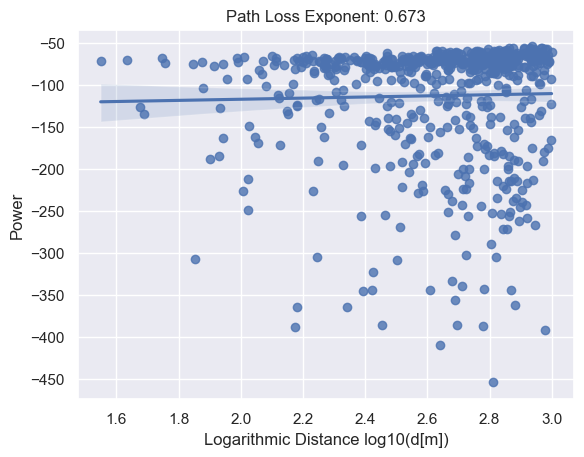

[23/100]: loss_d: 5.515, loss_g: 1.029, acc_real: 0.619, acc_fake: 0.672
0.0
0.7855459544383346


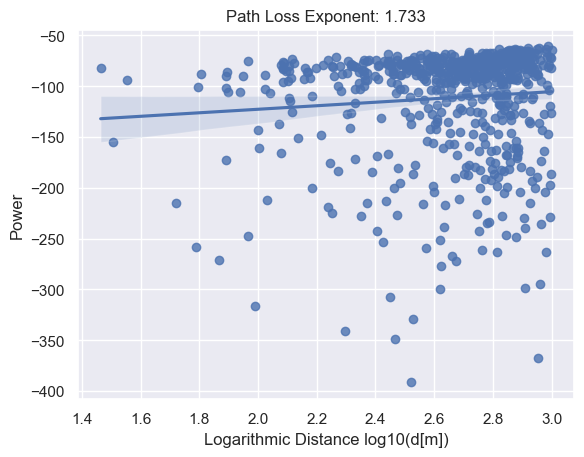

[24/100]: loss_d: 5.497, loss_g: 1.093, acc_real: 0.628, acc_fake: 0.677
0.0
0.7855459544383346


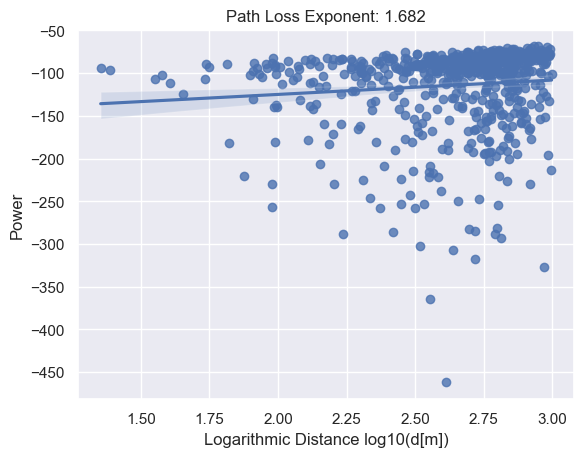

[25/100]: loss_d: 5.477, loss_g: 1.162, acc_real: 0.638, acc_fake: 0.681
0.0
0.7855459544383346


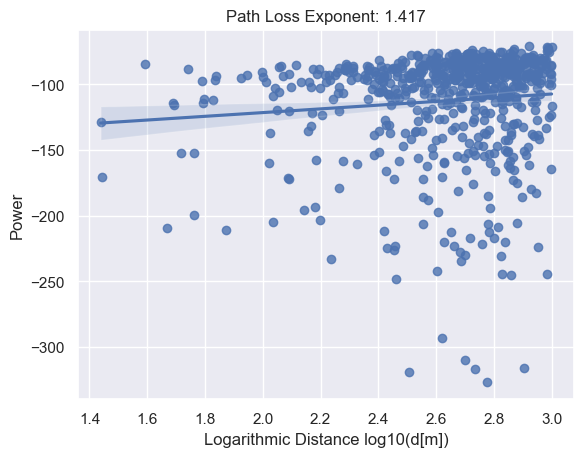

[26/100]: loss_d: 5.455, loss_g: 1.235, acc_real: 0.647, acc_fake: 0.686
0.0
0.7855459544383346


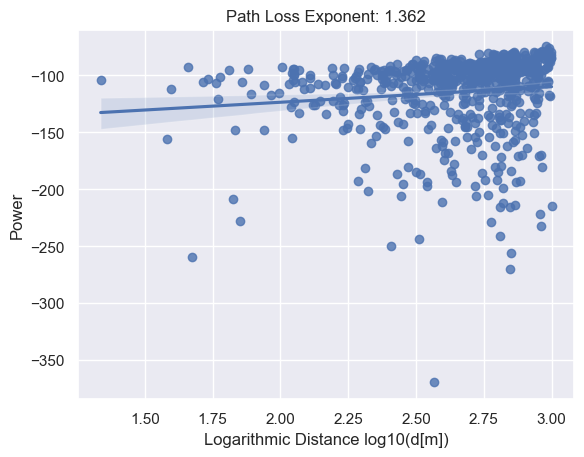

[27/100]: loss_d: 5.431, loss_g: 1.337, acc_real: 0.658, acc_fake: 0.690
0.0
0.7855459544383346


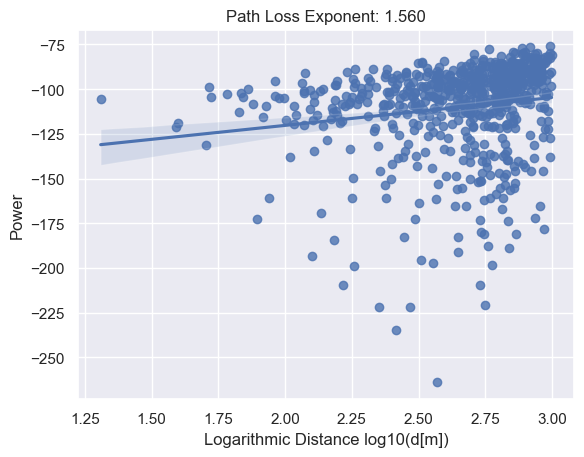

[28/100]: loss_d: 5.409, loss_g: 1.443, acc_real: 0.668, acc_fake: 0.694
0.0
0.7855459544383346


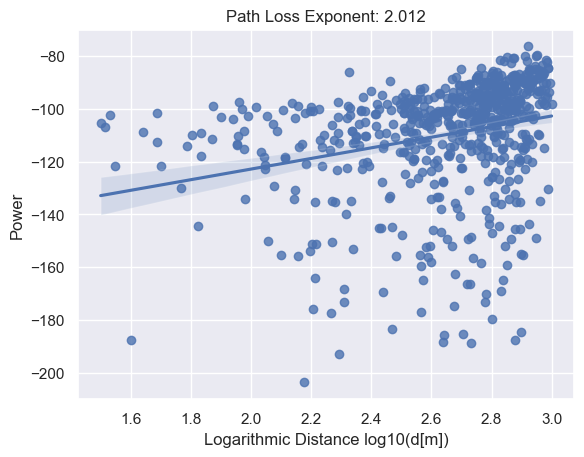

[29/100]: loss_d: 5.391, loss_g: 1.547, acc_real: 0.677, acc_fake: 0.698
0.0
0.7855459544383346


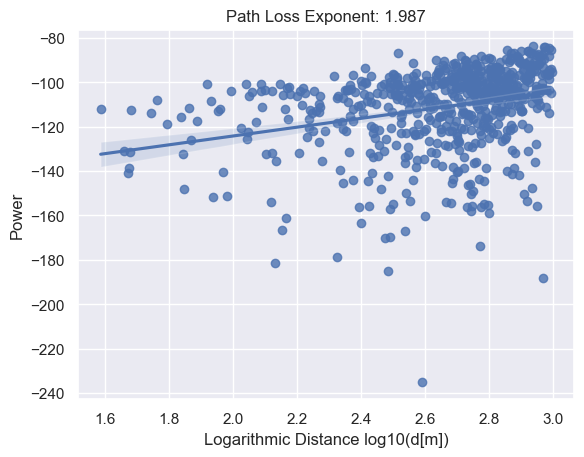

[30/100]: loss_d: 5.371, loss_g: 1.668, acc_real: 0.687, acc_fake: 0.702
0.0
0.7855459544383346


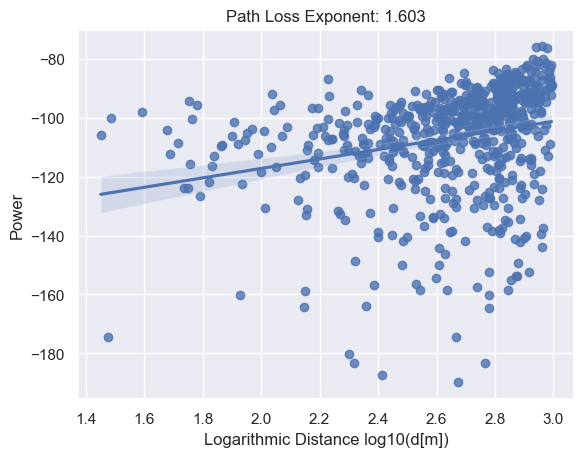

[31/100]: loss_d: 5.353, loss_g: 1.802, acc_real: 0.696, acc_fake: 0.706
0.0
0.7855459544383346


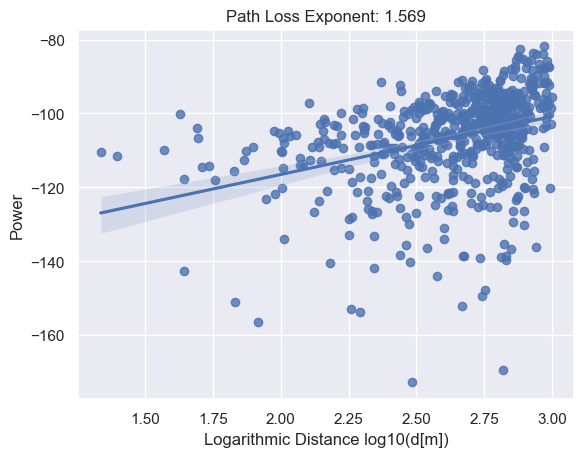

[32/100]: loss_d: 5.338, loss_g: 1.934, acc_real: 0.704, acc_fake: 0.710
0.0
0.7855459544383346


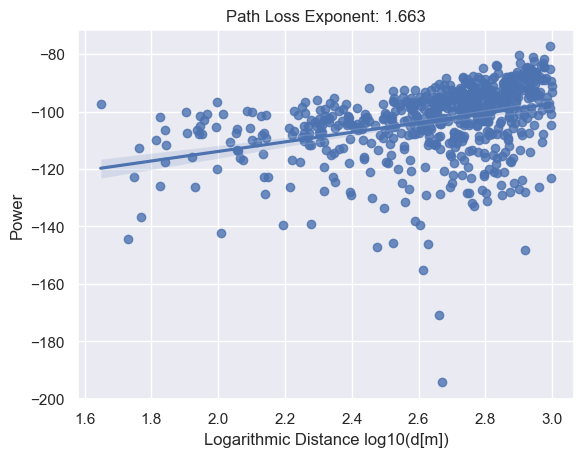

[33/100]: loss_d: 5.322, loss_g: 2.082, acc_real: 0.712, acc_fake: 0.714
0.0
0.7855459544383346


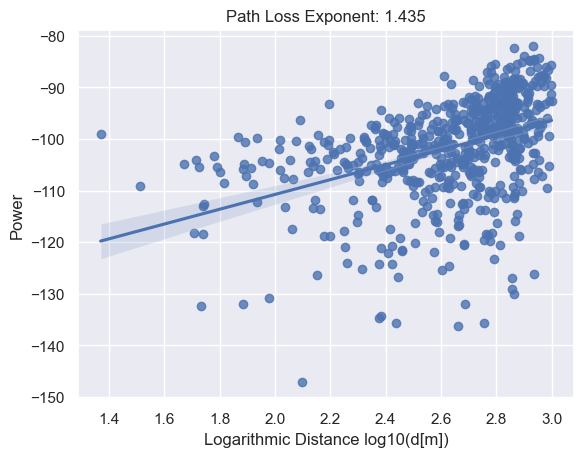

[34/100]: loss_d: 5.310, loss_g: 2.241, acc_real: 0.720, acc_fake: 0.717
0.0
0.7855459544383346


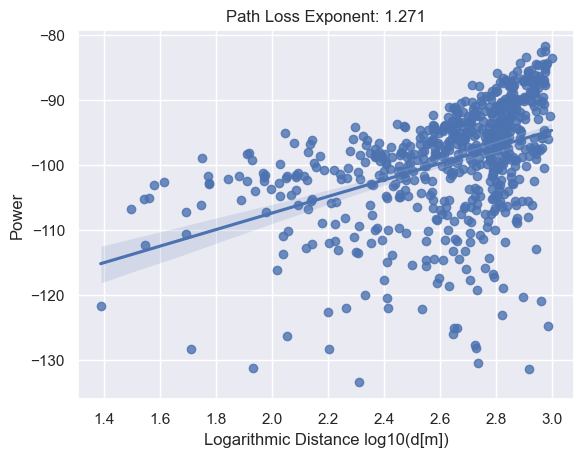

[35/100]: loss_d: 5.299, loss_g: 2.391, acc_real: 0.727, acc_fake: 0.721
0.0
0.7855459544383346


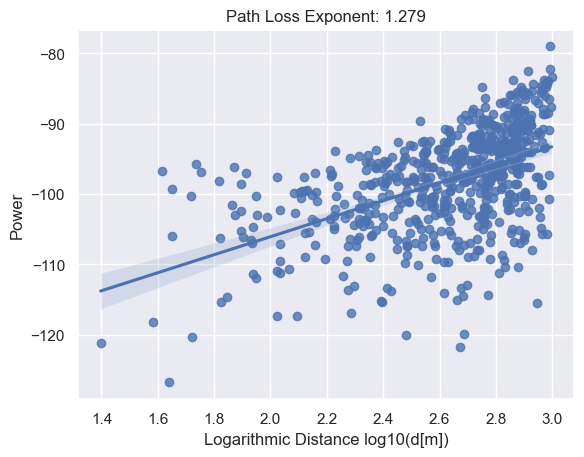

[36/100]: loss_d: 5.288, loss_g: 2.574, acc_real: 0.734, acc_fake: 0.724
0.0
0.7855459544383346


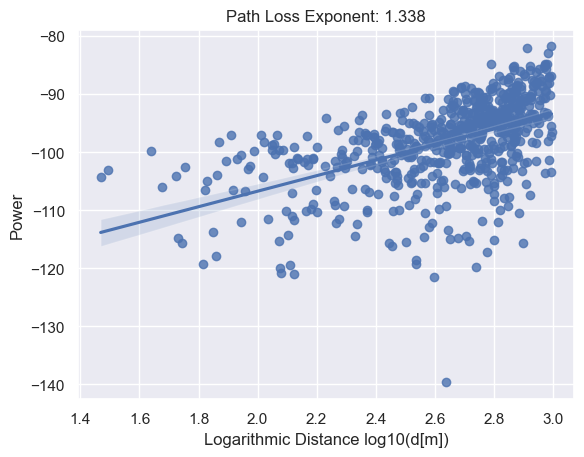

[37/100]: loss_d: 5.275, loss_g: 2.728, acc_real: 0.741, acc_fake: 0.727
0.0
0.7855459544383346


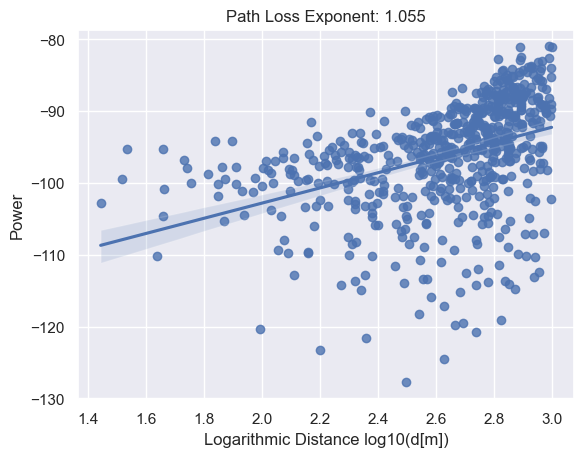

[38/100]: loss_d: 5.270, loss_g: 2.882, acc_real: 0.748, acc_fake: 0.730
0.0
0.7855459544383346


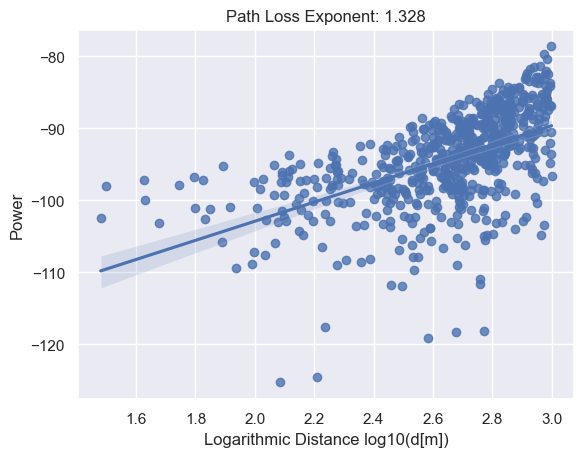

[39/100]: loss_d: 5.259, loss_g: 3.086, acc_real: 0.754, acc_fake: 0.733
0.0
0.7855459544383346


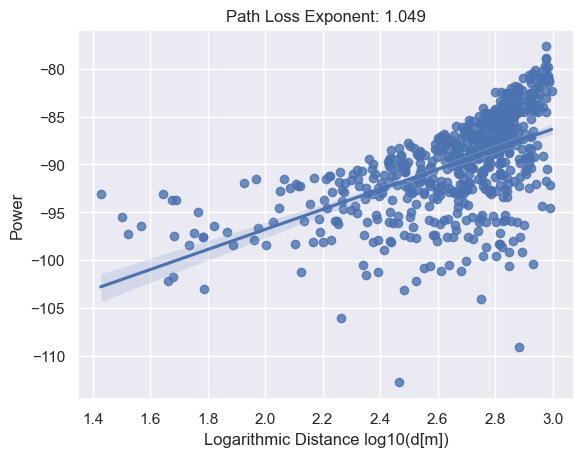

[40/100]: loss_d: 5.251, loss_g: 3.274, acc_real: 0.759, acc_fake: 0.736
0.0
0.7855459544383346


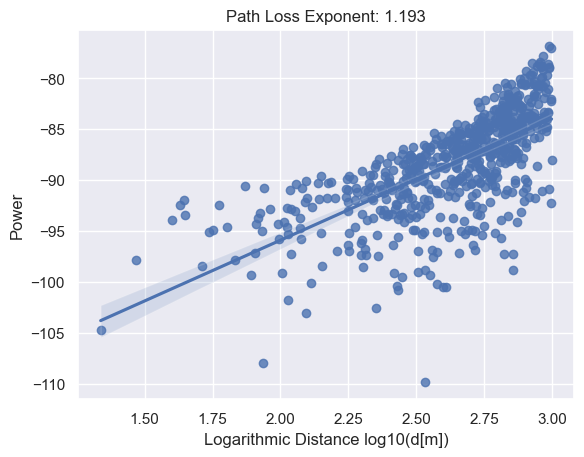

[41/100]: loss_d: 5.246, loss_g: 3.462, acc_real: 0.765, acc_fake: 0.739
0.0
0.7855459544383346


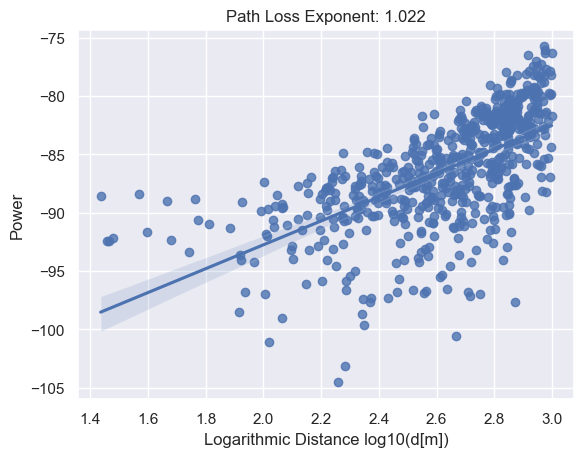

[42/100]: loss_d: 5.236, loss_g: 3.671, acc_real: 0.770, acc_fake: 0.742
0.0
0.7855459544383346


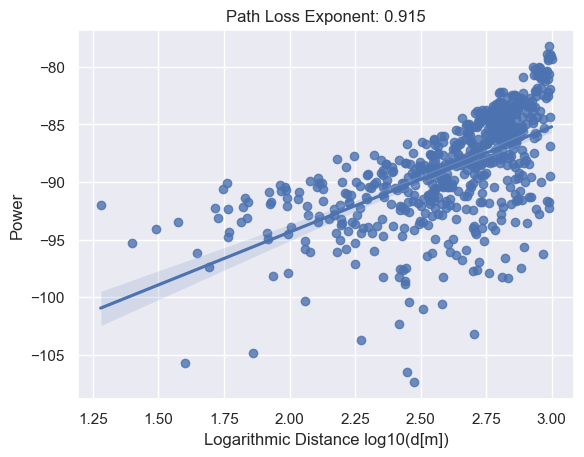

[43/100]: loss_d: 5.231, loss_g: 3.875, acc_real: 0.775, acc_fake: 0.745
0.0
0.7855459544383346


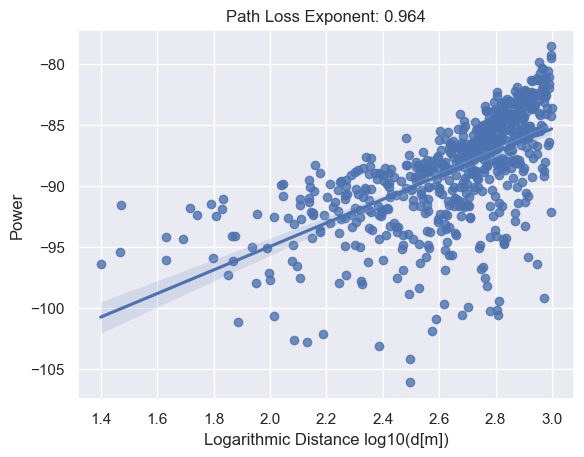

[44/100]: loss_d: 5.226, loss_g: 4.048, acc_real: 0.780, acc_fake: 0.748
0.0
0.7855459544383346


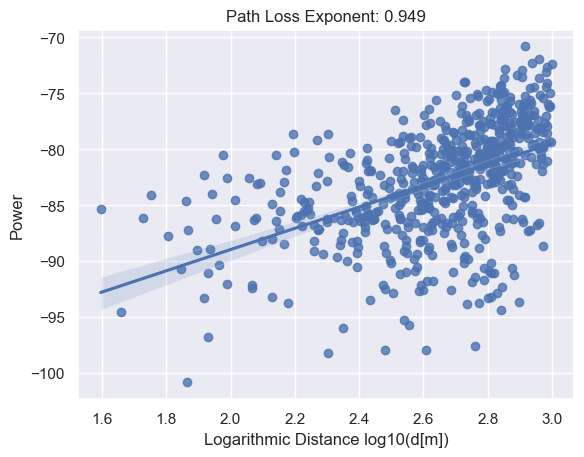

[45/100]: loss_d: 5.221, loss_g: 4.282, acc_real: 0.785, acc_fake: 0.750
0.0
0.7855459544383346


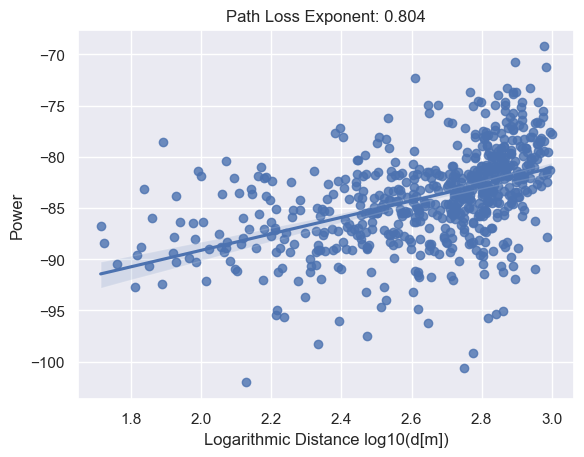

[46/100]: loss_d: 5.215, loss_g: 4.464, acc_real: 0.789, acc_fake: 0.753
0.0
0.7855459544383346


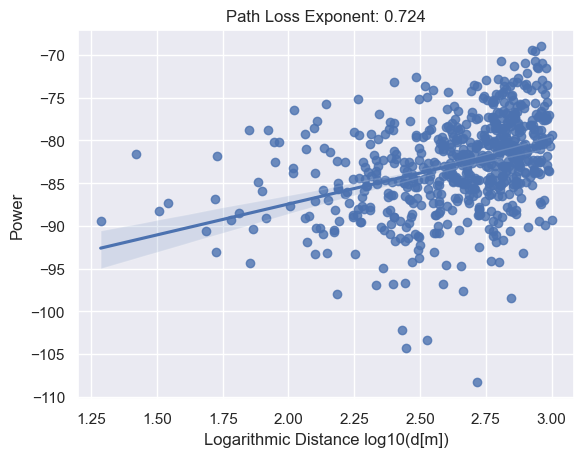

[47/100]: loss_d: 5.213, loss_g: 4.679, acc_real: 0.793, acc_fake: 0.755
0.0
0.7855459544383346


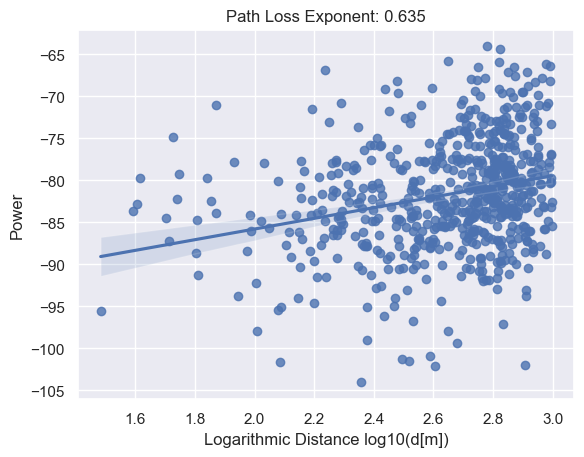

[48/100]: loss_d: 5.209, loss_g: 4.906, acc_real: 0.797, acc_fake: 0.758
0.0
0.7855459544383346


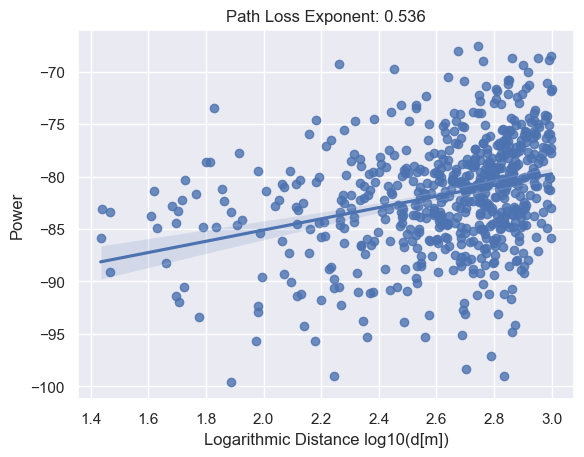

[49/100]: loss_d: 5.204, loss_g: 5.078, acc_real: 0.801, acc_fake: 0.760
0.0
0.7855459544383346


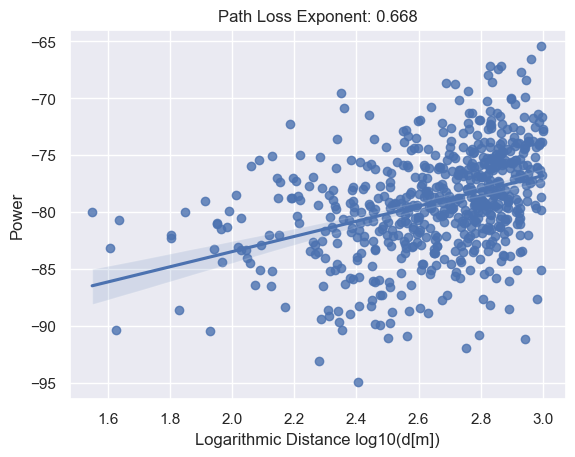

[50/100]: loss_d: 5.204, loss_g: 5.285, acc_real: 0.805, acc_fake: 0.762
0.0
0.7855459544383346


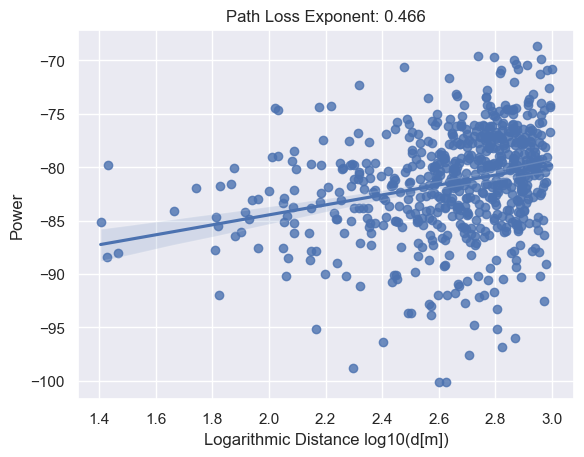

[51/100]: loss_d: 5.197, loss_g: 5.532, acc_real: 0.809, acc_fake: 0.765
0.0
0.7855459544383346


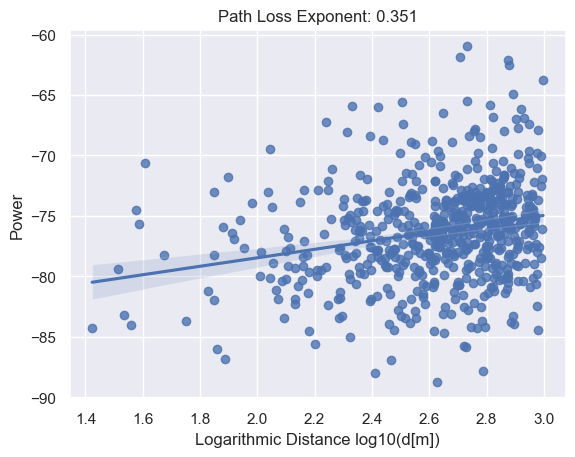

[52/100]: loss_d: 5.195, loss_g: 5.742, acc_real: 0.812, acc_fake: 0.767
0.0
0.7855459544383346


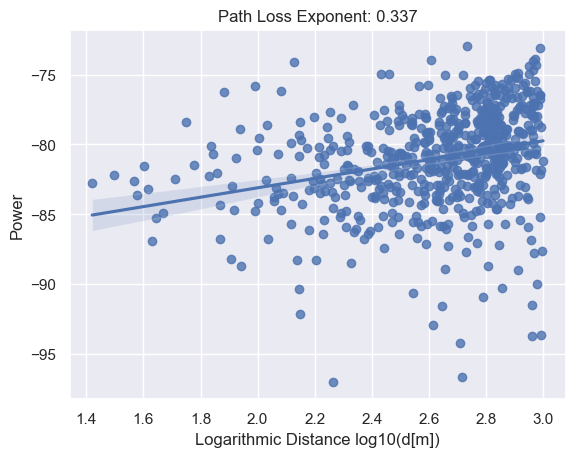

[53/100]: loss_d: 5.197, loss_g: 5.894, acc_real: 0.816, acc_fake: 0.769
0.0
0.7855459544383346


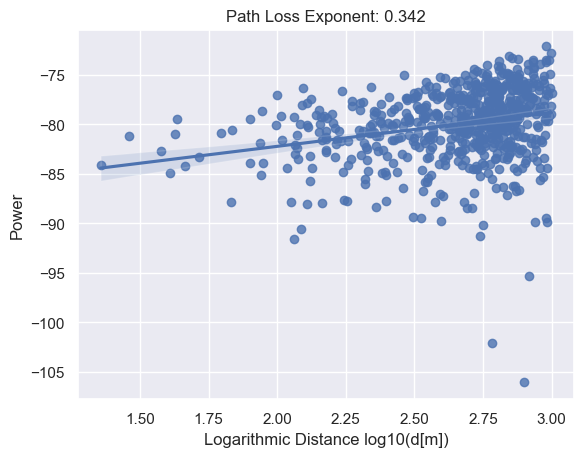

[54/100]: loss_d: 5.192, loss_g: 6.161, acc_real: 0.819, acc_fake: 0.771
0.0
0.7855459544383346


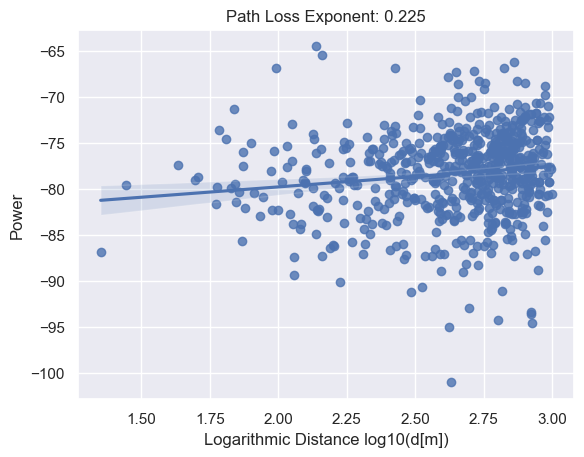

[55/100]: loss_d: 5.188, loss_g: 6.290, acc_real: 0.822, acc_fake: 0.773
0.0
0.7855459544383346


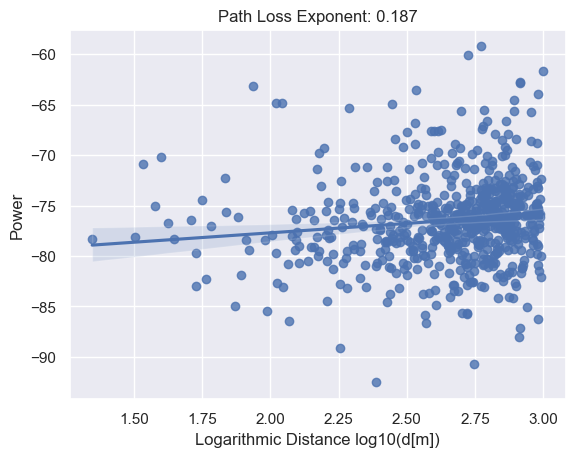

[56/100]: loss_d: 5.190, loss_g: 6.505, acc_real: 0.825, acc_fake: 0.775
0.0
0.7855459544383346


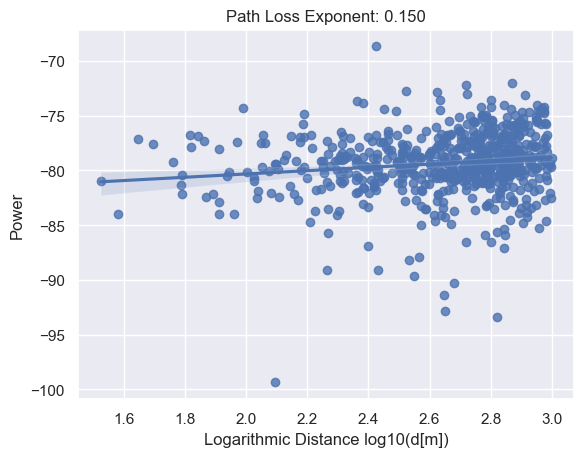

[57/100]: loss_d: 5.183, loss_g: 6.776, acc_real: 0.828, acc_fake: 0.777
0.0
0.7855459544383346


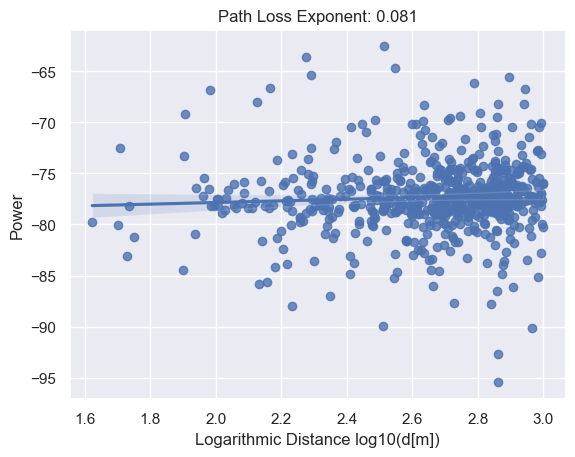

[58/100]: loss_d: 5.183, loss_g: 6.926, acc_real: 0.831, acc_fake: 0.779
0.0
0.7855459544383346


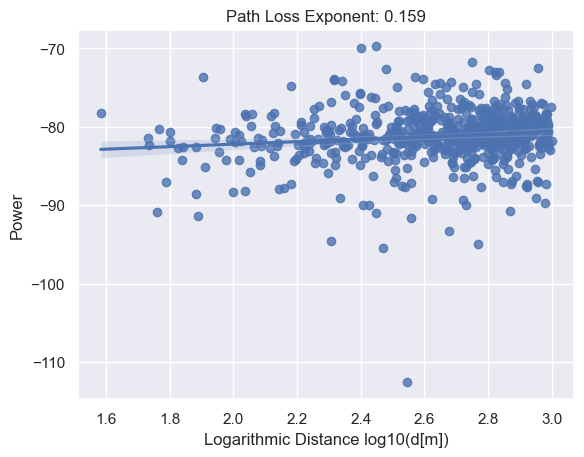

[59/100]: loss_d: 5.181, loss_g: 7.150, acc_real: 0.834, acc_fake: 0.781
0.0
0.7855459544383346


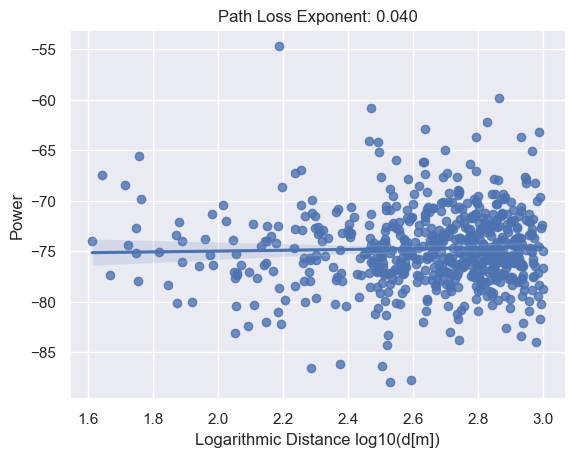

[60/100]: loss_d: 5.178, loss_g: 7.322, acc_real: 0.837, acc_fake: 0.783
0.0
0.7855459544383346


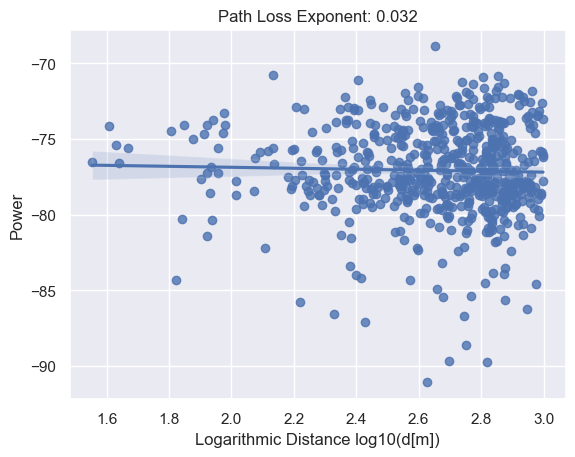

[61/100]: loss_d: 5.176, loss_g: 7.502, acc_real: 0.839, acc_fake: 0.785
0.0
0.7855459544383346


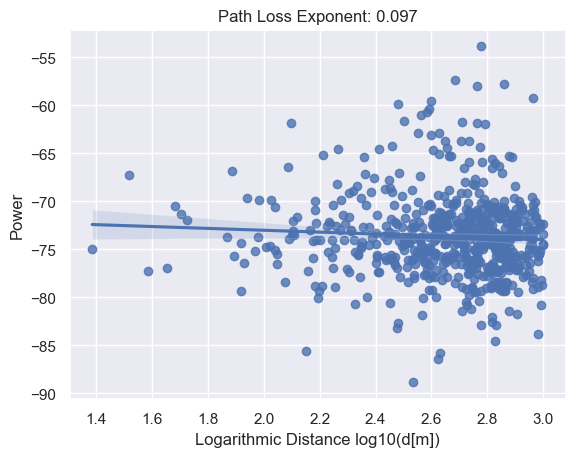

[62/100]: loss_d: 5.177, loss_g: 7.650, acc_real: 0.842, acc_fake: 0.786
0.0
0.7855459544383346


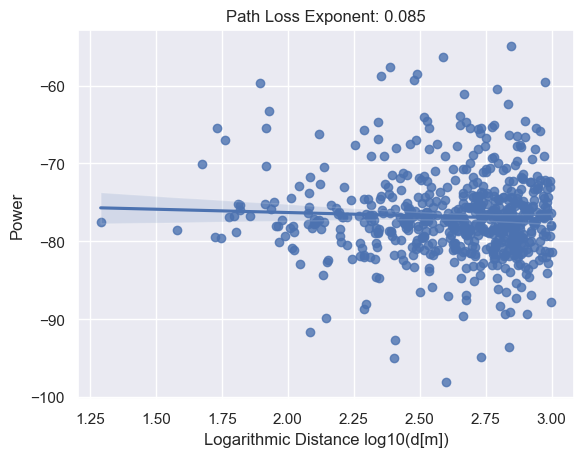

[63/100]: loss_d: 5.176, loss_g: 7.886, acc_real: 0.844, acc_fake: 0.788
0.0
0.7855459544383346


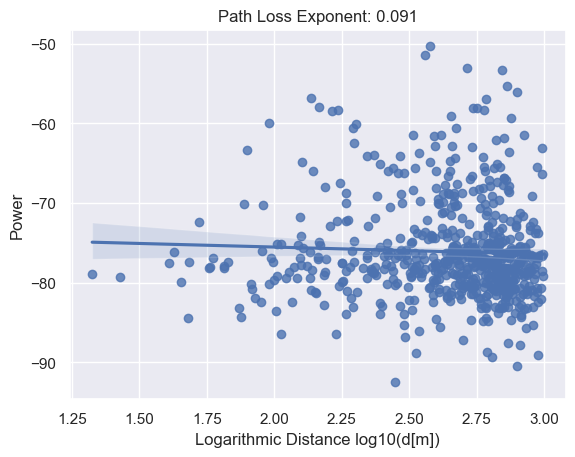

[64/100]: loss_d: 5.173, loss_g: 8.175, acc_real: 0.847, acc_fake: 0.790
0.0
0.7855459544383346


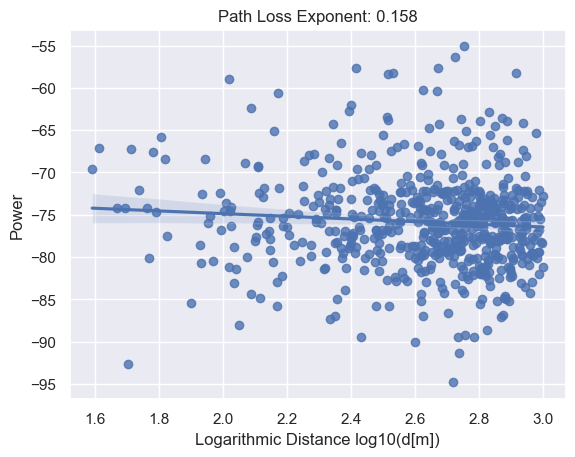

[65/100]: loss_d: 5.173, loss_g: 8.367, acc_real: 0.849, acc_fake: 0.791
0.0
0.7855459544383346


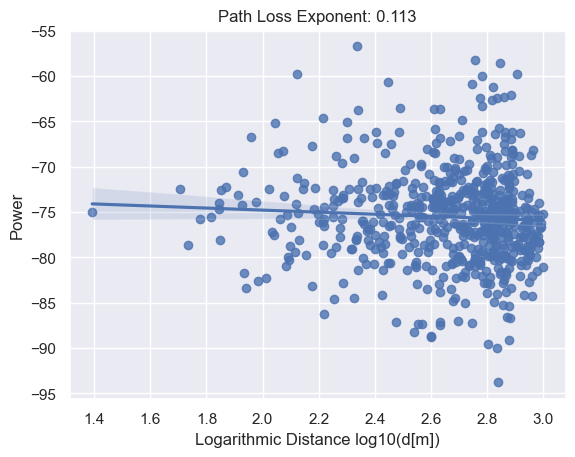

[66/100]: loss_d: 5.169, loss_g: 8.517, acc_real: 0.851, acc_fake: 0.793
0.0
0.7855459544383346


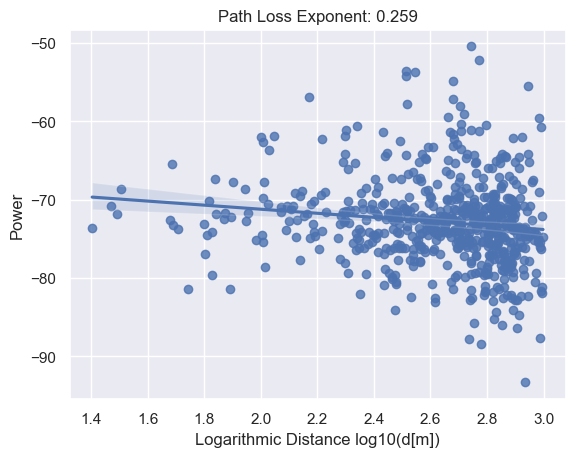

[67/100]: loss_d: 5.168, loss_g: 8.746, acc_real: 0.853, acc_fake: 0.794
0.0
0.7855459544383346


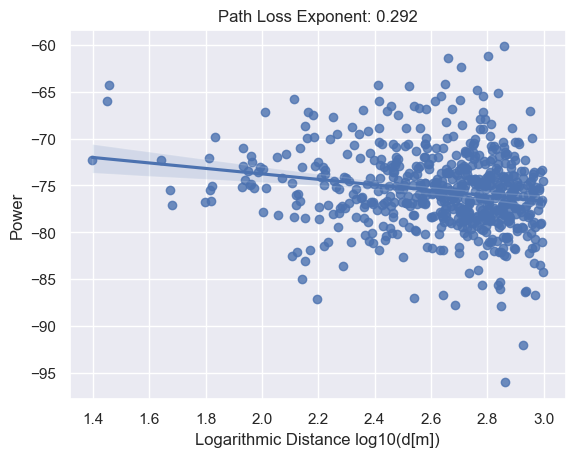

[68/100]: loss_d: 5.171, loss_g: 8.882, acc_real: 0.855, acc_fake: 0.796
0.0
0.7855459544383346


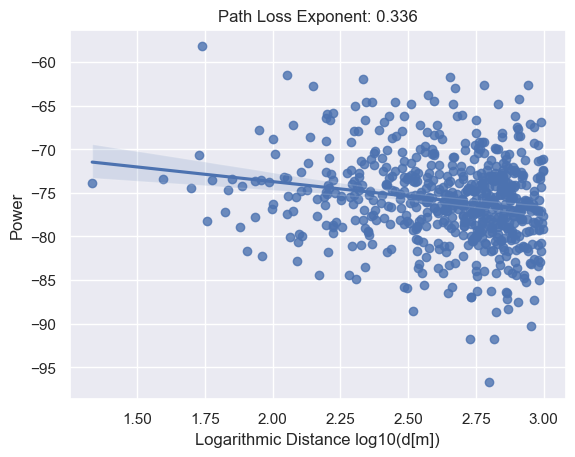

[69/100]: loss_d: 5.167, loss_g: 9.149, acc_real: 0.857, acc_fake: 0.797
0.0
0.7855459544383346


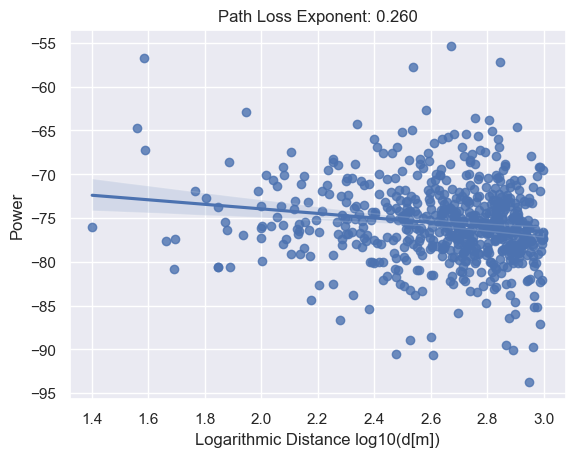

[70/100]: loss_d: 5.170, loss_g: 9.249, acc_real: 0.859, acc_fake: 0.799
0.0
0.7855459544383346


KeyboardInterrupt: 

In [42]:
import seaborn as sns
def accuracy(output, target, threshold=0.5):
    with torch.no_grad():
        prediction = (output >= threshold).float()
        correct = (prediction == target).float().sum()
        accuracy = correct / len(target)
        return accuracy.item()


class GeneratorModel(nn.Module):
    def __init__(self):
        super(GeneratorModel, self).__init__()
        embed_dim = 0
        input_dim = 4 + 2 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 32),
            nn.ReLU()
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(32, 16)
        )
        self.hidden_layer3 = nn.Sequential(
            nn.Linear(16, output_dim)
        )

        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        #info_out = self.sigm(self.ae(info[:, 4:]))
        x = torch.cat([x, torch.abs(info[:,2]-info[:, 0]).unsqueeze(1), torch.abs(info[:, 3]-info[:, 1]).unsqueeze(1)], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)
        output = self.hidden_layer3(output)

        return output.to(device)


class DiscriminatorModel(nn.Module):
    def __init__(self):
        super(DiscriminatorModel, self).__init__()
        embed_dim = 0
        input_dim = 1 + 2 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim),
            nn.Sigmoid()
        )
        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        #x_out = self.sigm(self.ae(x[:, 4:]))
        x = torch.cat([torch.abs(x[:,2]-x[:, 0]).unsqueeze(1), torch.abs(x[:, 3]-x[:, 1]).unsqueeze(1), info], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


discriminator = DiscriminatorModel()
generator = GeneratorModel()
discriminator.to(device)
generator.to(device)

discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.00004)
generator_optimizer = optim.Adam(generator.parameters(), lr=0.0003)

loss = nn.BCELoss()
noise_dim = 4
n_epochs = 100
batch_size = 24
G_loss_mean = []
D_loss_mean = []
D_real_mean = []
D_fake_mean = []
accuracy_real = []
accuracy_real_mean = []
accuracy_fake = []
accuracy_fake_mean = []
for epoch_idx in range(n_epochs):
    G_loss = []
    D_loss = []
    D_real = []
    D_fake = []
    for batch_idx, data_input in enumerate(train_ldr):
        if data_input[1].shape[0]!=batch_size and batch_idx==len(train_ldr)-1:
            continue
        if batch_idx%1000 == 0:
            print(batch_idx/len(train_ldr))
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,3005)).to(device)
        generated_data = generator(noise, fake_info)  # batch_size X 784

        # Discriminator
        true_data = data_input[0].view(batch_size, 3005).to(device)  # batch_size X 784
        cond_info = data_input[1].to(device)  # batch_size
        true_labels = torch.ones(batch_size).to(device)

        discriminator_optimizer.zero_grad()

        discriminator_output_for_true_data = discriminator(true_data, cond_info).view(batch_size)
        true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)
        acc_real = accuracy(discriminator_output_for_true_data, true_labels)
        discriminator_output_for_generated_data = discriminator(fake_info, generated_data.detach()).view(batch_size)
        generator_discriminator_loss = loss(
            discriminator_output_for_generated_data, torch.zeros(batch_size).to(device)
        )
        gp = gradient_penalty(discriminator, fake_info, cond_info, generated_data.detach(), batch_size)
        acc_fake = accuracy(discriminator_output_for_generated_data, torch.zeros(batch_size).to(device))
        discriminator_loss = (
                                     true_discriminator_loss + generator_discriminator_loss + 10*gp
                             ) / 2

        discriminator_loss.backward()
        discriminator_optimizer.step()

        D_loss.append(discriminator_loss.data.item())
        D_real.append(true_discriminator_loss)
        D_fake.append(generator_discriminator_loss)
        accuracy_real.append(acc_real)
        accuracy_fake.append(acc_fake)
        # Generator

        generator_optimizer.zero_grad()
        # It's a choice to generate the data again
        generated_data = generator(noise, fake_info)  # batch_size X 784
        discriminator_output_on_generated_data = discriminator(fake_info, generated_data).view(batch_size)
        generator_loss = loss(discriminator_output_on_generated_data, true_labels)
        generator_loss.backward()
        generator_optimizer.step()

        G_loss.append(generator_loss.data.item())


    dist_list =[]
    gan_rss_list = []
    with torch.no_grad():
        noise = torch.randn(1000, noise_dim).to(device)
        fake_info = torch.rand((1000,3005)).to(device)
        fake_info[:, [0,1,2,3]] = torch.zeros(1000, 4)
        fake_info[:, 2] = torch.rand((1000,))*0.14 + torch.logspace(-2.5, 0, 1000)
        #fake_info[:, 3] -= torch.logspace(0, 0.6, 1000)
        generated_data = generator(noise, fake_info).cpu().view(1000, 1)
        for i, x in enumerate(generated_data):
            fake_info_reconst = fake_info[i].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= (max_elev-min_elev)
            fake_info_reconst[4:] += min_elev 
            d = find_dist(fake_info_reconst[:4], 0.5)
            if d<1000:
                dist_list.append(d)
                gan_rss_list.append(x.detach().numpy()[0])

            #dist_list.append(find_dist(fake_info_reconst, 0.5))
            #gan_rss_list.append(x.detach().numpy()[0])

    a, b = np.polyfit(np.log10(dist_list), gan_rss_list, 1)
    plt.figure()
    ax = sns.regplot(x=np.log10(dist_list), y=gan_rss_list)
    ax.set_axisbelow(True)
    plt.xlabel("Logarithmic Distance log10(d[m])")
    plt.ylabel("Power")
    plt.title("Path Loss Exponent: %.3f" %abs(a/10))
    plt.grid(True)
    plt.show()
    '''
    with torch.no_grad():
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,18337)).to(device)
        generated_data = generator(noise, fake_info).cpu().view(batch_size, 1)
        for x in generated_data:
            fake_info_reconst = fake_info[0].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= max_elev
            print(fake_info_reconst)
            print(x.detach().numpy())
            #plt.imshow(x.detach().numpy(), interpolation='nearest', cmap='gray')
            #plt.show()

            break
    '''
    print('[%d/%d]: loss_d: %.3f, loss_g: %.3f, acc_real: %.3f, acc_fake: %.3f' % (
        (epoch_idx), n_epochs, torch.mean(torch.FloatTensor(D_loss)), torch.mean(torch.FloatTensor(G_loss)), torch.mean(torch.FloatTensor(accuracy_real)), torch.mean(torch.FloatTensor(accuracy_fake))))
    G_loss_mean.append(torch.mean(torch.FloatTensor(G_loss)))
    D_loss_mean.append(torch.mean(torch.FloatTensor(D_loss)))
    D_real_mean.append(torch.mean(torch.FloatTensor(D_real)))
    D_fake_mean.append(torch.mean(torch.FloatTensor(D_fake)))
    accuracy_real_mean.append(torch.mean(torch.FloatTensor(accuracy_real)))
    accuracy_fake_mean.append(torch.mean(torch.FloatTensor(accuracy_fake)))


### Do 25 disc for 1 gen

0.0


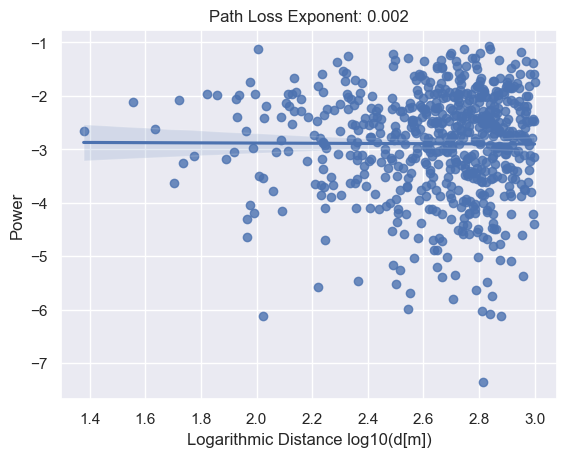

[0/200]: loss_d: 5.229, loss_g: 1.624, acc_real: 0.939, acc_fake: 0.868
0.0


KeyboardInterrupt: 

In [60]:
import seaborn as sns
def accuracy(output, target, threshold=0.5):
    with torch.no_grad():
        prediction = (output >= threshold).float()
        correct = (prediction == target).float().sum()
        accuracy = correct / len(target)
        return accuracy.item()


class GeneratorModel(nn.Module):
    def __init__(self):
        super(GeneratorModel, self).__init__()
        embed_dim = 0
        input_dim = 4 + 2 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 32),
            nn.ReLU()
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(32, 16)
        )
        self.hidden_layer3 = nn.Sequential(
            nn.Linear(16, output_dim)
        )

        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        #info_out = self.sigm(self.ae(info[:, 4:]))
        x = torch.cat([x, torch.abs(info[:,2]-info[:, 0]).unsqueeze(1), torch.abs(info[:, 3]-info[:, 1]).unsqueeze(1)], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)
        output = self.hidden_layer3(output)

        return output.to(device)


class DiscriminatorModel(nn.Module):
    def __init__(self):
        super(DiscriminatorModel, self).__init__()
        embed_dim = 0
        input_dim = 1 + 2 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim),
            nn.Sigmoid()
        )
        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        #x_out = self.sigm(self.ae(x[:, 4:]))
        x = torch.cat([torch.abs(x[:,2]-x[:, 0]).unsqueeze(1), torch.abs(x[:, 3]-x[:, 1]).unsqueeze(1), info], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


discriminator = DiscriminatorModel()
generator = GeneratorModel()
discriminator.to(device)
generator.to(device)

discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.00008)
generator_optimizer = optim.Adam(generator.parameters(), lr=0.00008)

loss = nn.BCELoss()
noise_dim = 4
n_epochs = 200
batch_size = 32
G_loss_mean = []
D_loss_mean = []
D_real_mean = []
D_fake_mean = []
accuracy_real = []
accuracy_real_mean = []
accuracy_fake = []
accuracy_fake_mean = []
for epoch_idx in range(n_epochs):
    G_loss = []
    D_loss = []
    D_real = []
    D_fake = []
    for batch_idx, data_input in enumerate(train_ldr):
        if data_input[1].shape[0]!=batch_size and batch_idx==len(train_ldr)-1:
            continue
        if batch_idx%1000 == 0:
            print(batch_idx/len(train_ldr))
        for _ in range(10):
            noise = torch.randn(batch_size, noise_dim).to(device)
            fake_info = torch.rand((batch_size,3005)).to(device)
            generated_data = generator(noise, fake_info)  # batch_size X 784

            # Discriminator
            true_data = data_input[0].view(batch_size, 3005).to(device)  # batch_size X 784
            cond_info = data_input[1].to(device)  # batch_size
            true_labels = torch.ones(batch_size).to(device)

            discriminator_optimizer.zero_grad()

            discriminator_output_for_true_data = discriminator(true_data, cond_info).view(batch_size)
            true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)
            acc_real = accuracy(discriminator_output_for_true_data, true_labels)
            discriminator_output_for_generated_data = discriminator(fake_info, generated_data.detach()).view(batch_size)
            generator_discriminator_loss = loss(
                discriminator_output_for_generated_data, torch.zeros(batch_size).to(device)
            )
            gp = gradient_penalty(discriminator, fake_info, cond_info, generated_data.detach(), batch_size)
            acc_fake = accuracy(discriminator_output_for_generated_data, torch.zeros(batch_size).to(device))
            discriminator_loss = (
                                         true_discriminator_loss + generator_discriminator_loss + 10*gp
                                 ) / 2

            discriminator_loss.backward()
            discriminator_optimizer.step()

        D_loss.append(discriminator_loss.data.item())
        D_real.append(true_discriminator_loss)
        D_fake.append(generator_discriminator_loss)
        accuracy_real.append(acc_real)
        accuracy_fake.append(acc_fake)
        # Generator

        generator_optimizer.zero_grad()
        # It's a choice to generate the data again
        generated_data = generator(noise, fake_info)  # batch_size X 784
        discriminator_output_on_generated_data = discriminator(fake_info, generated_data).view(batch_size)
        generator_loss = loss(discriminator_output_on_generated_data, true_labels)
        generator_loss.backward()
        generator_optimizer.step()

        G_loss.append(generator_loss.data.item())


    dist_list =[]
    gan_rss_list = []
    with torch.no_grad():
        noise = torch.randn(1000, noise_dim).to(device)
        fake_info = torch.rand((1000,3005)).to(device)
        fake_info[:, [0,1,2,3]] = torch.zeros(1000, 4)
        fake_info[:, 2] = torch.rand((1000,))*0.14 + torch.logspace(-2.5, 0, 1000)
        #fake_info[:, 3] -= torch.logspace(0, 0.6, 1000)
        generated_data = generator(noise, fake_info).cpu().view(1000, 1)
        for i, x in enumerate(generated_data):
            fake_info_reconst = fake_info[i].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= (max_elev-min_elev)
            fake_info_reconst[4:] += min_elev 
            d = find_dist(fake_info_reconst[:4], 0.5)
            if d<1000:
                dist_list.append(d)
                gan_rss_list.append(x.detach().numpy()[0])

            #dist_list.append(find_dist(fake_info_reconst, 0.5))
            #gan_rss_list.append(x.detach().numpy()[0])

    a, b = np.polyfit(np.log10(dist_list), gan_rss_list, 1)
    plt.figure()
    ax = sns.regplot(x=np.log10(dist_list), y=gan_rss_list)
    ax.set_axisbelow(True)
    plt.xlabel("Logarithmic Distance log10(d[m])")
    plt.ylabel("Power")
    plt.title("Path Loss Exponent: %.3f" %abs(a/10))
    plt.grid(True)
    plt.show()
    '''
    with torch.no_grad():
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,18337)).to(device)
        generated_data = generator(noise, fake_info).cpu().view(batch_size, 1)
        for x in generated_data:
            fake_info_reconst = fake_info[0].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= max_elev
            print(fake_info_reconst)
            print(x.detach().numpy())
            #plt.imshow(x.detach().numpy(), interpolation='nearest', cmap='gray')
            #plt.show()

            break
    '''
    print('[%d/%d]: loss_d: %.3f, loss_g: %.3f, acc_real: %.3f, acc_fake: %.3f' % (
        (epoch_idx), n_epochs, torch.mean(torch.FloatTensor(D_loss)), torch.mean(torch.FloatTensor(G_loss)), torch.mean(torch.FloatTensor(accuracy_real)), torch.mean(torch.FloatTensor(accuracy_fake))))
    G_loss_mean.append(torch.mean(torch.FloatTensor(G_loss)))
    D_loss_mean.append(torch.mean(torch.FloatTensor(D_loss)))
    D_real_mean.append(torch.mean(torch.FloatTensor(D_real)))
    D_fake_mean.append(torch.mean(torch.FloatTensor(D_fake)))
    accuracy_real_mean.append(torch.mean(torch.FloatTensor(accuracy_real)))
    accuracy_fake_mean.append(torch.mean(torch.FloatTensor(accuracy_fake)))


## Do 5 gen 1 for disc

0.0


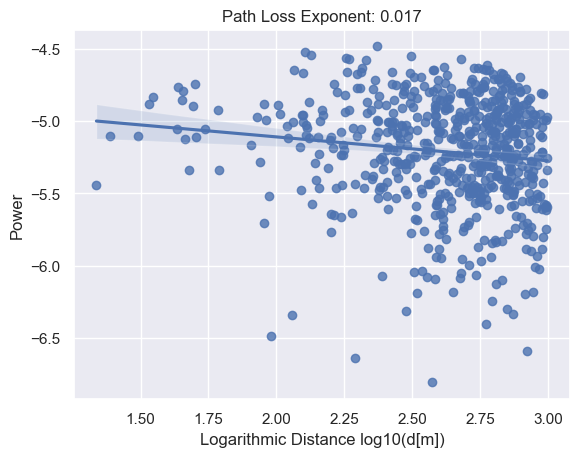

[0/100]: loss_d: 8.278, loss_g: 0.653, acc_real: 0.435, acc_fake: 0.351
0.0


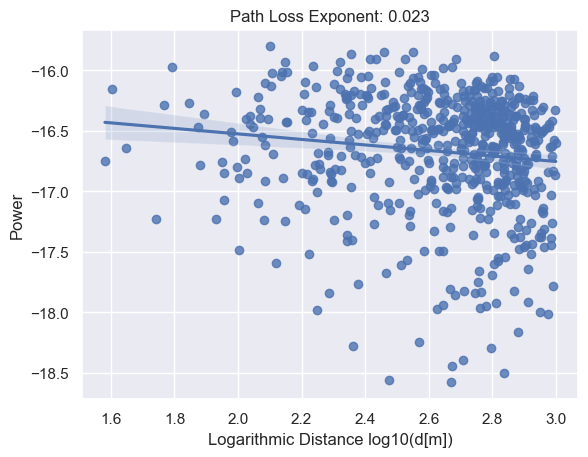

[1/100]: loss_d: 6.409, loss_g: 0.531, acc_real: 0.596, acc_fake: 0.305
0.0


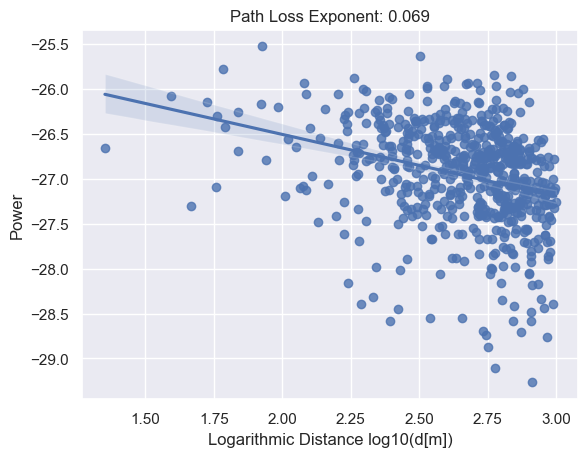

[2/100]: loss_d: 6.186, loss_g: 0.609, acc_real: 0.649, acc_fake: 0.301
0.0


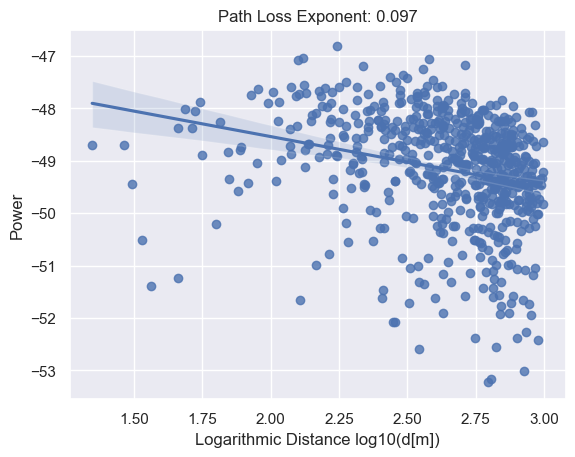

[3/100]: loss_d: 5.955, loss_g: 0.744, acc_real: 0.652, acc_fake: 0.328
0.0


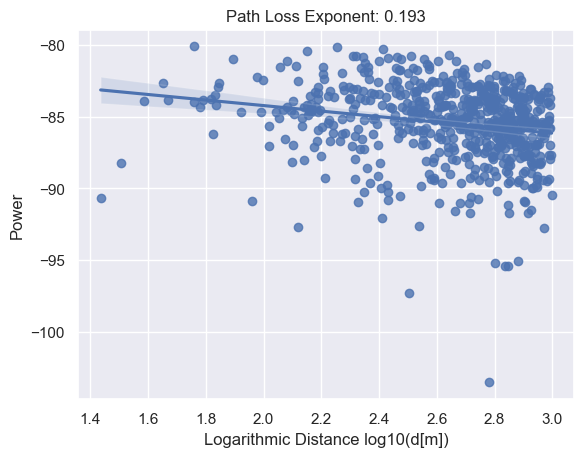

[4/100]: loss_d: 5.793, loss_g: 0.852, acc_real: 0.613, acc_fake: 0.368
0.0


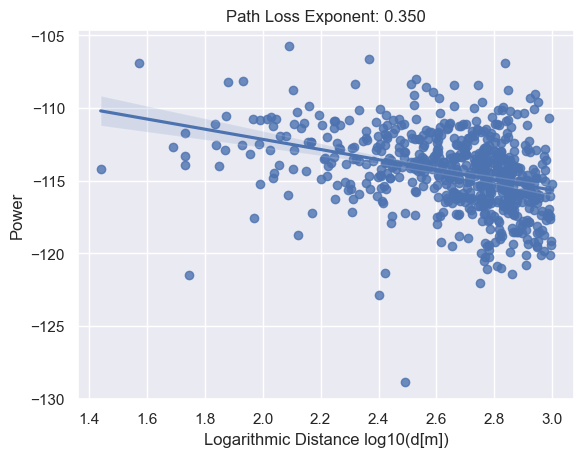

[5/100]: loss_d: 5.729, loss_g: 0.866, acc_real: 0.559, acc_fake: 0.419
0.0


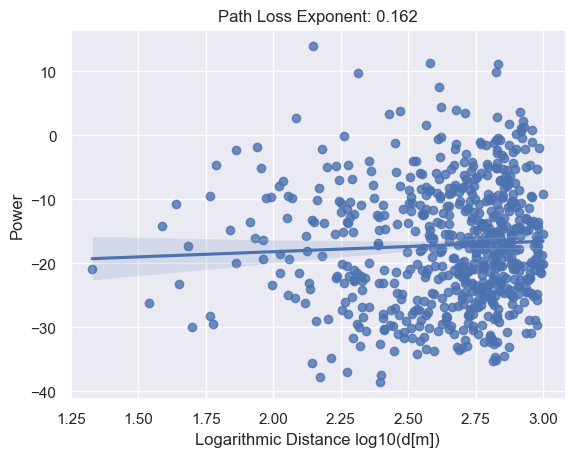

[6/100]: loss_d: 5.723, loss_g: 0.837, acc_real: 0.522, acc_fake: 0.462
0.0


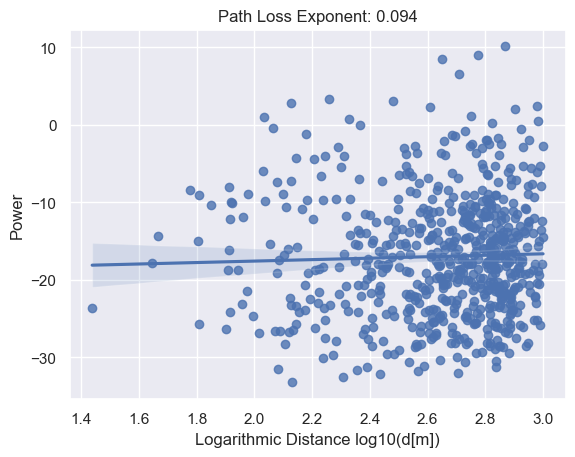

[7/100]: loss_d: 5.723, loss_g: 0.801, acc_real: 0.491, acc_fake: 0.495
0.0


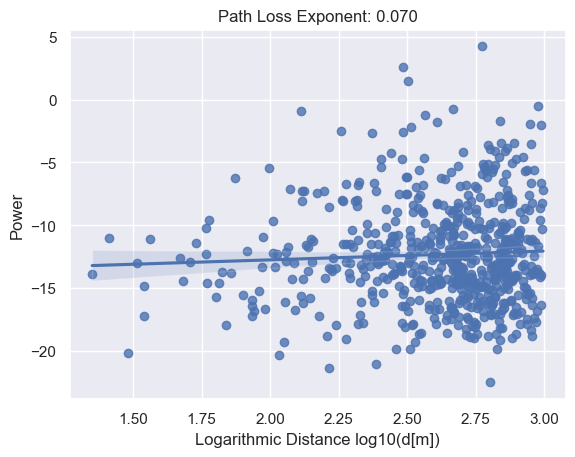

[8/100]: loss_d: 5.722, loss_g: 0.773, acc_real: 0.466, acc_fake: 0.523
0.0


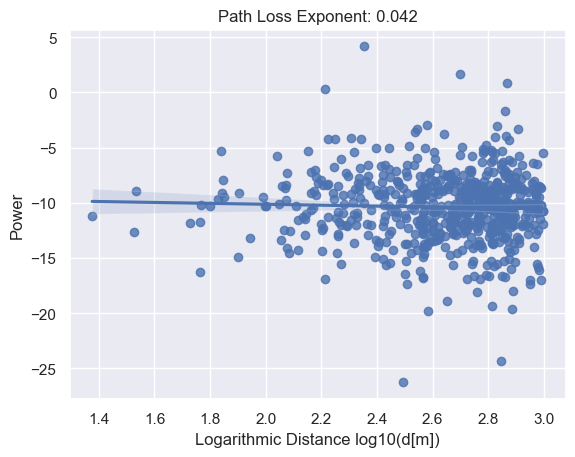

[9/100]: loss_d: 5.720, loss_g: 0.747, acc_real: 0.448, acc_fake: 0.546
0.0


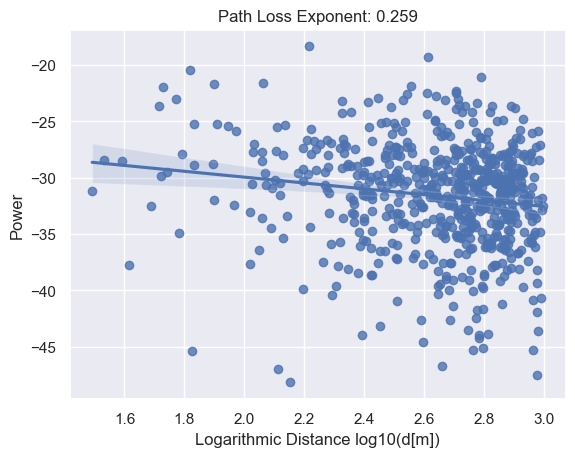

[10/100]: loss_d: 5.717, loss_g: 0.728, acc_real: 0.436, acc_fake: 0.566
0.0


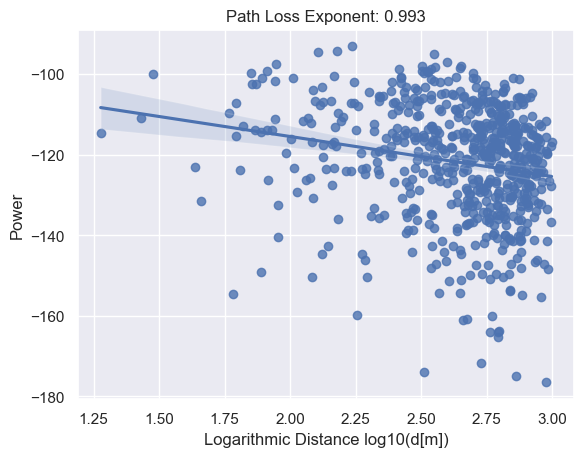

[11/100]: loss_d: 5.714, loss_g: 0.710, acc_real: 0.429, acc_fake: 0.581
0.0


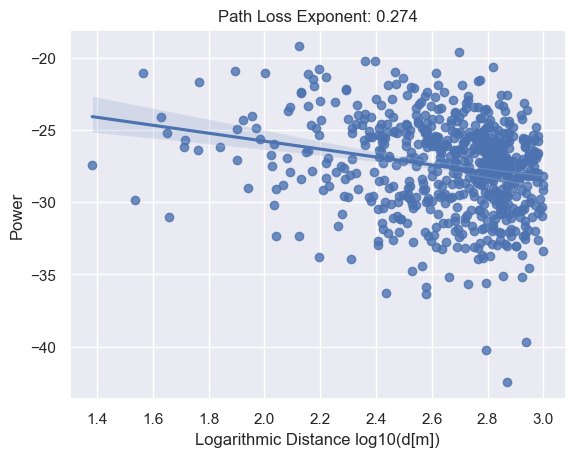

[12/100]: loss_d: 5.712, loss_g: 0.701, acc_real: 0.425, acc_fake: 0.585
0.0


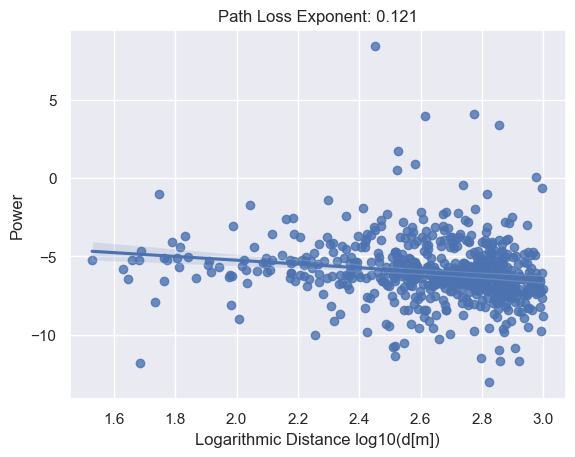

[13/100]: loss_d: 5.707, loss_g: 0.694, acc_real: 0.425, acc_fake: 0.581
0.0


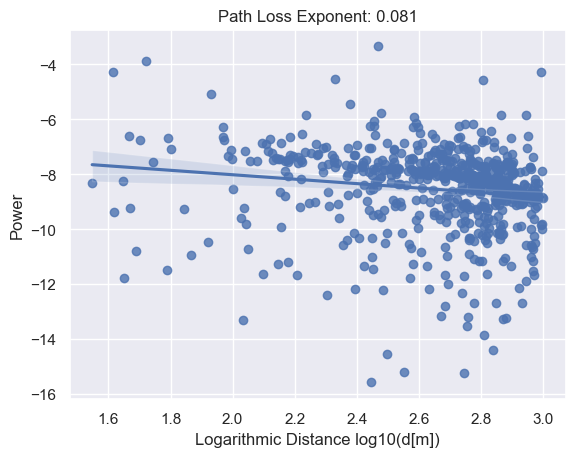

[14/100]: loss_d: 5.701, loss_g: 0.691, acc_real: 0.429, acc_fake: 0.575
0.0


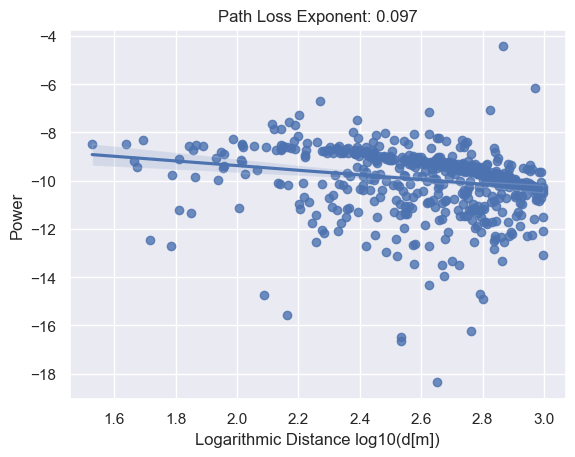

[15/100]: loss_d: 5.695, loss_g: 0.696, acc_real: 0.435, acc_fake: 0.574
0.0


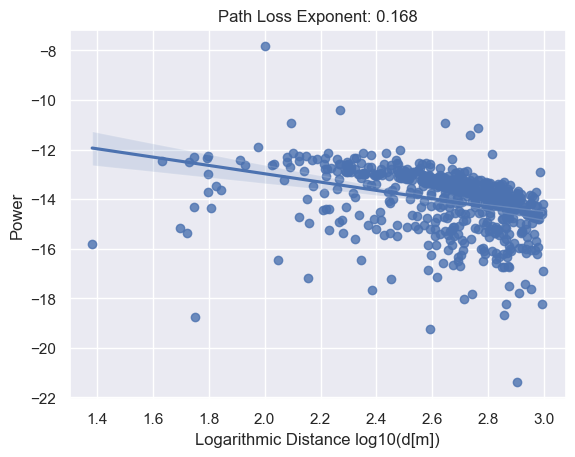

[16/100]: loss_d: 5.683, loss_g: 0.705, acc_real: 0.444, acc_fake: 0.577
0.0


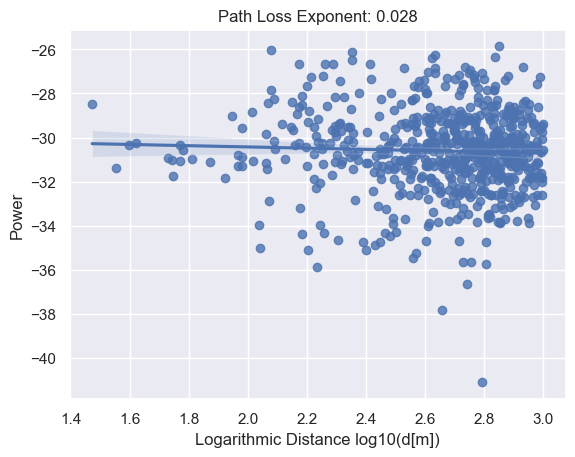

[17/100]: loss_d: 5.665, loss_g: 0.724, acc_real: 0.457, acc_fake: 0.584
0.0


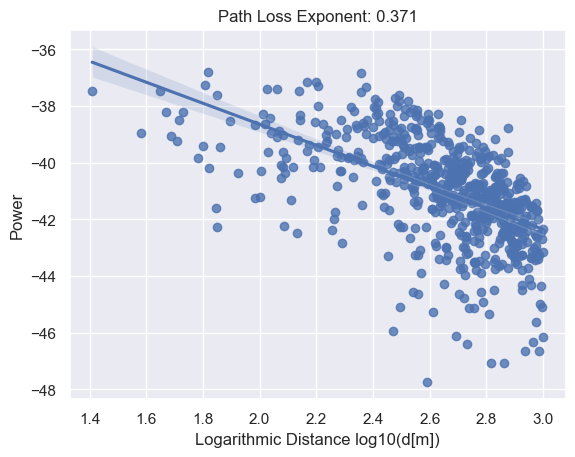

[18/100]: loss_d: 5.636, loss_g: 0.762, acc_real: 0.470, acc_fake: 0.590
0.0


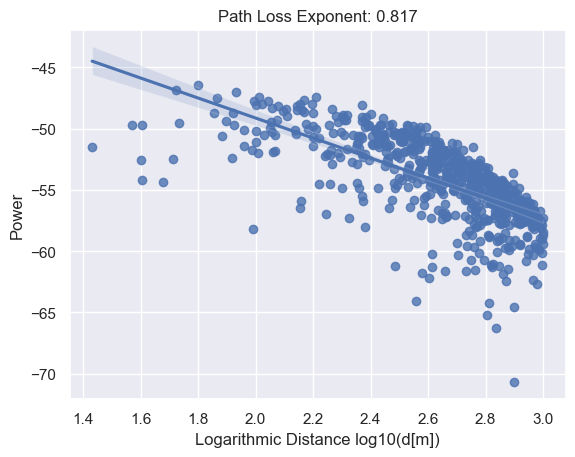

[19/100]: loss_d: 5.608, loss_g: 0.815, acc_real: 0.483, acc_fake: 0.596
0.0


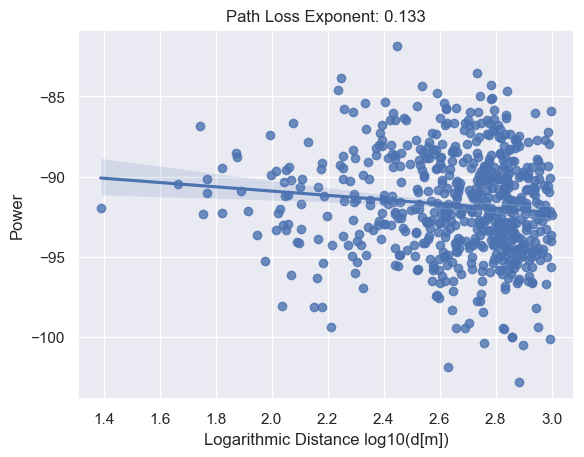

[20/100]: loss_d: 5.582, loss_g: 0.880, acc_real: 0.496, acc_fake: 0.604
0.0


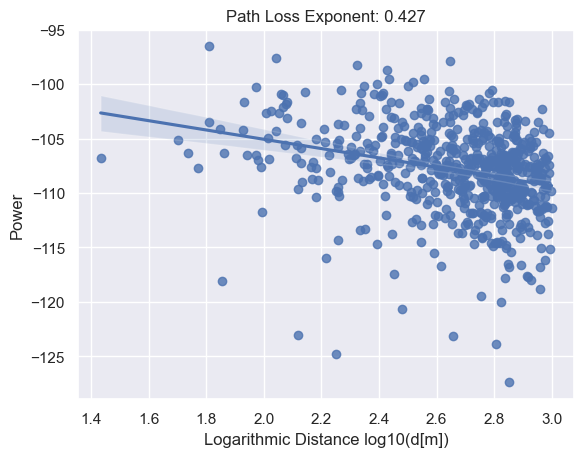

[21/100]: loss_d: 5.541, loss_g: 0.985, acc_real: 0.509, acc_fake: 0.611
0.0


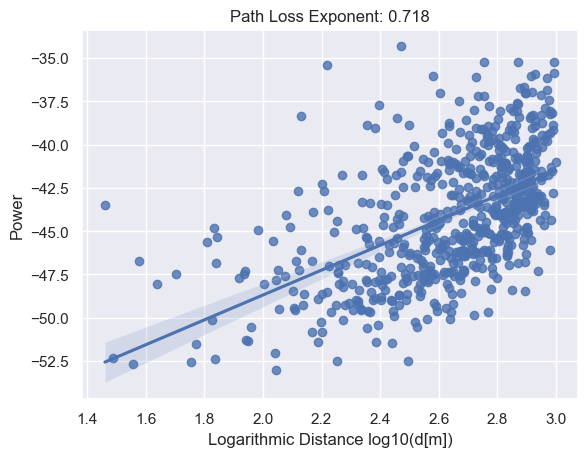

[22/100]: loss_d: 5.503, loss_g: 1.104, acc_real: 0.523, acc_fake: 0.618
0.0


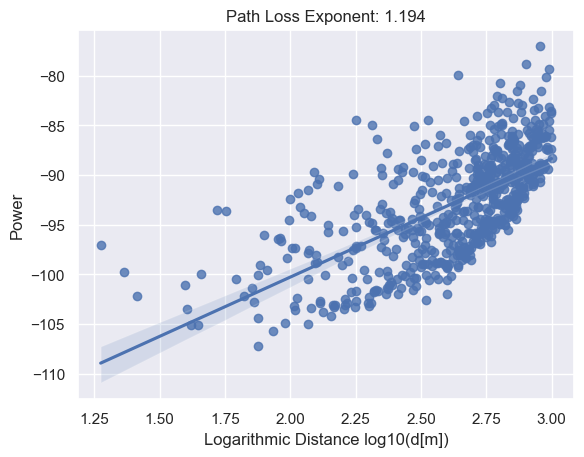

[23/100]: loss_d: 5.460, loss_g: 1.248, acc_real: 0.537, acc_fake: 0.624
0.0


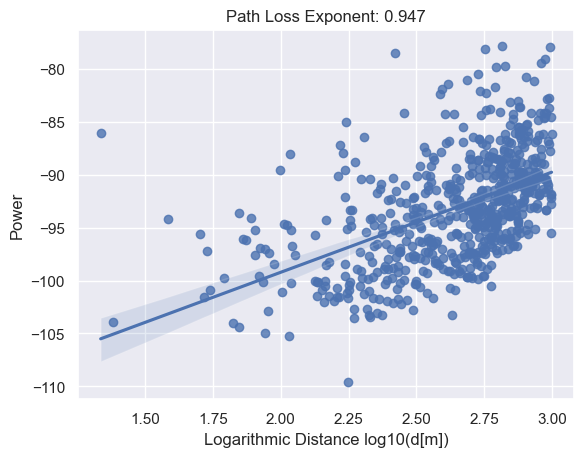

[24/100]: loss_d: 5.424, loss_g: 1.419, acc_real: 0.551, acc_fake: 0.630
0.0


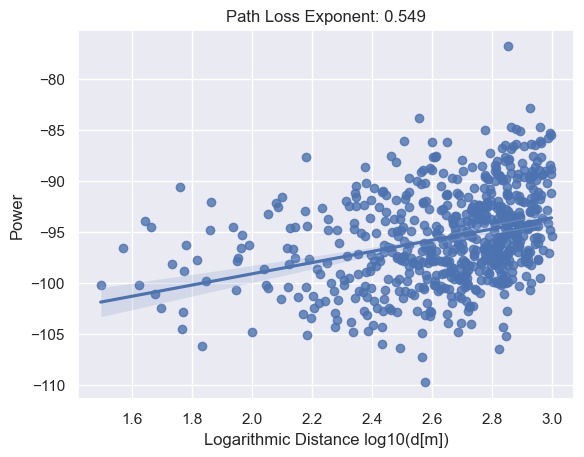

[25/100]: loss_d: 5.391, loss_g: 1.614, acc_real: 0.565, acc_fake: 0.636
0.0


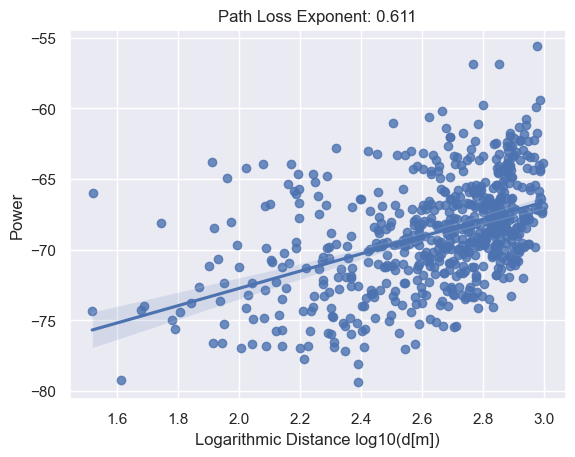

[26/100]: loss_d: 5.361, loss_g: 1.840, acc_real: 0.579, acc_fake: 0.642
0.0


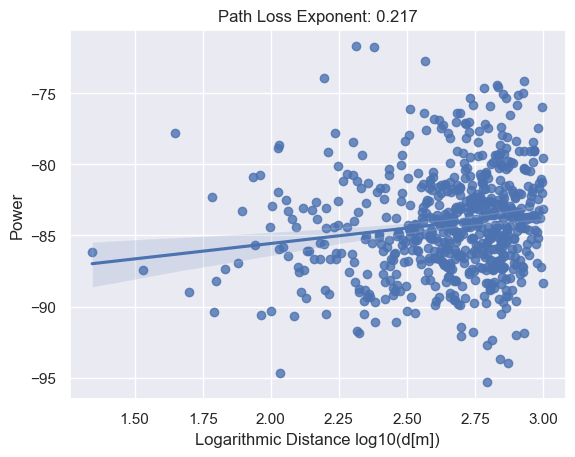

[27/100]: loss_d: 5.333, loss_g: 2.125, acc_real: 0.593, acc_fake: 0.648
0.0


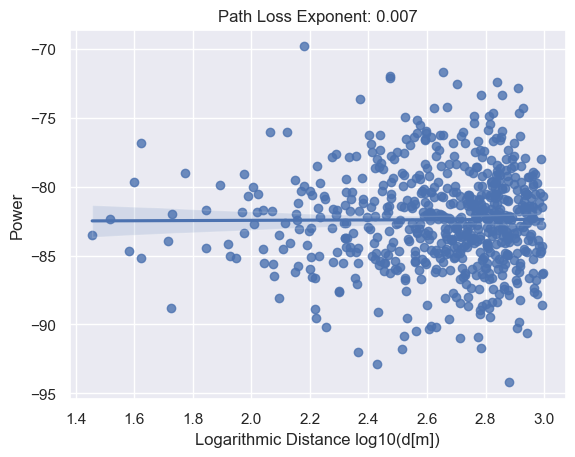

[28/100]: loss_d: 5.308, loss_g: 2.430, acc_real: 0.605, acc_fake: 0.654
0.0


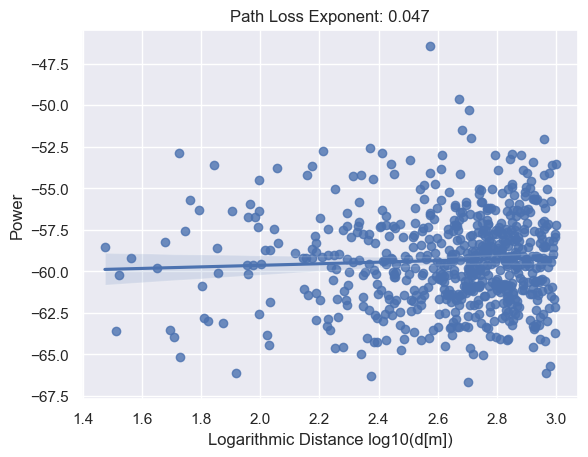

[29/100]: loss_d: 5.287, loss_g: 2.771, acc_real: 0.618, acc_fake: 0.660
0.0


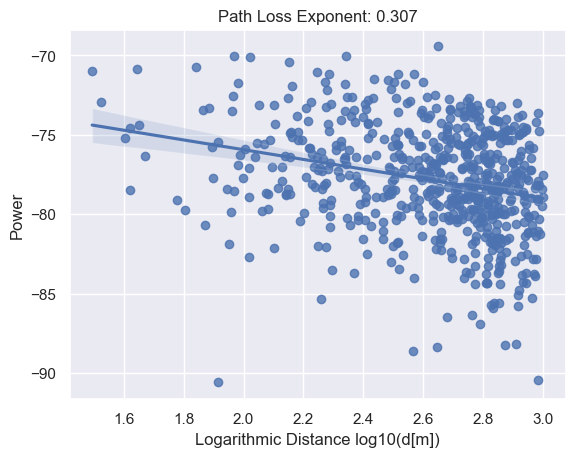

[30/100]: loss_d: 5.267, loss_g: 3.157, acc_real: 0.629, acc_fake: 0.666
0.0


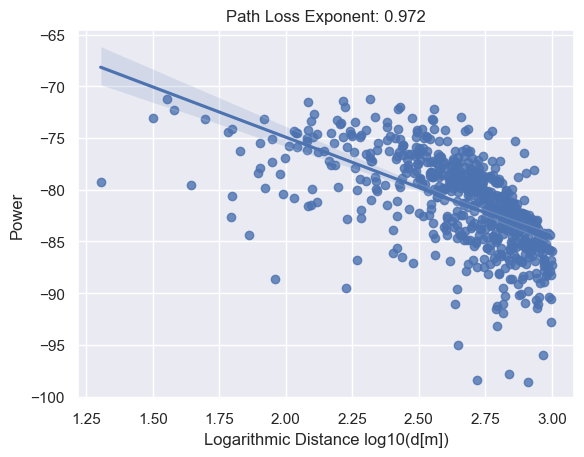

[31/100]: loss_d: 5.249, loss_g: 3.573, acc_real: 0.640, acc_fake: 0.672
0.0


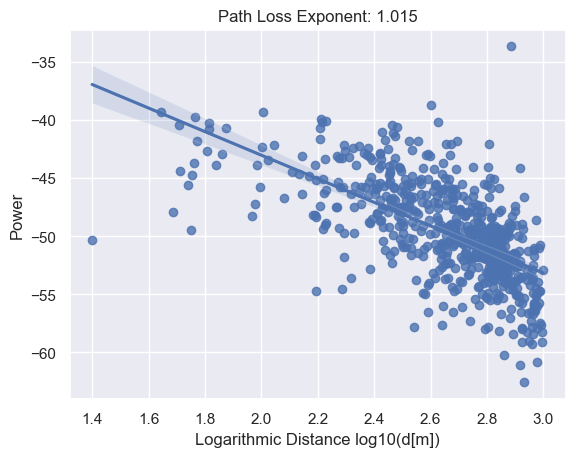

[32/100]: loss_d: 5.224, loss_g: 4.168, acc_real: 0.651, acc_fake: 0.678
0.0


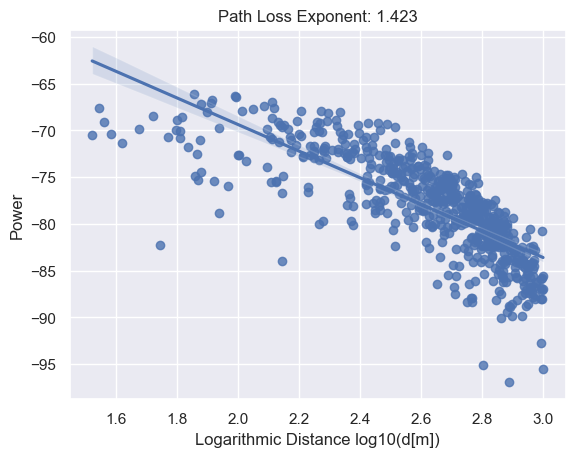

[33/100]: loss_d: 5.205, loss_g: 4.758, acc_real: 0.661, acc_fake: 0.684
0.0


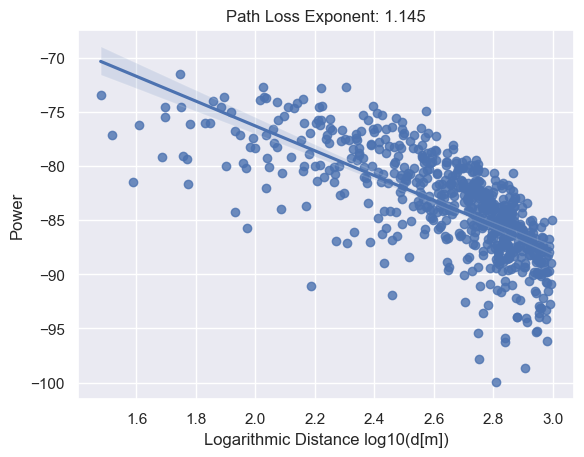

[34/100]: loss_d: 5.192, loss_g: 5.349, acc_real: 0.671, acc_fake: 0.690
0.0


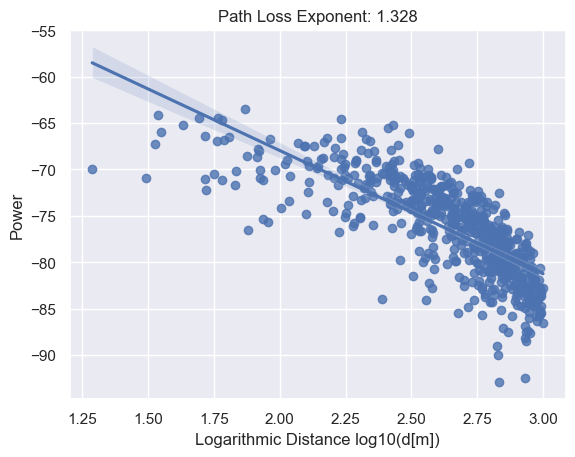

[35/100]: loss_d: 5.180, loss_g: 5.941, acc_real: 0.680, acc_fake: 0.696
0.0


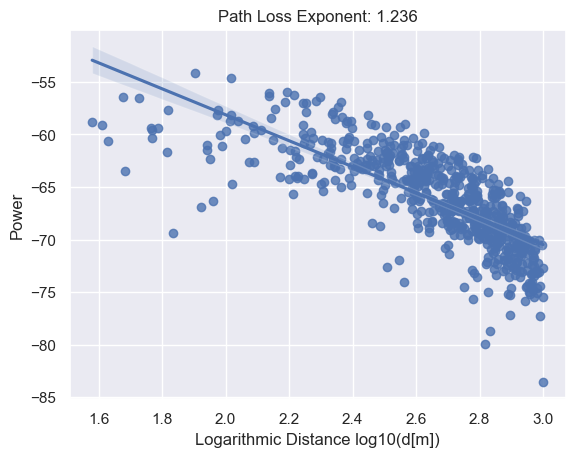

[36/100]: loss_d: 5.169, loss_g: 6.523, acc_real: 0.688, acc_fake: 0.701
0.0


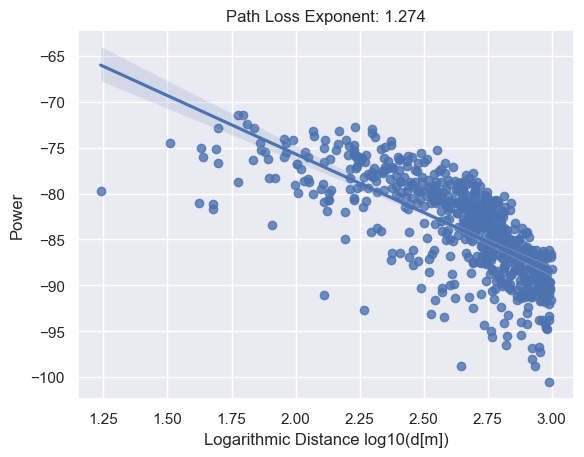

[37/100]: loss_d: 5.162, loss_g: 7.250, acc_real: 0.696, acc_fake: 0.706
0.0


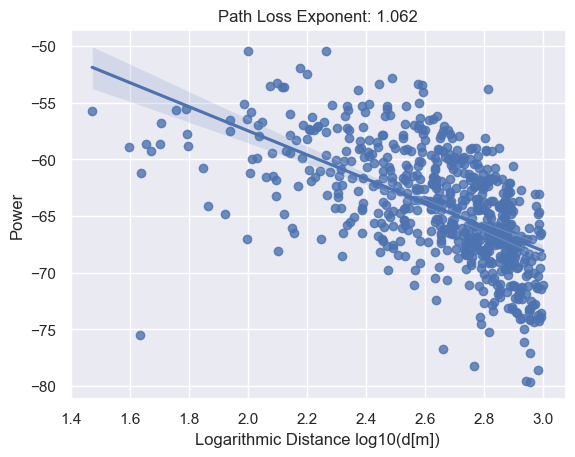

[38/100]: loss_d: 5.153, loss_g: 7.947, acc_real: 0.704, acc_fake: 0.711
0.0


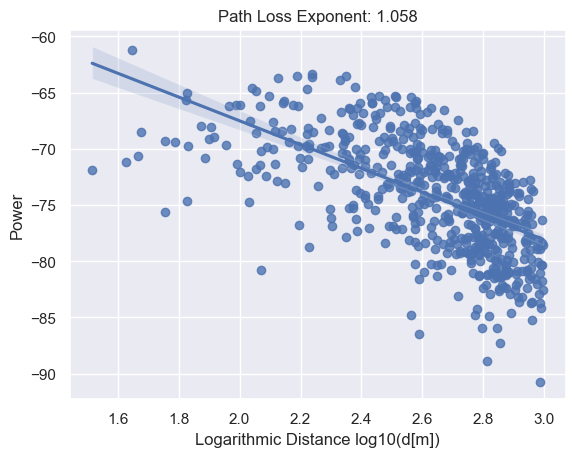

[39/100]: loss_d: 5.147, loss_g: 8.583, acc_real: 0.711, acc_fake: 0.716
0.0


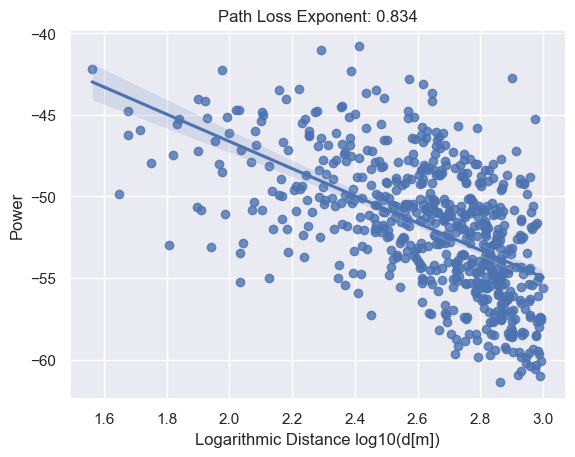

[40/100]: loss_d: 5.144, loss_g: 9.316, acc_real: 0.718, acc_fake: 0.721
0.0


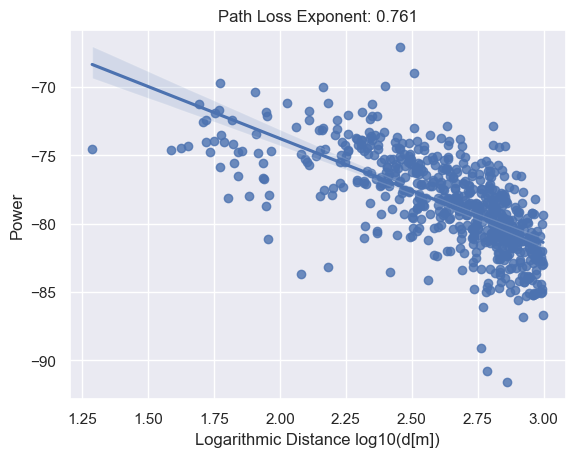

[41/100]: loss_d: 5.144, loss_g: 9.874, acc_real: 0.725, acc_fake: 0.725
0.0


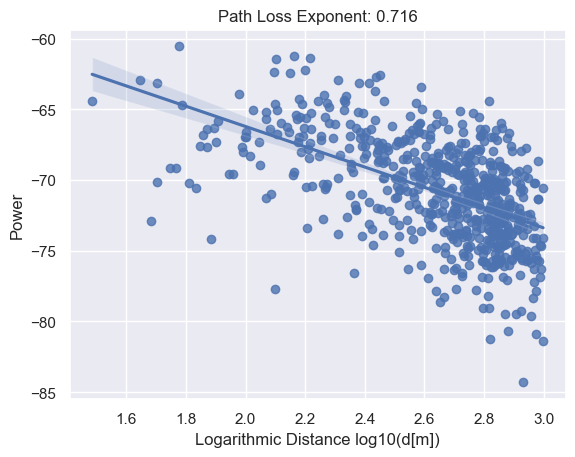

[42/100]: loss_d: 5.137, loss_g: 10.680, acc_real: 0.731, acc_fake: 0.730
0.0


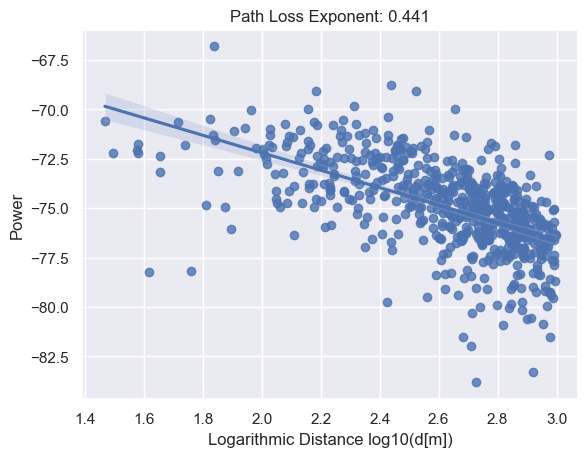

[43/100]: loss_d: 5.139, loss_g: 11.389, acc_real: 0.737, acc_fake: 0.734
0.0


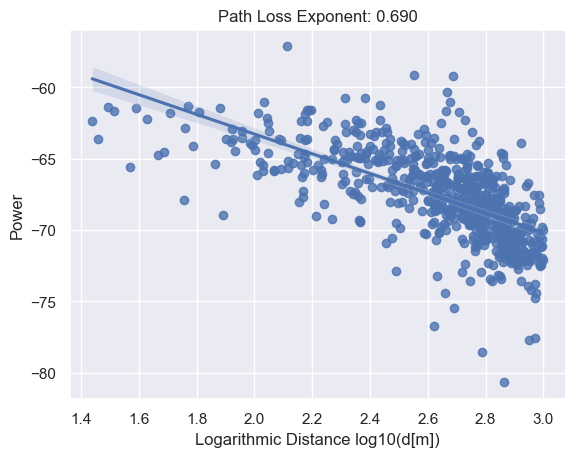

[44/100]: loss_d: 5.140, loss_g: 12.150, acc_real: 0.743, acc_fake: 0.738
0.0


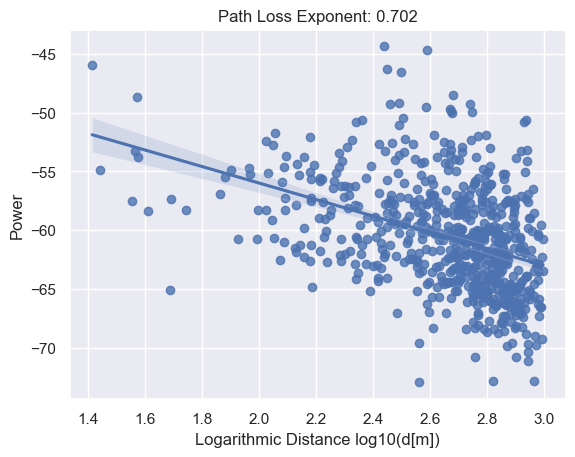

[45/100]: loss_d: 5.132, loss_g: 12.972, acc_real: 0.749, acc_fake: 0.742
0.0


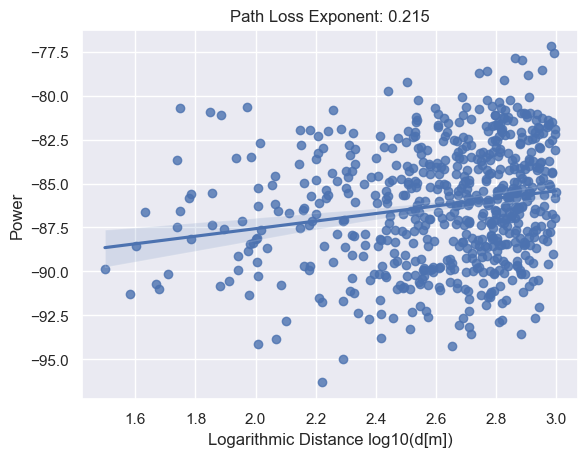

[46/100]: loss_d: 5.126, loss_g: 13.786, acc_real: 0.754, acc_fake: 0.745
0.0


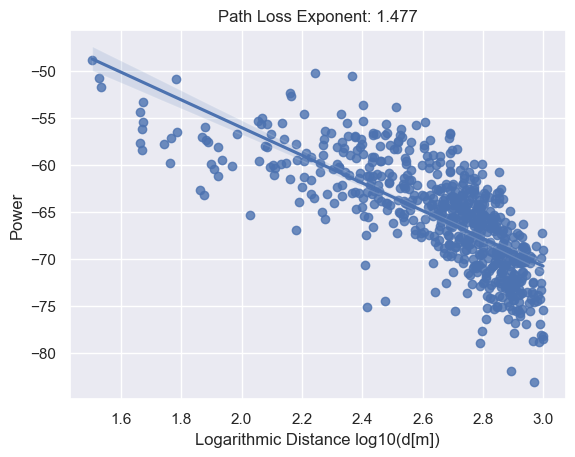

[47/100]: loss_d: 5.129, loss_g: 14.899, acc_real: 0.759, acc_fake: 0.749
0.0


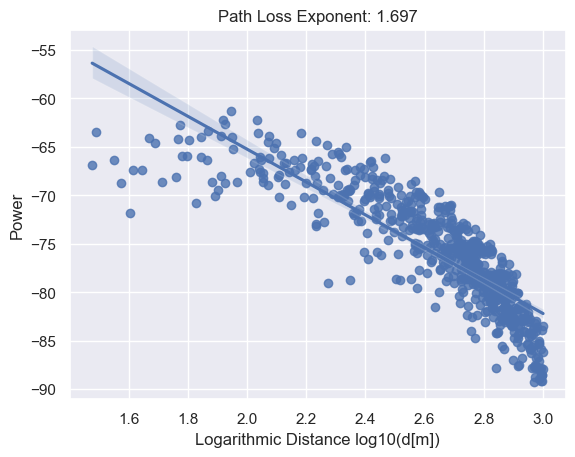

[48/100]: loss_d: 5.122, loss_g: 17.307, acc_real: 0.764, acc_fake: 0.752
0.0


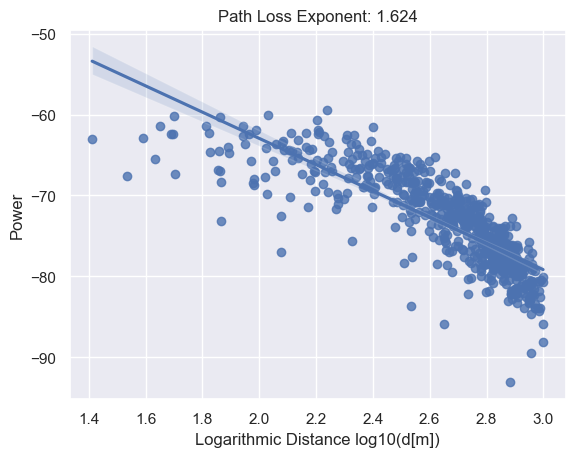

[49/100]: loss_d: 5.119, loss_g: 18.520, acc_real: 0.768, acc_fake: 0.755
0.0


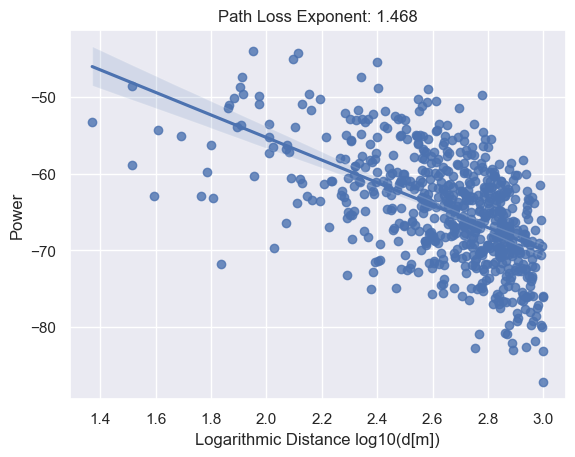

[50/100]: loss_d: 5.122, loss_g: 19.951, acc_real: 0.773, acc_fake: 0.759
0.0


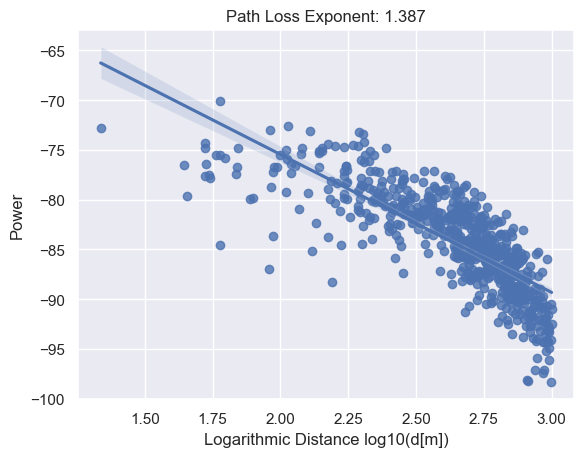

[51/100]: loss_d: 5.118, loss_g: 20.773, acc_real: 0.777, acc_fake: 0.762
0.0


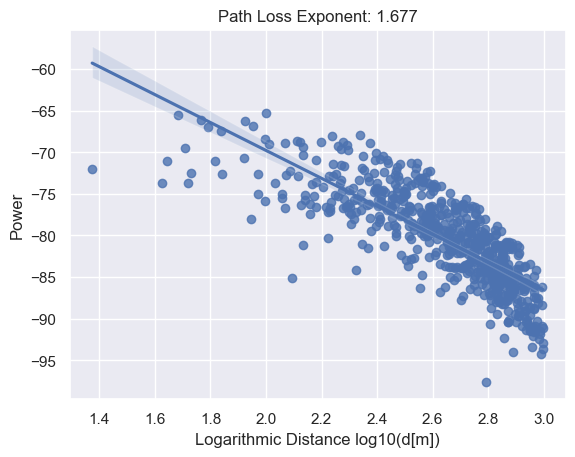

[52/100]: loss_d: 5.120, loss_g: 21.714, acc_real: 0.781, acc_fake: 0.765
0.0


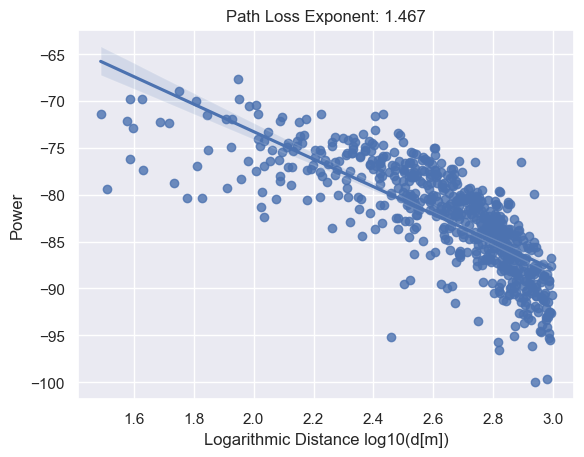

[53/100]: loss_d: 5.113, loss_g: 22.051, acc_real: 0.785, acc_fake: 0.768
0.0


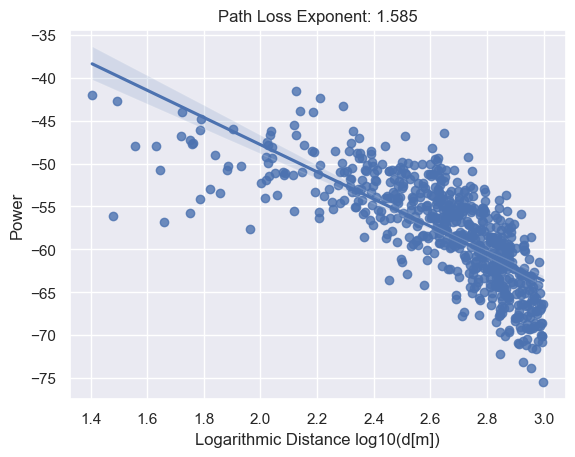

[54/100]: loss_d: 5.116, loss_g: 22.984, acc_real: 0.789, acc_fake: 0.770
0.0


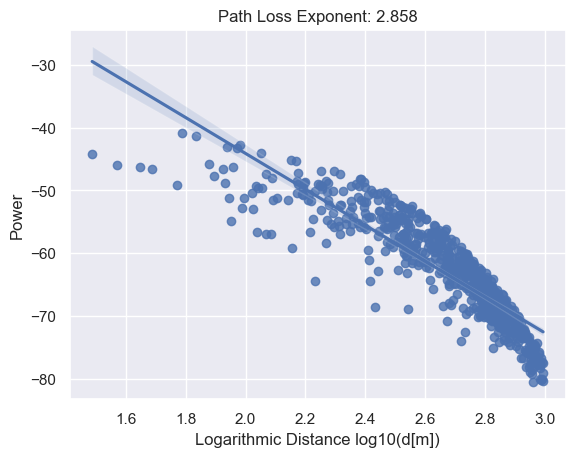

[55/100]: loss_d: 5.107, loss_g: 23.137, acc_real: 0.793, acc_fake: 0.773
0.0


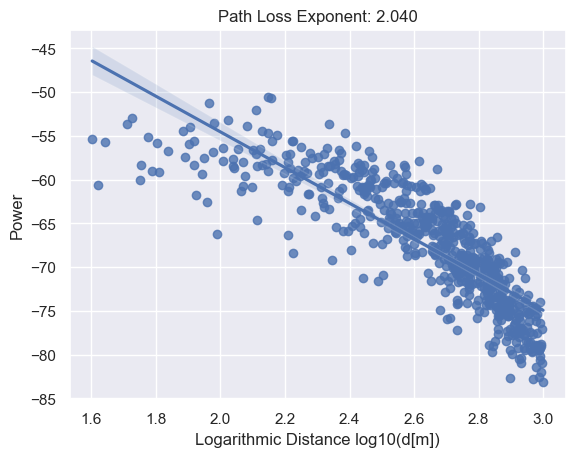

[56/100]: loss_d: 5.105, loss_g: 24.088, acc_real: 0.796, acc_fake: 0.776
0.0


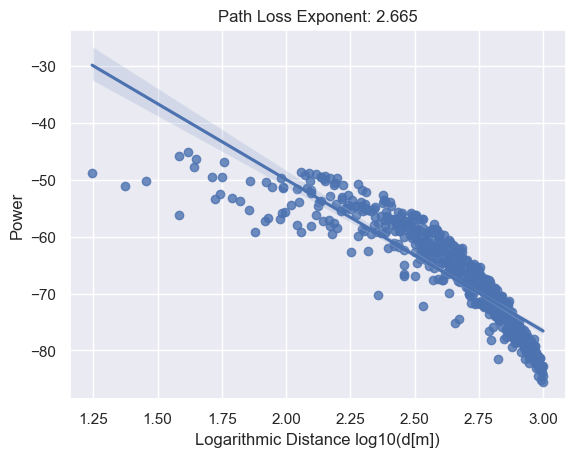

[57/100]: loss_d: 5.107, loss_g: 24.292, acc_real: 0.800, acc_fake: 0.778
0.0


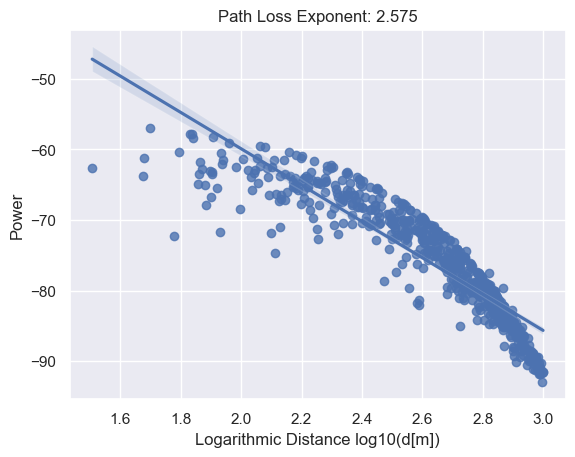

[58/100]: loss_d: 5.103, loss_g: 25.581, acc_real: 0.803, acc_fake: 0.781
0.0


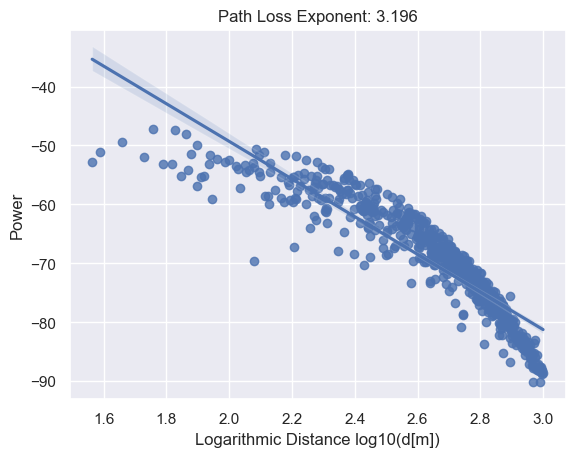

[59/100]: loss_d: 5.105, loss_g: 26.268, acc_real: 0.806, acc_fake: 0.783
0.0


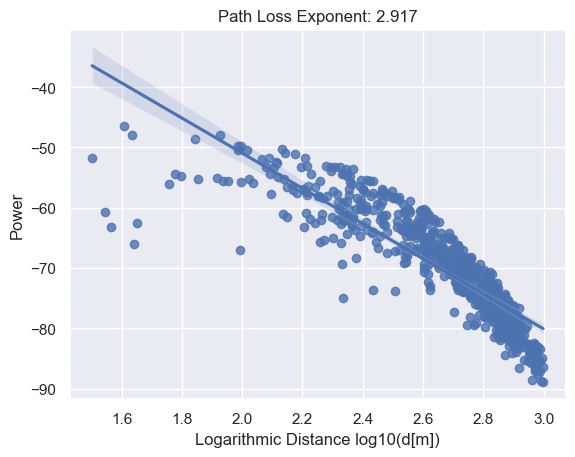

[60/100]: loss_d: 5.102, loss_g: 27.124, acc_real: 0.809, acc_fake: 0.785
0.0


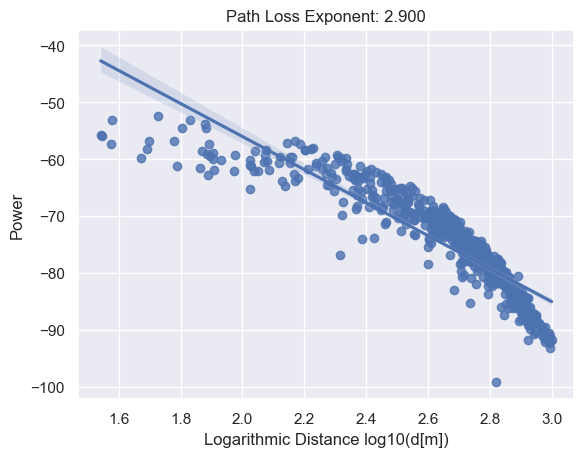

[61/100]: loss_d: 5.103, loss_g: 27.842, acc_real: 0.812, acc_fake: 0.788
0.0


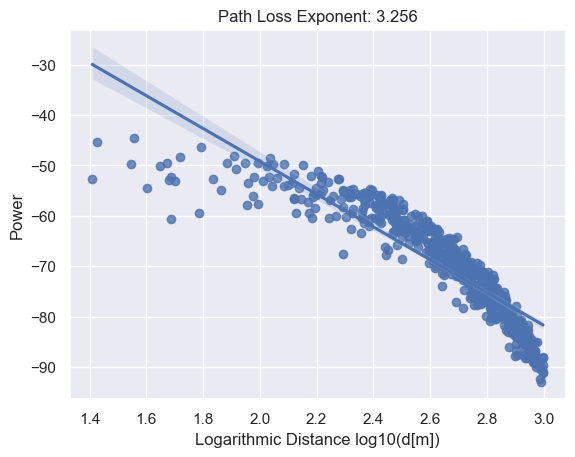

[62/100]: loss_d: 5.103, loss_g: 28.903, acc_real: 0.815, acc_fake: 0.790
0.0


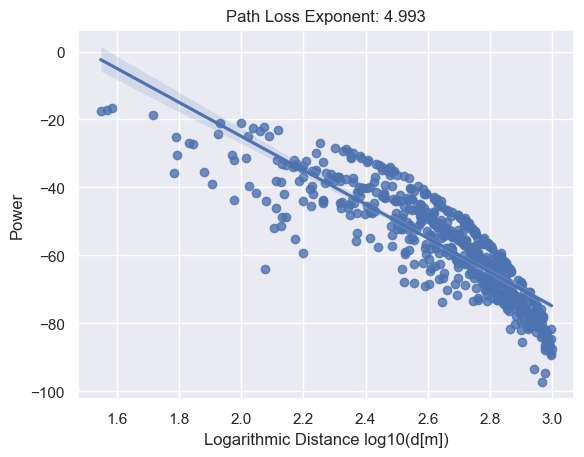

[63/100]: loss_d: 5.082, loss_g: 27.666, acc_real: 0.818, acc_fake: 0.792
0.0


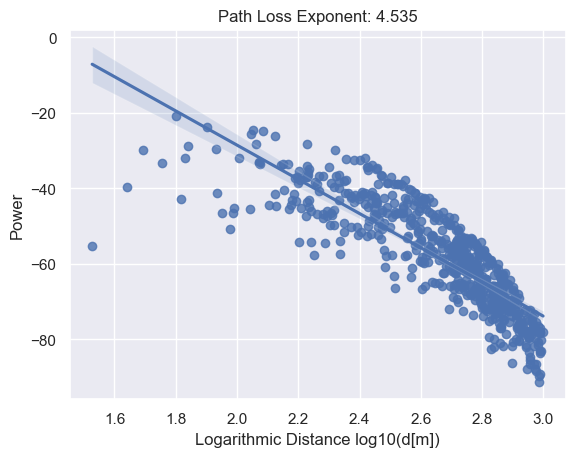

[64/100]: loss_d: 5.086, loss_g: 27.859, acc_real: 0.821, acc_fake: 0.794
0.0


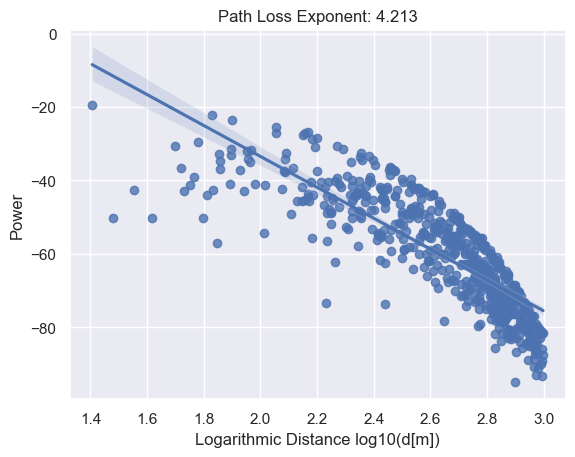

[65/100]: loss_d: 5.084, loss_g: 28.933, acc_real: 0.823, acc_fake: 0.796
0.0


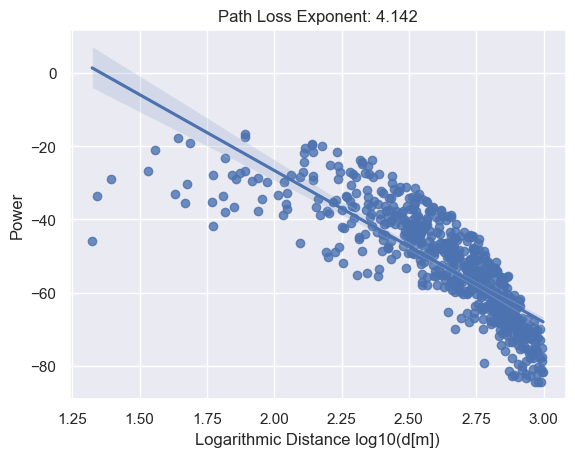

[66/100]: loss_d: 5.076, loss_g: 29.836, acc_real: 0.826, acc_fake: 0.798
0.0


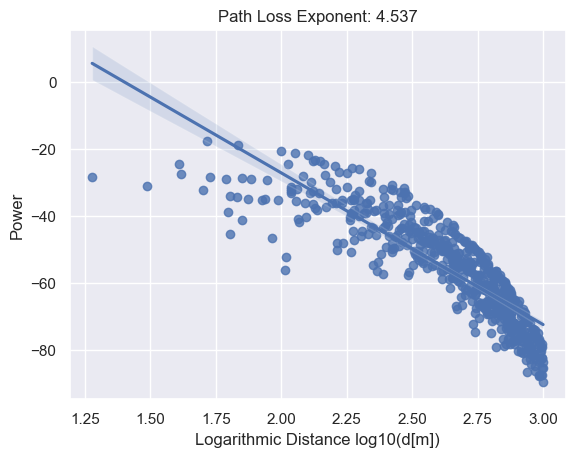

[67/100]: loss_d: 5.074, loss_g: 30.659, acc_real: 0.828, acc_fake: 0.800
0.0


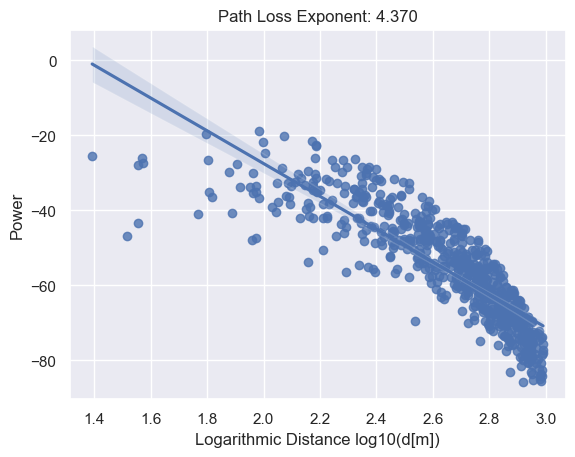

[68/100]: loss_d: 5.073, loss_g: 31.313, acc_real: 0.831, acc_fake: 0.802
0.0


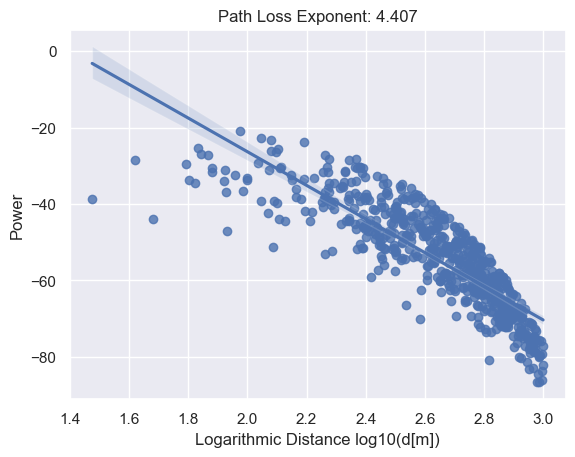

[69/100]: loss_d: 5.071, loss_g: 31.887, acc_real: 0.833, acc_fake: 0.804
0.0


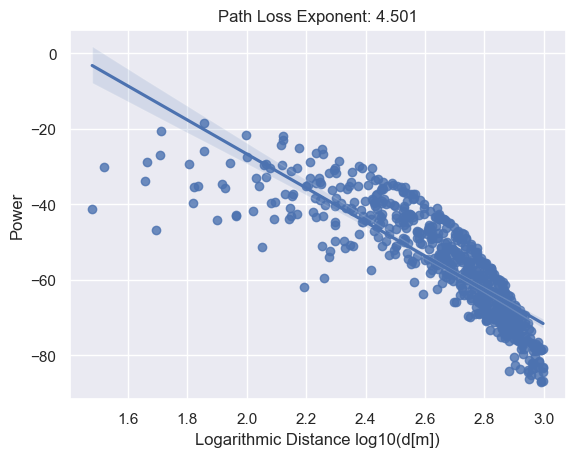

[70/100]: loss_d: 5.071, loss_g: 33.078, acc_real: 0.835, acc_fake: 0.806
0.0


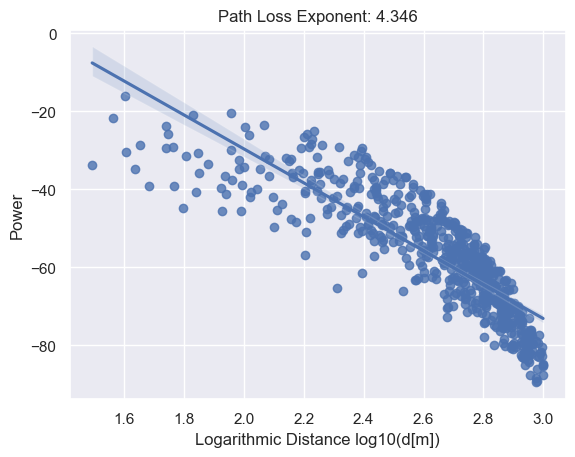

[71/100]: loss_d: 5.071, loss_g: 33.631, acc_real: 0.837, acc_fake: 0.807
0.0


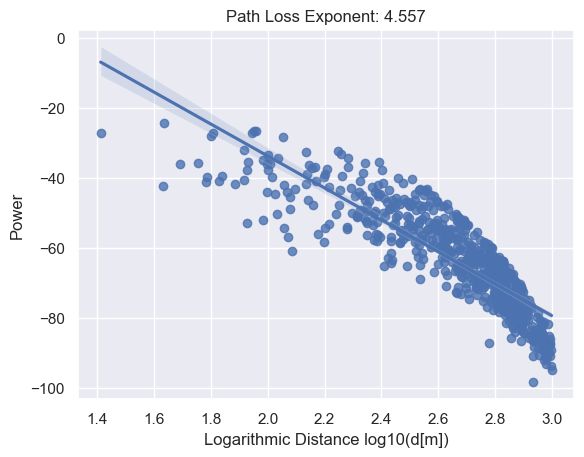

[72/100]: loss_d: 5.098, loss_g: 32.665, acc_real: 0.839, acc_fake: 0.809
0.0


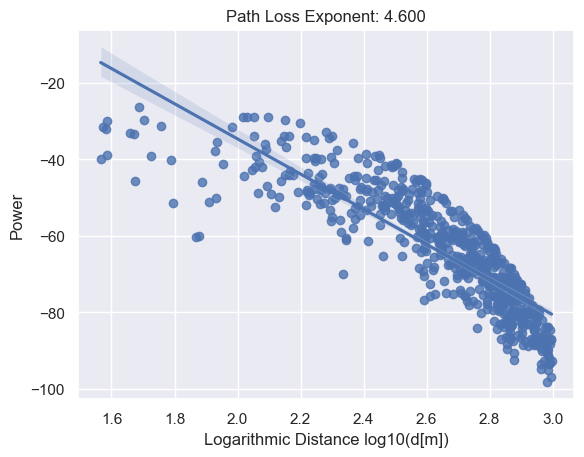

[73/100]: loss_d: 5.090, loss_g: 33.023, acc_real: 0.841, acc_fake: 0.811
0.0


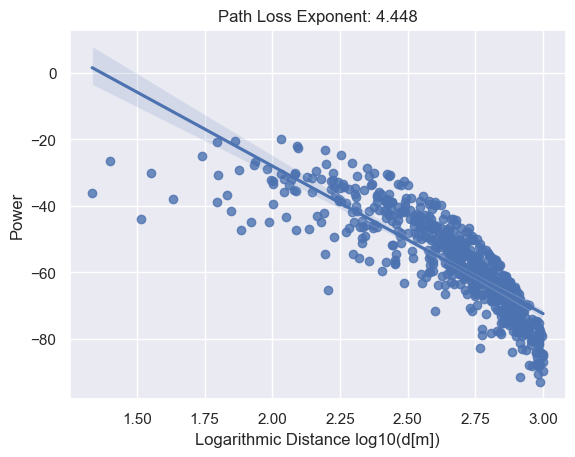

[74/100]: loss_d: 5.085, loss_g: 33.397, acc_real: 0.843, acc_fake: 0.812
0.0


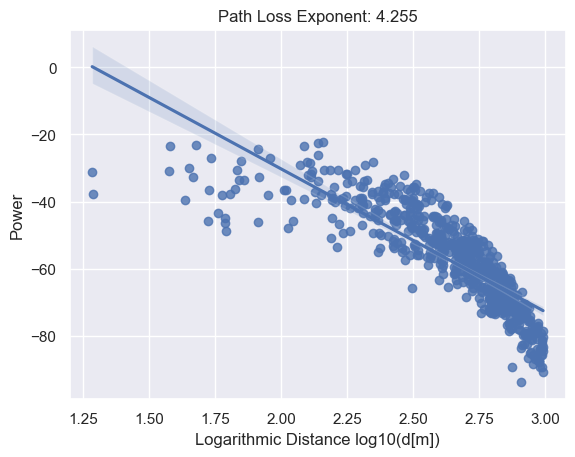

[75/100]: loss_d: 5.080, loss_g: 33.734, acc_real: 0.845, acc_fake: 0.814
0.0


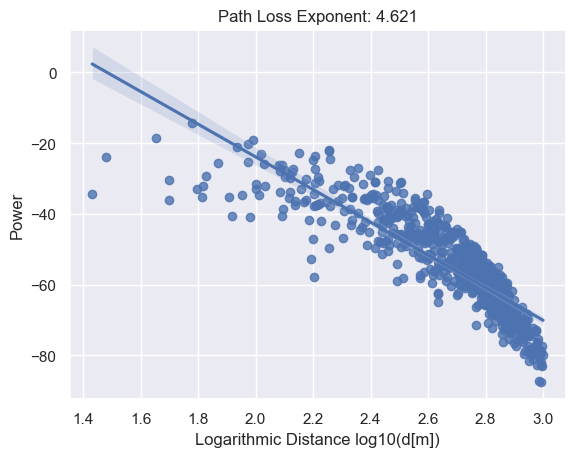

[76/100]: loss_d: 5.082, loss_g: 34.262, acc_real: 0.847, acc_fake: 0.815
0.0


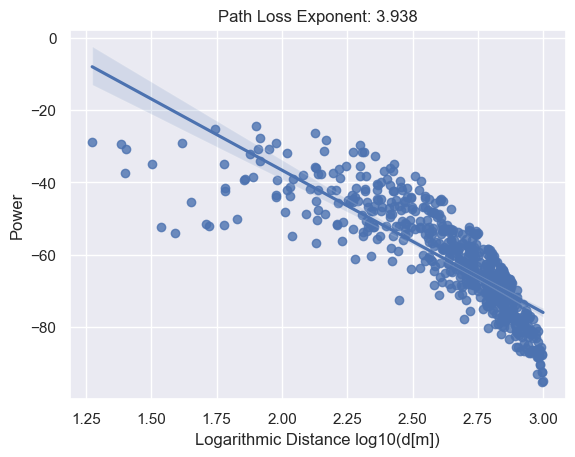

[77/100]: loss_d: 5.078, loss_g: 34.671, acc_real: 0.849, acc_fake: 0.817
0.0


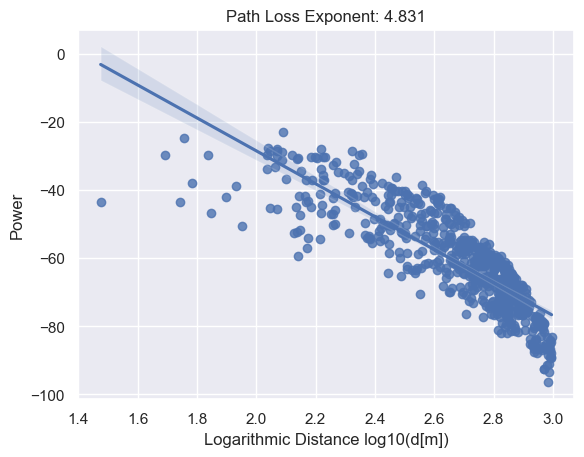

[78/100]: loss_d: 5.081, loss_g: 35.256, acc_real: 0.851, acc_fake: 0.818
0.0


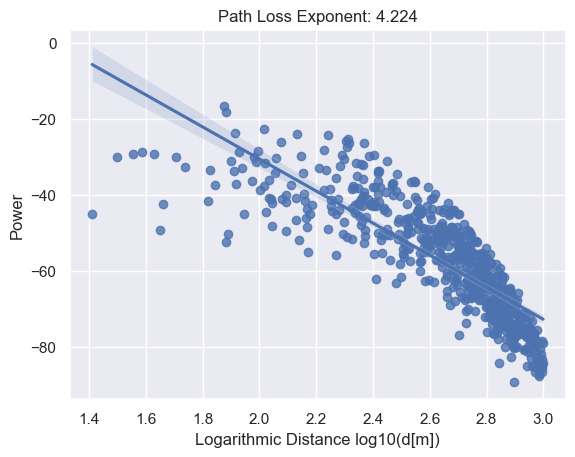

[79/100]: loss_d: 5.078, loss_g: 35.908, acc_real: 0.853, acc_fake: 0.820
0.0


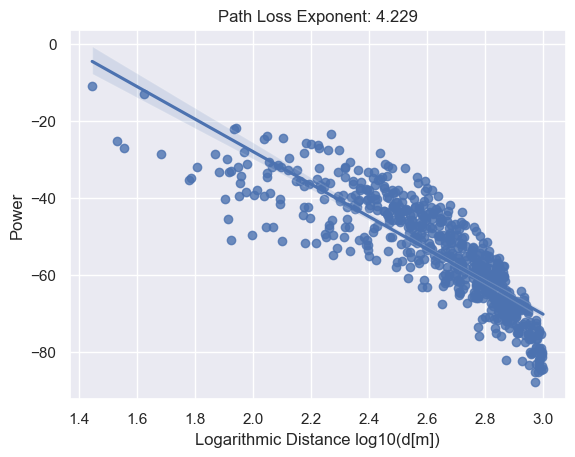

[80/100]: loss_d: 5.079, loss_g: 36.254, acc_real: 0.854, acc_fake: 0.821
0.0


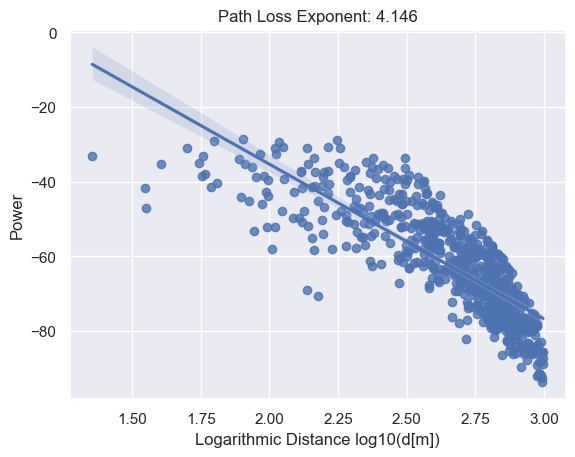

[81/100]: loss_d: 5.079, loss_g: 36.368, acc_real: 0.856, acc_fake: 0.823
0.0


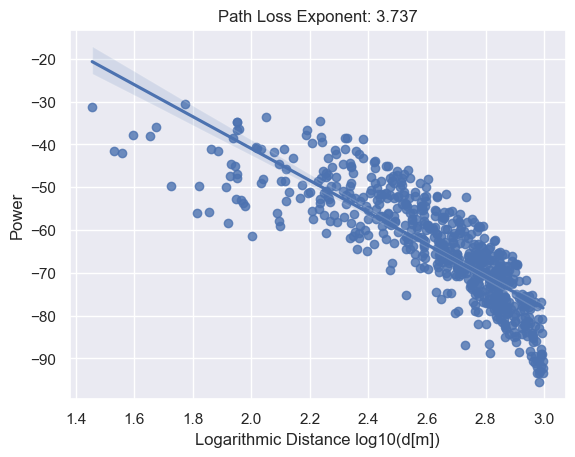

[82/100]: loss_d: 5.078, loss_g: 36.925, acc_real: 0.858, acc_fake: 0.824
0.0


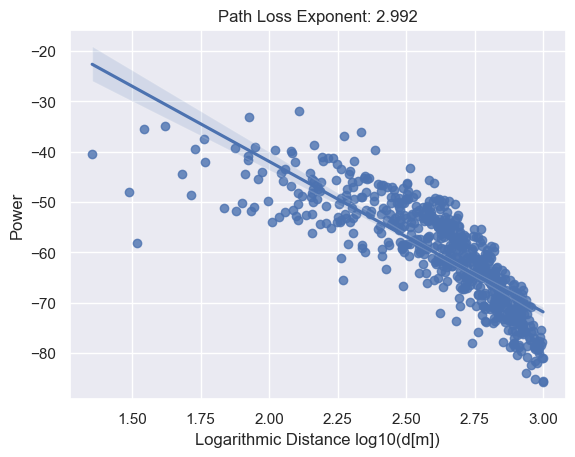

[83/100]: loss_d: 5.085, loss_g: 38.128, acc_real: 0.859, acc_fake: 0.825
0.0


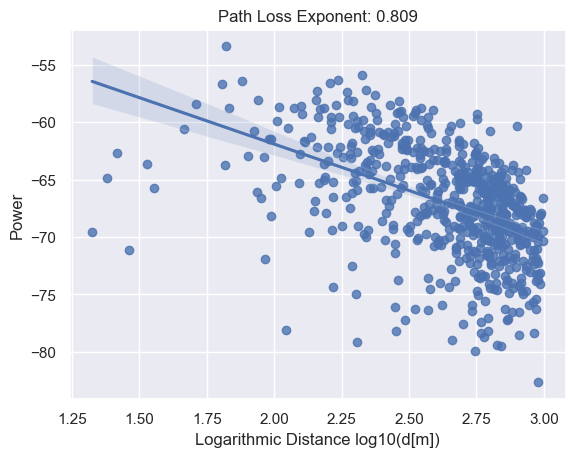

[84/100]: loss_d: 5.095, loss_g: 39.921, acc_real: 0.861, acc_fake: 0.827
0.0


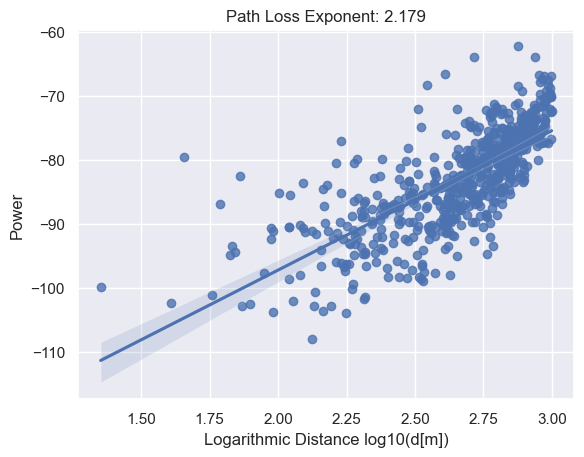

[85/100]: loss_d: 5.098, loss_g: 39.580, acc_real: 0.862, acc_fake: 0.828
0.0


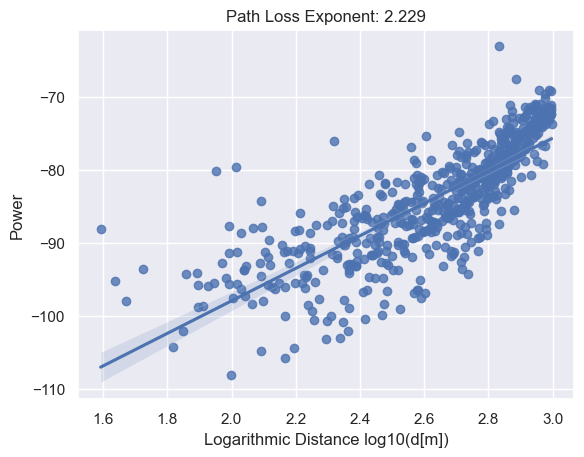

[86/100]: loss_d: 5.103, loss_g: 41.254, acc_real: 0.864, acc_fake: 0.829
0.0


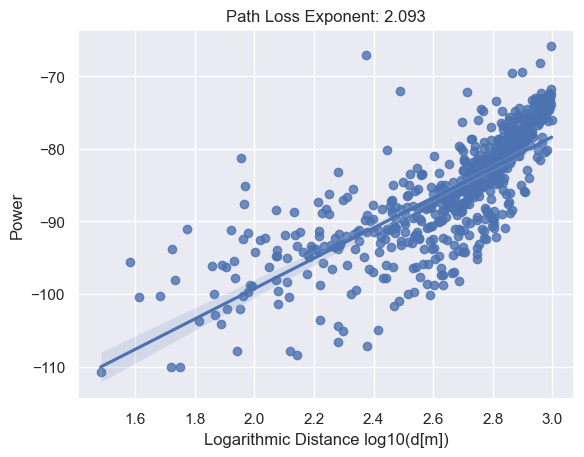

[87/100]: loss_d: 5.119, loss_g: 46.898, acc_real: 0.865, acc_fake: 0.830
0.0


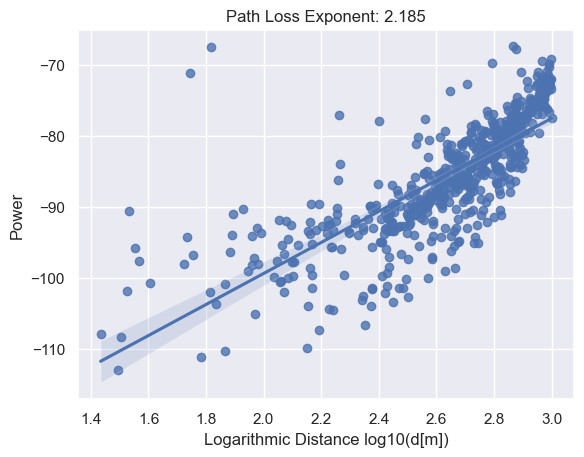

[88/100]: loss_d: 5.123, loss_g: 45.444, acc_real: 0.867, acc_fake: 0.831
0.0


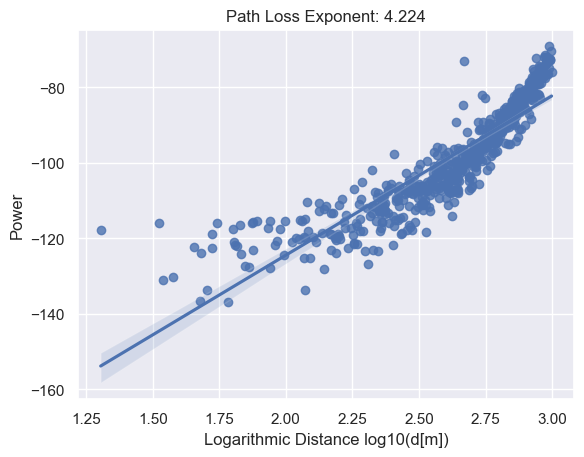

[89/100]: loss_d: 5.116, loss_g: 43.928, acc_real: 0.868, acc_fake: 0.832
0.0


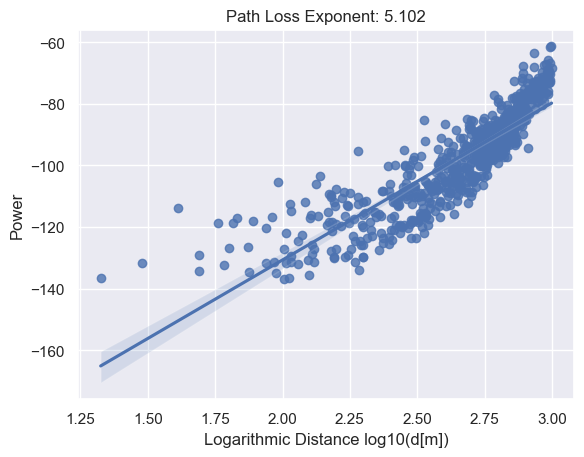

[90/100]: loss_d: 5.086, loss_g: 38.726, acc_real: 0.869, acc_fake: 0.833
0.0


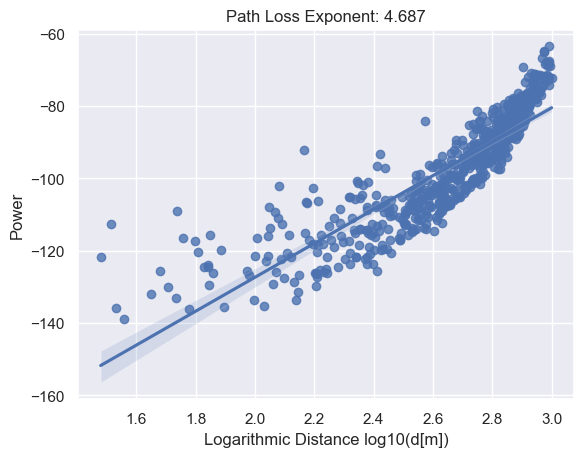

[91/100]: loss_d: 5.074, loss_g: 37.806, acc_real: 0.870, acc_fake: 0.834
0.0


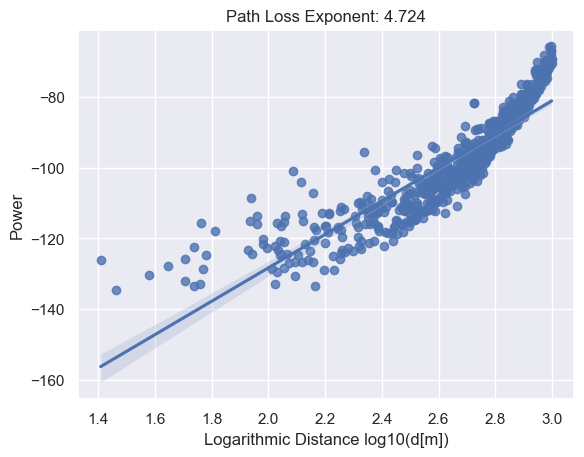

[92/100]: loss_d: 5.060, loss_g: 38.099, acc_real: 0.871, acc_fake: 0.836
0.0


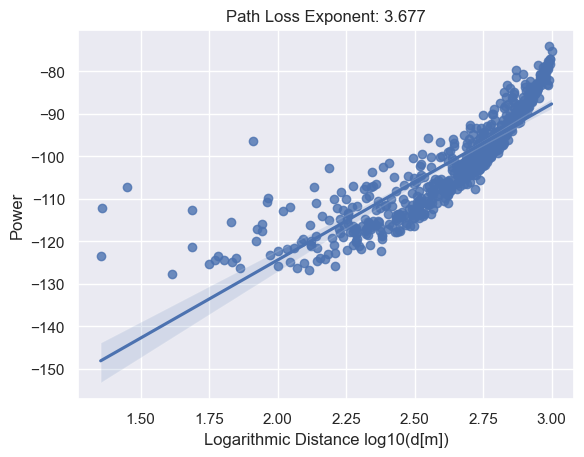

[93/100]: loss_d: 5.054, loss_g: 38.869, acc_real: 0.873, acc_fake: 0.837
0.0


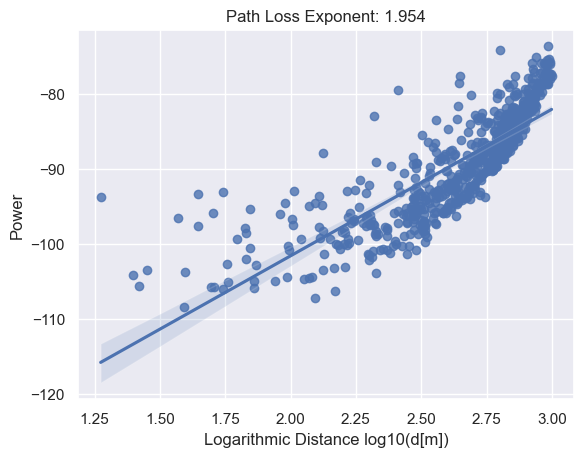

[94/100]: loss_d: 5.066, loss_g: 38.288, acc_real: 0.874, acc_fake: 0.838
0.0


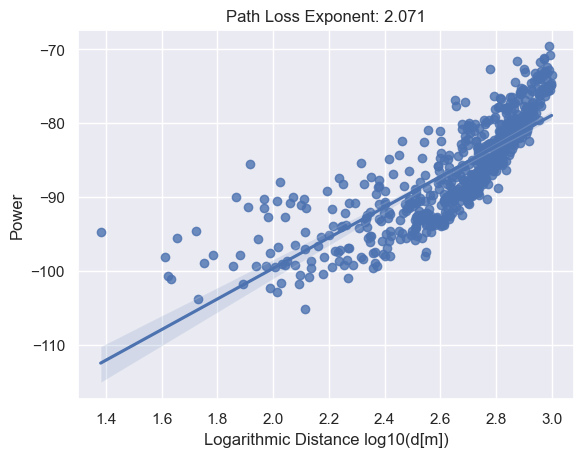

[95/100]: loss_d: 5.067, loss_g: 38.991, acc_real: 0.875, acc_fake: 0.839
0.0


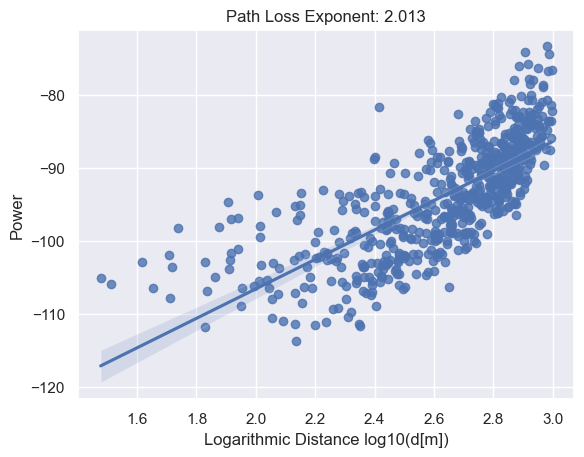

[96/100]: loss_d: 5.057, loss_g: 39.833, acc_real: 0.876, acc_fake: 0.840
0.0


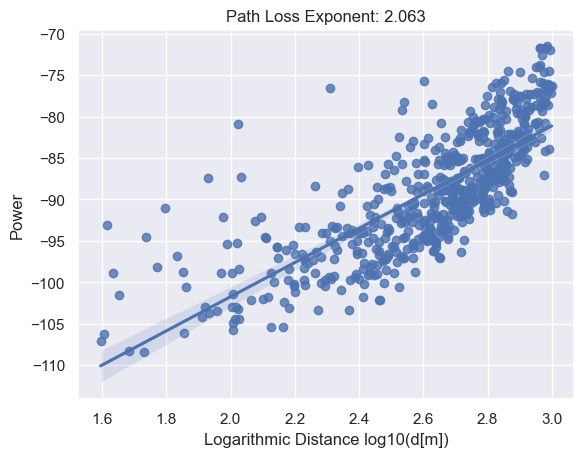

[97/100]: loss_d: 5.053, loss_g: 39.961, acc_real: 0.877, acc_fake: 0.840
0.0


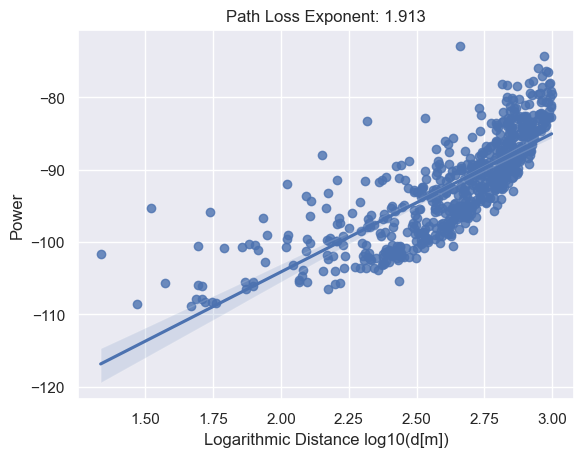

[98/100]: loss_d: 5.052, loss_g: 40.206, acc_real: 0.878, acc_fake: 0.841
0.0


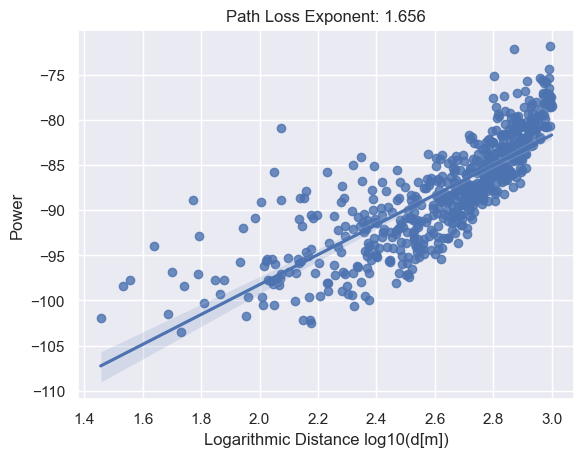

[99/100]: loss_d: 5.130, loss_g: 41.251, acc_real: 0.879, acc_fake: 0.842


In [66]:
import seaborn as sns
def accuracy(output, target, threshold=0.5):
    with torch.no_grad():
        prediction = (output >= threshold).float()
        correct = (prediction == target).float().sum()
        accuracy = correct / len(target)
        return accuracy.item()


class GeneratorModel(nn.Module):
    def __init__(self):
        super(GeneratorModel, self).__init__()
        embed_dim = 0
        input_dim = 4 + 1 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 32),
            nn.ReLU()
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(32, 16)
        )
        self.hidden_layer3 = nn.Sequential(
            nn.Linear(16, output_dim)
        )

        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        #info_out = self.sigm(self.ae(info[:, 4:]))
        x = torch.cat([x, torch.sqrt((info[:,2]-info[:, 0])**2 +(info[:, 3]-info[:, 1])**2).unsqueeze(1)], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)
        output = self.hidden_layer3(output)

        return output.to(device)


class DiscriminatorModel(nn.Module):
    def __init__(self):
        super(DiscriminatorModel, self).__init__()
        embed_dim = 0
        input_dim = 1 + 1 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim),
            nn.Sigmoid()
        )
        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        #x_out = self.sigm(self.ae(x[:, 4:]))
        x = torch.cat([torch.sqrt((x[:, 2]-x[:, 0])**2 + (x[:, 3]-x[:, 1])**2).unsqueeze(1), info], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


discriminator = DiscriminatorModel()
generator = GeneratorModel()
discriminator.to(device)
generator.to(device)

discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
generator_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

loss = nn.BCELoss()
noise_dim = 4
n_epochs = 100
batch_size = 48
G_loss_mean = []
D_loss_mean = []
D_real_mean = []
D_fake_mean = []
accuracy_real = []
accuracy_real_mean = []
accuracy_fake = []
accuracy_fake_mean = []
for epoch_idx in range(n_epochs):
    G_loss = []
    D_loss = []
    D_real = []
    D_fake = []
    for batch_idx, data_input in enumerate(train_ldr):
        if data_input[1].shape[0]!=batch_size and batch_idx==len(train_ldr)-1:
            continue
        if batch_idx%1000 == 0:
            print(batch_idx/len(train_ldr))
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,3005)).to(device)
        generated_data = generator(noise, fake_info)  # batch_size X 784

        # Discriminator
        true_data = data_input[0].view(batch_size, 3005).to(device)  # batch_size X 784
        cond_info = data_input[1].to(device)  # batch_size
        true_labels = torch.ones(batch_size).to(device)

        discriminator_optimizer.zero_grad()

        discriminator_output_for_true_data = discriminator(true_data, cond_info).view(batch_size)
        true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)
        acc_real = accuracy(discriminator_output_for_true_data, true_labels)
        discriminator_output_for_generated_data = discriminator(fake_info, generated_data.detach()).view(batch_size)
        generator_discriminator_loss = loss(
            discriminator_output_for_generated_data, torch.zeros(batch_size).to(device)
        )
        gp = gradient_penalty(discriminator, true_data, cond_info, generated_data.detach(), batch_size)
        acc_fake = accuracy(discriminator_output_for_generated_data, torch.zeros(batch_size).to(device))
        discriminator_loss = (
                                     true_discriminator_loss + generator_discriminator_loss + 10*gp
                             ) / 2

        discriminator_loss.backward()
        discriminator_optimizer.step()

        D_loss.append(discriminator_loss.data.item())
        D_real.append(true_discriminator_loss)
        D_fake.append(generator_discriminator_loss)
        accuracy_real.append(acc_real)
        accuracy_fake.append(acc_fake)
        # Generator

        for _ in range(30):
            generator_optimizer.zero_grad()
            # It's a choice to generate the data again
            generated_data = generator(noise, fake_info)  # batch_size X 784
            discriminator_output_on_generated_data = discriminator(fake_info, generated_data).view(batch_size)
            generator_loss = loss(discriminator_output_on_generated_data, true_labels)
            generator_loss.backward()
            generator_optimizer.step()
            fake_info = torch.rand((batch_size,3005)).to(device)
            noise = torch.randn(batch_size, noise_dim).to(device)

        G_loss.append(generator_loss.data.item())


    dist_list =[]
    gan_rss_list = []
    with torch.no_grad():
        noise = torch.randn(1000, noise_dim).to(device)
        fake_info = torch.rand((1000,3005)).to(device)
        fake_info[:, [0,1,2,3]] = torch.zeros(1000, 4)
        fake_info[:, 2] = torch.rand((1000,))*0.14 + torch.logspace(-2.5, 0, 1000)
        #fake_info[:, 3] -= torch.logspace(0, 0.6, 1000)
        generated_data = generator(noise, fake_info).cpu().view(1000, 1)
        for i, x in enumerate(generated_data):
            fake_info_reconst = fake_info[i].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= (max_elev-min_elev)
            fake_info_reconst[4:] += min_elev 
            d = find_dist(fake_info_reconst[:4], 0.5)
            if d<1000:
                dist_list.append(d)
                gan_rss_list.append(x.detach().numpy()[0])

            #dist_list.append(find_dist(fake_info_reconst, 0.5))
            #gan_rss_list.append(x.detach().numpy()[0])

    a, b = np.polyfit(np.log10(dist_list), gan_rss_list, 1)
    plt.figure()
    ax = sns.regplot(x=np.log10(dist_list), y=gan_rss_list)
    ax.set_axisbelow(True)
    plt.xlabel("Logarithmic Distance log10(d[m])")
    plt.ylabel("Power")
    plt.title("Path Loss Exponent: %.3f" %abs(a/10))
    plt.grid(True)
    plt.show()
    '''
    with torch.no_grad():
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,18337)).to(device)
        generated_data = generator(noise, fake_info).cpu().view(batch_size, 1)
        for x in generated_data:
            fake_info_reconst = fake_info[0].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= max_elev
            print(fake_info_reconst)
            print(x.detach().numpy())
            #plt.imshow(x.detach().numpy(), interpolation='nearest', cmap='gray')
            #plt.show()

            break
    '''
    print('[%d/%d]: loss_d: %.3f, loss_g: %.3f, acc_real: %.3f, acc_fake: %.3f' % (
        (epoch_idx), n_epochs, torch.mean(torch.FloatTensor(D_loss)), torch.mean(torch.FloatTensor(G_loss)), torch.mean(torch.FloatTensor(accuracy_real)), torch.mean(torch.FloatTensor(accuracy_fake))))
    G_loss_mean.append(torch.mean(torch.FloatTensor(G_loss)))
    D_loss_mean.append(torch.mean(torch.FloatTensor(D_loss)))
    D_real_mean.append(torch.mean(torch.FloatTensor(D_real)))
    D_fake_mean.append(torch.mean(torch.FloatTensor(D_fake)))
    accuracy_real_mean.append(torch.mean(torch.FloatTensor(accuracy_real)))
    accuracy_fake_mean.append(torch.mean(torch.FloatTensor(accuracy_fake)))


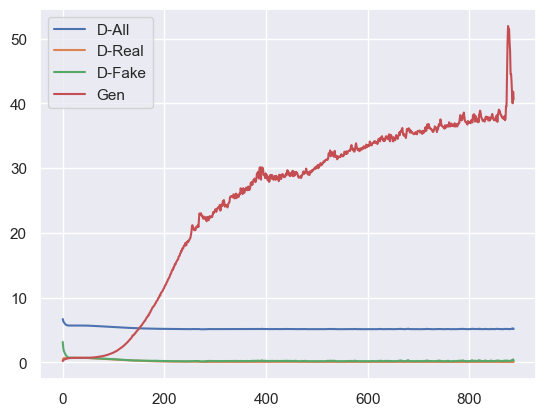

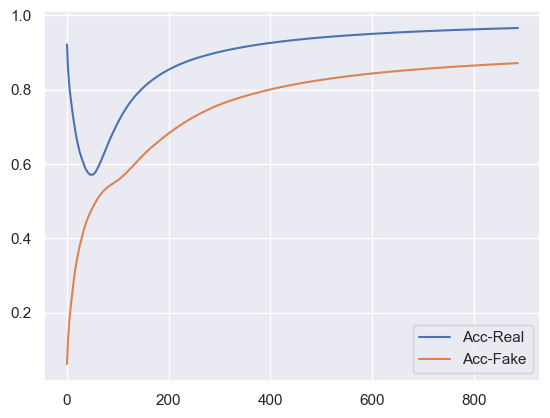

In [65]:
import matplotlib.pyplot as plt
plt.figure()
plt.plot(D_loss_mean)
plt.plot(D_real_mean)
plt.plot(D_fake_mean)
plt.plot(G_loss_mean)
plt.legend(["D-All", "D-Real", "D-Fake", "Gen"])
plt.show()

plt.figure()
plt.plot(accuracy_real_mean)
plt.plot(accuracy_fake_mean)
plt.legend(["Acc-Real", "Acc-Fake"])
plt.show()


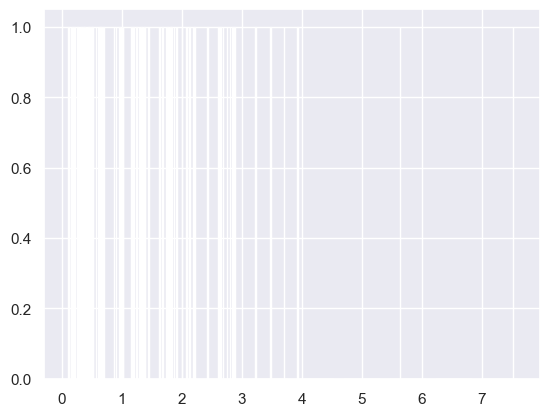

In [58]:
from torch.distributions.exponential import Exponential
m = Exponential(torch.tensor([1.0]))
a = m.sample_n(100)  # Exponential distributed with rate=1

plt.figure()
plt.hist(a)
plt.show()

0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


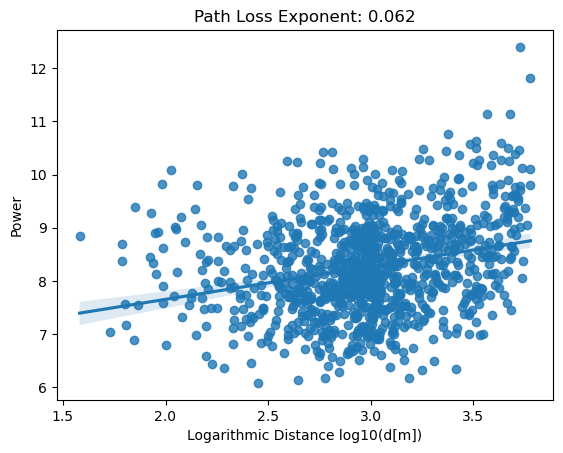

[0/80]: loss_d: 4.433, loss_g: 0.683, acc_real: 0.065, acc_fake: 0.379
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


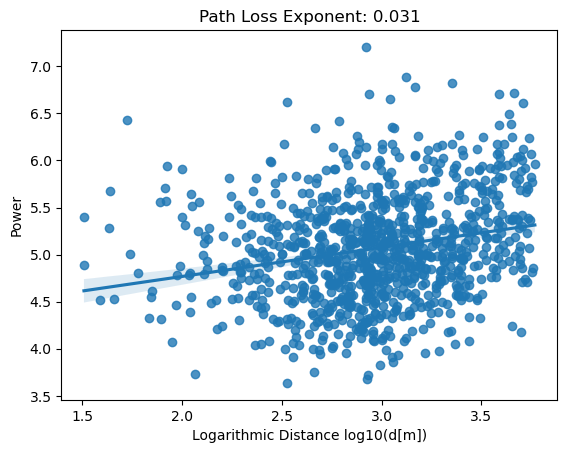

[1/80]: loss_d: 2.611, loss_g: 0.722, acc_real: 0.110, acc_fake: 0.474
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


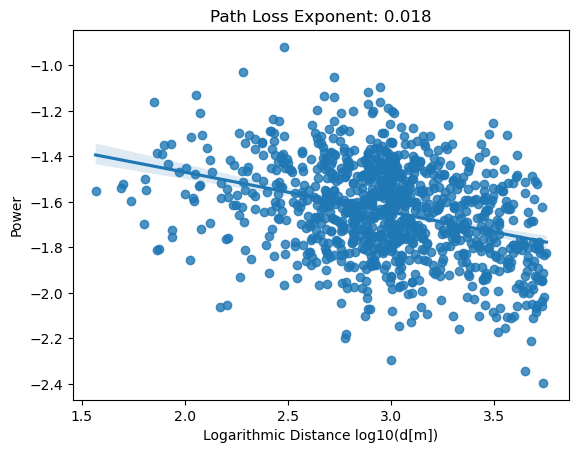

[2/80]: loss_d: 1.438, loss_g: 0.672, acc_real: 0.204, acc_fake: 0.441
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


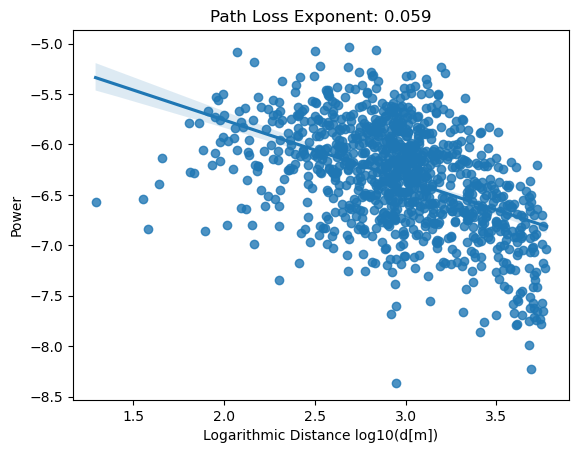

[3/80]: loss_d: 0.968, loss_g: 0.619, acc_real: 0.321, acc_fake: 0.385
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


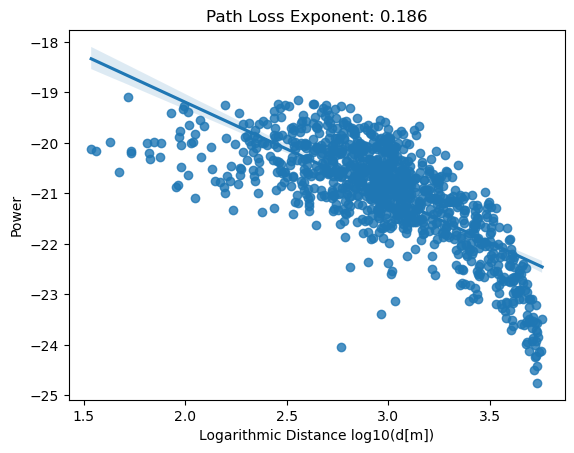

[4/80]: loss_d: 0.911, loss_g: 0.582, acc_real: 0.404, acc_fake: 0.359
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


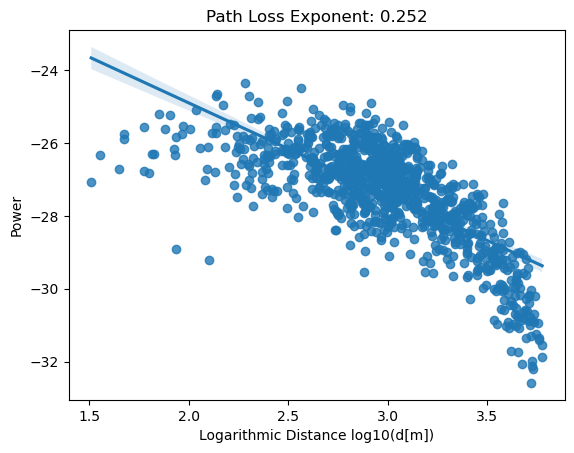

[5/80]: loss_d: 0.969, loss_g: 0.603, acc_real: 0.459, acc_fake: 0.346
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


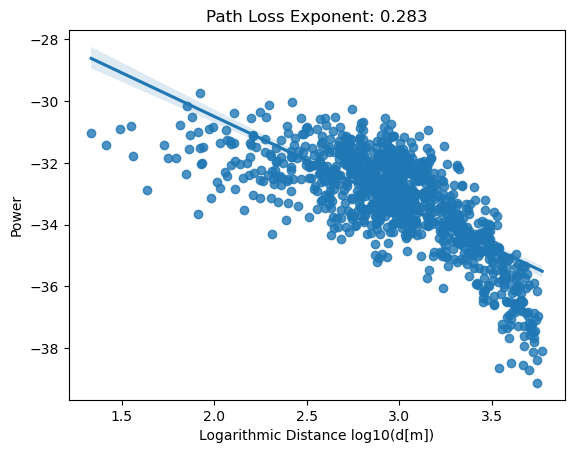

[6/80]: loss_d: 0.941, loss_g: 0.662, acc_real: 0.496, acc_fake: 0.343
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


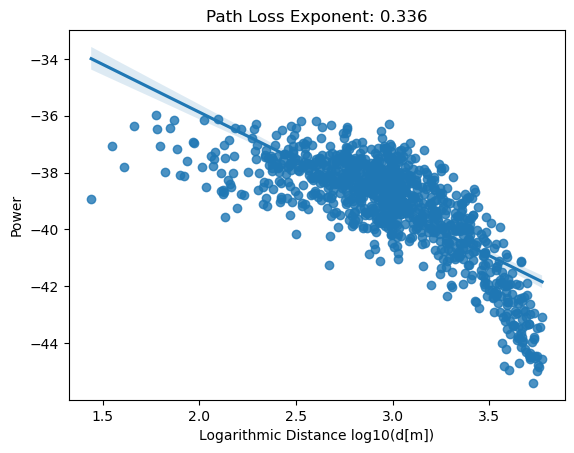

[7/80]: loss_d: 0.915, loss_g: 0.714, acc_real: 0.520, acc_fake: 0.348
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


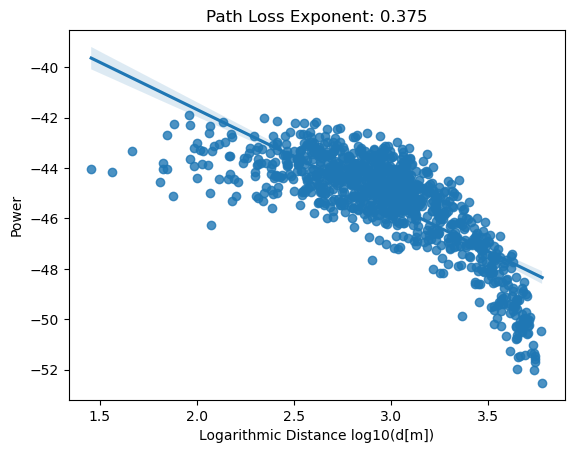

[8/80]: loss_d: 0.881, loss_g: 0.764, acc_real: 0.533, acc_fake: 0.355
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


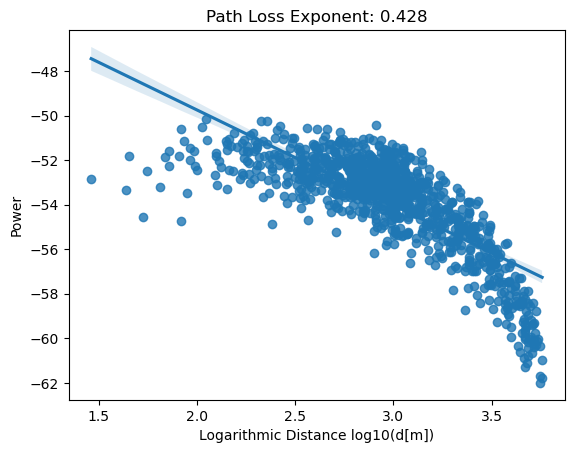

[9/80]: loss_d: 0.870, loss_g: 0.795, acc_real: 0.539, acc_fake: 0.364
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


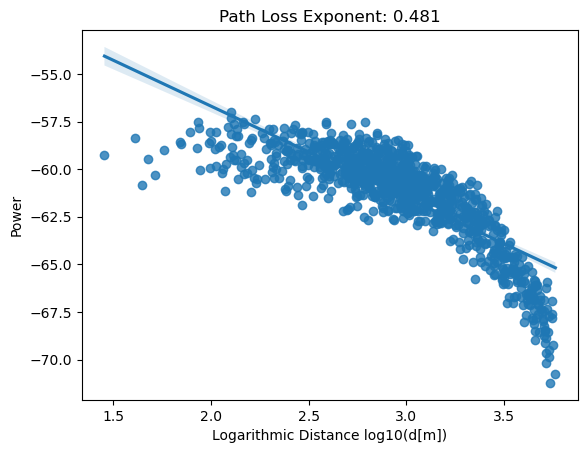

[10/80]: loss_d: 0.836, loss_g: 0.831, acc_real: 0.539, acc_fake: 0.374
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


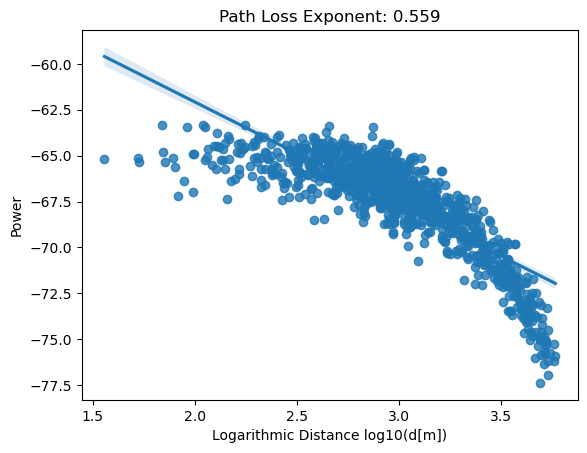

[11/80]: loss_d: 0.803, loss_g: 0.850, acc_real: 0.533, acc_fake: 0.388
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


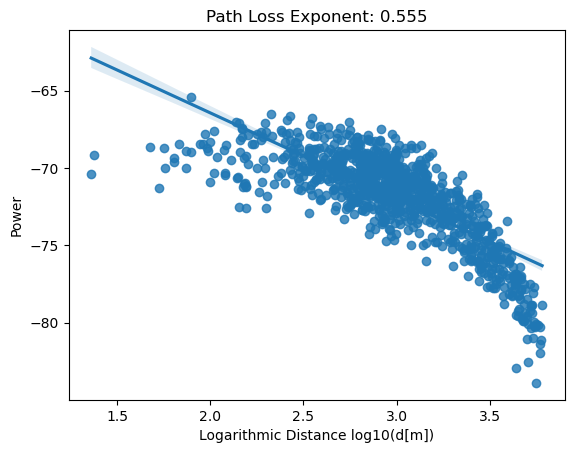

[12/80]: loss_d: 0.768, loss_g: 0.861, acc_real: 0.523, acc_fake: 0.405
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


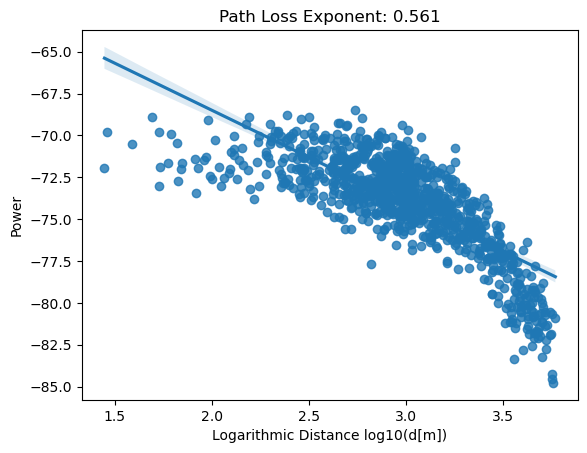

[13/80]: loss_d: 0.734, loss_g: 0.857, acc_real: 0.510, acc_fake: 0.422
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


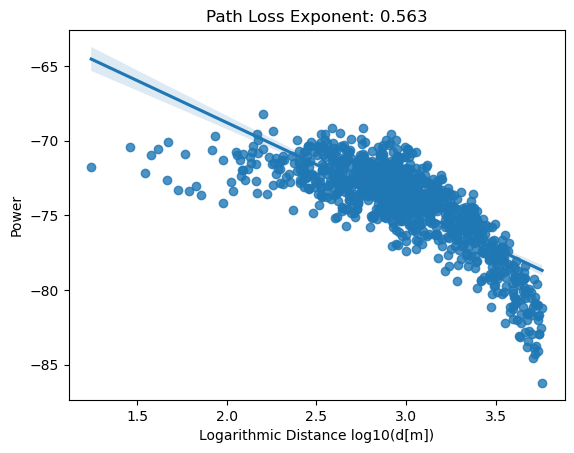

[14/80]: loss_d: 0.711, loss_g: 0.847, acc_real: 0.498, acc_fake: 0.438
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


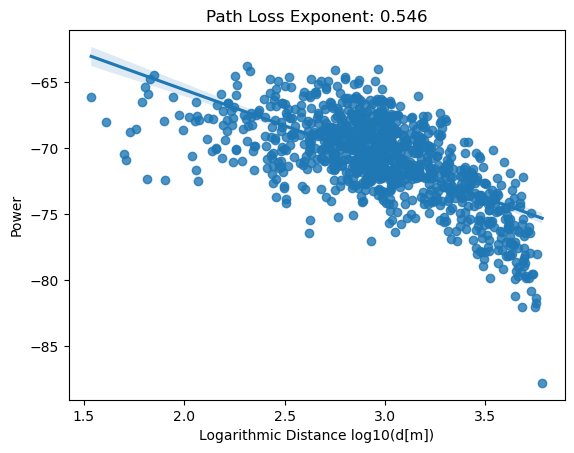

[15/80]: loss_d: 0.690, loss_g: 0.802, acc_real: 0.490, acc_fake: 0.452
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


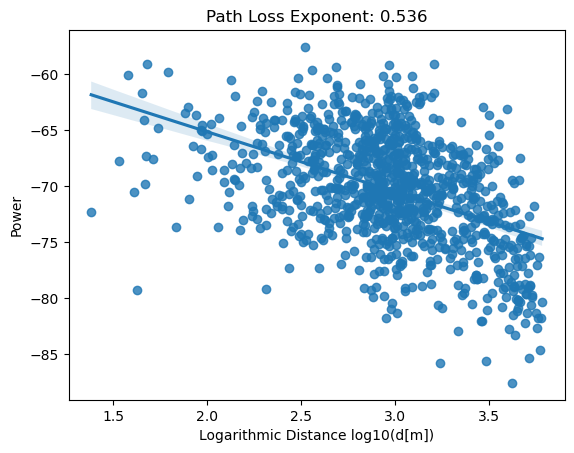

[16/80]: loss_d: 0.683, loss_g: 0.782, acc_real: 0.485, acc_fake: 0.466
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


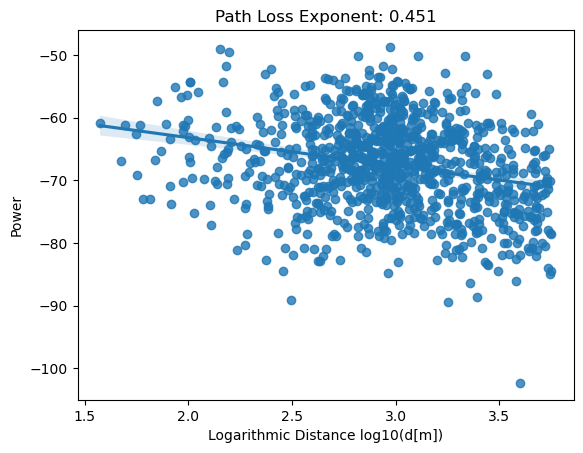

[17/80]: loss_d: 0.679, loss_g: 0.773, acc_real: 0.480, acc_fake: 0.479
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


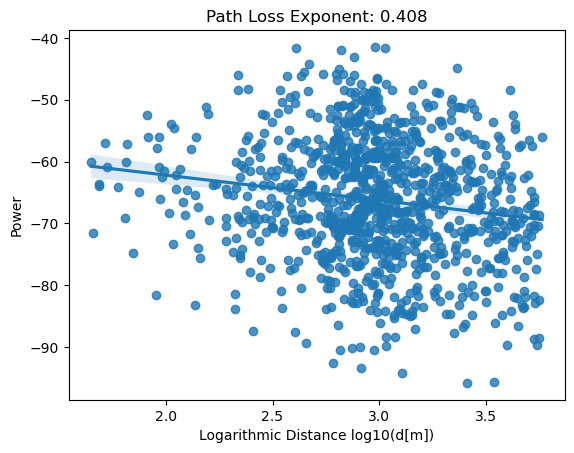

[18/80]: loss_d: 0.674, loss_g: 0.763, acc_real: 0.479, acc_fake: 0.491
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


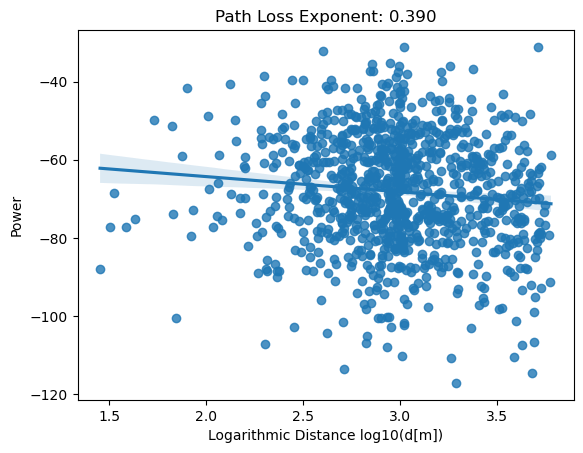

[19/80]: loss_d: 0.672, loss_g: 0.754, acc_real: 0.480, acc_fake: 0.501
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


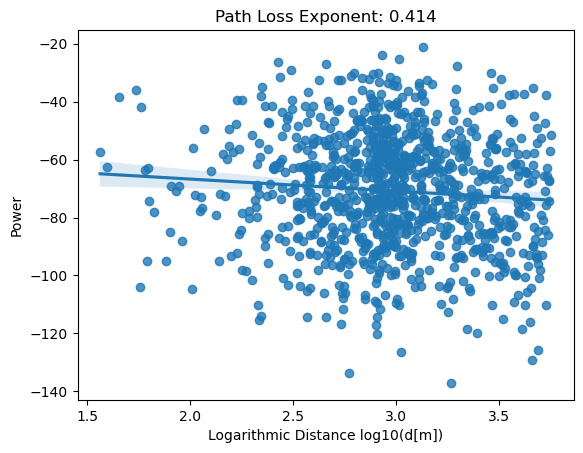

[20/80]: loss_d: 0.668, loss_g: 0.746, acc_real: 0.485, acc_fake: 0.510
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


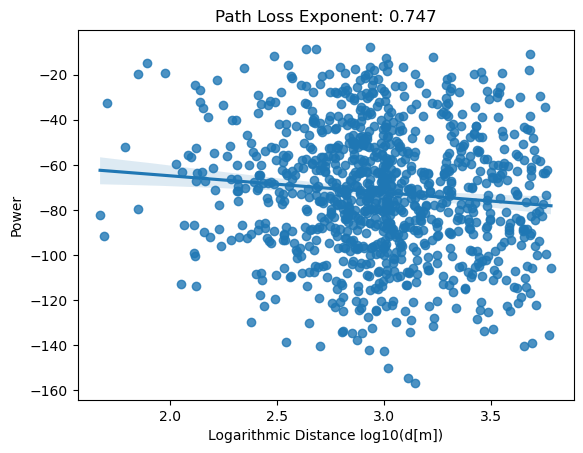

[21/80]: loss_d: 0.666, loss_g: 0.741, acc_real: 0.493, acc_fake: 0.517
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


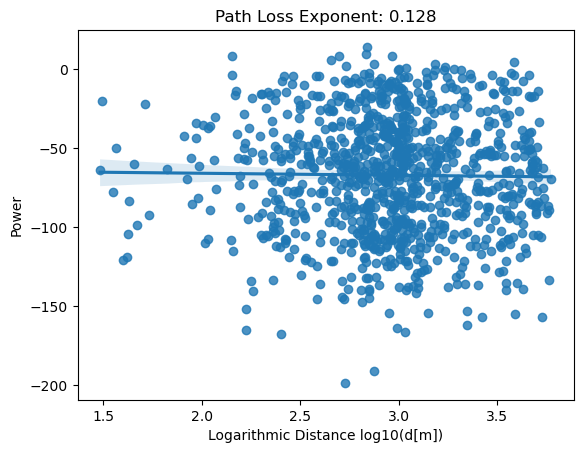

[22/80]: loss_d: 0.664, loss_g: 0.731, acc_real: 0.503, acc_fake: 0.522
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


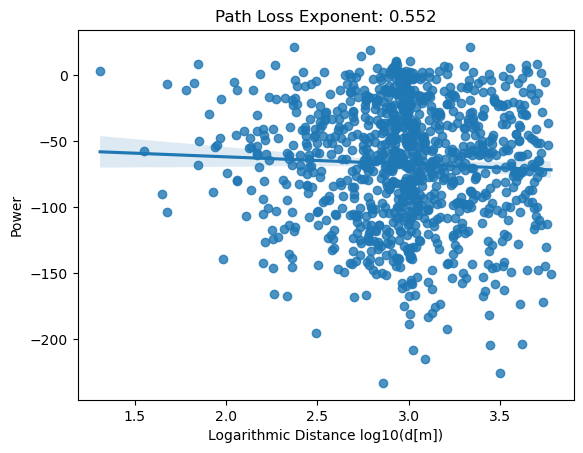

[23/80]: loss_d: 0.662, loss_g: 0.722, acc_real: 0.514, acc_fake: 0.525
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


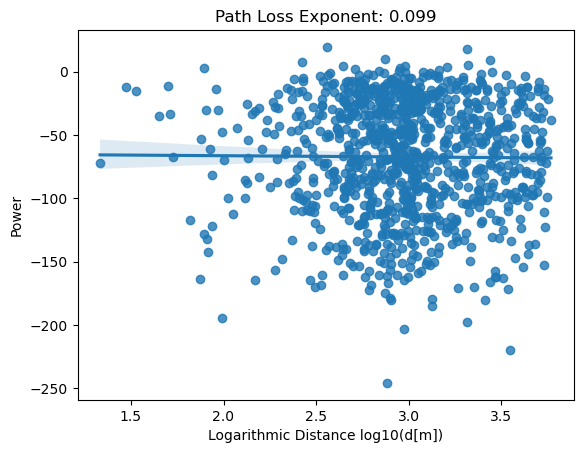

[24/80]: loss_d: 0.654, loss_g: 0.725, acc_real: 0.527, acc_fake: 0.529
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


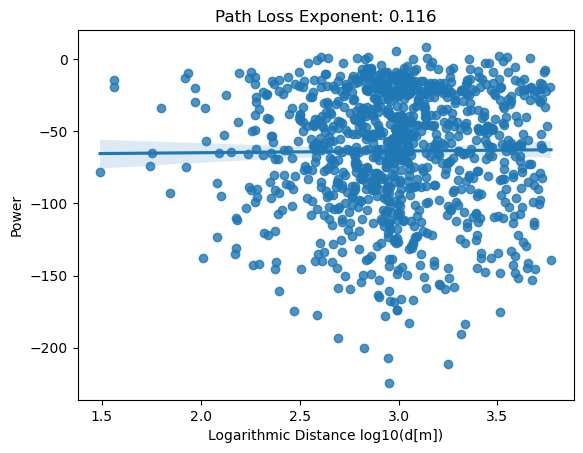

[25/80]: loss_d: 0.646, loss_g: 0.735, acc_real: 0.538, acc_fake: 0.534
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


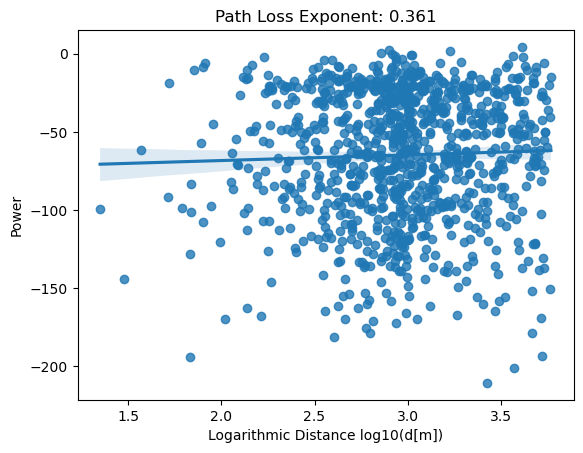

[26/80]: loss_d: 0.638, loss_g: 0.749, acc_real: 0.549, acc_fake: 0.539
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


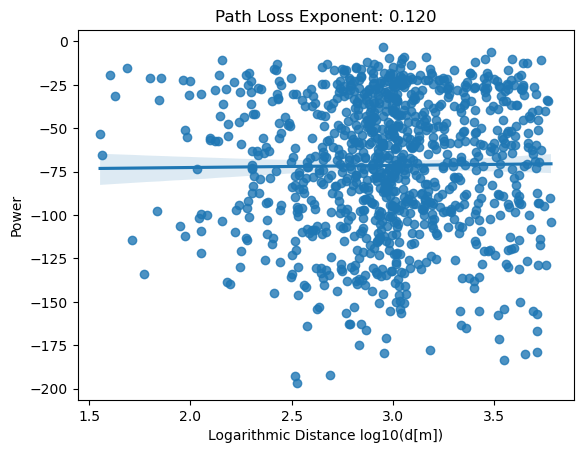

[27/80]: loss_d: 0.627, loss_g: 0.766, acc_real: 0.560, acc_fake: 0.546
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


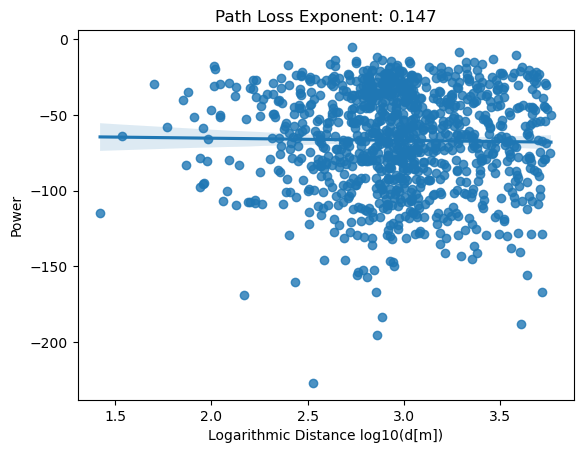

[28/80]: loss_d: 0.614, loss_g: 0.789, acc_real: 0.570, acc_fake: 0.552
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


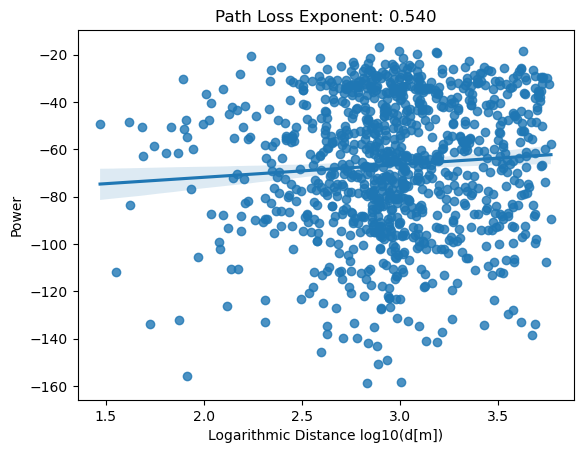

[29/80]: loss_d: 0.600, loss_g: 0.811, acc_real: 0.580, acc_fake: 0.558
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


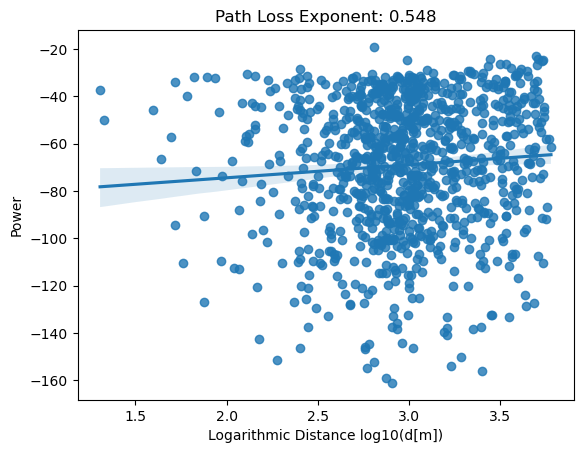

[30/80]: loss_d: 0.588, loss_g: 0.834, acc_real: 0.589, acc_fake: 0.564
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


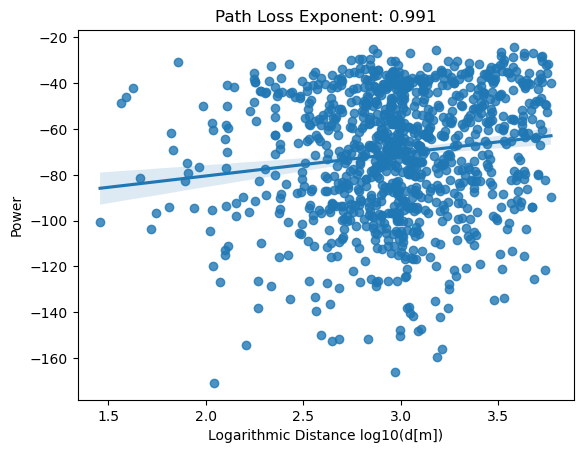

[31/80]: loss_d: 0.572, loss_g: 0.863, acc_real: 0.599, acc_fake: 0.569
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


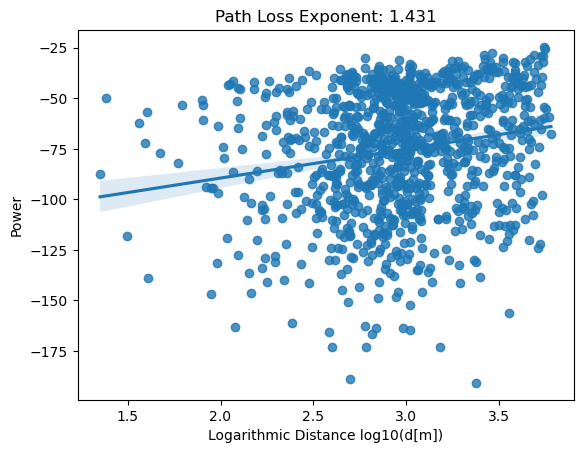

[32/80]: loss_d: 0.559, loss_g: 0.895, acc_real: 0.608, acc_fake: 0.575
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


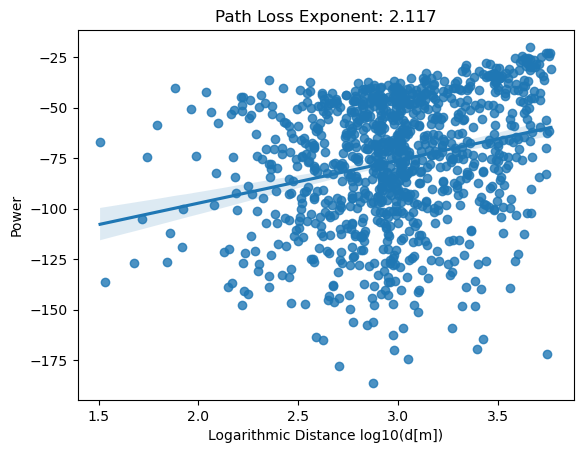

[33/80]: loss_d: 0.544, loss_g: 0.929, acc_real: 0.616, acc_fake: 0.580
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


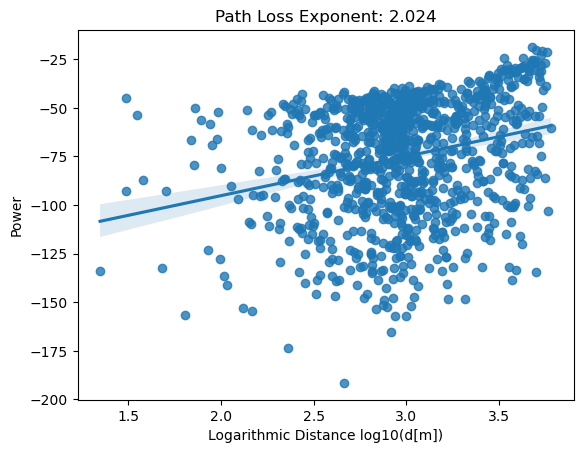

[34/80]: loss_d: 0.530, loss_g: 0.968, acc_real: 0.624, acc_fake: 0.585
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


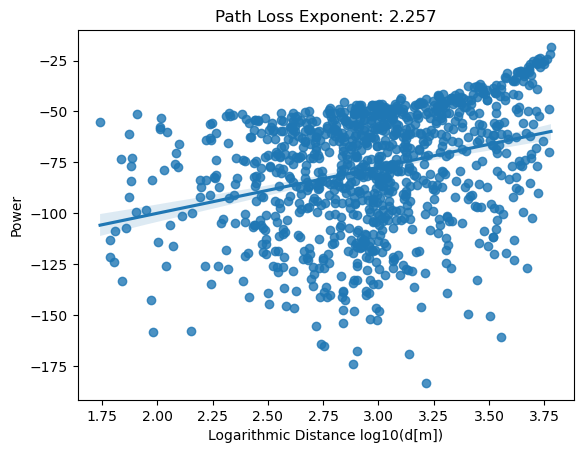

[35/80]: loss_d: 0.514, loss_g: 1.015, acc_real: 0.632, acc_fake: 0.591
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


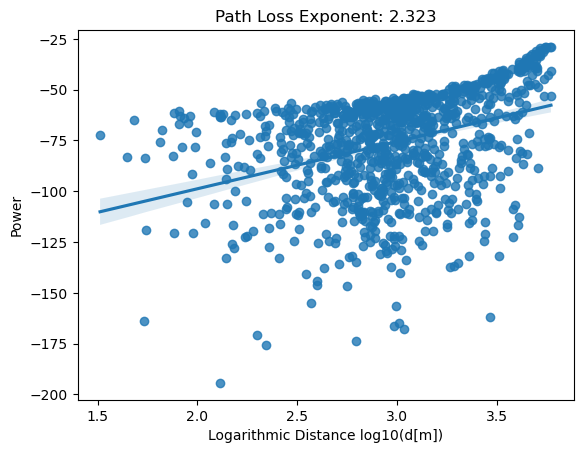

[36/80]: loss_d: 0.498, loss_g: 1.058, acc_real: 0.639, acc_fake: 0.596
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


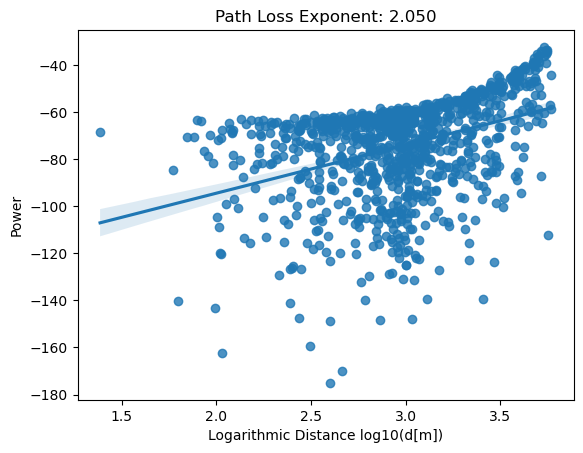

[37/80]: loss_d: 0.482, loss_g: 1.113, acc_real: 0.647, acc_fake: 0.601
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


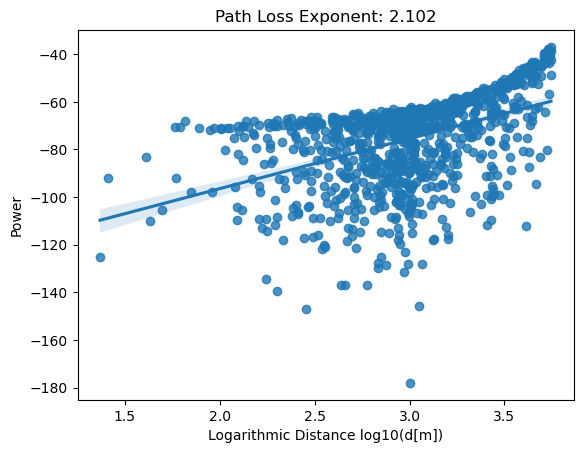

[38/80]: loss_d: 0.468, loss_g: 1.162, acc_real: 0.653, acc_fake: 0.605
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


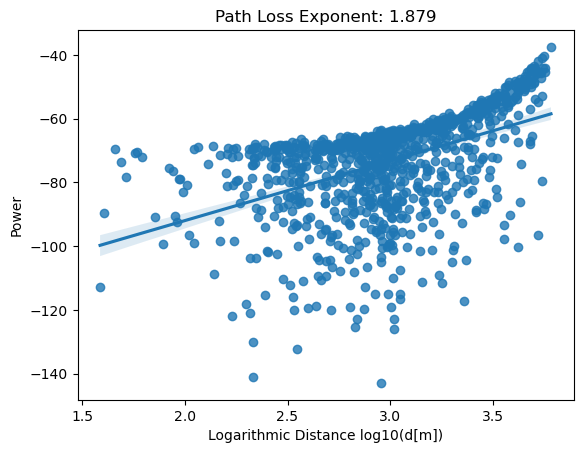

[39/80]: loss_d: 0.454, loss_g: 1.211, acc_real: 0.660, acc_fake: 0.610
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


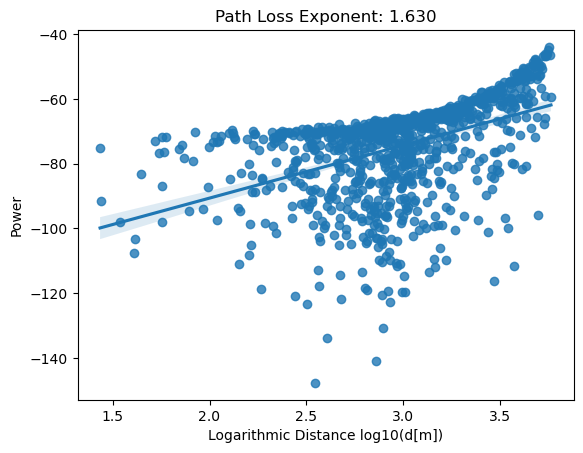

[40/80]: loss_d: 0.441, loss_g: 1.268, acc_real: 0.666, acc_fake: 0.615
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


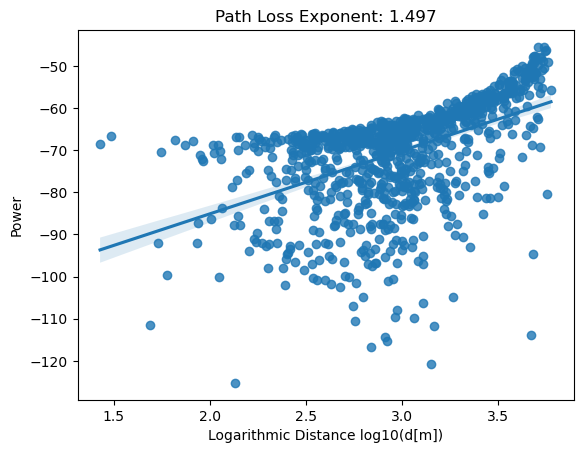

[41/80]: loss_d: 0.428, loss_g: 1.330, acc_real: 0.672, acc_fake: 0.619
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


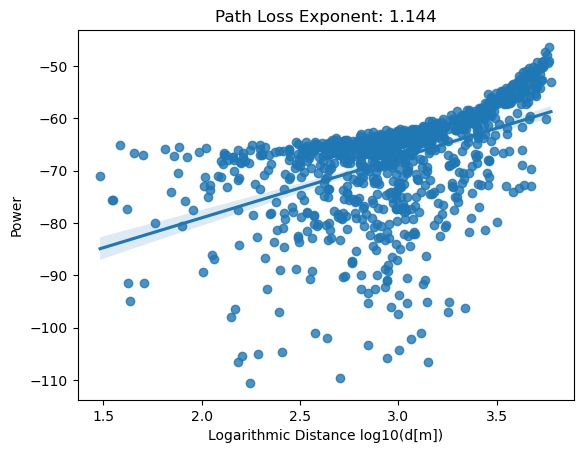

[42/80]: loss_d: 0.415, loss_g: 1.385, acc_real: 0.678, acc_fake: 0.623
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


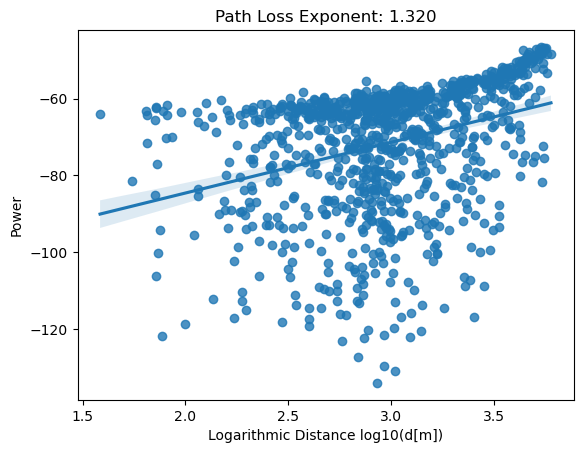

[43/80]: loss_d: 0.385, loss_g: 1.497, acc_real: 0.685, acc_fake: 0.628
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


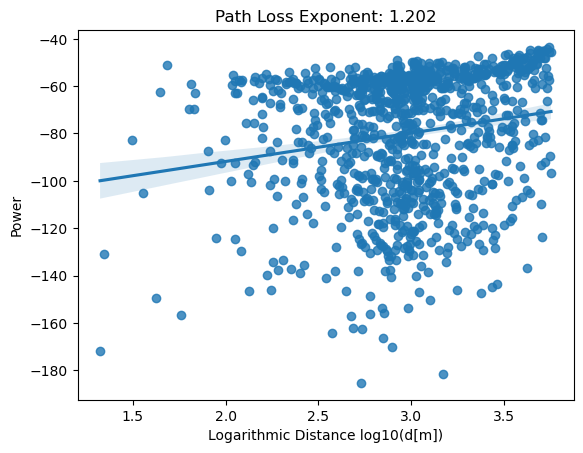

[44/80]: loss_d: 0.367, loss_g: 1.607, acc_real: 0.691, acc_fake: 0.632
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


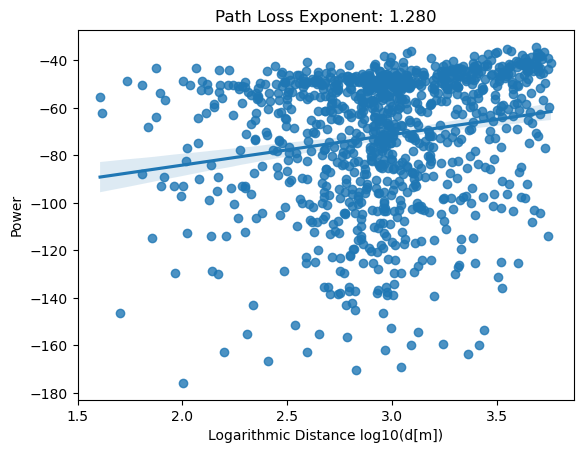

[45/80]: loss_d: 0.357, loss_g: 1.724, acc_real: 0.697, acc_fake: 0.637
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


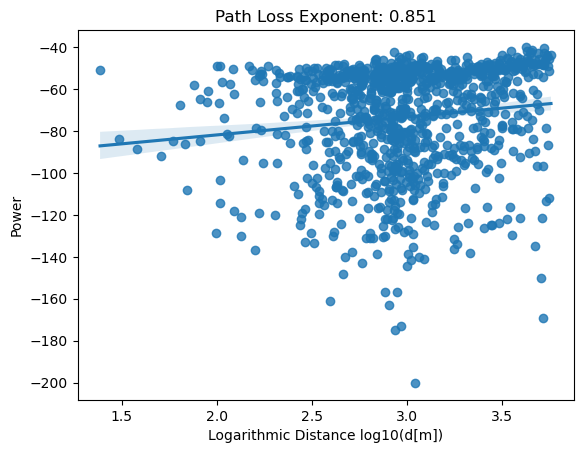

[46/80]: loss_d: 0.343, loss_g: 1.824, acc_real: 0.702, acc_fake: 0.641
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


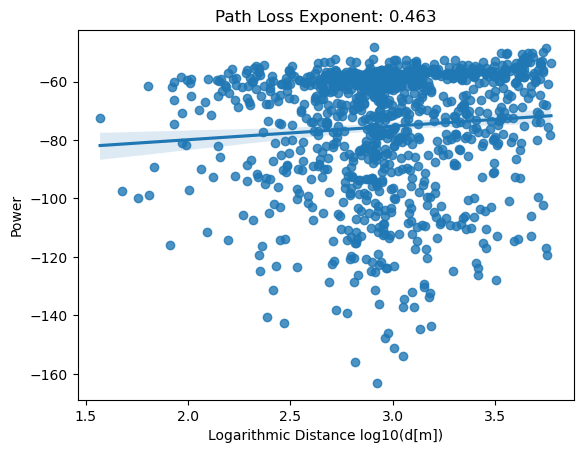

[47/80]: loss_d: 0.330, loss_g: 1.934, acc_real: 0.708, acc_fake: 0.645
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


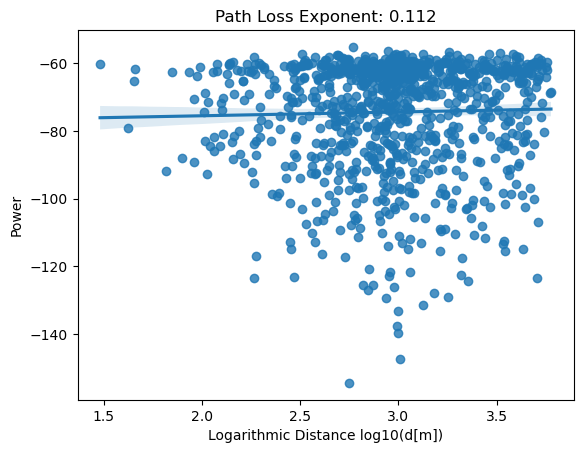

[48/80]: loss_d: 0.320, loss_g: 2.038, acc_real: 0.713, acc_fake: 0.649
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


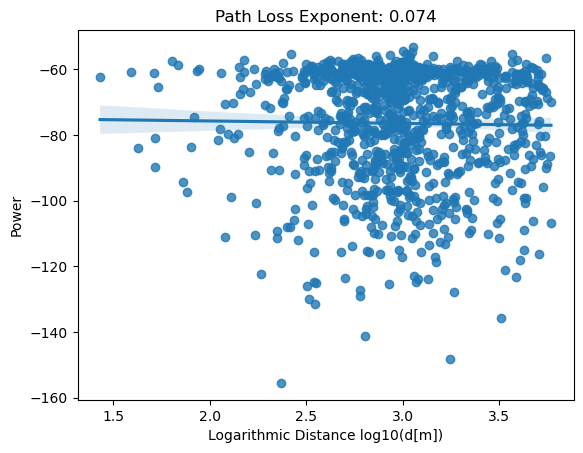

[49/80]: loss_d: 0.307, loss_g: 2.143, acc_real: 0.718, acc_fake: 0.654
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


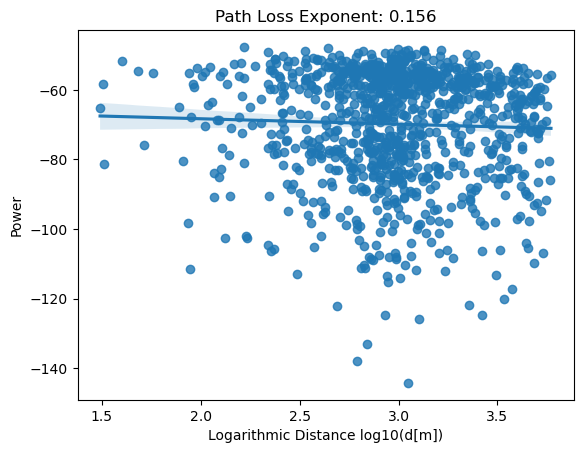

[50/80]: loss_d: 0.299, loss_g: 2.257, acc_real: 0.723, acc_fake: 0.658
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


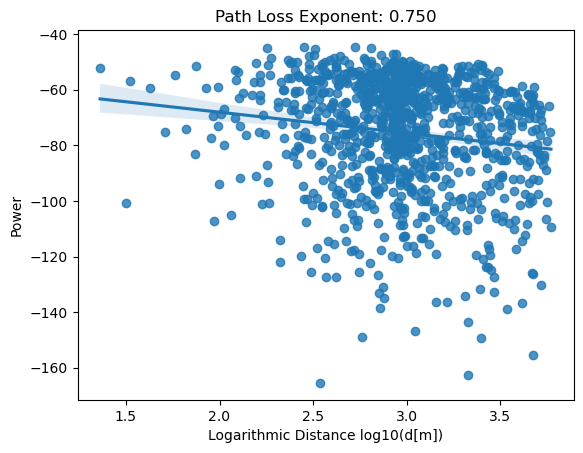

[51/80]: loss_d: 0.292, loss_g: 2.355, acc_real: 0.727, acc_fake: 0.662
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


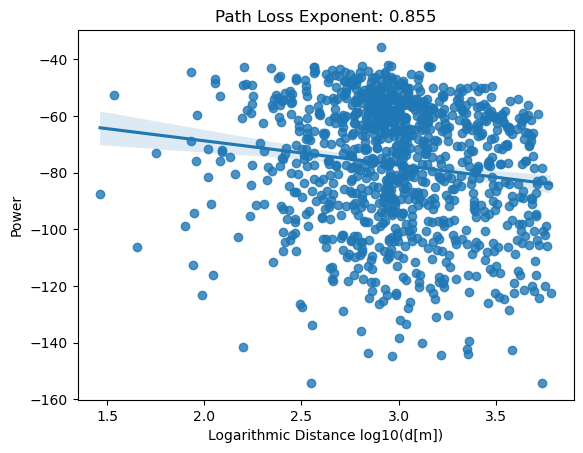

[52/80]: loss_d: 0.284, loss_g: 2.477, acc_real: 0.732, acc_fake: 0.665
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


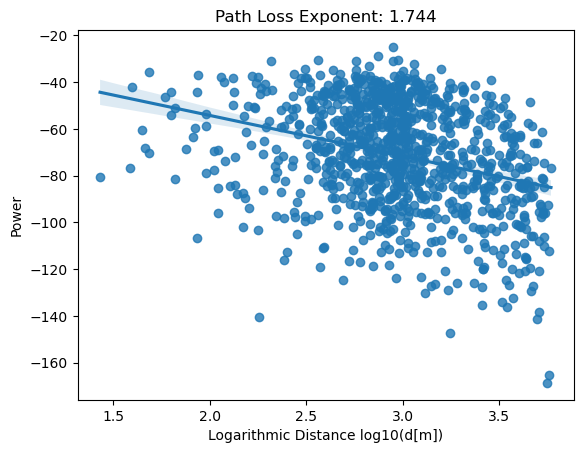

[53/80]: loss_d: 0.279, loss_g: 2.571, acc_real: 0.736, acc_fake: 0.669
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


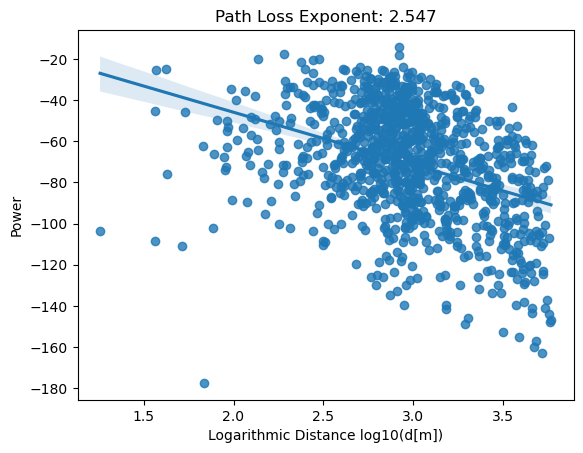

[54/80]: loss_d: 0.272, loss_g: 2.698, acc_real: 0.741, acc_fake: 0.673
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


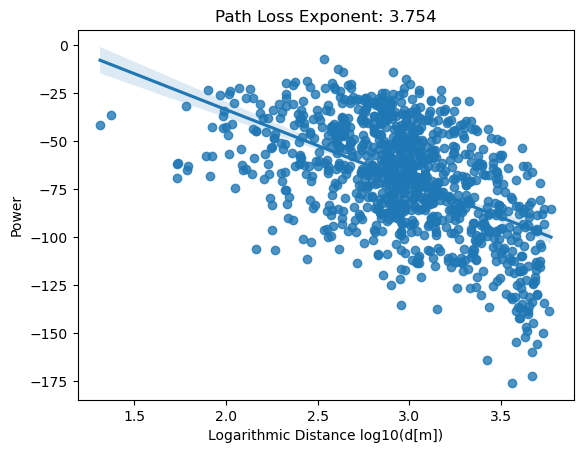

[55/80]: loss_d: 0.266, loss_g: 2.822, acc_real: 0.745, acc_fake: 0.676
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


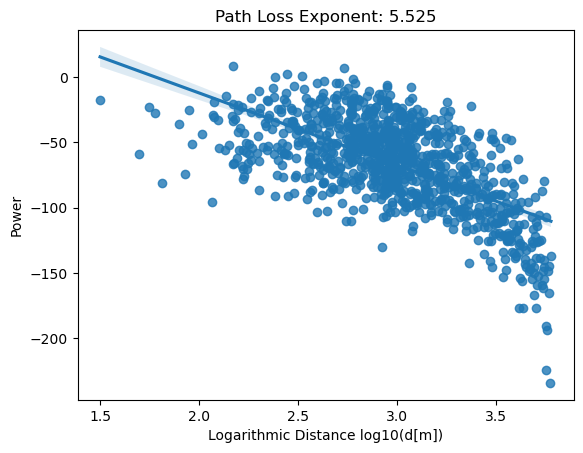

[56/80]: loss_d: 0.264, loss_g: 2.936, acc_real: 0.749, acc_fake: 0.680
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


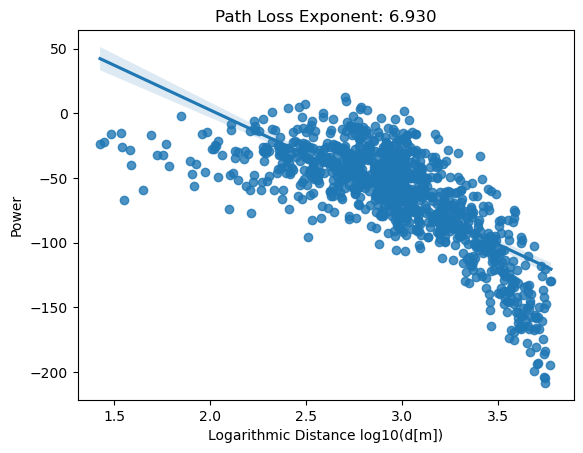

[57/80]: loss_d: 0.259, loss_g: 3.085, acc_real: 0.752, acc_fake: 0.683
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


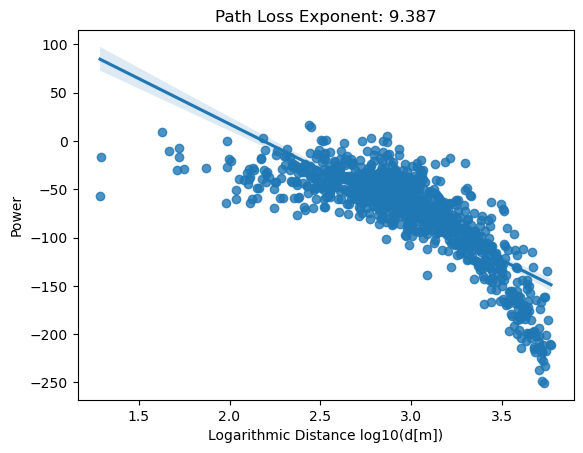

[58/80]: loss_d: 0.251, loss_g: 3.229, acc_real: 0.756, acc_fake: 0.686
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


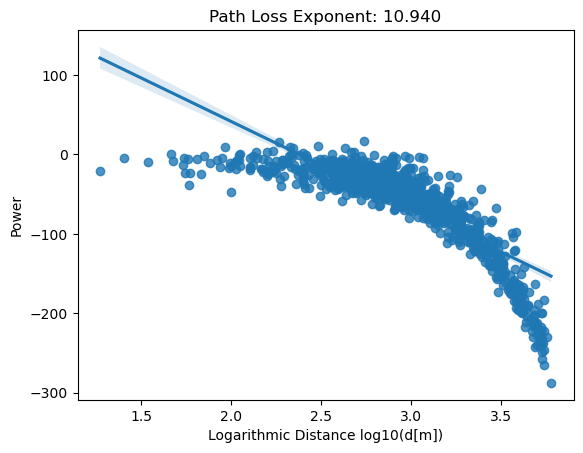

[59/80]: loss_d: 0.252, loss_g: 3.374, acc_real: 0.760, acc_fake: 0.689
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


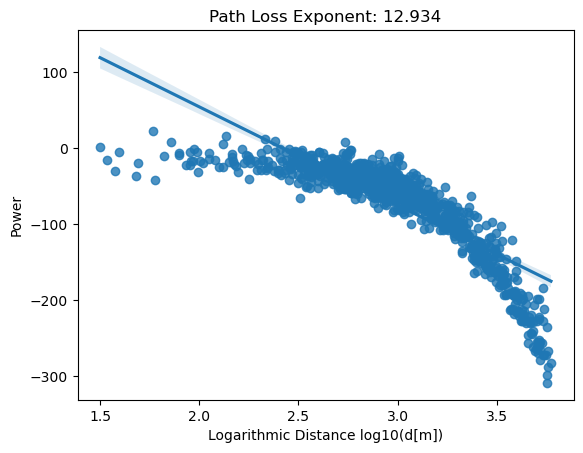

[60/80]: loss_d: 0.240, loss_g: 3.579, acc_real: 0.763, acc_fake: 0.693
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


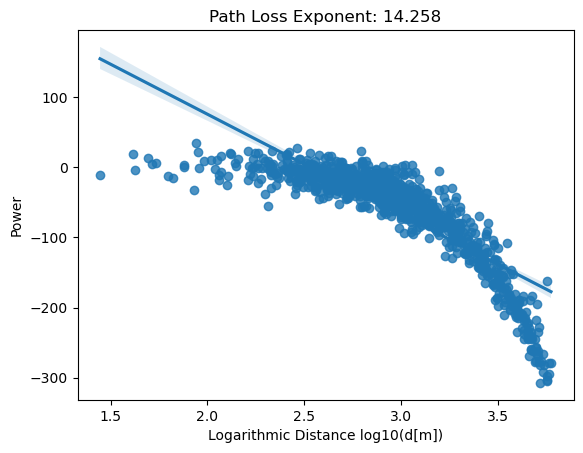

[61/80]: loss_d: 0.238, loss_g: 3.695, acc_real: 0.766, acc_fake: 0.696
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


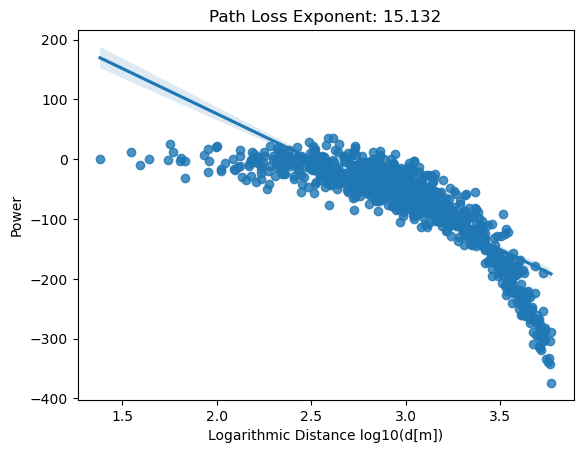

[62/80]: loss_d: 0.228, loss_g: 3.848, acc_real: 0.770, acc_fake: 0.699
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


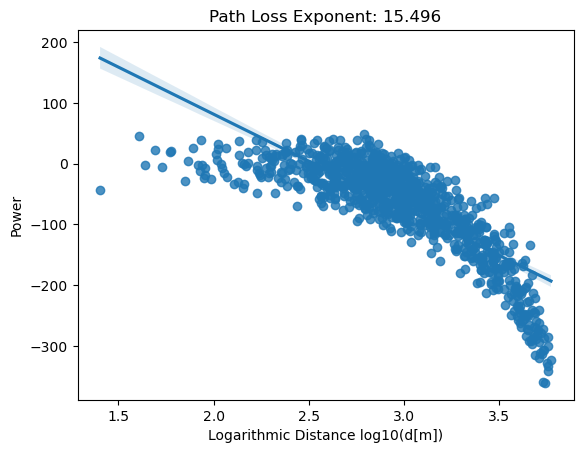

[63/80]: loss_d: 0.226, loss_g: 4.030, acc_real: 0.773, acc_fake: 0.701
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


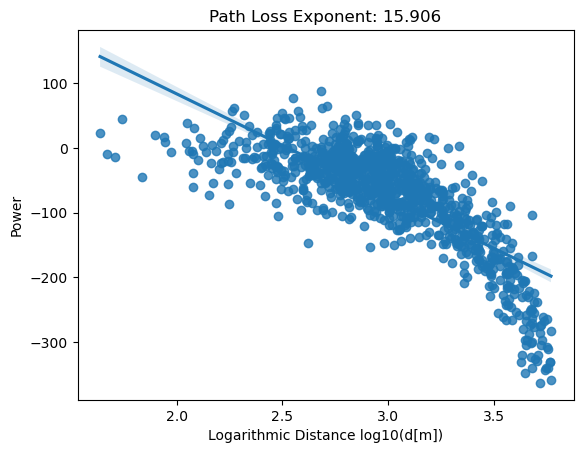

[64/80]: loss_d: 0.223, loss_g: 4.121, acc_real: 0.776, acc_fake: 0.704
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


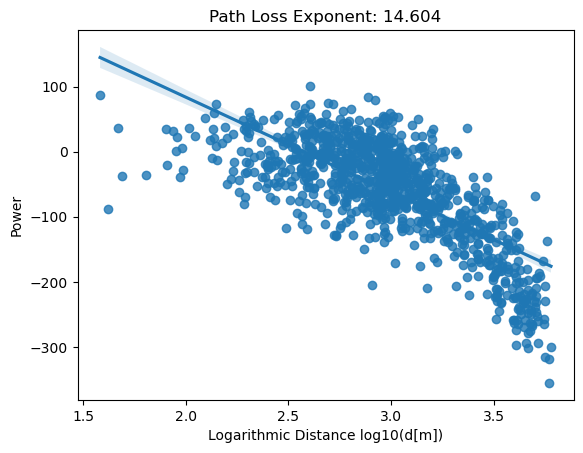

[65/80]: loss_d: 0.214, loss_g: 4.309, acc_real: 0.779, acc_fake: 0.707
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


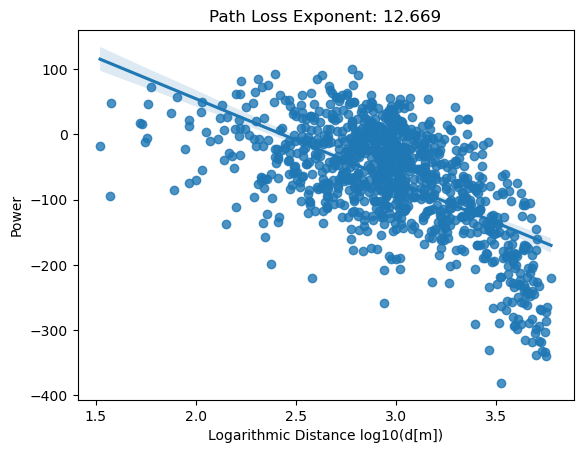

[66/80]: loss_d: 0.203, loss_g: 4.476, acc_real: 0.782, acc_fake: 0.710
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


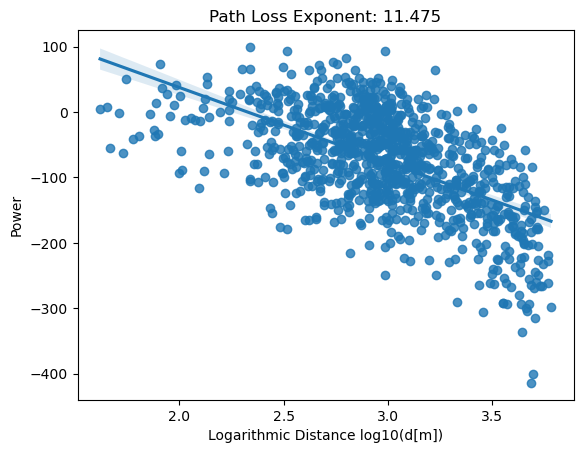

[67/80]: loss_d: 0.197, loss_g: 4.666, acc_real: 0.785, acc_fake: 0.713
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


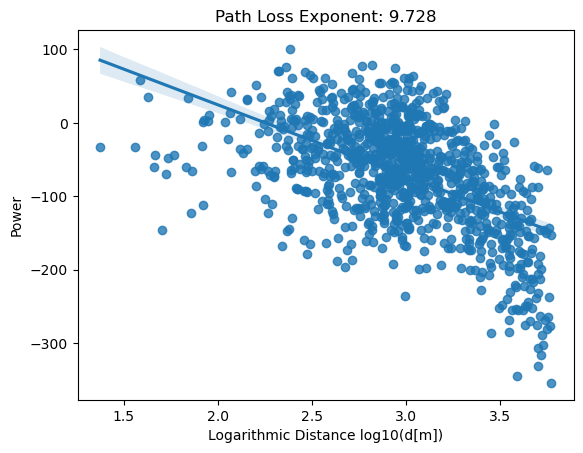

[68/80]: loss_d: 0.192, loss_g: 4.809, acc_real: 0.788, acc_fake: 0.715
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


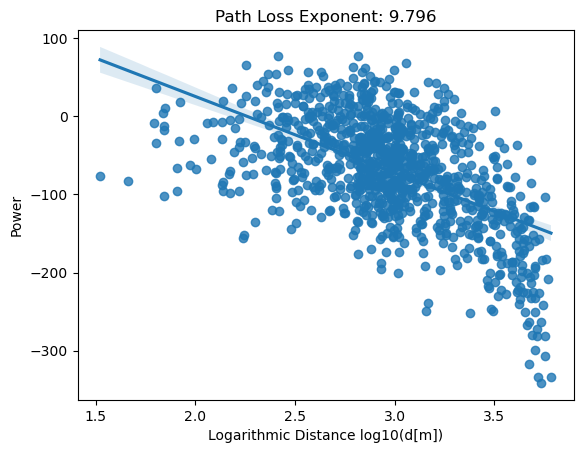

[69/80]: loss_d: 0.190, loss_g: 4.982, acc_real: 0.791, acc_fake: 0.718
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


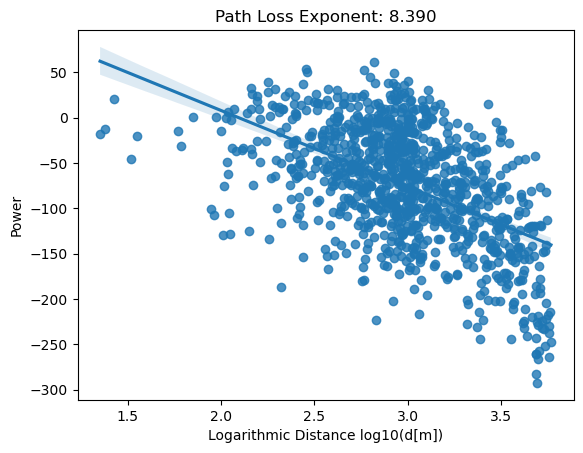

[70/80]: loss_d: 0.185, loss_g: 5.161, acc_real: 0.794, acc_fake: 0.720
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


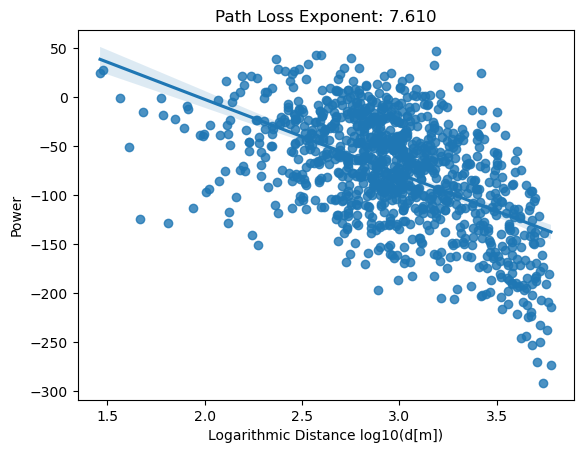

[71/80]: loss_d: 0.185, loss_g: 5.282, acc_real: 0.797, acc_fake: 0.723
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


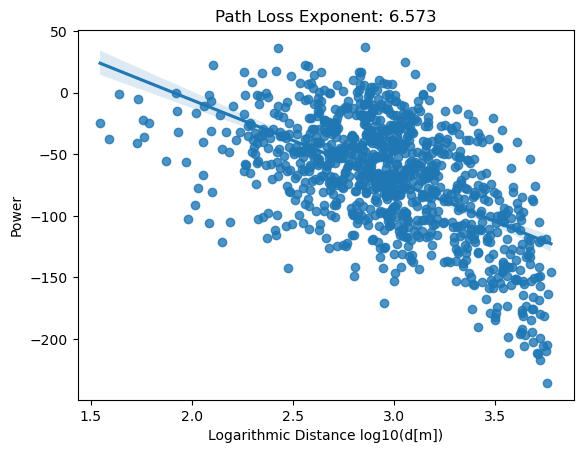

[72/80]: loss_d: 0.184, loss_g: 5.471, acc_real: 0.800, acc_fake: 0.725
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


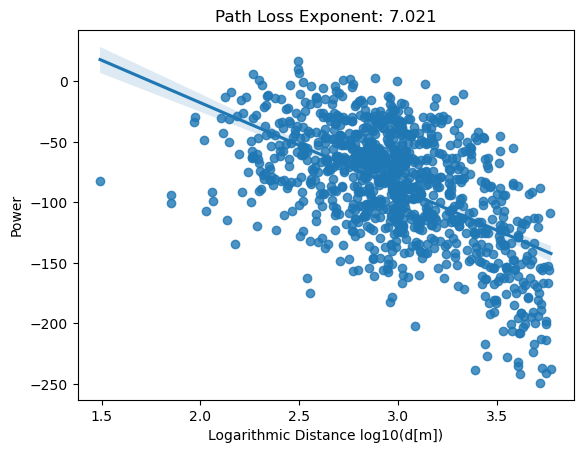

[73/80]: loss_d: 0.179, loss_g: 5.676, acc_real: 0.802, acc_fake: 0.728
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


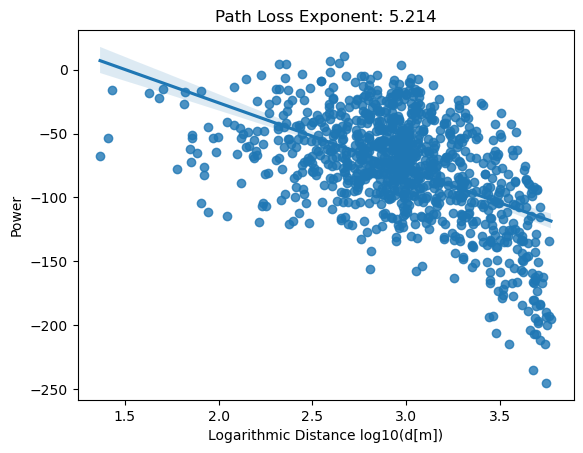

[74/80]: loss_d: 0.176, loss_g: 5.811, acc_real: 0.805, acc_fake: 0.730
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


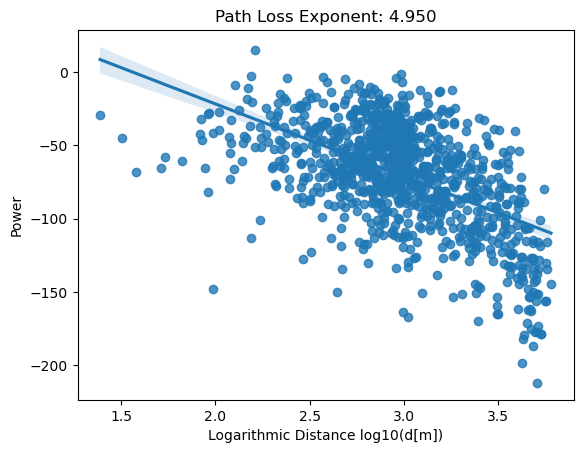

[75/80]: loss_d: 0.181, loss_g: 6.011, acc_real: 0.807, acc_fake: 0.732
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


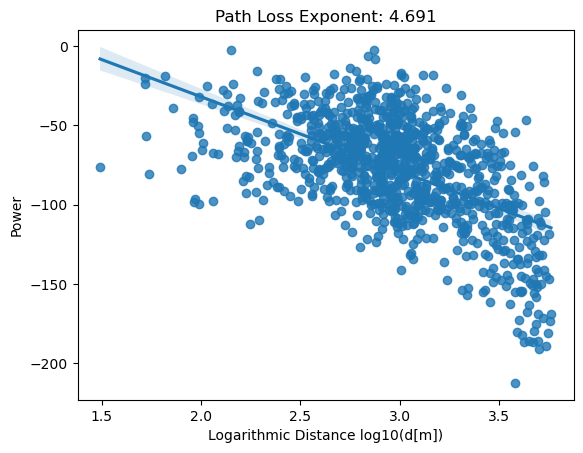

[76/80]: loss_d: 0.176, loss_g: 6.121, acc_real: 0.810, acc_fake: 0.735
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


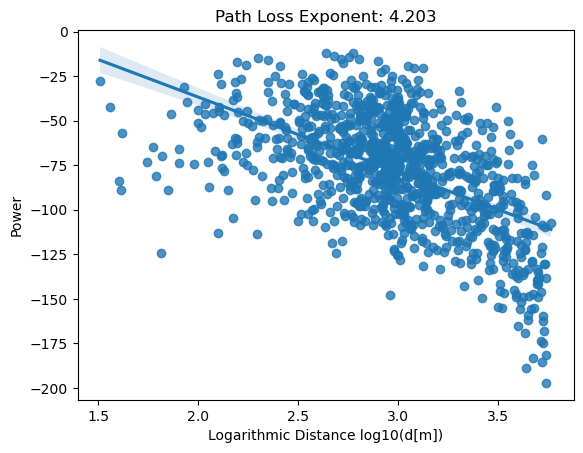

[77/80]: loss_d: 0.174, loss_g: 6.372, acc_real: 0.812, acc_fake: 0.737
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


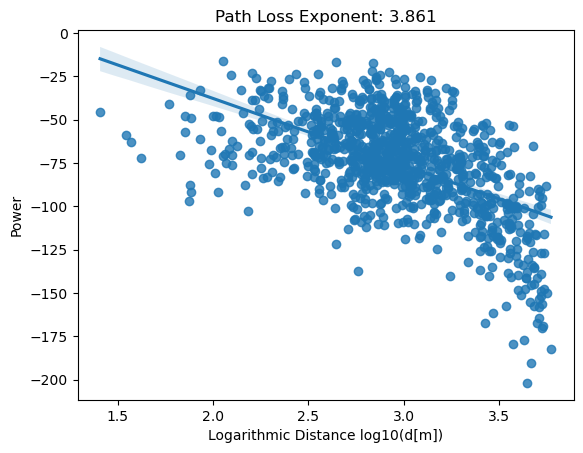

[78/80]: loss_d: 0.177, loss_g: 6.443, acc_real: 0.815, acc_fake: 0.739
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


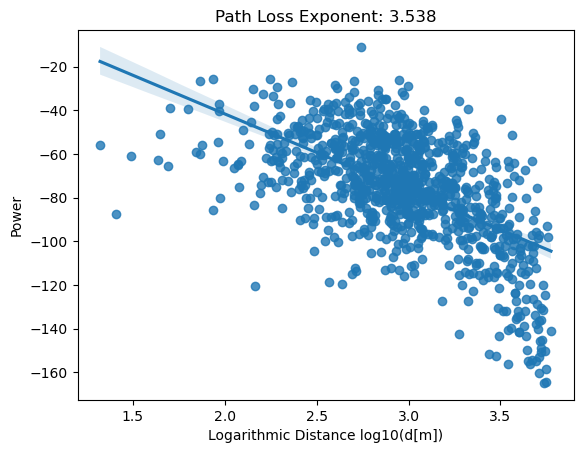

[79/80]: loss_d: 0.172, loss_g: 6.626, acc_real: 0.817, acc_fake: 0.741


In [33]:
import seaborn as sns
def accuracy(output, target, threshold=0.5):
    with torch.no_grad():
        prediction = (output >= threshold).float()
        correct = (prediction == target).float().sum()
        accuracy = correct / len(target)
        return accuracy.item()


class GeneratorModel(nn.Module):
    def __init__(self):
        super(GeneratorModel, self).__init__()
        embed_dim = 8
        input_dim = 10 + 2 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 32),
            nn.ReLU()
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(32, 16)
        )
        self.hidden_layer3 = nn.Sequential(
            nn.Linear(16, output_dim)
        )

        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        info_out = self.sigm(self.ae(info[:, 4:]))
        x = torch.cat([x, torch.abs(info[:,2]-info[:, 0]).unsqueeze(1), torch.abs(info[:, 3]-info[:, 1]).unsqueeze(1), info_out], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)
        output = self.hidden_layer3(output)

        return output.to(device)


class DiscriminatorModel(nn.Module):
    def __init__(self):
        super(DiscriminatorModel, self).__init__()
        embed_dim = 8
        input_dim = 1 + 2 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim),
            nn.Sigmoid()
        )
        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        x_out = self.sigm(self.ae(x[:, 4:]))
        x = torch.cat([torch.abs(x[:,2]-x[:, 0]).unsqueeze(1), torch.abs(x[:, 3]-x[:, 1]).unsqueeze(1), x_out, info], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


discriminator = DiscriminatorModel()
generator = GeneratorModel()
discriminator.to(device)
generator.to(device)

discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.0001)
generator_optimizer = optim.Adam(generator.parameters(), lr=0.0003)

loss = nn.BCELoss()
noise_dim = 10
n_epochs = 80
batch_size = training_parameters["batch_size"]
G_loss_mean = []
D_loss_mean = []
D_real_mean = []
D_fake_mean = []
accuracy_real = []
accuracy_real_mean = []
accuracy_fake = []
accuracy_fake_mean = []
for epoch_idx in range(n_epochs):
    G_loss = []
    D_loss = []
    D_real = []
    D_fake = []
    for batch_idx, data_input in enumerate(train_ldr):
        if data_input[1].shape[0]!=batch_size and batch_idx==len(train_ldr)-1:
            continue
        if batch_idx%100 == 0:
            print(batch_idx/len(train_ldr))
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,3005)).to(device)
        generated_data = generator(noise, fake_info)  # batch_size X 784

        # Discriminator
        true_data = data_input[0].view(batch_size, 3005).to(device)  # batch_size X 784
        cond_info = data_input[1].to(device)  # batch_size
        true_labels = torch.ones(batch_size).to(device)

        discriminator_optimizer.zero_grad()

        discriminator_output_for_true_data = discriminator(true_data, cond_info).view(batch_size)
        true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)
        acc_real = accuracy(discriminator_output_for_true_data, true_labels)
        discriminator_output_for_generated_data = discriminator(fake_info, generated_data.detach()).view(batch_size)
        generator_discriminator_loss = loss(
            discriminator_output_for_generated_data, torch.zeros(batch_size).to(device)
        )
        acc_fake = accuracy(discriminator_output_for_generated_data, torch.zeros(batch_size).to(device))
        discriminator_loss = (
                                     true_discriminator_loss + generator_discriminator_loss
                             ) / 2

        discriminator_loss.backward()
        discriminator_optimizer.step()

        D_loss.append(discriminator_loss.data.item())
        D_real.append(true_discriminator_loss)
        D_fake.append(generator_discriminator_loss)
        accuracy_real.append(acc_real)
        accuracy_fake.append(acc_fake)
        # Generator

        generator_optimizer.zero_grad()
        # It's a choice to generate the data again
        generated_data = generator(noise, fake_info)  # batch_size X 784
        discriminator_output_on_generated_data = discriminator(fake_info, generated_data).view(batch_size)
        generator_loss = loss(discriminator_output_on_generated_data, true_labels)
        generator_loss.backward()
        generator_optimizer.step()

        G_loss.append(generator_loss.data.item())


    dist_list =[]
    gan_rss_list = []
    with torch.no_grad():
        noise = torch.randn(2000, noise_dim).to(device)
        fake_info = torch.rand((2000,3005)).to(device)
        fake_info[:, [0,1,2,3]] = torch.zeros(2000, 4)
        fake_info[:, 2] = torch.rand((2000,))*0.2 + torch.logspace(-2.5, 0, 2000)
        #fake_info[:, 3] -= torch.logspace(0, 0.6, 1000)
        generated_data = generator(noise, fake_info).cpu().view(2000, 1)
        for i, x in enumerate(generated_data):
            fake_info_reconst = fake_info[i].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= (max_elev-min_elev)
            fake_info_reconst[4:] += min_elev 
            d = find_dist(fake_info_reconst, 0.5)
            if d<1000:
                dist_list.append(d)
                gan_rss_list.append(x.detach().numpy()[0])

    a, b = np.polyfit(np.log10(dist_list), gan_rss_list, 1)
    plt.figure()
    sns.regplot(x=np.log10(dist_list), y=gan_rss_list)
    plt.xlabel("Logarithmic Distance log10(d[m])")
    plt.ylabel("Power")
    plt.title("Path Loss Exponent: %.3f" %abs(a/10))
    plt.show()
    '''
    with torch.no_grad():
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,18337)).to(device)
        generated_data = generator(noise, fake_info).cpu().view(batch_size, 1)
        for x in generated_data:
            fake_info_reconst = fake_info[0].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= max_elev
            print(fake_info_reconst)
            print(x.detach().numpy())
            #plt.imshow(x.detach().numpy(), interpolation='nearest', cmap='gray')
            #plt.show()

            break
    '''
    print('[%d/%d]: loss_d: %.3f, loss_g: %.3f, acc_real: %.3f, acc_fake: %.3f' % (
        (epoch_idx), n_epochs, torch.mean(torch.FloatTensor(D_loss)), torch.mean(torch.FloatTensor(G_loss)), torch.mean(torch.FloatTensor(accuracy_real)), torch.mean(torch.FloatTensor(accuracy_fake))))
    G_loss_mean.append(torch.mean(torch.FloatTensor(G_loss)))
    D_loss_mean.append(torch.mean(torch.FloatTensor(D_loss)))
    D_real_mean.append(torch.mean(torch.FloatTensor(D_real)))
    D_fake_mean.append(torch.mean(torch.FloatTensor(D_fake)))
    accuracy_real_mean.append(torch.mean(torch.FloatTensor(accuracy_real)))
    accuracy_fake_mean.append(torch.mean(torch.FloatTensor(accuracy_fake)))


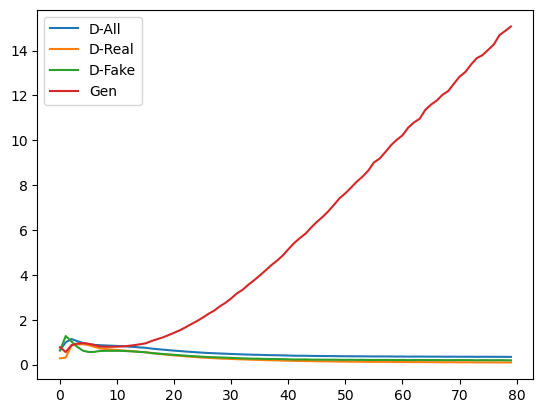

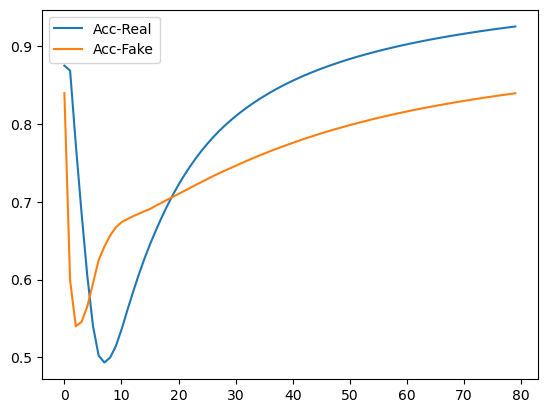

In [26]:
import matplotlib.pyplot as plt
plt.figure()
plt.plot(D_loss_mean)
plt.plot(D_real_mean)
plt.plot(D_fake_mean)
plt.plot(G_loss_mean)
plt.legend(["D-All", "D-Real", "D-Fake", "Gen"])
plt.show()

plt.figure()
plt.plot(accuracy_real_mean)
plt.plot(accuracy_fake_mean)
plt.legend(["Acc-Real", "Acc-Fake"])
plt.show()


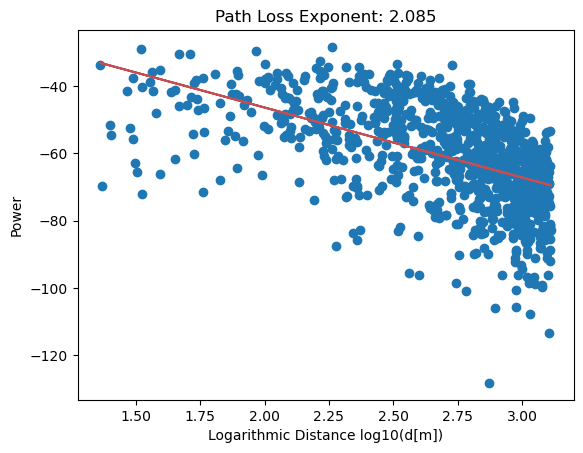

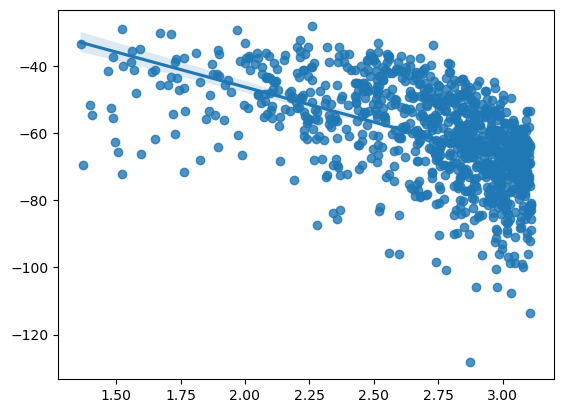

In [38]:
import seaborn as sns
#10 ** random.uniform(np.log10(min), np.log10(max))

dist_list =[]
gan_rss_list = []
with torch.no_grad():
    noise = torch.randn(10000, noise_dim).to(device)
    fake_info = torch.rand((10000,3005))
    fake_info /= 4
    fake_info.to(device)
    fake_info[:, [0,1,3]] = torch.zeros(10000, 3)
    fake_info[:, 2] += torch.logspace(-2.5, 0, 10000)
    #fake_info[:, 3] += torch.logspace(0, 0.2, 10000)
    generated_data = generator(noise, fake_info).cpu().view(10000, 1)
    for i, x in enumerate(generated_data):
        fake_info_reconst = fake_info[i].detach().numpy()
        fake_info_reconst[0] *=max_x_coord
        fake_info_reconst[1] *=max_y_coord
        fake_info_reconst[2] *=max_x_coord
        fake_info_reconst[3] *=max_y_coord
        fake_info_reconst[4:] *= (max_elev-min_elev)
        fake_info_reconst[4:] += min_elev 

        dist_list.append(find_dist(fake_info_reconst, 0.5))
        gan_rss_list.append(x.detach().numpy()[0])

idx = [i for i, val in enumerate(dist_list) if i<1000]
dist_list = np.array(dist_list)[idx]
gan_rss_list = np.array(gan_rss_list)[idx]
plt.figure()
x=np.log10(dist_list)
y=gan_rss_list
a, b = np.polyfit(x, y, 1)
#add points to plot
plt.scatter(x, y)
#add line of best fit to plot
plt.plot(x, a*x+b, 'r')

plt.title("Path Loss Exponent: %.3f" % abs(a/10))
plt.xlabel("Logarithmic Distance log10(d[m])")
plt.ylabel("Power")
plt.show()

plt.figure()
sns.regplot(x=x, y=y)
#add line of best fit to plot
plt.show()

### Try Lipschitz

In [52]:
from torch import autograd
def gradient_penalty(D, fi, xr, xf, batch_size):
    """

    :param D:
    :param xr: [b, 2]
    :param xf: [b, 2]
    :return:
    """
    # [b, 1]
    t = torch.rand(batch_size, 1).cpu()
    # [b, 1] => [b, 2]  broadcasting so t is the same for x1 and x2
    t = t.expand_as(xr)
    # interpolation
    mid = t * xr + (1 - t) * xf
    # set it to require grad info
    mid.requires_grad_()

    pred = D(fi, mid).view(batch_size)
    grads = autograd.grad(outputs=pred, inputs=mid,
                          grad_outputs=torch.ones_like(pred),
                          create_graph=True, retain_graph=True, only_inputs=True)[0]

    gp = torch.pow(grads.norm(2, dim=1) - 1, 2).mean()

    return gp

0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


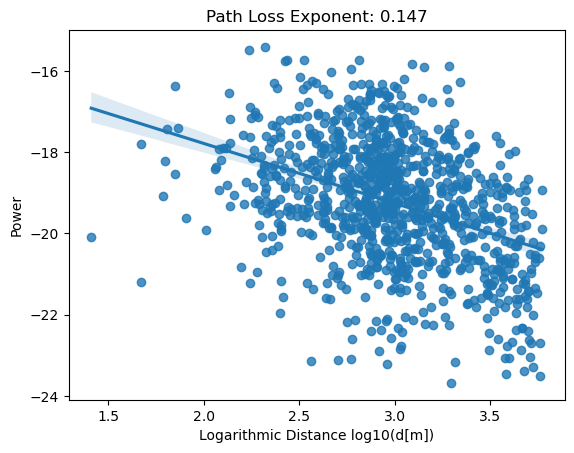

[0/80]: loss_d: 0.634, loss_g: 0.573, acc_real: 0.930, acc_fake: 0.035
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


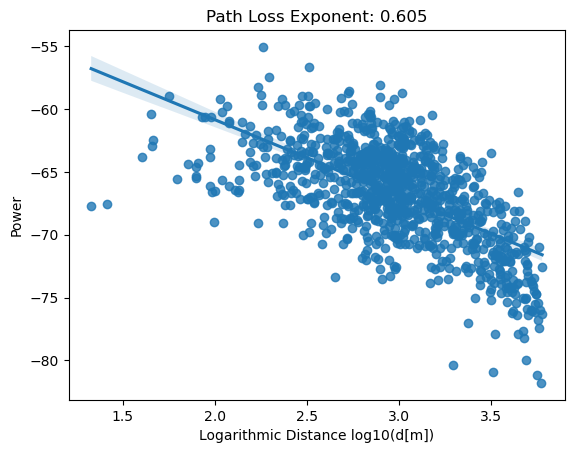

[1/80]: loss_d: 0.792, loss_g: 0.622, acc_real: 0.819, acc_fake: 0.194
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


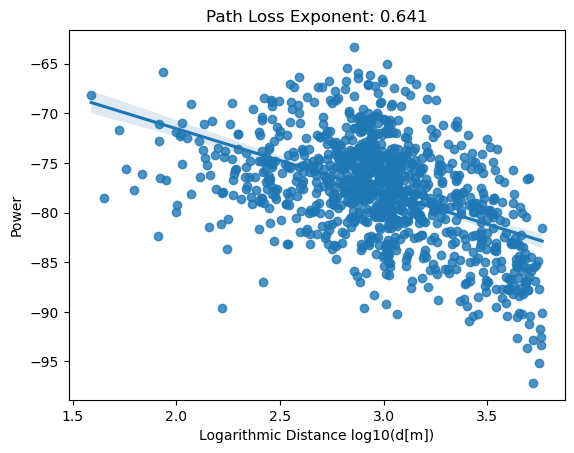

[2/80]: loss_d: 0.815, loss_g: 0.810, acc_real: 0.654, acc_fake: 0.353
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


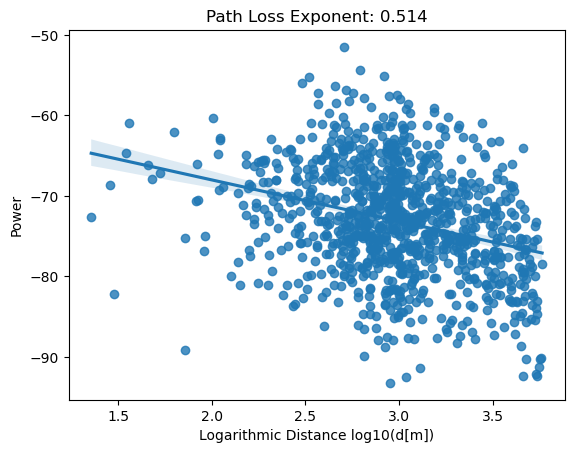

[3/80]: loss_d: 0.786, loss_g: 0.793, acc_real: 0.565, acc_fake: 0.441
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


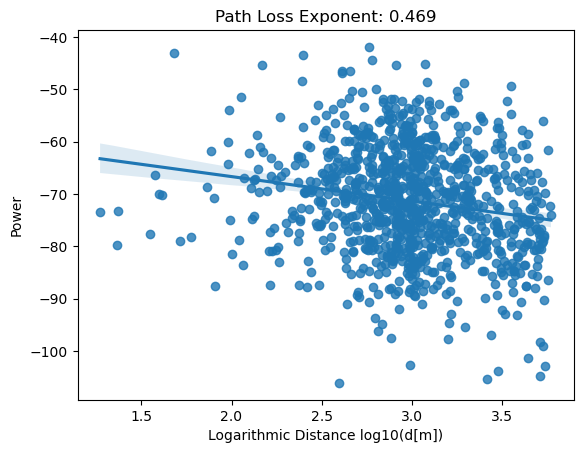

[4/80]: loss_d: 0.775, loss_g: 0.769, acc_real: 0.524, acc_fake: 0.495
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


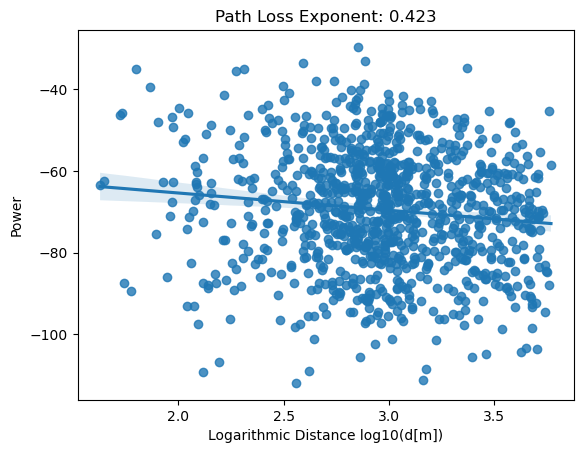

[5/80]: loss_d: 0.751, loss_g: 0.809, acc_real: 0.511, acc_fake: 0.546
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


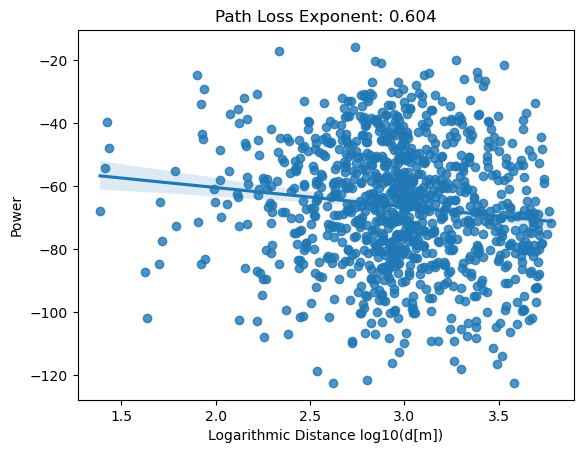

[6/80]: loss_d: 0.707, loss_g: 0.825, acc_real: 0.557, acc_fake: 0.574
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


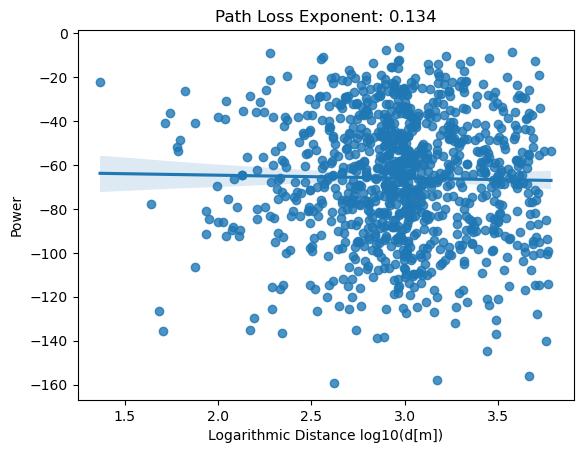

[7/80]: loss_d: 0.654, loss_g: 0.915, acc_real: 0.602, acc_fake: 0.596
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


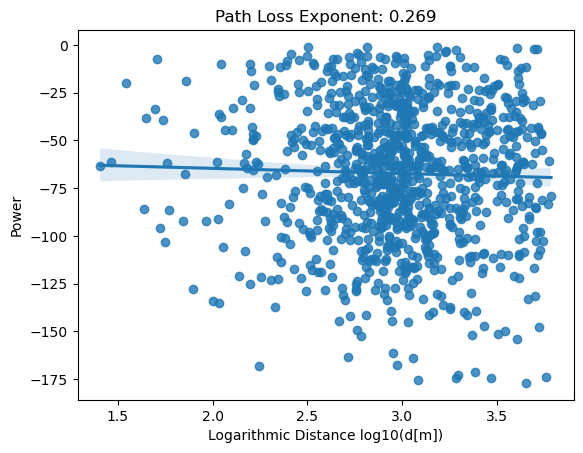

[8/80]: loss_d: 0.602, loss_g: 1.047, acc_real: 0.641, acc_fake: 0.614
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


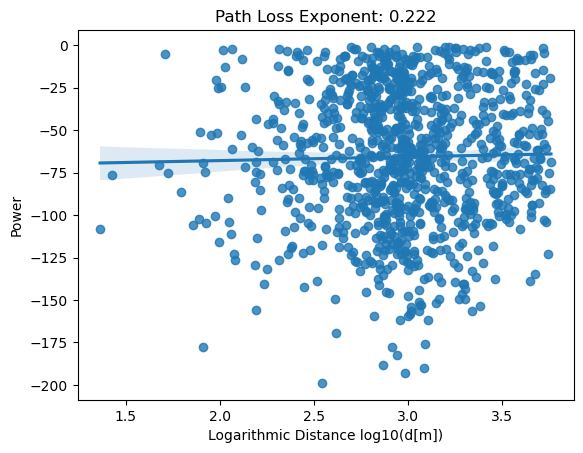

[9/80]: loss_d: 0.551, loss_g: 1.233, acc_real: 0.675, acc_fake: 0.630
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


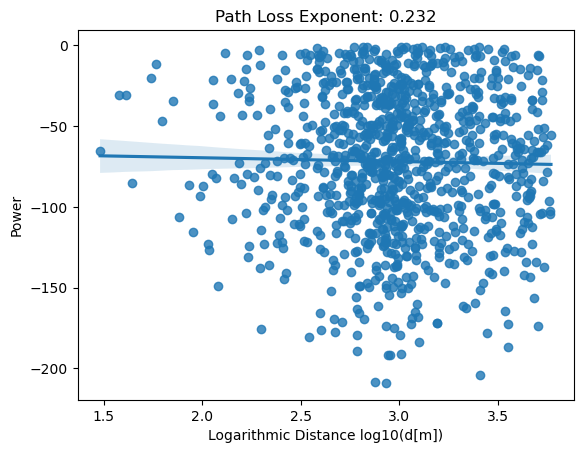

[10/80]: loss_d: 0.507, loss_g: 1.432, acc_real: 0.703, acc_fake: 0.644
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


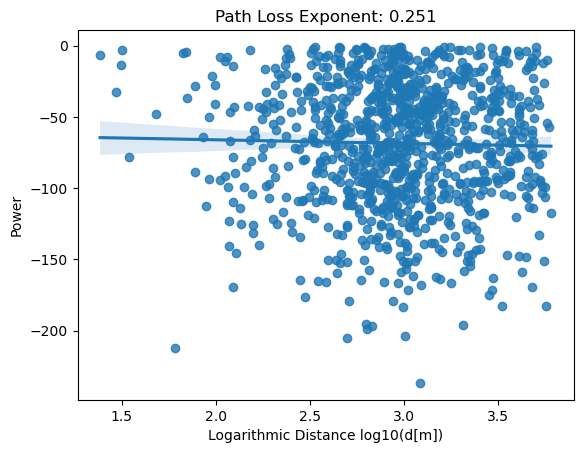

[11/80]: loss_d: 0.473, loss_g: 1.656, acc_real: 0.727, acc_fake: 0.657
0.0
0.2994011976047904
0.5988023952095808


In [ ]:
import seaborn as sns
def accuracy(output, target, threshold=0.5):
    with torch.no_grad():
        prediction = (output >= threshold).float()
        correct = (prediction == target).float().sum()
        accuracy = correct / len(target)
        return accuracy.item()


class GeneratorModel(nn.Module):
    def __init__(self):
        super(GeneratorModel, self).__init__()
        embed_dim = 8
        input_dim = 10 + 2 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 32),
            nn.ReLU()
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(32, 16)
        )
        self.hidden_layer3 = nn.Sequential(
            nn.Linear(16, output_dim)
        )

        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        info_out = self.sigm(self.ae(info[:, 4:]))
        x = torch.cat([x, torch.abs(info[:,2]-info[:, 0]).unsqueeze(1), torch.abs(info[:, 3]-info[:, 1]).unsqueeze(1), info_out], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)
        output = self.hidden_layer3(output)

        return output.to(device)


class DiscriminatorModel(nn.Module):
    def __init__(self):
        super(DiscriminatorModel, self).__init__()
        embed_dim = 8
        input_dim = 1 + 2 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim),
            nn.Sigmoid()
        )
        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        x_out = self.sigm(self.ae(x[:, 4:]))
        x = torch.cat([torch.abs(x[:,2]-x[:, 0]).unsqueeze(1), torch.abs(x[:, 3]-x[:, 1]).unsqueeze(1), x_out, info], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


discriminator = DiscriminatorModel()
generator = GeneratorModel()
discriminator.to(device)
generator.to(device)

discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.0003)
generator_optimizer = optim.Adam(generator.parameters(), lr=0.0003)

loss = nn.BCELoss()
noise_dim = 10
n_epochs = 80
batch_size = training_parameters["batch_size"]
G_loss_mean = []
D_loss_mean = []
D_real_mean = []
D_fake_mean = []
accuracy_real = []
accuracy_real_mean = []
accuracy_fake = []
accuracy_fake_mean = []
for epoch_idx in range(n_epochs):
    G_loss = []
    D_loss = []
    D_real = []
    D_fake = []
    for batch_idx, data_input in enumerate(train_ldr):
        if data_input[1].shape[0]!=batch_size and batch_idx==len(train_ldr)-1:
            continue
        if batch_idx%100 == 0:
            print(batch_idx/len(train_ldr))
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,3005)).to(device)
        generated_data = generator(noise, fake_info)  # batch_size X 784

        # Discriminator
        true_data = data_input[0].view(batch_size, 3005).to(device)  # batch_size X 784
        cond_info = data_input[1].to(device)  # batch_size
        true_labels = torch.ones(batch_size).to(device)

        discriminator_optimizer.zero_grad()

        discriminator_output_for_true_data = discriminator(true_data, cond_info).view(batch_size)
        true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)
        acc_real = accuracy(discriminator_output_for_true_data, true_labels)
        discriminator_output_for_generated_data = discriminator(fake_info, generated_data.detach()).view(batch_size)
        generator_discriminator_loss = loss(
            discriminator_output_for_generated_data, torch.zeros(batch_size).to(device)
        )
        acc_fake = accuracy(discriminator_output_for_generated_data, torch.zeros(batch_size).to(device))
        gp = gradient_penalty(discriminator, fake_info, cond_info, generated_data.detach(), batch_size)

        discriminator_loss = (
                                     true_discriminator_loss + generator_discriminator_loss + 0.2 * gp
                             ) / 2

        discriminator_loss.backward()
        discriminator_optimizer.step()

        D_loss.append(discriminator_loss.data.item())
        D_real.append(true_discriminator_loss)
        D_fake.append(generator_discriminator_loss)
        accuracy_real.append(acc_real)
        accuracy_fake.append(acc_fake)
        # Generator

        generator_optimizer.zero_grad()
        # It's a choice to generate the data again
        generated_data = generator(noise, fake_info)  # batch_size X 784
        discriminator_output_on_generated_data = discriminator(fake_info, generated_data).view(batch_size)
        generator_loss = loss(discriminator_output_on_generated_data, true_labels)
        generator_loss.backward()
        generator_optimizer.step()

        G_loss.append(generator_loss.data.item())


    dist_list =[]
    gan_rss_list = []
    with torch.no_grad():
        noise = torch.randn(1000, noise_dim).to(device)
        fake_info = torch.rand((1000,3005)).to(device)
        fake_info[:, [0,1,2,3]] = torch.zeros(1000, 4)
        fake_info[:, 2] = torch.rand((1000,))*0.2 + torch.logspace(-2.5, 0, 1000)
        #fake_info[:, 3] -= torch.logspace(0, 0.6, 1000)
        generated_data = generator(noise, fake_info).cpu().view(1000, 1)
        for i, x in enumerate(generated_data):
            fake_info_reconst = fake_info[i].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= (max_elev-min_elev)
            fake_info_reconst[4:] += min_elev 

            dist_list.append(find_dist(fake_info_reconst, 0.5))
            gan_rss_list.append(x.detach().numpy()[0])

    a, b = np.polyfit(np.log10(dist_list), gan_rss_list, 1)
    plt.figure()
    sns.regplot(x=np.log10(dist_list), y=gan_rss_list)
    plt.xlabel("Logarithmic Distance log10(d[m])")
    plt.ylabel("Power")
    plt.title("Path Loss Exponent: %.3f" %abs(a/10))
    plt.show()
    '''
    with torch.no_grad():
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,18337)).to(device)
        generated_data = generator(noise, fake_info).cpu().view(batch_size, 1)
        for x in generated_data:
            fake_info_reconst = fake_info[0].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= max_elev
            print(fake_info_reconst)
            print(x.detach().numpy())
            #plt.imshow(x.detach().numpy(), interpolation='nearest', cmap='gray')
            #plt.show()

            break
    '''
    print('[%d/%d]: loss_d: %.3f, loss_g: %.3f, acc_real: %.3f, acc_fake: %.3f' % (
        (epoch_idx), n_epochs, torch.mean(torch.FloatTensor(D_loss)), torch.mean(torch.FloatTensor(G_loss)), torch.mean(torch.FloatTensor(accuracy_real)), torch.mean(torch.FloatTensor(accuracy_fake))))
    G_loss_mean.append(torch.mean(torch.FloatTensor(G_loss)))
    D_loss_mean.append(torch.mean(torch.FloatTensor(D_loss)))
    D_real_mean.append(torch.mean(torch.FloatTensor(D_real)))
    D_fake_mean.append(torch.mean(torch.FloatTensor(D_fake)))
    accuracy_real_mean.append(torch.mean(torch.FloatTensor(accuracy_real)))
    accuracy_fake_mean.append(torch.mean(torch.FloatTensor(accuracy_fake)))


## Give the distance itself as condition

0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


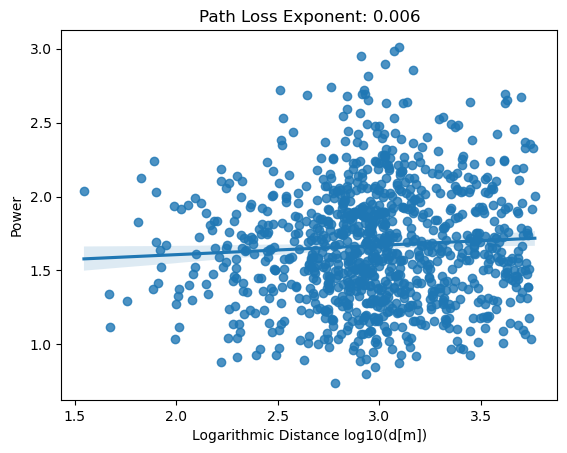

[0/30]: loss_d: 1.287, loss_g: 0.516, acc_real: 0.143, acc_fake: 0.024
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


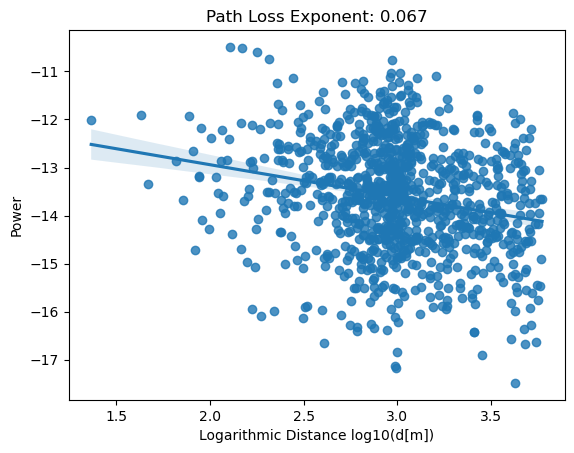

[1/30]: loss_d: 0.666, loss_g: 0.550, acc_real: 0.470, acc_fake: 0.032
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


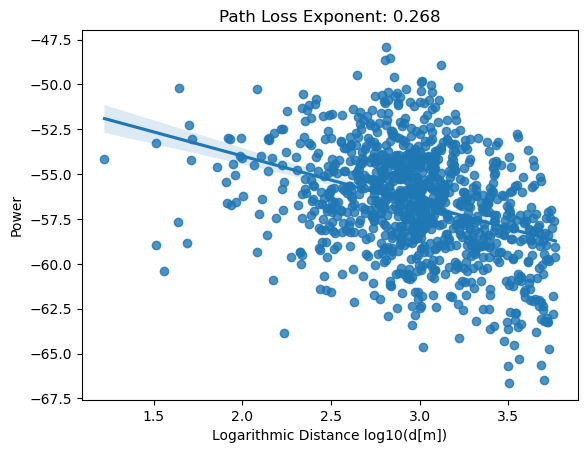

[2/30]: loss_d: 0.746, loss_g: 0.518, acc_real: 0.581, acc_fake: 0.088
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


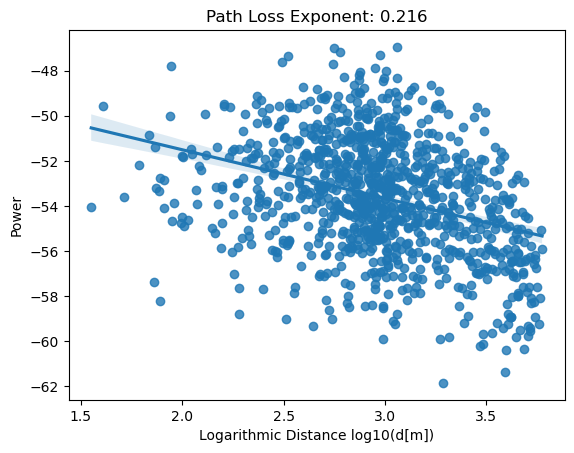

[3/30]: loss_d: 0.736, loss_g: 0.663, acc_real: 0.589, acc_fake: 0.165
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


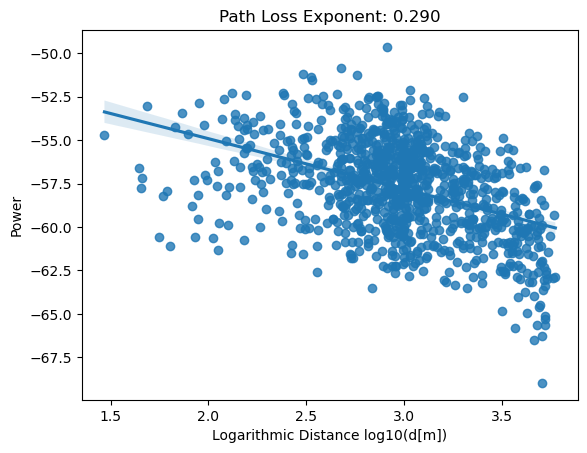

[4/30]: loss_d: 0.728, loss_g: 0.683, acc_real: 0.583, acc_fake: 0.222
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


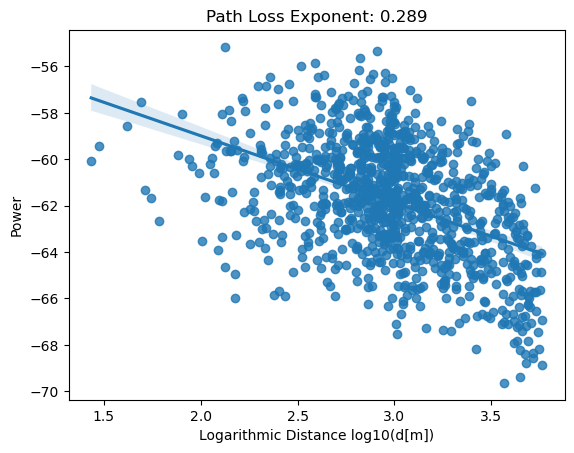

[5/30]: loss_d: 0.720, loss_g: 0.709, acc_real: 0.573, acc_fake: 0.265
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


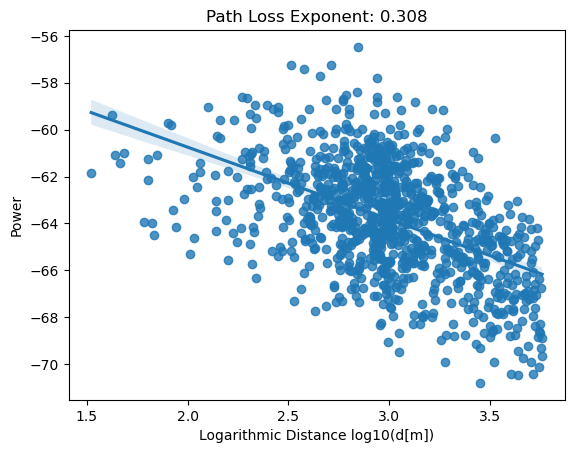

[6/30]: loss_d: 0.715, loss_g: 0.728, acc_real: 0.562, acc_fake: 0.302
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


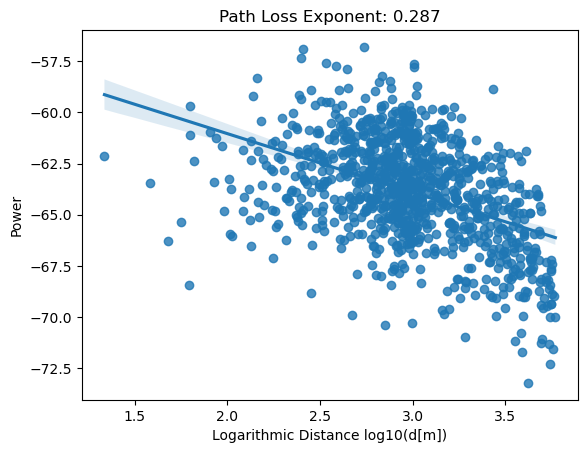

[7/30]: loss_d: 0.707, loss_g: 0.739, acc_real: 0.549, acc_fake: 0.333
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


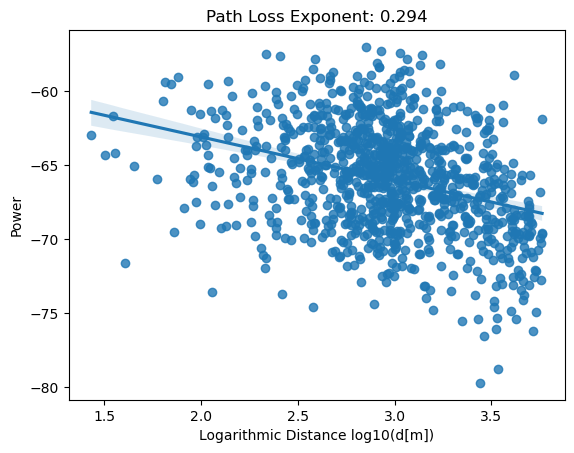

[8/30]: loss_d: 0.699, loss_g: 0.741, acc_real: 0.539, acc_fake: 0.360
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


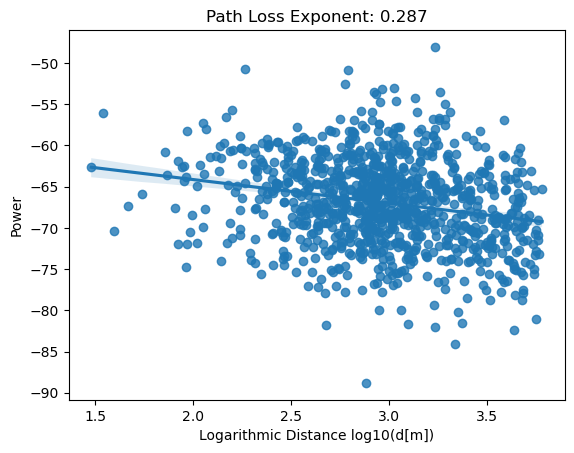

[9/30]: loss_d: 0.695, loss_g: 0.745, acc_real: 0.530, acc_fake: 0.381
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


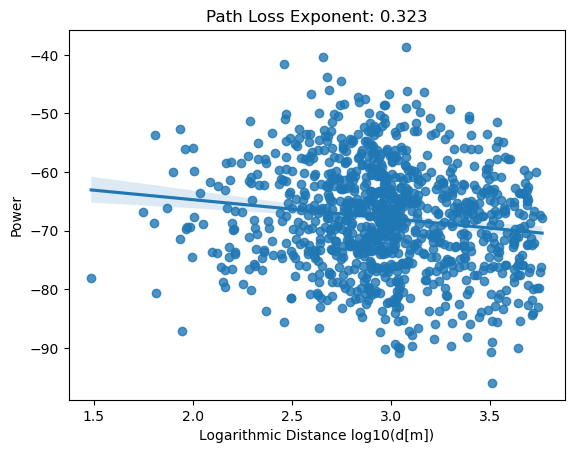

[10/30]: loss_d: 0.690, loss_g: 0.741, acc_real: 0.524, acc_fake: 0.399
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


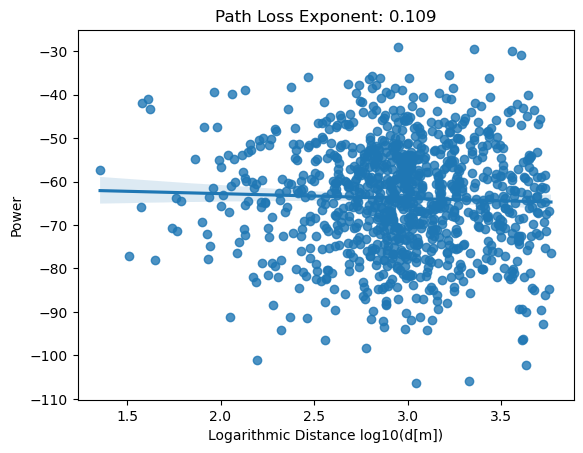

[11/30]: loss_d: 0.687, loss_g: 0.739, acc_real: 0.519, acc_fake: 0.418
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


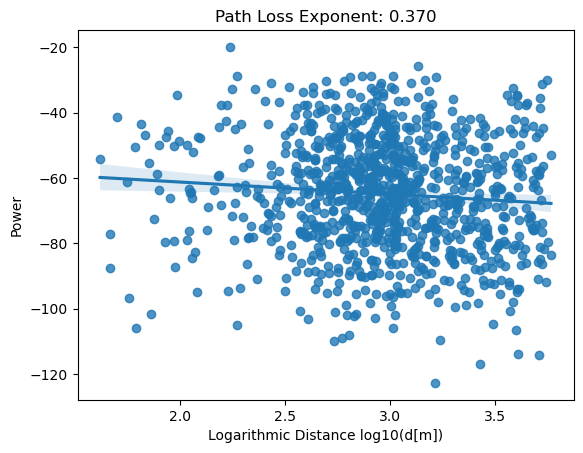

[12/30]: loss_d: 0.685, loss_g: 0.728, acc_real: 0.516, acc_fake: 0.434
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


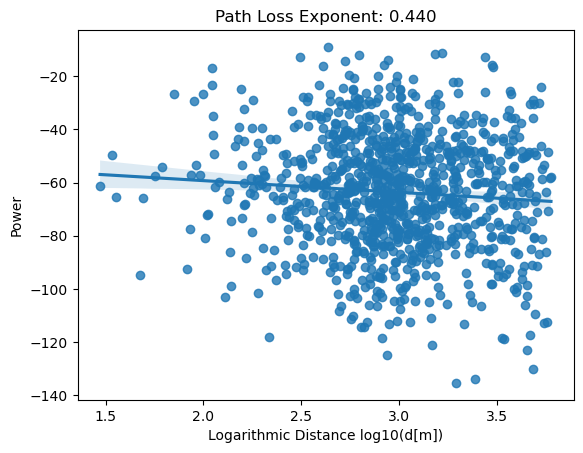

[13/30]: loss_d: 0.682, loss_g: 0.718, acc_real: 0.517, acc_fake: 0.447
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


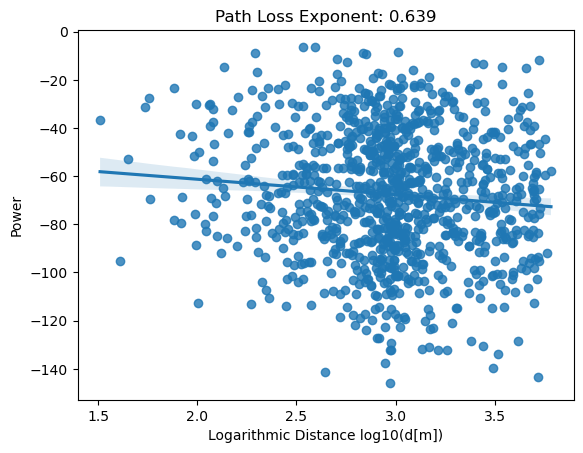

[14/30]: loss_d: 0.680, loss_g: 0.710, acc_real: 0.522, acc_fake: 0.456
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


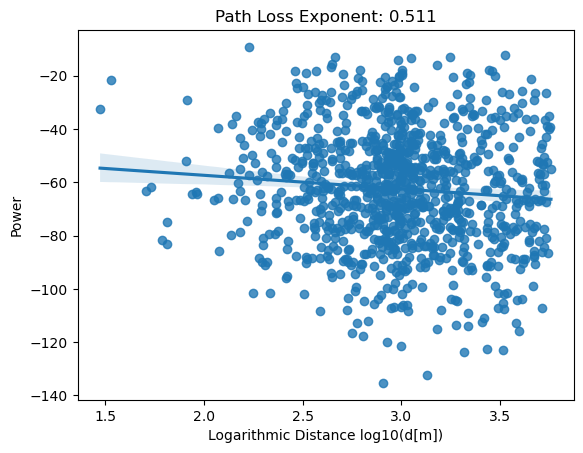

[15/30]: loss_d: 0.675, loss_g: 0.728, acc_real: 0.525, acc_fake: 0.470
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


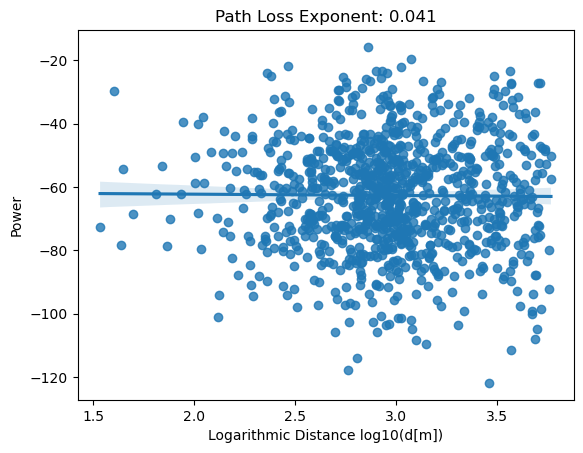

[16/30]: loss_d: 0.669, loss_g: 0.741, acc_real: 0.526, acc_fake: 0.485
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


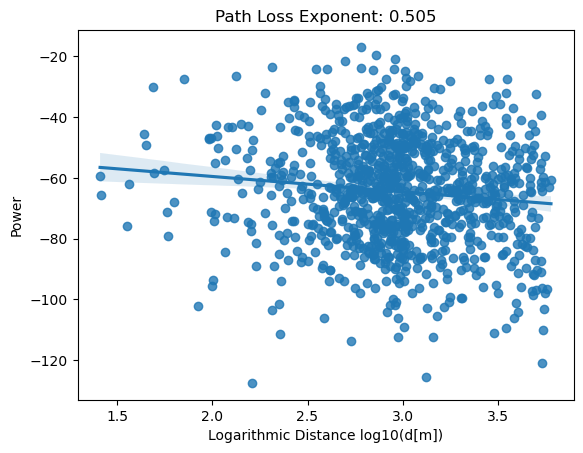

[17/30]: loss_d: 0.664, loss_g: 0.732, acc_real: 0.534, acc_fake: 0.496
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


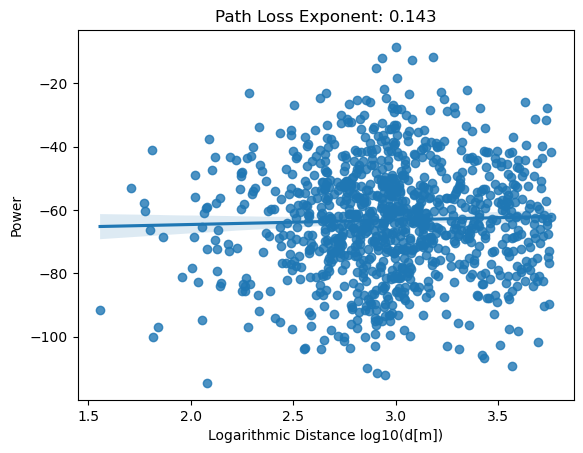

[18/30]: loss_d: 0.659, loss_g: 0.731, acc_real: 0.543, acc_fake: 0.505
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


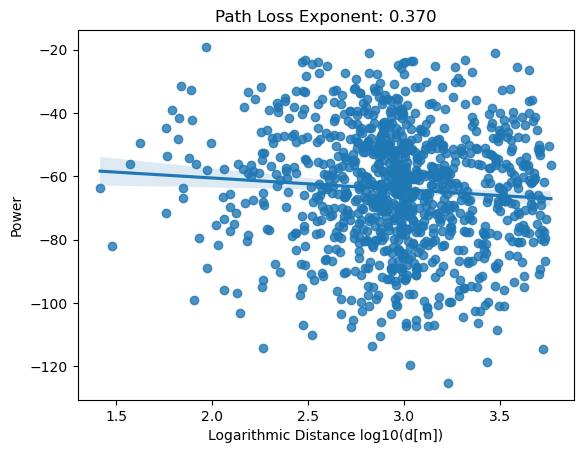

[19/30]: loss_d: 0.653, loss_g: 0.735, acc_real: 0.553, acc_fake: 0.514
0.0


KeyboardInterrupt: 

In [16]:
import seaborn as sns
def accuracy(output, target, threshold=0.5):
    with torch.no_grad():
        prediction = (output >= threshold).float()
        correct = (prediction == target).float().sum()
        accuracy = correct / len(target)
        return accuracy.item()


class GeneratorModel(nn.Module):
    def __init__(self):
        super(GeneratorModel, self).__init__()
        embed_dim = 8
        input_dim = 20 + 1 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 32),
            nn.ReLU()
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(32, 16)
        )
        self.hidden_layer3 = nn.Sequential(
            nn.Linear(16, output_dim)
        )

        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        info_out = self.sigm(self.ae(info[:, 4:]))
        x = torch.cat([x, torch.sqrt(((info[:,2]-info[:, 0])*0.5)**2 + ((info[:, 3]-info[:, 1])*0.5)**2).unsqueeze(1), info_out], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)
        output = self.hidden_layer3(output)

        return output.to(device)


class DiscriminatorModel(nn.Module):
    def __init__(self):
        super(DiscriminatorModel, self).__init__()
        embed_dim = 8
        input_dim = 1 + 1 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim),
            nn.Sigmoid()
        )
        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        x_out = self.sigm(self.ae(x[:, 4:]))
        x = torch.cat([torch.sqrt(((x[:,2]-x[:, 0])*0.5)**2 + ((x[:, 3]-x[:, 1])*0.5)**2).unsqueeze(1), x_out, info], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


discriminator = DiscriminatorModel()
generator = GeneratorModel()
discriminator.to(device)
generator.to(device)

discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.0001)
generator_optimizer = optim.Adam(generator.parameters(), lr=0.0003)

loss = nn.BCELoss()
noise_dim = 20
n_epochs = 30
batch_size = training_parameters["batch_size"]
G_loss_mean = []
D_loss_mean = []
D_real_mean = []
D_fake_mean = []
accuracy_real = []
accuracy_real_mean = []
accuracy_fake = []
accuracy_fake_mean = []
for epoch_idx in range(n_epochs):
    G_loss = []
    D_loss = []
    D_real = []
    D_fake = []
    for batch_idx, data_input in enumerate(train_ldr):
        if data_input[1].shape[0]!=batch_size and batch_idx==len(train_ldr)-1:
            continue
        if batch_idx%100 == 0:
            print(batch_idx/len(train_ldr))
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,3005)).to(device)
        generated_data = generator(noise, fake_info)  # batch_size X 784

        # Discriminator
        true_data = data_input[0].view(batch_size, 3005).to(device)  # batch_size X 784
        cond_info = data_input[1].to(device)  # batch_size
        true_labels = torch.ones(batch_size).to(device)

        discriminator_optimizer.zero_grad()

        discriminator_output_for_true_data = discriminator(true_data, cond_info).view(batch_size)
        true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)
        acc_real = accuracy(discriminator_output_for_true_data, true_labels)
        discriminator_output_for_generated_data = discriminator(fake_info, generated_data.detach()).view(batch_size)
        generator_discriminator_loss = loss(
            discriminator_output_for_generated_data, torch.zeros(batch_size).to(device)
        )
        acc_fake = accuracy(discriminator_output_for_generated_data, torch.zeros(batch_size).to(device))
        discriminator_loss = (
                                     true_discriminator_loss + generator_discriminator_loss
                             ) / 2

        discriminator_loss.backward()
        discriminator_optimizer.step()

        D_loss.append(discriminator_loss.data.item())
        D_real.append(true_discriminator_loss)
        D_fake.append(generator_discriminator_loss)
        accuracy_real.append(acc_real)
        accuracy_fake.append(acc_fake)
        # Generator

        generator_optimizer.zero_grad()
        # It's a choice to generate the data again
        generated_data = generator(noise, fake_info)  # batch_size X 784
        discriminator_output_on_generated_data = discriminator(fake_info, generated_data).view(batch_size)
        generator_loss = loss(discriminator_output_on_generated_data, true_labels)
        generator_loss.backward()
        generator_optimizer.step()

        G_loss.append(generator_loss.data.item())


    dist_list =[]
    gan_rss_list = []
    with torch.no_grad():
        noise = torch.randn(1000, noise_dim).to(device)
        fake_info = torch.rand((1000,3005)).to(device)
        fake_info[:, [0,1,2,3]] = torch.zeros(1000, 4)
        fake_info[:, 2] = torch.rand((1000,))*0.2 + torch.logspace(-2.5, 0, 1000)
        #fake_info[:, 3] -= torch.logspace(0, 0.6, 1000)
        generated_data = generator(noise, fake_info).cpu().view(1000, 1)
        for i, x in enumerate(generated_data):
            fake_info_reconst = fake_info[i].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= (max_elev-min_elev)
            fake_info_reconst[4:] += min_elev 

            dist_list.append(find_dist(fake_info_reconst, 0.5))
            gan_rss_list.append(x.detach().numpy()[0])

    a, b = np.polyfit(np.log10(dist_list), gan_rss_list, 1)
    plt.figure()
    sns.regplot(x=np.log10(dist_list), y=gan_rss_list)
    plt.xlabel("Logarithmic Distance log10(d[m])")
    plt.ylabel("Power")
    plt.title("Path Loss Exponent: %.3f" %abs(a/10))
    plt.show()
    '''
    with torch.no_grad():
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,18337)).to(device)
        generated_data = generator(noise, fake_info).cpu().view(batch_size, 1)
        for x in generated_data:
            fake_info_reconst = fake_info[0].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= max_elev
            print(fake_info_reconst)
            print(x.detach().numpy())
            #plt.imshow(x.detach().numpy(), interpolation='nearest', cmap='gray')
            #plt.show()

            break
    '''
    print('[%d/%d]: loss_d: %.3f, loss_g: %.3f, acc_real: %.3f, acc_fake: %.3f' % (
        (epoch_idx), n_epochs, torch.mean(torch.FloatTensor(D_loss)), torch.mean(torch.FloatTensor(G_loss)), torch.mean(torch.FloatTensor(accuracy_real)), torch.mean(torch.FloatTensor(accuracy_fake))))
    G_loss_mean.append(torch.mean(torch.FloatTensor(G_loss)))
    D_loss_mean.append(torch.mean(torch.FloatTensor(D_loss)))
    D_real_mean.append(torch.mean(torch.FloatTensor(D_real)))
    D_fake_mean.append(torch.mean(torch.FloatTensor(D_fake)))
    accuracy_real_mean.append(torch.mean(torch.FloatTensor(accuracy_real)))
    accuracy_fake_mean.append(torch.mean(torch.FloatTensor(accuracy_fake)))


## Try different distribution for fake info

0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


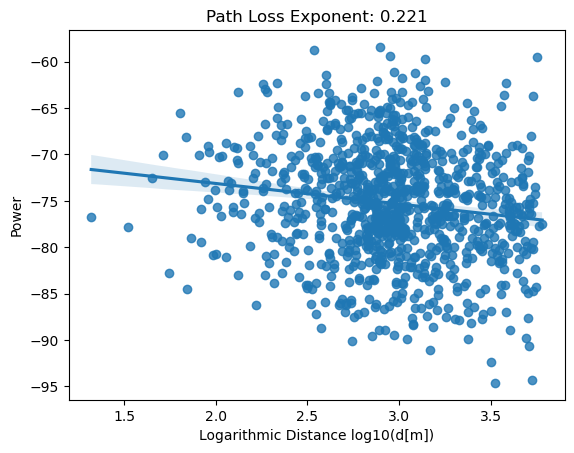

[0/30]: loss_d: 0.673, loss_g: 0.675, acc_real: 0.736, acc_fake: 0.457
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


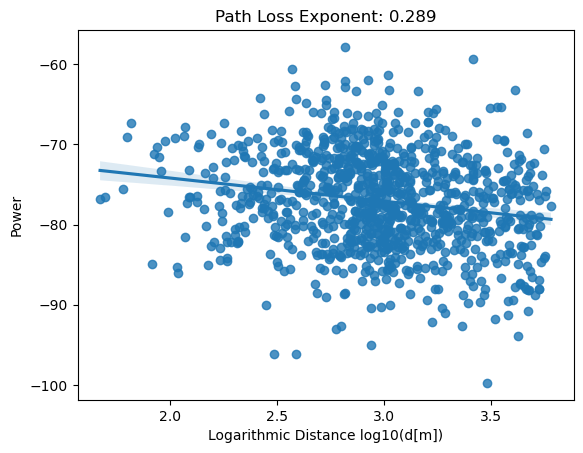

[1/30]: loss_d: 0.739, loss_g: 0.863, acc_real: 0.489, acc_fake: 0.576
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


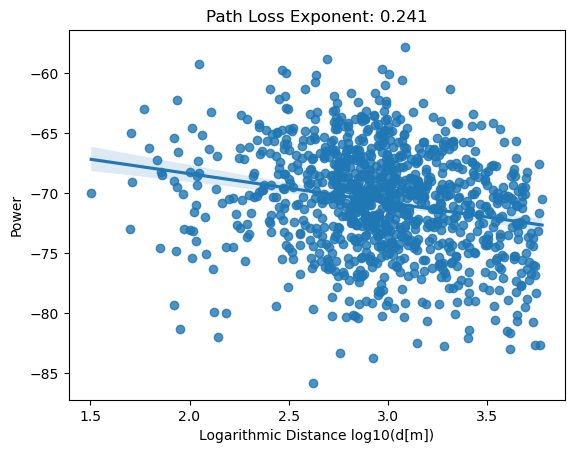

[2/30]: loss_d: 0.703, loss_g: 0.793, acc_real: 0.399, acc_fake: 0.634
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


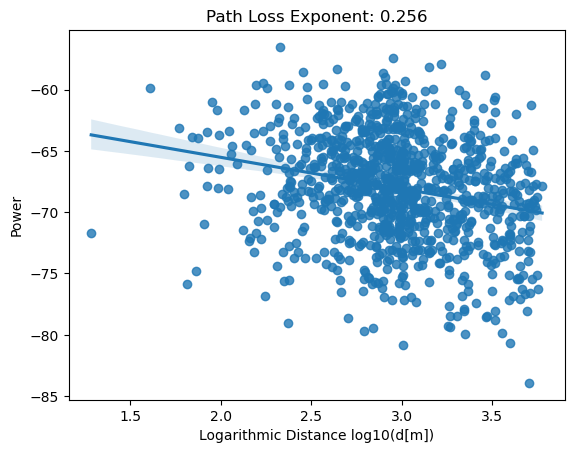

[3/30]: loss_d: 0.695, loss_g: 0.754, acc_real: 0.377, acc_fake: 0.648
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


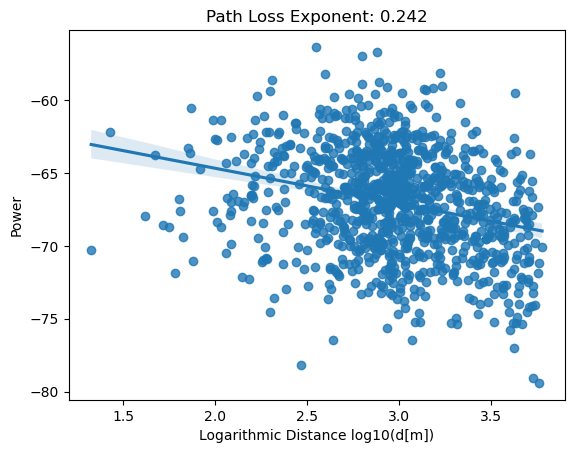

[4/30]: loss_d: 0.689, loss_g: 0.730, acc_real: 0.381, acc_fake: 0.647
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


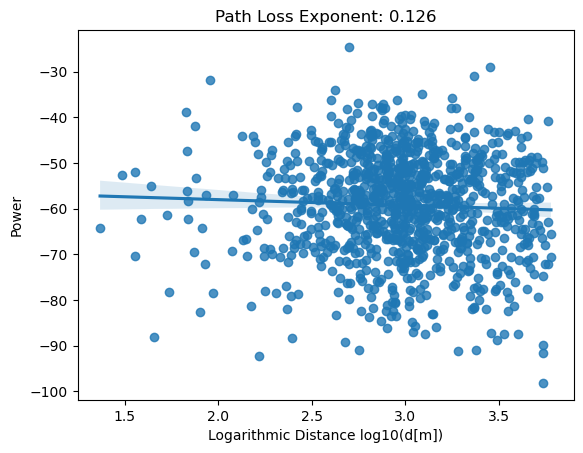

[5/30]: loss_d: 0.682, loss_g: 0.719, acc_real: 0.405, acc_fake: 0.639
0.0


KeyboardInterrupt: 

In [26]:
import seaborn as sns
def accuracy(output, target, threshold=0.5):
    with torch.no_grad():
        prediction = (output >= threshold).float()
        correct = (prediction == target).float().sum()
        accuracy = correct / len(target)
        return accuracy.item()


class GeneratorModel(nn.Module):
    def __init__(self):
        super(GeneratorModel, self).__init__()
        embed_dim = 8
        input_dim = 20 + 1 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 32),
            nn.ReLU()
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(32, 16)
        )
        self.hidden_layer3 = nn.Sequential(
            nn.Linear(16, output_dim)
        )

        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        info_out = self.sigm(self.ae(info[:, 4:]))
        x = torch.cat([x, torch.sqrt(((info[:,2]-info[:, 0])*0.5)**2 + ((info[:, 3]-info[:, 1])*0.5)**2).unsqueeze(1), info_out], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)
        output = self.hidden_layer3(output)

        return output.to(device)


class DiscriminatorModel(nn.Module):
    def __init__(self):
        super(DiscriminatorModel, self).__init__()
        embed_dim = 8
        input_dim = 1 + 1 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim),
            nn.Sigmoid()
        )
        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        x_out = self.sigm(self.ae(x[:, 4:]))
        x = torch.cat([torch.sqrt(((x[:,2]-x[:, 0])*0.5)**2 + ((x[:, 3]-x[:, 1])*0.5)**2).unsqueeze(1), x_out, info], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


discriminator = DiscriminatorModel()
generator = GeneratorModel()
discriminator.to(device)
generator.to(device)

discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.0003)
generator_optimizer = optim.Adam(generator.parameters(), lr=0.0009)

loss = nn.BCELoss()
noise_dim = 20
n_epochs = 30
batch_size = training_parameters["batch_size"]
G_loss_mean = []
D_loss_mean = []
D_real_mean = []
D_fake_mean = []
accuracy_real = []
accuracy_real_mean = []
accuracy_fake = []
accuracy_fake_mean = []
for epoch_idx in range(n_epochs):
    G_loss = []
    D_loss = []
    D_real = []
    D_fake = []
    for batch_idx, data_input in enumerate(train_ldr):
        if data_input[1].shape[0]!=batch_size and batch_idx==len(train_ldr)-1:
            continue
        if batch_idx%100 == 0:
            print(batch_idx/len(train_ldr))
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,3005)).to(device)
        fake_info[:, [0,1,2,3]] = torch.zeros(batch_size, 4)
        fake_info[:, 2] = torch.rand((batch_size,))*0.2 + torch.logspace(-2.5, 0, batch_size)
        fake_info.to(device)
        generated_data = generator(noise, fake_info)  # batch_size X 784

        # Discriminator
        true_data = data_input[0].view(batch_size, 3005).to(device)  # batch_size X 784
        cond_info = data_input[1].to(device)  # batch_size
        true_labels = torch.ones(batch_size).to(device)

        discriminator_optimizer.zero_grad()

        discriminator_output_for_true_data = discriminator(true_data, cond_info).view(batch_size)
        true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)
        acc_real = accuracy(discriminator_output_for_true_data, true_labels)
        discriminator_output_for_generated_data = discriminator(fake_info, generated_data.detach()).view(batch_size)
        generator_discriminator_loss = loss(
            discriminator_output_for_generated_data, torch.zeros(batch_size).to(device)
        )
        acc_fake = accuracy(discriminator_output_for_generated_data, torch.zeros(batch_size).to(device))
        discriminator_loss = (
                                     true_discriminator_loss + generator_discriminator_loss
                             ) / 2

        discriminator_loss.backward()
        discriminator_optimizer.step()

        D_loss.append(discriminator_loss.data.item())
        D_real.append(true_discriminator_loss)
        D_fake.append(generator_discriminator_loss)
        accuracy_real.append(acc_real)
        accuracy_fake.append(acc_fake)
        # Generator

        generator_optimizer.zero_grad()
        # It's a choice to generate the data again
        generated_data = generator(noise, fake_info)  # batch_size X 784
        discriminator_output_on_generated_data = discriminator(fake_info, generated_data).view(batch_size)
        generator_loss = loss(discriminator_output_on_generated_data, true_labels)
        generator_loss.backward()
        generator_optimizer.step()

        G_loss.append(generator_loss.data.item())


    dist_list =[]
    gan_rss_list = []
    with torch.no_grad():
        noise = torch.randn(1000, noise_dim).to(device)
        fake_info = torch.rand((1000,3005)).to(device)
        fake_info[:, [0,1,2,3]] = torch.zeros(1000, 4)
        fake_info[:, 2] = torch.rand((1000,))*0.2 + torch.logspace(-2.5, 0, 1000)
        #fake_info[:, 3] -= torch.logspace(0, 0.6, 1000)
        generated_data = generator(noise, fake_info).cpu().view(1000, 1)
        for i, x in enumerate(generated_data):
            fake_info_reconst = fake_info[i].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= (max_elev-min_elev)
            fake_info_reconst[4:] += min_elev 

            dist_list.append(find_dist(fake_info_reconst, 0.5))
            gan_rss_list.append(x.detach().numpy()[0])

    a, b = np.polyfit(np.log10(dist_list), gan_rss_list, 1)
    plt.figure()
    sns.regplot(x=np.log10(dist_list), y=gan_rss_list)
    plt.xlabel("Logarithmic Distance log10(d[m])")
    plt.ylabel("Power")
    plt.title("Path Loss Exponent: %.3f" %abs(a/10))
    plt.show()
    '''
    with torch.no_grad():
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,18337)).to(device)
        generated_data = generator(noise, fake_info).cpu().view(batch_size, 1)
        for x in generated_data:
            fake_info_reconst = fake_info[0].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= max_elev
            print(fake_info_reconst)
            print(x.detach().numpy())
            #plt.imshow(x.detach().numpy(), interpolation='nearest', cmap='gray')
            #plt.show()

            break
    '''
    print('[%d/%d]: loss_d: %.3f, loss_g: %.3f, acc_real: %.3f, acc_fake: %.3f' % (
        (epoch_idx), n_epochs, torch.mean(torch.FloatTensor(D_loss)), torch.mean(torch.FloatTensor(G_loss)), torch.mean(torch.FloatTensor(accuracy_real)), torch.mean(torch.FloatTensor(accuracy_fake))))
    G_loss_mean.append(torch.mean(torch.FloatTensor(G_loss)))
    D_loss_mean.append(torch.mean(torch.FloatTensor(D_loss)))
    D_real_mean.append(torch.mean(torch.FloatTensor(D_real)))
    D_fake_mean.append(torch.mean(torch.FloatTensor(D_fake)))
    accuracy_real_mean.append(torch.mean(torch.FloatTensor(accuracy_real)))
    accuracy_fake_mean.append(torch.mean(torch.FloatTensor(accuracy_fake)))


## Reduce Noise Dim

0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


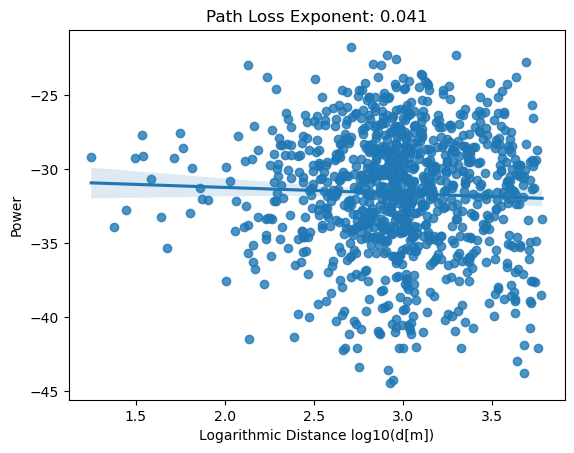

[0/100]: loss_d: 1.384, loss_g: 0.477, acc_real: 0.785, acc_fake: 0.221
0.0
0.2994011976047904
0.5988023952095808
0.8982035928143712


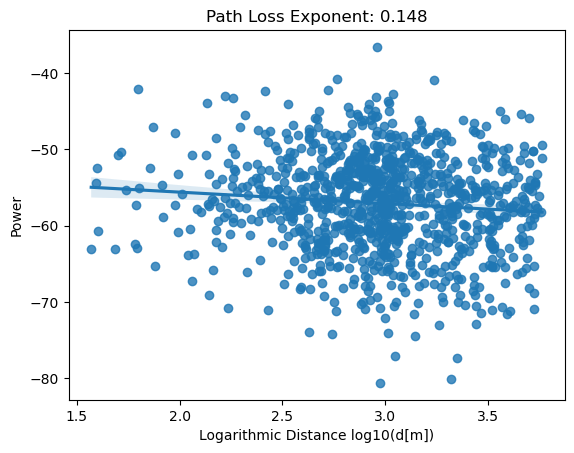

[1/100]: loss_d: 0.824, loss_g: 0.660, acc_real: 0.712, acc_fake: 0.298
0.0
0.2994011976047904
0.5988023952095808


KeyboardInterrupt: 

In [32]:
import seaborn as sns
def accuracy(output, target, threshold=0.5):
    with torch.no_grad():
        prediction = (output >= threshold).float()
        correct = (prediction == target).float().sum()
        accuracy = correct / len(target)
        return accuracy.item()


class GeneratorModel(nn.Module):
    def __init__(self):
        super(GeneratorModel, self).__init__()
        embed_dim = 8
        input_dim = 10 + 1 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.ReLU()
        )
        self.hidden_layer2 = nn.Sequential(
            nn.Linear(128, 64),
            nn.ReLU()
        )
        self.hidden_layer3 = nn.Sequential(
            nn.Linear(64, 32),
            nn.ReLU()
        )

        self.hidden_layer4 = nn.Sequential(
            nn.Linear(32, 16)
        )
        self.hidden_layer5 = nn.Sequential(
            nn.Linear(16, output_dim)
        )

        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        info_out = self.sigm(self.ae(info[:, 4:]))
        x = torch.cat([x, torch.sqrt(((info[:,2]-info[:, 0])*0.5)**2 + ((info[:, 3]-info[:, 1])*0.5)**2).unsqueeze(1), info_out], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)
        output = self.hidden_layer3(output)
        output = self.hidden_layer4(output)
        output = self.hidden_layer5(output)

        return output.to(device)


class DiscriminatorModel(nn.Module):
    def __init__(self):
        super(DiscriminatorModel, self).__init__()
        embed_dim = 8
        input_dim = 1 + 1 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim),
            nn.Sigmoid()
        )
        self.ae = ae.encoder
        self.sigm = nn.Sigmoid()
    def forward(self, x, info):
        x_out = self.sigm(self.ae(x[:, 4:]))
        x = torch.cat([torch.sqrt(((x[:,2]-x[:, 0])*0.5)**2 + ((x[:, 3]-x[:, 1])*0.5)**2).unsqueeze(1), x_out, info], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


discriminator = DiscriminatorModel()
generator = GeneratorModel()
discriminator.to(device)
generator.to(device)

discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.0003)
generator_optimizer = optim.Adam(generator.parameters(), lr=0.009)

loss = nn.BCELoss()
noise_dim = 10
n_epochs = 100
batch_size = training_parameters["batch_size"]
G_loss_mean = []
D_loss_mean = []
D_real_mean = []
D_fake_mean = []
accuracy_real = []
accuracy_real_mean = []
accuracy_fake = []
accuracy_fake_mean = []
for epoch_idx in range(n_epochs):
    G_loss = []
    D_loss = []
    D_real = []
    D_fake = []
    for batch_idx, data_input in enumerate(train_ldr):
        if data_input[1].shape[0]!=batch_size and batch_idx==len(train_ldr)-1:
            continue
        if batch_idx%100 == 0:
            print(batch_idx/len(train_ldr))
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,3005)).to(device)
        #fake_info[:, [0,1,2,3]] = torch.zeros(batch_size, 4)
        #fake_info[:, 2] = torch.rand((batch_size,))*0.2 + torch.logspace(-2.5, 0, batch_size)
        #fake_info.to(device)
        generated_data = generator(noise, fake_info)  # batch_size X 784

        # Discriminator
        true_data = data_input[0].view(batch_size, 3005).to(device)  # batch_size X 784
        cond_info = data_input[1].to(device)  # batch_size
        true_labels = torch.ones(batch_size).to(device)

        discriminator_optimizer.zero_grad()

        discriminator_output_for_true_data = discriminator(true_data, cond_info).view(batch_size)
        true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)
        acc_real = accuracy(discriminator_output_for_true_data, true_labels)
        discriminator_output_for_generated_data = discriminator(fake_info, generated_data.detach()).view(batch_size)
        generator_discriminator_loss = loss(
            discriminator_output_for_generated_data, torch.zeros(batch_size).to(device)
        )
        acc_fake = accuracy(discriminator_output_for_generated_data, torch.zeros(batch_size).to(device))
        discriminator_loss = (
                                     true_discriminator_loss + generator_discriminator_loss
                             ) / 2

        discriminator_loss.backward()
        discriminator_optimizer.step()

        D_loss.append(discriminator_loss.data.item())
        D_real.append(true_discriminator_loss)
        D_fake.append(generator_discriminator_loss)
        accuracy_real.append(acc_real)
        accuracy_fake.append(acc_fake)
        # Generator

        generator_optimizer.zero_grad()
        # It's a choice to generate the data again
        generated_data = generator(noise, fake_info)  # batch_size X 784
        discriminator_output_on_generated_data = discriminator(fake_info, generated_data).view(batch_size)
        generator_loss = loss(discriminator_output_on_generated_data, true_labels)
        generator_loss.backward()
        generator_optimizer.step()

        G_loss.append(generator_loss.data.item())


    dist_list =[]
    gan_rss_list = []
    with torch.no_grad():
        noise = torch.randn(1000, noise_dim).to(device)
        fake_info = torch.rand((1000,3005)).to(device)
        fake_info[:, [0,1,2,3]] = torch.zeros(1000, 4)
        fake_info[:, 2] = torch.rand((1000,))*0.2 + torch.logspace(-2.5, 0, 1000)
        #fake_info[:, 3] -= torch.logspace(0, 0.6, 1000)
        generated_data = generator(noise, fake_info).cpu().view(1000, 1)
        for i, x in enumerate(generated_data):
            fake_info_reconst = fake_info[i].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= (max_elev-min_elev)
            fake_info_reconst[4:] += min_elev 

            dist_list.append(find_dist(fake_info_reconst, 0.5))
            gan_rss_list.append(x.detach().numpy()[0])

    a, b = np.polyfit(np.log10(dist_list), gan_rss_list, 1)
    plt.figure()
    sns.regplot(x=np.log10(dist_list), y=gan_rss_list)
    plt.xlabel("Logarithmic Distance log10(d[m])")
    plt.ylabel("Power")
    plt.title("Path Loss Exponent: %.3f" %abs(a/10))
    plt.show()
    '''
    with torch.no_grad():
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,18337)).to(device)
        generated_data = generator(noise, fake_info).cpu().view(batch_size, 1)
        for x in generated_data:
            fake_info_reconst = fake_info[0].detach().numpy()
            fake_info_reconst[0] *=max_x_coord
            fake_info_reconst[1] *=max_y_coord
            fake_info_reconst[2] *=max_x_coord
            fake_info_reconst[3] *=max_y_coord
            fake_info_reconst[4:] *= max_elev
            print(fake_info_reconst)
            print(x.detach().numpy())
            #plt.imshow(x.detach().numpy(), interpolation='nearest', cmap='gray')
            #plt.show()

            break
    '''
    print('[%d/%d]: loss_d: %.3f, loss_g: %.3f, acc_real: %.3f, acc_fake: %.3f' % (
        (epoch_idx), n_epochs, torch.mean(torch.FloatTensor(D_loss)), torch.mean(torch.FloatTensor(G_loss)), torch.mean(torch.FloatTensor(accuracy_real)), torch.mean(torch.FloatTensor(accuracy_fake))))
    G_loss_mean.append(torch.mean(torch.FloatTensor(G_loss)))
    D_loss_mean.append(torch.mean(torch.FloatTensor(D_loss)))
    D_real_mean.append(torch.mean(torch.FloatTensor(D_real)))
    D_fake_mean.append(torch.mean(torch.FloatTensor(D_fake)))
    accuracy_real_mean.append(torch.mean(torch.FloatTensor(accuracy_real)))
    accuracy_fake_mean.append(torch.mean(torch.FloatTensor(accuracy_fake)))


In [19]:
(torch.rand((batch_size,3005))*0.2 + torch.logspace(-2.5, 0, 3005)).shape

torch.Size([64, 3005])

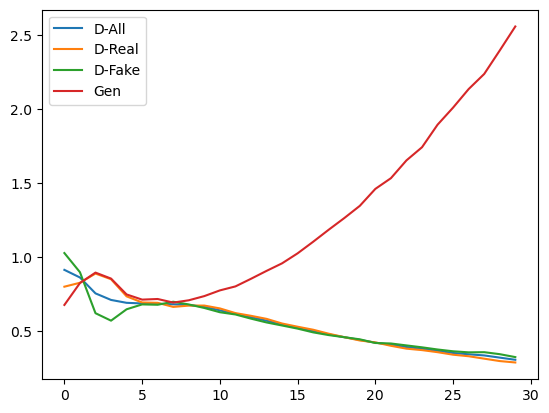

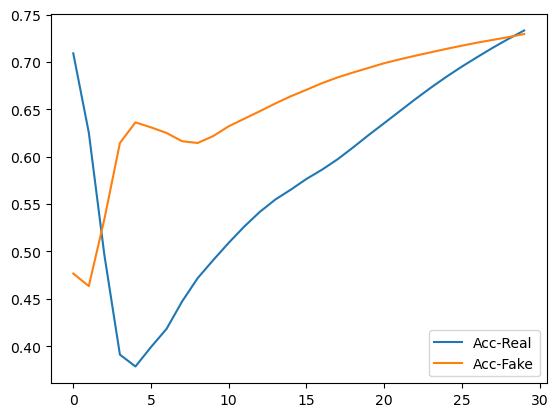

In [29]:
import matplotlib.pyplot as plt
plt.figure()
plt.plot(D_loss_mean)
plt.plot(D_real_mean)
plt.plot(D_fake_mean)
plt.plot(G_loss_mean)
plt.legend(["D-All", "D-Real", "D-Fake", "Gen"])
plt.show()

plt.figure()
plt.plot(accuracy_real_mean)
plt.plot(accuracy_fake_mean)
plt.legend(["Acc-Real", "Acc-Fake"])
plt.show()


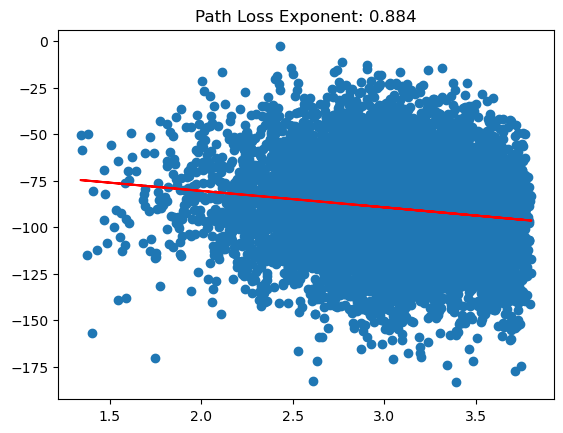

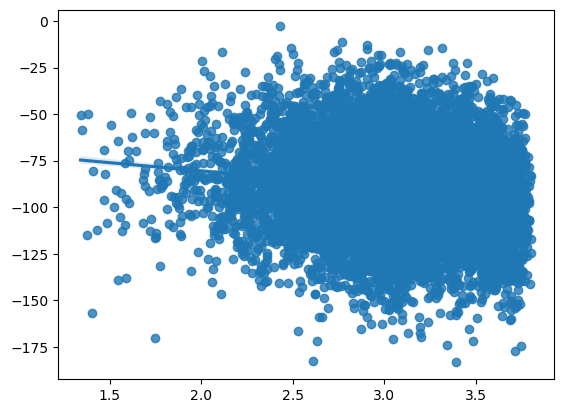

In [82]:
import seaborn as sns
#10 ** random.uniform(np.log10(min), np.log10(max))

dist_list =[]
gan_rss_list = []
with torch.no_grad():
    noise = torch.randn(10000, noise_dim).to(device)
    fake_info = torch.rand((10000,3005))
    fake_info /= 4
    fake_info.to(device)
    fake_info[:, [0,1,3]] = torch.zeros(10000, 3)
    fake_info[:, 2] += torch.logspace(-2.5, 0, 10000)
    #fake_info[:, 3] += torch.logspace(0, 0.2, 10000)
    generated_data = generator(noise, fake_info).cpu().view(10000, 1)
    for i, x in enumerate(generated_data):
        fake_info_reconst = fake_info[i].detach().numpy()
        fake_info_reconst[0] *=max_x_coord
        fake_info_reconst[1] *=max_y_coord
        fake_info_reconst[2] *=max_x_coord
        fake_info_reconst[3] *=max_y_coord
        fake_info_reconst[4:] *= (max_elev-min_elev)
        fake_info_reconst[4:] += min_elev 

        dist_list.append(find_dist(fake_info_reconst, 0.5))
        gan_rss_list.append(x.detach().numpy()[0])

plt.figure()
x=np.log10(dist_list)
y=gan_rss_list
a, b = np.polyfit(x, y, 1)
#add points to plot
plt.scatter(x, y)
#add line of best fit to plot
plt.plot(x, a*x+b, 'r')

plt.title("Path Loss Exponent: %.3f" % abs(a/10))
plt.show()

plt.figure()
sns.regplot(x=x, y=y)
#add line of best fit to plot
plt.show()

In [17]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
training_parameters = {
    "n_epochs": 50,
    "batch_size": 64,
}
train_ldr = torch.utils.data.DataLoader(ds_train, batch_size=training_parameters["batch_size"], shuffle=False)
test_ldr = torch.utils.data.DataLoader(ds_test, batch_size=1)
#test_ldr = torch.utils.data.DataLoader(ds_test, batch_size=1)
num_batches = len(train_ldr)
print("Number of batches: ",num_batches)


from matplotlib import pyplot as plt

for x,y in train_ldr:
    print(x)
    #print(x2)
    #print(x3)
    #print(y)
    break


class GeneratorModel(nn.Module):
    def __init__(self):
        super(GeneratorModel, self).__init__()
        embed_dim = 3
        input_dim = 20 + 4 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 16),
            nn.ReLU()
        )

        self.hidden_layer3 = nn.Sequential(
            nn.Linear(16, output_dim)
        )

        self.linear = nn.Sequential(nn.Linear(18333, embed_dim), nn.ReLU())
    def forward(self, x, info):
        info_out = self.linear(info[:, 4:])
        x = torch.cat([x, info[:, :4], info_out], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)
        output = self.hidden_layer3(output)

        return output.to(device)


class DiscriminatorModel(nn.Module):
    def __init__(self):
        super(DiscriminatorModel, self).__init__()
        embed_dim = 3
        input_dim = 1 + 4 + embed_dim
        output_dim = 1

        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim),
            nn.Sigmoid()
        )
        self.linear = nn.Sequential(nn.Linear(18333, embed_dim), nn.ReLU())

    def forward(self, x, info):
        x_out = self.linear(x[:, 4:])
        x = torch.cat([x[:, :4], x_out, info], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


discriminator = DiscriminatorModel()
generator = GeneratorModel()
discriminator.to(device)
generator.to(device)

discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
generator_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

loss = nn.BCELoss()
noise_dim = 20
n_epochs = training_parameters["n_epochs"]
batch_size = training_parameters["batch_size"]
G_loss_mean = []
D_loss_mean = []
D_real_mean = []
D_fake_mean = []
for epoch_idx in range(n_epochs):
    G_loss = []
    D_loss = []
    D_real = []
    D_fake = []
    for batch_idx, data_input in enumerate(train_ldr):
        if data_input[1].shape[0]!=batch_size and batch_idx==len(train_ldr)-1:
            continue
        if batch_idx%100 == 0:
            print(batch_idx/len(train_ldr))
        noise = torch.randn(batch_size, noise_dim).to(device)
        fake_info = torch.rand((batch_size,18337)).to(device)
        generated_data = generator(noise, fake_info)  # batch_size X 784

        # Discriminator
        true_data = data_input[0].view(batch_size, 18337).to(device)  # batch_size X 784
        cond_info = data_input[1].to(device)  # batch_size
        true_labels = torch.ones(batch_size).to(device)

        discriminator_optimizer.zero_grad()

        discriminator_output_for_true_data = discriminator(true_data, cond_info).view(batch_size)
        true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)

        discriminator_output_for_generated_data = discriminator(fake_info, generated_data.detach()).view(batch_size)
        generator_discriminator_loss = loss(
            discriminator_output_for_generated_data, torch.zeros(batch_size).to(device)
        )
        discriminator_loss = (
                                     true_discriminator_loss + generator_discriminator_loss
                             ) / 2

        discriminator_loss.backward()
        discriminator_optimizer.step()

        D_loss.append(discriminator_loss.data.item())
        D_real.append(true_discriminator_loss)
        D_fake.append(generator_discriminator_loss)
        # Generator

        generator_optimizer.zero_grad()
        # It's a choice to generate the data again
        generated_data = generator(noise, fake_info)  # batch_size X 784
        discriminator_output_on_generated_data = discriminator(fake_info, generated_data).view(batch_size)
        generator_loss = loss(discriminator_output_on_generated_data, true_labels)
        generator_loss.backward()
        generator_optimizer.step()

        G_loss.append(generator_loss.data.item())
        if ((batch_idx + 1) % 500 == 0 and (epoch_idx + 1) % 10 == 0):
            print("Training Steps Completed: ", batch_idx)

            with torch.no_grad():
                noise = torch.randn(batch_size, noise_dim).to(device)
                fake_info = torch.rand((batch_size,18337)).to(device)
                generated_data = generator(noise, fake_info).cpu().view(batch_size, 1)
                for x in generated_data:
                    fake_info_reconst = fake_info[0].detach().numpy()
                    fake_info_reconst[0] *=max_x_coord
                    fake_info_reconst[1] *=max_y_coord
                    fake_info_reconst[2] *=max_x_coord
                    fake_info_reconst[3] *=max_y_coord
                    fake_info_reconst[4:] *= max_elev
                    print(fake_info_reconst)
                    print(x.detach().numpy())
                    #plt.imshow(x.detach().numpy(), interpolation='nearest', cmap='gray')
                    #plt.show()

                    break
    print('[%d/%d]: loss_d: %.3f, loss_g: %.3f' % (
        (epoch_idx), n_epochs, torch.mean(torch.FloatTensor(D_loss)), torch.mean(torch.FloatTensor(G_loss))))
    G_loss_mean.append(torch.mean(torch.FloatTensor(G_loss)))
    D_loss_mean.append(torch.mean(torch.FloatTensor(D_loss)))
    D_real_mean.append(torch.mean(torch.FloatTensor(D_real)))
    D_fake_mean.append(torch.mean(torch.FloatTensor(D_fake)))


cpu
Number of batches:  559
tensor([[0.6660, 0.9473, 0.6109,  ..., 0.0000, 0.0000, 0.0000],
        [0.7410, 0.8759, 0.6111,  ..., 0.0000, 0.0000, 0.0000],
        [0.6660, 0.9473, 0.6721,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.6878, 0.9107, 0.6456,  ..., 0.0000, 0.0000, 0.0000],
        [0.6660, 0.9473, 0.5575,  ..., 0.0000, 0.0000, 0.0000],
        [0.6660, 0.9473, 0.6551,  ..., 0.0000, 0.0000, 0.0000]])
0.0
0.17889087656529518
0.35778175313059035
0.5366726296958855
0.7155635062611807
0.8944543828264758
[0/50]: loss_d: 0.218, loss_g: 6.474
0.0
0.17889087656529518
0.35778175313059035
0.5366726296958855
0.7155635062611807
0.8944543828264758
[1/50]: loss_d: 0.205, loss_g: 15.301
0.0
0.17889087656529518
0.35778175313059035
0.5366726296958855
0.7155635062611807
0.8944543828264758
[2/50]: loss_d: 0.107, loss_g: 14.801
0.0
0.17889087656529518
0.35778175313059035
0.5366726296958855
0.7155635062611807
0.8944543828264758
[3/50]: loss_d: 0.053, loss_g: 13.026
0.0
0.1788908765652

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
training_parameters = {
    "n_epochs": 300,
    "batch_size": 64,
}


train_ldr = torch.utils.data.DataLoader(ds_train, batch_size=training_parameters["batch_size"], shuffle=False)
test_ldr = torch.utils.data.DataLoader(ds_test, batch_size=1)
#test_ldr = torch.utils.data.DataLoader(ds_test, batch_size=1)
num_batches = len(train_ldr)
print("Number of batches: ",num_batches)


from matplotlib import pyplot as plt

for x,y in train_ldr:
    print(x)
    #print(x2)
    #print(x3)
    #print(y)
    break


class GeneratorModel(nn.Module):
    def __init__(self):
        super(GeneratorModel, self).__init__()
        info_in = 18333
        info_out_ = 10
        noise_dim = 10
        input_dim = noise_dim + info_out_ + 4
        output_dim = 1
        
        self.embed_layer = nn.Linear(info_in, info_out_)
        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.ReLU()
        )

        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim)
        )
    def forward(self, x, info):
        info_out = self.embed_layer(info[:, 4:])
        x = torch.cat([x, info[:,:4], info_out], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)
        #output = self.hidden_layer3(output)
        return output.to(device)


class DiscriminatorModel(nn.Module):
    def __init__(self):
        super(DiscriminatorModel, self).__init__()
        info_in = 18333
        info_out_ = 10
        input_dim = 1 + info_out_ + 4
        output_dim = 1

        self.embed_layer = nn.Linear(info_in, info_out_)
        self.hidden_layer1 = nn.Sequential(
            nn.Linear(input_dim, 8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )


        self.hidden_layer2 = nn.Sequential(
            nn.Linear(8, output_dim),
            nn.Sigmoid()
        )

    def forward(self, x, info):
        info_out = self.embed_layer(info[:, 4:])
        x = torch.cat([x, info[:, :4], info_out], 1)
        output = self.hidden_layer1(x)
        output = self.hidden_layer2(output)

        return output.to(device)


discriminator = DiscriminatorModel()
generator = GeneratorModel()
discriminator.to(device)
generator.to(device)

discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.000003)
generator_optimizer = optim.Adam(generator.parameters(), lr=0.000003)

loss = nn.BCELoss()

n_epochs = training_parameters["n_epochs"]
batch_size = training_parameters["batch_size"]

for epoch_idx in range(n_epochs):
    G_loss = []
    D_loss = []
    for batch_idx, data_input in enumerate(train_ldr):
        if data_input[1].shape[0]!=batch_size and batch_idx==len(train_ldr)-1:
            continue
        if batch_idx%100 == 0:
            print(batch_idx/len(train_ldr))
        noise = torch.randn(batch_size, 10).to(device)
        fake_info = torch.rand((batch_size,18337)).to(device)
        generated_data = generator(noise, fake_info)  # batch_size X 784

        # Discriminator
        true_data = data_input[0].view(batch_size, 18337).to(device)  # batch_size X 784
        cond_info = data_input[1].to(device)  # batch_size
        true_labels = torch.ones(batch_size).to(device)

        discriminator_optimizer.zero_grad()

        discriminator_output_for_true_data = discriminator(cond_info, true_data).view(batch_size)
        true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)

        discriminator_output_for_generated_data = discriminator(generated_data.detach(), fake_info).view(batch_size)
        generator_discriminator_loss = loss(
            discriminator_output_for_generated_data, torch.zeros(batch_size).to(device)
        )
        discriminator_loss = (
                                     true_discriminator_loss + generator_discriminator_loss
                             ) / 2

        discriminator_loss.backward()
        discriminator_optimizer.step()

        D_loss.append(discriminator_loss.data.item())

        # Generator

        generator_optimizer.zero_grad()
        # It's a choice to generate the data again
        #generated_data = generator(noise, fake_info)  # batch_size X 784
        discriminator_output_on_generated_data = discriminator(generated_data, fake_info).view(batch_size)
        generator_loss = loss(discriminator_output_on_generated_data, true_labels)
        generator_loss.backward()
        generator_optimizer.step()

        G_loss.append(generator_loss.data.item())
        if ((batch_idx + 1) % 500 == 0 and (epoch_idx + 1) % 10 == 0):
            print("Training Steps Completed: ", batch_idx)

            with torch.no_grad():
                noise = torch.randn(batch_size, 10).to(device)
                fake_info = torch.rand((batch_size,18337)).to(device)
                generated_data = generator(noise, fake_info).cpu().view(batch_size, 1)
                for x in generated_data:
                    fake_info_reconst = fake_info[0].detach().numpy()
                    fake_info_reconst[0] *=max_x_coord
                    fake_info_reconst[1] *=max_y_coord
                    fake_info_reconst[2] *=max_x_coord
                    fake_info_reconst[3] *=max_y_coord
                    fake_info_reconst[4:] *= max_elev
                    print(fake_info_reconst)
                    print(x.detach().numpy())
                    #plt.imshow(x.detach().numpy(), interpolation='nearest', cmap='gray')
                    #plt.show()

                    break

    print('[%d/%d]: loss_d: %.3f, loss_g: %.3f' % (
        (epoch_idx), n_epochs, torch.mean(torch.FloatTensor(D_loss)), torch.mean(torch.FloatTensor(G_loss))))



cpu
Number of batches:  559
tensor([[0.6878, 0.9107, 0.6487,  ..., 0.0000, 0.0000, 0.0000],
        [0.6660, 0.9473, 0.6335,  ..., 0.0000, 0.0000, 0.0000],
        [0.7410, 0.8759, 0.2817,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.6660, 0.9473, 0.7669,  ..., 0.0000, 0.0000, 0.0000],
        [0.6878, 0.9107, 0.6781,  ..., 0.0000, 0.0000, 0.0000],
        [0.6660, 0.9473, 0.7178,  ..., 0.0000, 0.0000, 0.0000]])
0.0
0.17889087656529518
0.35778175313059035
0.5366726296958855
0.7155635062611807
0.8944543828264758
[0/300]: loss_d: 3.993, loss_g: 1.168
0.0
0.17889087656529518
0.35778175313059035
0.5366726296958855
0.7155635062611807
0.8944543828264758
[1/300]: loss_d: 2.299, loss_g: 1.803
0.0
0.17889087656529518
0.35778175313059035
0.5366726296958855
0.7155635062611807
0.8944543828264758
[2/300]: loss_d: 1.368, loss_g: 2.698
0.0
0.17889087656529518
0.35778175313059035
0.5366726296958855
0.7155635062611807
0.8944543828264758
[3/300]: loss_d: 0.923, loss_g: 3.310
0.0
0.178890876565

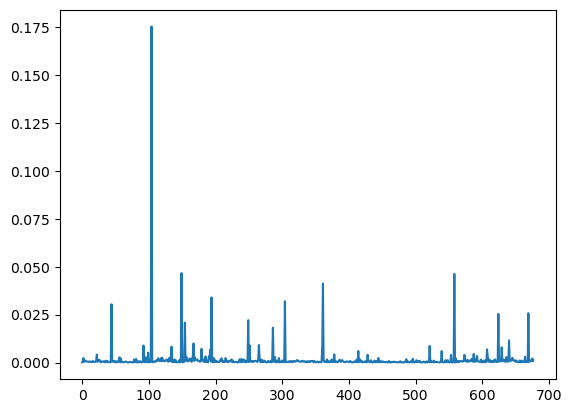

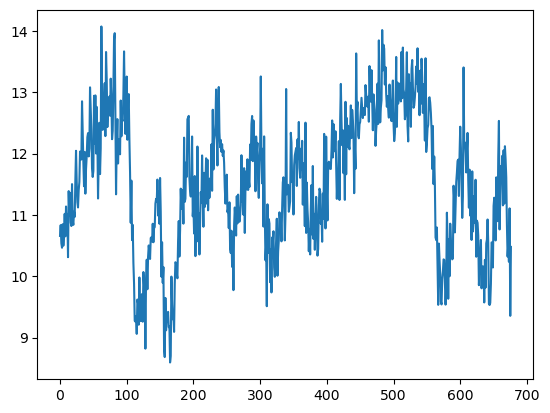

In [54]:
import matplotlib.pyplot as plt
plt.figure()
plt.plot(D_loss)
plt.show()
plt.figure()
plt.plot(G_loss)
plt.show()

In [55]:
fake_info_reconst = fake_info[0].detach().numpy()

In [57]:
fake_info_reconst

array([0.28490603, 0.01230186, 0.7746991 , ..., 0.9386593 , 0.75432754,
       0.99608386], dtype=float32)